In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import metrics
%matplotlib inline

import neuro_morpho_toolbox as nmt
# ns=nmt.neuron_set('/Users/pengxie/Documents/Research/fullMorph_classification/data/registered_swc/Janelia_test/swc/Whole/')
ns=nmt.neuron_set('/home/penglab/Documents/Janelia_1000')



/home/penglab/anaconda3/lib/python3.7/site-packages/neuro_morpho_toolbox/
Loading CCF Atlas data...
Loading time: 0.77
Loading CCF brain structure data...
Loading time: 0.00
Loading...
number of files under swc_path: 1002
100 loaded: 2.3s
Invalid number of soma found: 0
QC failed: AA0114.swc
Invalid number of soma found: 0
QC failed: AA0115.swc
200 loaded: 2.0s
300 loaded: 2.3s
400 loaded: 2.4s
Invalid number of soma found: 0
QC failed: AA0472.swc
500 loaded: 2.3s
Invalid number of soma found: 0
QC failed: AA0576.swc
Invalid number of soma found: 0
QC failed: AA0585.swc
Invalid number of soma found: 0
QC failed: AA0589.swc
600 loaded: 2.2s
Invalid number of soma found: 0
QC failed: AA0639.swc
Invalid number of soma found: 0
QC failed: AA0670.swc
Invalid number of soma found: 0
QC failed: AA0672.swc
700 loaded: 2.1s
Invalid number of soma found: 0
QC failed: AA0754.swc
Invalid number of soma found: 0
QC failed: AA0763.swc
800 loaded: 2.6s
900 loaded: 1.9s
QC failed: AA0952.swc
QC failed

/home/penglab/anaconda3/lib/python3.7/site-packages/neuro_morpho_toolbox/neuron_features.py:337: RuntimeWarning:

divide by zero encountered in true_divide

/home/penglab/anaconda3/lib/python3.7/site-packages/neuro_morpho_toolbox/neuron_features.py:337: RuntimeWarning:

invalid value encountered in true_divide



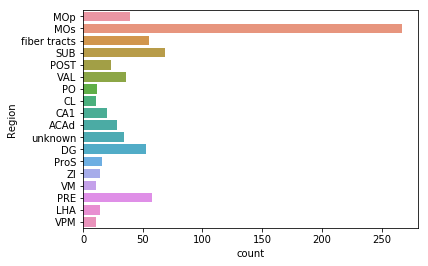

In [2]:
sf = ns.features['soma_features'].region
ct = sf["Region"].value_counts().sort_values(ascending=False)
_ = sns.countplot(y="Region", 
                  data=sf.loc[sf.Region.isin(ct.index[ct>10])],
                 )

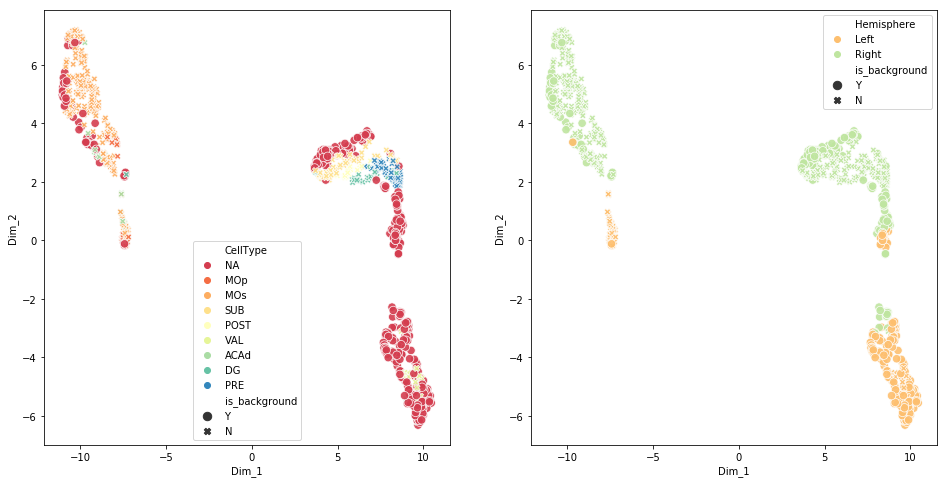

In [3]:
_ = ns.ReduceDimUMAP(feature_set="soma_features", n_neighbors=100)
_ = ns.FeatureScatter(["CellType", "Hemisphere"], map="UMAP")

## Perform UMAP operation to concated axon version

Store UMAP for concated Umap


/home/penglab/anaconda3/lib/python3.7/site-packages/neuro_morpho_toolbox/neuron_set.py:208: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.


/home/penglab/anaconda3/lib/python3.7/site-packages/neuro_morpho_toolbox/plot.py:260: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.




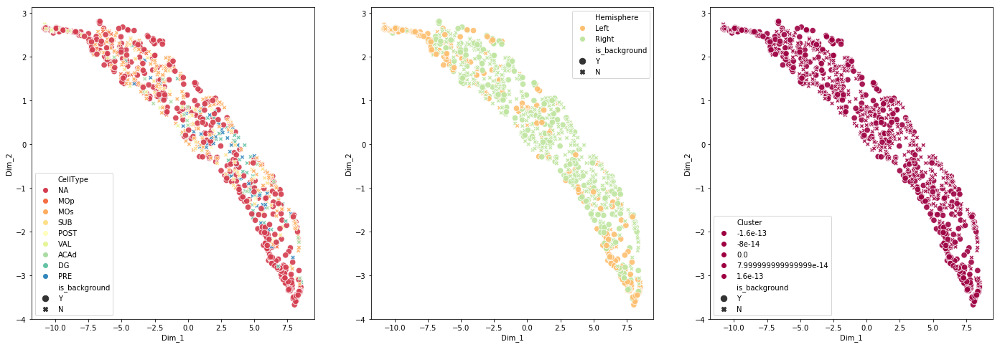

In [4]:
lm_dendrite_df_scale= pd.read_excel('/home/penglab/FeaCal/Jmorpho_features/lm_dendrite_df_scale.xlsx', index_col=0)
index_origin = ns.metadata.index.tolist()
ns.UMAP = nmt.UMAP_wrapper(lm_dendrite_df_scale, n_neighbors=100, min_dist=0.1, n_components=2, metric='euclidean',PCA_first=True,n_PC=100)
print('Store UMAP for concated Umap')

index_after = ns.UMAP.index.tolist()
index_update = [i for i in index_origin if i in index_after ]
ns.metadata = ns.metadata.loc[index_update,:]
ns.UMAP = ns.UMAP .loc[index_update,:]

_ = ns.FeatureScatter(["CellType", "Hemisphere", "Cluster"], map="UMAP")




Initiallization

In [5]:
colname = ['Homogeneity','Completeness','V-measure','Adjusted Rand Index','Adjusted Mutual Information','Silhouette Coefficient','parameter']

For hierarchy

In [6]:
#%% Store the result of Hierarchy
result_hier = pd.DataFrame(columns = colname)
L_method_list=['single', 'complete','average','weighted','centroid','median','ward']
L_metric_list=['braycurtis', 'canberra', 'chebyshev', 'cityblock', 'correlation', 'cosine',
               'dice', 'euclidean', 'hamming', 'jaccard', 'kulsinski', 
               'mahalanobis', 'matching','minkowski','rogerstanimoto', 'russellrao',
               'seuclidean', 'sokalmichener', 'sokalsneath', 'sqeuclidean']
#linkage using 'yule' and 'jensenshannon' may result in a condensed distance matrix must contain only finite values.

criterionH_list=['inconsistent','distance','maxclust','monocrit','maxclust_monocrit']

hier_dict={'L_method':'single', 'L_metric':'euclidean','criterionH':'inconsistent', 'depth':2,'R':None,'t':0.9,'optimal_ordering':False}
for L_methodidx in L_method_list:
    hier_dict.update(L_method = L_methodidx)
    for L_metricidx in L_metric_list:
        hier_dict.update(L_metric = L_metricidx )
        for criterionidx in criterionH_list:
            hier_dict.update(criterionH = criterionidx )   
            for depth_iter in range(2,15):
                hier_dict.update(depth = depth_iter ) 
                print(hier_dict)
                _ = ns. get_clusters(method='Hierarchy',karg_dict=hier_dict)
                h = metrics.homogeneity_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                c = metrics.completeness_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                V = metrics.v_measure_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                ARI = metrics.adjusted_rand_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                AMI = metrics.adjusted_mutual_info_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                typeR, typeC = np.unique(ns.metadata['Cluster'], return_counts = True)
                if len(typeR)<2:
                    SS = 'below'
                elif len(typeR)>=ns.UMAP.shape[0]:
                    SS = 'above'
                else:
                    SS = metrics.silhouette_score(ns.UMAP, ns.metadata['Cluster'], metric='sqeuclidean')
                tempDF = pd.DataFrame([h, c,V,ARI,AMI,SS,str(hier_dict)]).T.copy()
                tempDF.columns=colname
                result_hier = result_hier.append(tempDF)    
idx_hier = ['Hier'+str(x) for x in range(result_hier.shape[0])]    
result_hier['idx'] = idx_hier
result_hier.set_index('idx',inplace=True)    
    
result_hier.to_excel('/home/penglab/FeaCal/dataSource/denMor/result_hier.xlsx')
result_hier = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/result_hier.xlsx', index_col=0)

{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.720
Completeness: 0.417
V-measure: 0.528
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.463
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.472


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.795
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.476


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measur

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Resu

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.916
Completeness: 0.461
V-measure: 0.613
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.184


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.916
Completeness: 0.461
V-measure: 0.613
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.184


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.916
Completeness: 0.461
V-measure: 0.613
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.184


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.720
Completeness: 0.417
V-measure: 0.528
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.040
Silhouette Coefficient: 0.463


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.472


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.795
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.476
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480
{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.702
Completeness: 0.411
V-measure: 0.519
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.036
Silhouette Coefficient: 0.269


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.267
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.261
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.260
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.091
Completeness: 0.290
V-measure: 0.138
Adjusted Rand Index: 0.023
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.246
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.091
Completeness: 0.290
V-measure: 0.138
Adjusted Rand Index: 0.023
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.246
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.091
Completeness: 0.290
V-measure: 0.138
Adjusted Rand Index: 0.023
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.246


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.091
Completeness: 0.290
V-measure: 0.138
Adjusted Rand Index: 0.023
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.246
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.091
Completeness: 0.290
V-measure: 0.138
Adjusted Rand Index: 0.023
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.246
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.091
Completeness: 0.290
V-measure: 0.138
Adjusted Rand Index: 0.023
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.246


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.091
Completeness: 0.290
V-measure: 0.138
Adjusted Rand Index: 0.023
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.246
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.091
Completeness: 0.290
V-measure: 0.138
Adjusted Rand Index: 0.023
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.246
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.091
Completeness: 0.290
V-measure: 0.138
Adjusted Rand Index: 0.023
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.246


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.091
Completeness: 0.290
V-measure: 0.138
Adjusted Rand Index: 0.023
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.246
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.091
Completeness: 0.290
V-measure: 0.138
Adjusted Rand Index: 0.023
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.246
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.091
Completeness: 0.290
V-measure: 0.138
Adjusted Rand Index: 0.023
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.246


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.091
Completeness: 0.290
V-measure: 0.138
Adjusted Rand Index: 0.023
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.246
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth'

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'dept

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.267


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.261
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.260
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.260
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.260
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.260
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.260
{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.890
Completeness: 0.452
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.890
Completeness: 0.452
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.890
Completeness: 0.452
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.890
Completeness: 0.452
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.890
Completeness: 0.452
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.890
Completeness: 0.452
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.890
Completeness: 0.452
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.890
Completeness: 0.452
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.890
Completeness: 0.452
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.890
Completeness: 0.452
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.890
Completeness: 0.452
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.890
Completeness: 0.452
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.890
Completeness: 0.452
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.718
Completeness: 0.414
V-measure: 0.526
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.464
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.464
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'de

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.718
Completeness: 0.414
V-measure: 0.526
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464
{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.902
Completeness: 0.456
V-measure: 0.606
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.397


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.902
Completeness: 0.456
V-measure: 0.606
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.397


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.902
Completeness: 0.456
V-measure: 0.606
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.397


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.902
Completeness: 0.456
V-measure: 0.606
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.397


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.902
Completeness: 0.456
V-measure: 0.606
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.397


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.902
Completeness: 0.456
V-measure: 0.606
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.397


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.902
Completeness: 0.456
V-measure: 0.606
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.397


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.902
Completeness: 0.456
V-measure: 0.606
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.397


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.902
Completeness: 0.456
V-measure: 0.606
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.397


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.902
Completeness: 0.456
V-measure: 0.606
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.397


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.902
Completeness: 0.456
V-measure: 0.606
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.397


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.902
Completeness: 0.456
V-measure: 0.606
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.397


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.902
Completeness: 0.456
V-measure: 0.606
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.397


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.705
Completeness: 0.414
V-measure: 0.522
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.042
Silhouette Coefficient: 0.458


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.475
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.484
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.484
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.484
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.484
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.475


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.484
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.484
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.484
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.484
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484
{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.735
Completeness: 0.415
V-measure: 0.530
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.727
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.682
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.682
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.682
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.682
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.682
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.682
{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.448
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.007
Silhouette Coefficient: -0.521


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.448
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.007
Silhouette Coefficient: -0.521


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.448
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.007
Silhouette Coefficient: -0.521


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.448
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.007
Silhouette Coefficient: -0.521


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.448
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.007
Silhouette Coefficient: -0.521


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.448
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.007
Silhouette Coefficient: -0.521


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.448
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.007
Silhouette Coefficient: -0.521


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.448
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.007
Silhouette Coefficient: -0.521


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.448
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.007
Silhouette Coefficient: -0.521


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.448
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.007
Silhouette Coefficient: -0.521


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.448
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.007
Silhouette Coefficient: -0.521


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.448
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.007
Silhouette Coefficient: -0.521


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.448
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.007
Silhouette Coefficient: -0.521


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of 

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't'

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit',

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.803
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.476


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.798
Completeness: 0.433
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.026
Silhouette Coefficient: 0.473


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480
{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'dep

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'd

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.803
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.476


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.798
Completeness: 0.433
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.026
Silhouette Coefficient: 0.473
{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480
{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Informatio

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'dept

Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 5

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'hamming', 'criterionH': 'maxclust_m

Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 5

{'L_method': 'single', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Ad

{'L_method': 'single', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 

{'L_method': 'single', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.431
V-measure: 0.560
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: -0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.798
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-me

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'dept

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.834
Completeness: 0.444
V-measure: 0.579
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.030


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.834
Completeness: 0.444
V-measure: 0.579
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.030


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.834
Completeness: 0.444
V-measure: 0.579
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.030


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.834
Completeness: 0.444
V-measure: 0.579
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.030


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.713
Completeness: 0.414
V-measure: 0.524
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.038
Silhouette Coefficient: -0.088


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.431
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: -0.043
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.798
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.037
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.038
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038
{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.892
Completeness: 0.452
V-measure: 0.600
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.892
Completeness: 0.452
V-measure: 0.600
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.892
Completeness: 0.452
V-measure: 0.600
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.892
Completeness: 0.452
V-measure: 0.600
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.892
Completeness: 0.452
V-measure: 0.600
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.892
Completeness: 0.452
V-measure: 0.600
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.892
Completeness: 0.452
V-measure: 0.600
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.892
Completeness: 0.452
V-measure: 0.600
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.892
Completeness: 0.452
V-measure: 0.600
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.892
Completeness: 0.452
V-measure: 0.600
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.892
Completeness: 0.452
V-measure: 0.600
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.892
Completeness: 0.452
V-measure: 0.600
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.892
Completeness: 0.452
V-measure: 0.600
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Informa

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False

Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'opt

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'matching', 'criterionH': 'maxclus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.803
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.476


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.798
Completeness: 0.433
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.026
Silhouette Coefficient: 0.473
{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480
{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 7,

Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.713
Completeness: 0.416
V-measure: 0.525
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.041
Silhouette Coefficient: 0.471
{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.803
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.476


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.798
Completeness: 0.433
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.026
Silhouette Coefficient: 0.473


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480
{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjus

{'L_method': 'single', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual I

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering':

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth':

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth

Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit'

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272
{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272
{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measur

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth':

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272
{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.891
Completeness: 0.451
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.891
Completeness: 0.451
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.891
Completeness: 0.451
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.891
Completeness: 0.451
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.891
Completeness: 0.451
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.891
Completeness: 0.451
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.891
Completeness: 0.451
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.891
Completeness: 0.451
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.891
Completeness: 0.451
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.891
Completeness: 0.451
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.891
Completeness: 0.451
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.891
Completeness: 0.451
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.891
Completeness: 0.451
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of 

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust',

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalmichener', 'criter

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLusteri

{'L_method': 'single', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Informat

{'L_method': 'single', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.808
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.478


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Informatio

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLusteri

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.808
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.478


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'single', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.754
Completeness: 0.421
V-measure: 0.540
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.027
Silhouette Coefficient: 0.560


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.110
Completeness: 0.286
V-measure: 0.159
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.299
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.110
Completeness: 0.286
V-measure: 0.159
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.299
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.110
Completeness: 0.286
V-measure: 0.159


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.299
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.110
Completeness: 0.286
V-measure: 0.159
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.299
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.110
Completeness: 0.286
V-measure: 0.159
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.299


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.110
Completeness: 0.286
V-measure: 0.159
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.299
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.110
Completeness: 0.286
V-measure: 0.159
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.299
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.110
Completeness: 0.286
V-measure: 0.159
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.059


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.299
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.110
Completeness: 0.286
V-measure: 0.159
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.299
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.110
Completeness: 0.286
V-measure: 0.159
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.299
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.110
Completeness: 0.286
V-measure: 0.159
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.299
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.110
Completeness: 0.286
V-measure: 0.159
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.299
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.110
Completeness: 0.286
V-measure: 0.159
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.299


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measu

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.869
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.869
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.869
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.869
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.869
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.869
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.869
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.869
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.869
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.869
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.869
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.869
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.869
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.747
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.027


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.316
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.316
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.316
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.316
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.316
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.216
Completeness: 0.285
V-measure: 0.246
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.238
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.216
Completeness: 0.285
V-measure: 0.246
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.238
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.216
Completeness: 0.285
V-measure: 0.246
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.238
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.216
Completeness: 0.285
V-measure: 0.246
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.238
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.216


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.285
V-measure: 0.246
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.238
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.216
Completeness: 0.285
V-measure: 0.246
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.238
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.216
Completeness: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.246
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.238
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.216
Completeness: 0.285
V-measure: 0.246
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.238
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.216
Completeness: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.246
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.238
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.216
Completeness: 0.285
V-measure: 0.246
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.238
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.216
Completeness: 0.285
V-measure: 0.246
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.238
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.216
Completeness: 0.285
V-measure: 0.246
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.238
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.216
Completeness: 0.285
V-measure: 0.246
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.238
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclu

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.316
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.316
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.316
{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.752
Completeness: 0.420
V-measure: 0.539
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.026
Silhouette Coefficient: 0.551


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.388
Completeness: 0.325
V-measure: 0.354
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.388
Completeness: 0.325
V-measure: 0.354
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.388
Completeness: 0.325
V-measure: 0.354
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.388
Completeness: 0.325
V-measure: 0.354
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.388
Completeness: 0.325
V-measure: 0.354
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.388
Completeness: 0.325
V-measure: 0.354
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.388
Completeness: 0.325
V-measure: 0.354
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.388
Completeness: 0.325
V-measure: 0.354
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.388
Completeness: 0.325
V-measure: 0.354
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.388
Completeness: 0.325
V-measure: 0.354
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.089


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.388
Completeness: 0.325
V-measure: 0.354
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.388
Completeness: 0.325
V-measure: 0.354
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.388
Completeness: 0.325
V-measure: 0.354
Adjusted Rand Index: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust'

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.531
{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.439


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.439


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.439


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.439


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.439


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.439


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.439


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.439


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.439


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.439


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.439


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.439


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.439


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.757
Completeness: 0.421
V-measure: 0.541
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.027
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.467
Completeness: 0.352
V-measure: 0.402
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.546
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.467
Completeness: 0.352
V-measure: 0.402
Adjusted Rand Index: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.546
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.467
Completeness: 0.352
V-measure: 0.402
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.467
Completeness: 0.352
V-measure: 0.402
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.546
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.467
Completeness: 0.352
V-measure: 0.402
Adjusted Rand Index: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.546
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.467
Completeness: 0.352
V-measure: 0.402
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.467
Completeness: 0.352
V-measure: 0.402
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.546
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.467
Completeness: 0.352
V-measure: 0.402
Adjusted Rand Index: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.546
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.467
Completeness: 0.352
V-measure: 0.402
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.467
Completeness: 0.352
V-measure: 0.402
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.546
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.467
Completeness: 0.352
V-measure: 0.402
Adjusted Rand Index: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.546
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.467
Completeness: 0.352
V-measure: 0.402
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.467
Completeness: 0.352
V-measure: 0.402
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.546
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust'

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.436


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.436


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.436


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.436


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.436


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.436


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.436


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.436


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.436


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.436


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.436


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.436


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.436


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.483
Completeness: 0.335
V-measure: 0.396
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.865


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.506
Completeness: 0.342
V-measure: 0.408
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.013
Silhouette Coefficient: -0.923


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.772
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.483
Completeness: 0.335
V-measure: 0.396
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.865
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.506
Completeness: 0.342
V-measure: 0.408
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: -0.923
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.509
Completeness: 0.343
V-measure: 0.410
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.750
Completeness: 0.418
V-measure: 0.537
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.677
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.017


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.685
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.017


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.685
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.017


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.685
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.017


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.685
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.096
Completeness: 0.305
V-measure: 0.146
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.240
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.096
Completeness: 0.305
V-measure: 0.146
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.240
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.096
Completeness: 0.305
V-measure: 0.146
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.240


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.096
Completeness: 0.305
V-measure: 0.146
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.240
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.096
Completeness: 0.305
V-measure: 0.146
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.240
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.096
Completeness: 0.305
V-measure: 0.146
Adjusted Rand Index: 0.013


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.240
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.096
Completeness: 0.305
V-measure: 0.146
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.240
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.096
Completeness: 0.305
V-measure: 0.146
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.240
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.096
Completeness: 0.305
V-measure: 0.146
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.240
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.096
Completeness: 0.305
V-measure: 0.146
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.240
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.096
Completeness: 0.305
V-measure: 0.146
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.240


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.096
Completeness: 0.305
V-measure: 0.146
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.240
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.096
Completeness: 0.305
V-measure: 0.146
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.240
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth'

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.017


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.685
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.017


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.685
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.017


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.685
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.017


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.685
{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.870
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.554


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.870
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.554


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.870
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.554


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.870
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.554


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.870
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.554


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.870
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.554


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.870
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.554


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.870
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.554


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.870
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.554


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.870
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.554


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.870
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.554


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.870
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.554


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.870
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.554


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optim

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', '

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust'

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Info

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Info

Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'dep

{'L_method': 'complete', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutu

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}

{'L_method': 'complete', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.6

{'L_method': 'complete', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adju

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_or

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'dept

{'L_method': 'complete', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.752
Completeness: 0.418
V-measure: 0.538
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: -0.015
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: -0.015
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: -0.015
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: -0.015
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: -0.015
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: -0.015
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: -0.015
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: -0.015
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: -0.015
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: -0.015
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: -0.015
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: -0.015
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: -0.015
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'max

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014
{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual I

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'matching', 'criterionH': 'inconsisten

{'L_method': 'complete', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.

{'L_method': 'complete', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted M

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be ca

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hie

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'rogerstanimoto'

{'L_method': 'complete', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual In

Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 3, 'R': Non

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'russellrao', 'criteri

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.205
Completeness: 0.294
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.335
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.205
Completeness: 0.294
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.335
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.205
Completeness: 0.294
V-measure: 0.241
Adjusted Rand Index: 0.049


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.335
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.205
Completeness: 0.294
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.335
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.205
Completeness: 0.294
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.335


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.205
Completeness: 0.294
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.335
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.205
Completeness: 0.294
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.335


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.205
Completeness: 0.294
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.335
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.205
Completeness: 0.294
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.335


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.205
Completeness: 0.294
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.335
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.205
Completeness: 0.294
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.335


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.205
Completeness: 0.294
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.335
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.205
Completeness: 0.294
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.335
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.349
{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Ad

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Ad

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalmichener', 'criterionH': 'maxc

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalmichener', '

{'L_method': 'complete', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual

{'L_method': 'complete', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual In

Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.406
Completeness: 0.332
V-measure: 0.365
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.517
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.406
Completeness: 0.332
V-measure: 0.365
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.088


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.517
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.406
Completeness: 0.332
V-measure: 0.365
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.517
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.406
Completeness: 0.332
V-measure: 0.365
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.517
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.406
Completeness: 0.332
V-measure: 0.365
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.517


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.406
Completeness: 0.332
V-measure: 0.365
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.517
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.406
Completeness: 0.332
V-measure: 0.365
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.088


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.517
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.406
Completeness: 0.332
V-measure: 0.365
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.517
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.406
Completeness: 0.332
V-measure: 0.365
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.517
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.406
Completeness: 0.332
V-measure: 0.365
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.517


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.406
Completeness: 0.332
V-measure: 0.365
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.517
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.406
Completeness: 0.332
V-measure: 0.365
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.517


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.406
Completeness: 0.332
V-measure: 0.365
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.517
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'max

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.538
{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'complete', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.742
Completeness: 0.417
V-measure: 0.534
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.026
Silhouette Coefficient: 0.569


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.119
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.161
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.119
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.161
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.119
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.161


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.119
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.161
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.119
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.161
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.119
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.161
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.119
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.161
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.119
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.161
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.119
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.161
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.119
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.161
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.119
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.161


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.119
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.161
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.119
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.161
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'braycurtis

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.731
Completeness: 0.415
V-measure: 0.529
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.028
Silhouette Coefficient: 0.308


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.306
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.306
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.306
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.306
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.288
V-measure: 0.174
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.112
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.288
V-measure: 0.174
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.112
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.288
V-measure: 0.174
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.112
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.288
V-measure: 0.174
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.112
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.288
V-measure: 0.174
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.112


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.288
V-measure: 0.174
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.112
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.288
V-measure: 0.174
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.112
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.125
Completeness: 0.288
V-measure: 0.174
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.112
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.288
V-measure: 0.174
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.112
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.288
V-measure: 0.174
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.112
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.288
V-measure: 0.174
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.112
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.288
V-measure: 0.174
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.112


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.288
V-measure: 0.174
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.112
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'dep

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.306
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.306
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.306
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306
{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.537
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.523
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.565
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.565
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.565
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.565
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.290


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.565
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.565
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.290


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.565
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.565
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.565
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.565
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.565
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.565
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.565
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclu

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523
{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.523


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.737
Completeness: 0.416
V-measure: 0.532
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.027
Silhouette Coefficient: 0.562


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.343
Completeness: 0.323
V-measure: 0.333
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.343
Completeness: 0.323
V-measure: 0.333
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.537


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.343
Completeness: 0.323
V-measure: 0.333
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.343
Completeness: 0.323
V-measure: 0.333
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.537


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.343
Completeness: 0.323
V-measure: 0.333
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.343
Completeness: 0.323
V-measure: 0.333
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.537


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.343
Completeness: 0.323
V-measure: 0.333
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.343
Completeness: 0.323
V-measure: 0.333
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.537


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.343
Completeness: 0.323
V-measure: 0.333
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.343
Completeness: 0.323
V-measure: 0.333
Adjusted Rand Index: 0.031


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.343
Completeness: 0.323
V-measure: 0.333
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.537


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.343
Completeness: 0.323
V-measure: 0.333
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.343
Completeness: 0.323
V-measure: 0.333
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.537
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust', '

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532
{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.772
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.772
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.745
Completeness: 0.417
V-measure: 0.535
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: -0.687


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.685
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.685
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.071
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.071
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.071
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.071
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.071
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.071
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.071
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.071
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.071
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.071
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.071
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.071
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.071
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 5

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685
{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.0

{'L_method': 'average', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of

Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering':

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust', '

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Informa

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'd

Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth'

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocr

{'L_method': 'average', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Info

Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth'

{'L_method': 'average', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth':

{'L_method': 'average', 'L_metric': 'kulsinski', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information:

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'kulsinski', 'criterionH': 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.202
Completeness: 0.298
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.022
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.202
Completeness: 0.298
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.022
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.202
Completeness: 0.298
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.202
Completeness: 0.298
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.022
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.202
Completeness: 0.298
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.022
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.202
Completeness: 0.298
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.022
{'L_method': 'average', 'L_metric': 'mahalanobis', '

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.022
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.202
Completeness: 0.298
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.022
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.202
Completeness: 0.298
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.202
Completeness: 0.298
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.022
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.202
Completeness: 0.298
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.022
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.202
Completeness: 0.298
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.022
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclu

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.045
{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Info

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Info

Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'matching', 'criterionH': 'maxclust', 'dep

{'L_method': 'average', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutu

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calc

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Ad

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'rogerstanimoto', 'criterionH

{'L_method': 'average', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutua

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'rogerstanimoto', '

{'L_method': 'average', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Infor

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_o

{'L_method': 'average', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.150
Completeness: 0.331
V-measure: 0.207
Adjusted Rand Index: 0.073
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.533
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.150
Completeness: 0.331
V-measure: 0.207
Adjusted Rand Index: 0.073
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.533
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.150
Completeness: 0.331
V-measure: 0.207
Adjusted Rand Index: 0.073


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.533
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.150
Completeness: 0.331
V-measure: 0.207
Adjusted Rand Index: 0.073
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.533
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.150
Completeness: 0.331
V-measure: 0.207
Adjusted Rand Index: 0.073
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.533


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.150
Completeness: 0.331
V-measure: 0.207
Adjusted Rand Index: 0.073
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.533
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.150
Completeness: 0.331
V-measure: 0.207
Adjusted Rand Index: 0.073
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.533
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.150
Completeness: 0.331
V-measure: 0.207
Adjusted Rand Index: 0.073
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.533
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.150
Completeness: 0.331
V-measure: 0.207
Adjusted Rand Index: 0.073
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.533
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.150
Completeness: 0.331
V-measure: 0.207
Adjusted Rand Index: 0.073
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.533
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.150
Completeness: 0.331
V-measure: 0.207
Adjusted Rand Index: 0.073
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.533
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.150
Completeness: 0.331
V-measure: 0.207
Adjusted Rand Index: 0.073
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.533


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.150
Completeness: 0.331
V-measure: 0.207
Adjusted Rand Index: 0.073
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.533
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalmichener', 'criterionH': 

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalmichener', 'criterionH': 'maxclus

{'L_method': 'average', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Ind

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalsneath', 'criterionH': 'dis

Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 13, 'R': N

{'L_method': 'average', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.308
Completeness: 0.313
V-measure: 0.310
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.549
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.308
Completeness: 0.313
V-measure: 0.310
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.549


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.308
Completeness: 0.313
V-measure: 0.310
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.549
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.308
Completeness: 0.313
V-measure: 0.310
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.549


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.308
Completeness: 0.313
V-measure: 0.310
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.549
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.308
Completeness: 0.313
V-measure: 0.310
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.549


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.308
Completeness: 0.313
V-measure: 0.310
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.549
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.308
Completeness: 0.313
V-measure: 0.310
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.549


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.308
Completeness: 0.313
V-measure: 0.310
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.549
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.308
Completeness: 0.313
V-measure: 0.310
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.549


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.308
Completeness: 0.313
V-measure: 0.310
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.549
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.308
Completeness: 0.313
V-measure: 0.310
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.549


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.308
Completeness: 0.313
V-measure: 0.310
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.549
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclu

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.535
{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'average', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.744
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.029


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.559
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measu

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.526


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526
{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.731
Completeness: 0.415
V-measure: 0.529
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.318


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.301
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.301
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.285
V-measure: 0.173
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.054
Silhouette Coefficient: 0.111
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.285
V-measure: 0.173
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.054
Silhouette Coefficient: 0.111
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.125
Completeness: 0.285
V-measure: 0.173
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.054
Silhouette Coefficient: 0.111
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.285
V-measure: 0.173
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.054
Silhouette Coefficient: 0.111
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.285
V-measure: 0.173
Adjusted Rand Index: 0.017


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.054
Silhouette Coefficient: 0.111
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.285
V-measure: 0.173
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.054
Silhouette Coefficient: 0.111
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.285
V-measure: 0.173
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.054
Silhouette Coefficient: 0.111


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.285
V-measure: 0.173
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.054
Silhouette Coefficient: 0.111
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.285
V-measure: 0.173
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.054
Silhouette Coefficient: 0.111
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.125
Completeness: 0.285
V-measure: 0.173
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.054
Silhouette Coefficient: 0.111
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.285
V-measure: 0.173
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.054
Silhouette Coefficient: 0.111
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.285
V-measure: 0.173
Adjusted Rand Index: 0.017


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.054
Silhouette Coefficient: 0.111
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.285
V-measure: 0.173
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.054
Silhouette Coefficient: 0.111
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust', '

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.301
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.301
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.301


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.301
{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.448
V-measure: 0.593
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.448
V-measure: 0.593
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.448
V-measure: 0.593
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.448
V-measure: 0.593
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.448
V-measure: 0.593
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.448
V-measure: 0.593
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.448
V-measure: 0.593
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.448
V-measure: 0.593
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.448
V-measure: 0.593
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.448
V-measure: 0.593
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.448
V-measure: 0.593
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.448
V-measure: 0.593
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.448
V-measure: 0.593
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.744
Completeness: 0.419
V-measure: 0.536
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.030
Silhouette Coefficient: 0.551


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.512
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.469
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.469


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.469
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.469


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.469
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.469


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.469
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.469


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.469
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.469


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.469
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.469


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.469
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.512
{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.432


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.432


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.432


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.432


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.432


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.432


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.432


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.432


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.432


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.432


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.432


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.432


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.432


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.744
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.028


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.558
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.531
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.531
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.531
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.357
Completeness: 0.326
V-measure: 0.341
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.474
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.357
Completeness: 0.326
V-measure: 0.341
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.474
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.357
Completeness: 0.326
V-measure: 0.341
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.474
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.357
Completeness: 0.326
V-measure: 0.341
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.474


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.357
Completeness: 0.326
V-measure: 0.341
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.474
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.357
Completeness: 0.326
V-measure: 0.341
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.474


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.357
Completeness: 0.326
V-measure: 0.341
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.474
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.357
Completeness: 0.326
V-measure: 0.341
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.474


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.357
Completeness: 0.326
V-measure: 0.341
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.474
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.357
Completeness: 0.326
V-measure: 0.341
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.474


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.357
Completeness: 0.326
V-measure: 0.341
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.474
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.357
Completeness: 0.326
V-measure: 0.341
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.474


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.357
Completeness: 0.326
V-measure: 0.341
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.474
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust'

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531
{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.450
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.450
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.450
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.450
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.450
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.450
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.450
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.450
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.450
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.450
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.450
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.450
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.450
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.501
Completeness: 0.340
V-measure: 0.405
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.887


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.772
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.772
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'we

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.501
Completeness: 0.340
V-measure: 0.405
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.887


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.505
Completeness: 0.341
V-measure: 0.407
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.901


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.505
Completeness: 0.341
V-measure: 0.407
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.901


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.505
Completeness: 0.341
V-measure: 0.407
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.901


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.505
Completeness: 0.341
V-measure: 0.407
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.901


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.505
Completeness: 0.341
V-measure: 0.407
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.901


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.505
Completeness: 0.341
V-measure: 0.407
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.901


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.505
Completeness: 0.341
V-measure: 0.407
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.901


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.505
Completeness: 0.341
V-measure: 0.407
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.901


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.505
Completeness: 0.341
V-measure: 0.407
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.901


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.505
Completeness: 0.341
V-measure: 0.407
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.901


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.505
Completeness: 0.341
V-measure: 0.407
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.901


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.505
Completeness: 0.341
V-measure: 0.407
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.901


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.505
Completeness: 0.341
V-measure: 0.407
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.901


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.745
Completeness: 0.417
V-measure: 0.534
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.684
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.684
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.684


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.684
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.684
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Ad

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684
{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'dice', 'criterionH': 'maxclust_mono

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust'

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Info

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Info

Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'dep

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'hamming', 'criterionH': 'maxclust_mon

{'L_method': 'weighted', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual I

Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'dep

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'jaccard', 'criterionH': 'maxc

{'L_method': 'weighted', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Informatio

{'L_method': 'weighted', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Informatio

Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.732
Completeness: 0.413
V-measure: 0.528
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: -0.030
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054
Adjusted Mutual Information: 0.120


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.055
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'max

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.550
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual I

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'matching', 'criterionH': 'inconsisten

Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'matching', 'criterionH': 'maxclust', '

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'matching', 'criterionH': 'maxclust_

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be ca

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540
{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'rogerstanimoto', 'criteri

{'L_method': 'weighted', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mu

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_orde

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'russellrao', 'criterionH': 'distance

{'L_method': 'weighted', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Info

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': Fa

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.134
Completeness: 0.353
V-measure: 0.195
Adjusted Rand Index: 0.064
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.450
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.134
Completeness: 0.353
V-measure: 0.195
Adjusted Rand Index: 0.064
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.450
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.134
Completeness: 0.353


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.195
Adjusted Rand Index: 0.064
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.450
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.134
Completeness: 0.353
V-measure: 0.195
Adjusted Rand Index: 0.064
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.450
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.134
Completeness: 0.353
V-measure: 0.195
Adjusted Rand Index: 0.064
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.134
Completeness: 0.353
V-measure: 0.195
Adjusted Rand Index: 0.064
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.450
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.134
Completeness: 0.353
V-measure: 0.195
Adjusted Rand Index: 0.064
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.450
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.134
Completeness: 0.353
V-measure: 0.195
Adjusted Rand Index: 0.064


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.450
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.134
Completeness: 0.353
V-measure: 0.195
Adjusted Rand Index: 0.064
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.450
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.134
Completeness: 0.353
V-measure: 0.195
Adjusted Rand Index: 0.064
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.134
Completeness: 0.353
V-measure: 0.195
Adjusted Rand Index: 0.064
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.450
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.134
Completeness: 0.353
V-measure: 0.195
Adjusted Rand Index: 0.064
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.450
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.134
Completeness: 0.353
V-measure: 0.195


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.064
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.450
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ord

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344
{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Ad

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 8, 'R': Non

Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 6, 

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalmichener', 'criterio

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalsneath', 'criterionH': '

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust

{'L_method': 'weighted', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.310
Completeness: 0.312
V-measure: 0.311
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.513
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.310
Completeness: 0.312
V-measure: 0.311
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.513


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.310
Completeness: 0.312
V-measure: 0.311
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.513
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.310
Completeness: 0.312
V-measure: 0.311
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.513
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.310
Completeness: 0.312
V-measure: 0.311
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.513
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.310


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.312
V-measure: 0.311
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.513
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.310
Completeness: 0.312
V-measure: 0.311
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.513


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.310
Completeness: 0.312
V-measure: 0.311
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.513
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.310
Completeness: 0.312
V-measure: 0.311
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.513


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.310
Completeness: 0.312
V-measure: 0.311
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.513
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.310
Completeness: 0.312
V-measure: 0.311
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.513


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.310
Completeness: 0.312
V-measure: 0.311
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.513
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.310
Completeness: 0.312
V-measure: 0.311
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.513


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-me

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536
{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'weighted', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Com

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Informatio

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Informat

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Informat

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centro

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.544
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.00

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust'

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.544
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Informat

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Info

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Informatio

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Informat

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutua

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Inform

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Inform

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.544
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Info

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Info

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.539
{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'centroid', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.564
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.00

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:*

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Nu

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'dep

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': '

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.564
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completen

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLust

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.00

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Inform

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.564
{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.564
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.564
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*******

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', '

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.564
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535
{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.535


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'median', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.573


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:*******

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Nu

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'braycurtis', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.573


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:*************

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'canberra', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.573


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:*********

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Numb

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'chebyshev', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.573
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:********

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cityblock', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.573
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.4

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'correlation', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.573
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Met

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'cosine', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.573
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method w

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'dice', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.573
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'euclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.573
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Me

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'hamming', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.573


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'jaccard', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.573
{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:********

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Numb

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'kulsinski', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.573
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:***

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'mahalanobis', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.573
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:***********

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'matching', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.573


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Numb

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'minkowski', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.573


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhou

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'rogerstanimoto', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.573
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Nu

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'russellrao', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.573


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:******

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Nu

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'seuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.573
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouet

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalmichener', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.573


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'so

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sokalsneath', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.573


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'inconsistent', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'distance', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette C

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 3, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 4, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 5, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 6, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 7, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 8, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 9, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 10, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 11, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 12, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 13, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'L_method': 'ward', 'L_metric': 'sqeuclidean', 'criterionH': 'maxclust_monocrit', 'depth': 14, 'R': None, 't': 0.9, 'optimal_ordering': False}
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



For Kmeans

In [7]:
from sklearn import metrics
colname = ['Homogeneity','Completeness','V-measure','Adjusted Rand Index','Adjusted Mutual Information','Silhouette Coefficient','parameter']
#method=['SNN_community','Kmeans'
result_kmeans = pd.DataFrame(columns = colname)

init_list=['k-means++','random']
algorithm_list = ['auto','full','elkan']
precompute_distances_list = ['auto', True, False]
n_init_list=['braycurtis', 'canberra', 'chebyshev', 'cityblock', 'correlation', 'cosine',
               'dice', 'euclidean', 'hamming', 'jaccard', 'kulsinski', 
               'mahalanobis', 'matching','minkowski','rogerstanimoto', 'russellrao',
               'seuclidean', 'sokalmichener', 'sokalsneath', 'sqeuclidean']
#linkage using 'yule' and 'jensenshannon' may result in a condensed distance matrix must contain only finite values.

criterionH_list='inconsistent','distance','maxclust','monocrit','maxclust_monocrit'

kmeans_dict={'n_clusters':20, 'init':'k-means++', 'n_init':10, 'max_iter':300, 'tol':0.0001,'precompute_distances':'auto', 'verbose':0, 'random_state':None,'copy_x': True,'n_jobs':None, 'algorithm':'auto'}

for init_idx in init_list:
    kmeans_dict.update(init = init_idx)
    for algorithm_idx in algorithm_list:
        kmeans_dict.update(algorithm = algorithm_idx )
        for precompute_distances_idx in precompute_distances_list:
            kmeans_dict.update(precompute_distances = precompute_distances_idx )
            for n_clustersidx in range(3,25):
                kmeans_dict.update(n_clusters = n_clustersidx)     
                #Number of time the k-means algorithm will be run with different centroid seeds. The final results will be the best output of n_init consecutive runs in terms of inertia.
                for n_initidx in range(7,25):
                    kmeans_dict.update(n_init = n_initidx) 
                    print(kmeans_dict)
                    _ = ns. get_clusters(method='Kmeans',karg_dict=kmeans_dict)
                    h = metrics.homogeneity_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                    c = metrics.completeness_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                    V = metrics.v_measure_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                    ARI = metrics.adjusted_rand_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                    AMI = metrics.adjusted_mutual_info_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                    typeR, typeC = np.unique(ns.metadata['Cluster'], return_counts = True)
                    if len(typeR)<2:
                        SS = 'below'
                    elif len(typeR)>=ns.UMAP.shape[0]:
                        SS = 'above'
                    else:
                        SS = metrics.silhouette_score(ns.UMAP, ns.metadata['Cluster'], metric='sqeuclidean')
                    
                    tempDF = pd.DataFrame([h, c,V,ARI,AMI,SS,str(kmeans_dict)]).T.copy()
                    tempDF.columns=colname
                    result_kmeans = result_kmeans.append(tempDF)         
idx_kmeans = ['KMeans'+str(x) for x in range(result_kmeans.shape[0])]    
result_kmeans['idx'] = idx_kmeans
result_kmeans.set_index('idx',inplace=True)       
result_kmeans.to_excel('/home/penglab/FeaCal/dataSource/denMor/result_kmeans.xlsx')
result_kmeans = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/result_kmeans.xlsx', index_col=0)

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.29

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.28

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.140
Completeness: 0.287
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homog

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.241
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.629
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.629
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.237
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.213
Completeness: 0.287
V-measure: 0.244
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.256
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.296
V-measure: 0.253
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.218
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.289
V-measure: 0.248
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.638
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.218
Completeness: 0.291
V-measure: 0.249
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.107


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.




Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.296
V-measure: 0.253
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.290
V-measure: 0.248
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.644


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.644
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.229
Completeness: 0.296
V-measure: 0.258
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.225
Completeness: 0.293
V-measure: 0.254
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.617
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Ho

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.297


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.295
V-measure: 0.260
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.638


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.639
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.636
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.237


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.638
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.633
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.266
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.640
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.633
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.623
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.622
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.623
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.624
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.623
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.614
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.303
V-measure: 0.275
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.623
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.622


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.296
V-measure: 0.270
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.614
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.616
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.306
V-measure: 0.281
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.618
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.308
V-measure: 0.283
Adjusted Rand Index: 0.046


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.615
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.602
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.594
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.304
V-measure: 0.279
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.618
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.616
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.612
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.286
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.303


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.282
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.594
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.607
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.594
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.286
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.613
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.612
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.301
V-measure: 0.281
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.302
V-measure: 0.282
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.297
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.599
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.588
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.276
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.309
V-measure: 0.290
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.610
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.615
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.596
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.296
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.578
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.605
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.612
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.587
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.278
Completeness: 0.307
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.312
V-measure: 0.296
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.610
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.278
Completeness: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.304
V-measure: 0.289


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.298
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.604
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.308
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.614
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.307
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.593
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.596
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.591
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.594
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.314
V-measure: 0.300
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.608
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.591
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.616
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.311
V-measure: 0.298
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.601
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.595
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.620
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.309
V-measure: 0.296
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.602
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.598
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.590
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.299
V-measure: 0.286
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.594
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.590
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.609


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.603
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.612
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.591
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.602
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.611
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.597
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.595
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.597
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.614
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.310
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.592
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.615
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.602
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.602
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.302
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.607
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.618
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.621
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.620
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.595
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.597
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.312
V-measure: 0.304
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.614
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.307
V-measure: 0.302
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.612
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.301
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.307
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.592
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.614
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.617
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.613
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.612
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-m

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, '

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.188
Completeness: 0.283
V-measure: 0.226
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.653
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.187
Completeness: 0.283
V-measure: 0.225
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.661
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.234
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.653
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.652


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.237
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.241
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.629
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.205
Completeness: 0.281
V-measure: 0.237
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.633


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.223
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.290
V-measure: 0.248
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.225
Completeness: 0.291
V-measure: 0.254
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.621
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.288
V-measure: 0.252
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.229
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.255
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.240
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.639


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.300
V-measure: 0.266
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.627
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.636
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.638
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.644
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.296
V-measure: 0.266
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.618
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.296
V-measure: 0.266
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.620
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.628


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.628
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.296
V-measure: 0.266
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.615
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.609


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.303
V-measure: 0.276
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.623


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.610


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.609
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.614
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.614
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.616
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.306
V-measure: 0.282
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.259
Completeness: 0.304
V-measure: 0.280
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.605
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.621
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.306
V-measure: 0.281
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.619
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.615
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.623
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.607
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.276
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.586


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.612
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.591
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.603
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.302
V-measure: 0.280
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.606
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.616
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.304
V-measure: 0.287
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.590
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.589
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.286
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.590
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.309
V-measure: 0.289
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.610
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.589
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.593
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.285
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.602
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.587
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.613
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.596
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.590
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.594
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.605
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.595
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.296
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.111


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.594
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.588
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.300
V-measure: 0.286
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.588
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.598
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.610
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.587
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.594
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.591
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.309
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.603
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.594
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.613
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.586
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.602
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.311
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.310
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.608
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.309
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.610
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.310
V-measure: 0.297
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.612
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.607
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.310
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.614
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.590
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.587
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.603
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.595
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.313
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.609
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.611
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.313
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.606
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.604
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.613
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.607
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.611
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.606
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.598
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.302
V-measure: 0.294
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.608
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.303
V-measure: 0.295
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.306
V-measure: 0.297
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.602
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.613
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.612
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.606
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.313
V-measure: 0.306
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.614
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.303
V-measure: 0.297
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.304
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.602
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.612
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.611
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.611
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.606
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.620
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.314
V-measure: 0.307
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.606
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.309
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.605
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.617
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.614
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 5, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 5, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.653
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.629
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.210
Completeness: 0.289
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.631
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.629
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.204
Completeness: 0.281
V-measure: 0.237
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.217
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.217
Completeness: 0.290
V-measure: 0.248
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.290
V-measure: 0.248
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.293
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.608
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.228
Completeness: 0.295
V-measure: 0.257
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.229
Completeness: 0.296
V-measure: 0.258
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.645


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.294
V-measure: 0.255
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.636
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.256
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.645
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.225
Completeness: 0.295
V-measure: 0.255
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.294
V-measure: 0.255
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.638
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.633
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.636
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.643
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.296
V-measure: 0.266
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.304
V-measure: 0.273
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.628


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.624


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.624
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.304
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.304
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.622
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.617
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.616
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.615
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.608
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.601
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.617
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.623
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.617
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.619
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.295
V-measure: 0.272
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.598
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.611
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.615
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.588
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.284
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.308
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.603
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.596
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.600
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.594
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.616
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.586
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.606
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.610
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.604
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.308
V-measure: 0.289
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.602
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.307
V-measure: 0.289
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.591
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.301
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.603
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.591
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.595
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.285
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.589
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.592


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.605
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.607
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.589
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.307
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.307
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.594
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.285
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.588
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.613
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.599
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.595
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.612
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.596
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.311
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.310
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.609
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.588
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.592
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.615
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.598
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.312
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.613
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.613
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.616
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.306
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.303
V-measure: 0.295
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.615
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.597
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.614
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.301
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.608
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.620
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.613
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.615
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.596
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.301
V-measure: 0.294
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.123


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.620
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.301
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.617
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.612
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.613
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.600
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.612
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.612
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.615
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 3, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 4, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorith

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homog

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.195
Completeness: 0.280
V-measure: 0.230
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.234
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.234
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.195
Completeness: 0.280


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.230
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.653
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.237
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.633
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.631
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.634


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.223
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.217
Completeness: 0.289
V-measure: 0.248
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.638


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.213
Completeness: 0.287
V-measure: 0.244
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.296
V-measure: 0.253
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.217
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.629
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.645


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.294
V-measure: 0.256
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.110


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.607
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.292
V-measure: 0.253
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.637
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Ho

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.303
V-measure: 0.264
Adjusted Rand Index: 0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.645
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.259
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.628
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.240
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.293
V-measure: 0.260
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.638
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.639
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.630
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.627
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.639
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.632
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.624
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.620
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.619
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.624
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.628
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.614
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.613
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.607
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.623
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.615
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.617
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.607
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.613
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.622
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.277
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.306
V-measure: 0.282
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.614
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.622
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.604
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.608
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.611
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.599
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.594
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.593
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.612
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.594
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.294
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.590
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.589
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.608
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.582
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.589
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.283
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.602
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.301
V-measure: 0.284
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.602
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.608
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.587
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.602
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.604
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.599
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.596
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.598
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.308
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.286
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.606
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.286
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.610
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.606
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.311
V-measure: 0.295
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.598
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.594
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.611
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.307
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.611
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.308
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.587
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.592
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.585
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.594
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.598
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.608
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.608
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.307
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.602
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.607
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.613
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.613
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.602
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.595
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.599
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.589
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.615
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.588
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.613
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.612
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.609
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.595
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.608
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.613
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.611
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.615
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.615
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.303
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.613
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.602
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.612
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.606
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.613
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.308
V-measure: 0.303
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.611
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.606
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.621
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.600
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.601
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.602
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.618
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.601
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 3, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 3, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 4, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 5, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'ful

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.096


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.667
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.201
Completeness: 0.289
V-measure: 0.237
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.648
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.234
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.653


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.103


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.630
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.630
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.204
Completeness: 0.281
V-measure: 0.237
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.630
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.237
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.204
Completeness: 0.280
V-measure: 0.236
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.237
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.287
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.291
V-measure: 0.250
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.639
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.291
V-measure: 0.250
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.638
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.259
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.627
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.229
Completeness: 0.296
V-measure: 0.258
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.294
V-measure: 0.256
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.110


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.637
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.225
Completeness: 0.295
V-measure: 0.255
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.629
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.644
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.225
Completeness: 0.295
V-measure: 0.255
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.294
V-measure: 0.255
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.619
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.265
Adjusted Rand Index: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.628
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.640
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.629
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.296
V-measure: 0.263
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.621
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.642
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.240
Completeness: 0.301
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.630
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.639
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.643
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.294
V-measure: 0.261
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.623
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.304
V-measure: 0.273
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.297
V-measure: 0.266
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.638
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.301
V-measure: 0.275
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.603
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.305
V-measure: 0.276
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.624
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.610
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.610
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.604
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.607
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.311
V-measure: 0.282
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.626
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.613
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.295
V-measure: 0.269
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.614
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.615
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.623
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.620
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.308
V-measure: 0.283
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.621
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.602
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.256


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.596
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.306
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.623
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.300
V-measure: 0.277
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.603
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.304
V-measure: 0.280
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.618
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.620
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.606
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.595
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.299
V

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.603
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.286
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.602
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.592
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.596
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.613
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.615
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.309
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.602
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.299
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.586
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.603
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.616
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.309
V-measure: 0.290
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.599
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.308
V-measure: 0.290
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.595
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.590
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.605
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.280


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.310
V-measure: 0.294
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.599
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.285
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.591
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.591
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.287
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.286
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.591
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.285
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.595
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.599
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.593


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.598
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.593
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.608
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.313
V-measure: 0.299
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.600
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.587
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.611
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.602
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.588
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.591
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.600
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.605
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.614
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.602
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.614
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.613
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.617
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.587


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.611
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.607
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.313
V-measure: 0.304
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.312
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.623
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.617
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.588
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.594
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.300
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.614
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.618
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.314
V-measure: 0.307
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.609
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.616
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.614
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.602
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.306
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.592
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.607
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.613
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.303
Completeness: 0.316
V-measure: 0.310
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.600
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.305
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.314
V-measure: 0.307
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.619
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.615
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm'

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.189
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.667
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.187
Completeness: 0.282
V-measure: 0.225
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.662
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.187
Completeness: 0.283
V-measure: 0.225
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.661
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.652


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.234


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.633
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.218
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.633


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.212
Completeness: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.634
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.220


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.294
V-measure: 0.256
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.294
V-measure: 0.257
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.625
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.291
V-measure: 0.253
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.644
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.225
Completeness: 0.295
V-measure: 0.255
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.295
V-measure: 0.257
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.300
V-measure: 0.266
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.626


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.300
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.635
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.642


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.240
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.645


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.294
V-measure: 0.260
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.624


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.648


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.636
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.638
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.639
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.637
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.614
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.618
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.631
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.628
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.628
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.601
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.612
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.303
V-measure: 0.275
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.303
V-measure: 0.275
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.613
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.603
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.305
V-measure: 0.281
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.613
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.612
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.600
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.304
V-measure: 0.279
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.614
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.304
V-measure: 0.279
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.602
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.617
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.604
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.295
V-measure: 0.275
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.608
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.606
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.300
V-measure: 0.280
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.600
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.595
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.590


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.595
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.308
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.612
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.283
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.601
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.588
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.600
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.585
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.608
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.579


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.297
V-measure: 0.283
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.598
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.310
V-measure: 0.293
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.609
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.590
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.604
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.613
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.307
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.301
V-measure: 0.287
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.589
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.600
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.312
V-measure: 0.298
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.618


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.299
V-measure: 0.287
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.310
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.606
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.299
V-measure: 0.287
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.606
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.594
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.608
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.612
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.603
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.588
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.611
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.590
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.616
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.611
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.591
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.618
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.605
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.306
V-measure: 0.297


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.609
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.313
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.607
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.616
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.614
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.302
V-measure: 0.295
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.608
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.609
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.621
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.607
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.613
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.619
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.306
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.304
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.605
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.620
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.593
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.611
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.302
Completeness: 0.314
V-measure: 0.308
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.609
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.313
V-measure: 0.306
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.619
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.609
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.611
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.591
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.140
Completeness: 0.287
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algor

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Ho

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.180
Completeness:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.195
Completeness: 0.280
V-measure: 0.230
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.234
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.195
Completeness: 0.280
V-measure: 0.230
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.634
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.623


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.206


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.237
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.288
V-measure: 0.247
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.638
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.289
V-measure: 0.248
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.639
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.213
Completeness: 0.286
V-measure: 0.244
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.218
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.638
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.214
Completeness: 0.289
V-measure: 0.246
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.635
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.225
Completeness: 0.291
V-measure: 0.254
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.644
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.292
V-measure: 0.254
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.638


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.293
V-measure: 0.256
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.624
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.227
Completene

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.230


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.301
V-measure: 0.267
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.638
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.630
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.295
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.263
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.631
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.633
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.304
V-measure: 0.269
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.643
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.295
V-measure: 0.264
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.624


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.614
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.304
V-measure: 0.273
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.621
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.302
V-measure: 0.272
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.621
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.302
V-measure: 0.272
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.616
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.622
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.627
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.622


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.622


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.617
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.607
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.295
V-measure: 0.269
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.605
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.613
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.612
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.617
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.613
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.283
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.622
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.596
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.600
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.272
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.601
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.308
V-measure: 0.283
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.624
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.605
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.306
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.613
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.304
V-measure: 0.280
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.614
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.612
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.300
V-measure: 0.280
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.595
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.295
V-measure: 0.275
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.596
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.308
V-measure: 0.286
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.595
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.300
V-measure: 0.280
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.599
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.297
V-measure: 0.276
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.283
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.593
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.273


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.309
V-measure: 0.290
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.607
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.610
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.595
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.589
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.587
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.593
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.589
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.310
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.609
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.311
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.614
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.285
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.594
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.598
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.588
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.299
V-measure: 0.285
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.593
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.311
V-measure: 0.294
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.615
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.593
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.599
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.612
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.606
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.616
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.594
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.604
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.608
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.608
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.594
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.287
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.299
V-measure: 0.287
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.594
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.595
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.583
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.616
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.614
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.592
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.596
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.611
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.600
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.611
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.592
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.595
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.613
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.593
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.618
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.612
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.617
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.585
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.607
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.312
V-measure: 0.304
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.609
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.313
V-measure: 0.304
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.302
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.617
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.604
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.618


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.616
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.609
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.613
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.618
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.612
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.611
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.623
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.602
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 5, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.650
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.633
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.630
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.204
Completeness: 0.281
V-measure: 0.236
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.291
V-measure: 0.250
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.639
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.218
Completeness: 0.291
V-measure: 0.249
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.217
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.233
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.294


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.256
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.296
V-measure: 0.261
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.294
V-measure: 0.261
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.624
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.629


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.635
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.629
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.628
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.616
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.623
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.627
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.604
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.609
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.616
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.303
V-measure: 0.276
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.303
V-measure: 0.275
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.615
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.617
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.622
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.599
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.597
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.612
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.618
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.615
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.605
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.602
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.296
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.609
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.613
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.301
V-measure: 0.281
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.587
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.602
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.611
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.594
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.614
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.299


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.585
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.613
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.614
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.309
V-measure: 0.290
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.608
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.283
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.283
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.595
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.283
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.589
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.587
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.304
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.590
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.275


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.588
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.594
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.596
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.589
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.583
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.592
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.311
V-measure: 0.295
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.595
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.602
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.279


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.579
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.309
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.590
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.612
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.311
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.619
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.613
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.591
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.606
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.609
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.593
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.593
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.595
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.612
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.590
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.586
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.304
V-measure: 0.295
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.590
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.615
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.303
V-measure: 0.292
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.609
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.613
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.606
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.310
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.612
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.302
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.590
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.618


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.601
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.311
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.612
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.604
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.619
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.616
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.594
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.313
V-measure: 0.304
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.604
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.313
V-measure: 0.304
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.612
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.602
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.596
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.305
V-measure: 0.300
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.306
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.616
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.601
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.302
Completeness: 0.315
V-measure: 0.308
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.130
Silhouette Coefficient: 0.607
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.613
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.619
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.615
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.604
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.605
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.614
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.620
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.607
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homoge

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.188
Completeness: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.234
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.653
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.652
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.289
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.631
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.630
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.631
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.203
Completeness: 0.280
V-measure: 0.236
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.204
Completeness: 0.281
V-measure: 0.237
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.223
Completeness: 0.297
V-measure: 0.255
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.215
Completeness: 0.289
V-measure: 0.246
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.221
Completeness:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.218
Completeness: 0.289
V-measure: 0.249
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.218
Completeness: 0.291
V-measure: 0.249
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.295
V-measure: 0.257
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.229
Completeness: 0.296
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.226


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.296
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.226


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.638


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.639
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.633
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.632
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.639
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.632
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.623


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.614
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.619
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.624
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.626


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.620
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.298
V-measure: 0.269
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.299
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.616
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.302
V-measure: 0.272
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.621
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.622
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.309
V-measure: 0.280
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.628


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.274
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.304
V-measure: 0.276
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.624


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.623
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.614
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.616
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.618
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.622
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.305
V-measure: 0.279
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.306
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.620
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.589
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.601
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.304
V-measure: 0.279
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.615
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.601
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.602
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.609
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.296
V-measure: 0.272
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.603
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.612
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.612
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.594
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.583
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.591
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.595
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.602
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.592
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.286
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.610
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.604
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.614
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.585
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.586


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.605
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.590
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.599
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.604
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.607
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.591
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.301
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.604
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.301
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.596
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.595
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.610
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.603
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.295
V-measure: 0.281
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.590
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.611
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.594
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.593
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.594
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.311
V-measure: 0.295
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.598
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.580
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.602
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.614
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.607
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.610
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.598
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.599
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.604
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.623
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.310
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.607
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.603
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.583
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.602
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.608
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.601
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.306
V-measure: 0.297
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.600
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.591
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.619
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.609
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.607
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.609
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.618
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.613
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.614
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.619
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.594
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.608
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.590
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.303
Completeness: 0.315
V-measure: 0.309
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.130
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.301
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.614
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.609
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.617
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.614
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.606
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.602
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.303
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.609
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.611
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 4, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 4, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 5, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.187
Completeness: 0.283
V-measure: 0.225
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.645
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.289
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.631
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.214
Completeness: 0.297
V-measure: 0.249
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.629
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.631
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.631
{'n_clusters': 11, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.610


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.291
V-measure: 0.250
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.225
Completeness: 0.299
V-measure: 0.257
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.211
Completeness: 0.284
V-measure: 0.243
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.629
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.615
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.220


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.288
V-measure: 0.248
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.215
Completeness: 0.289
V-measure: 0.246
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.223
Completeness: 0.297
V-measure: 0.254
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.212
Completeness: 0.284
V-measure: 0.243
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.624
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.259
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.643
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.302
V-measure: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.229
Completeness: 0.295
V-measure: 0.258
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.111


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.610
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.293
V-measure: 0.255
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.616
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.293
V-measure: 0.254
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.645


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.229
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.294
V-measure: 0.256
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.612
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.633
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.240
Completeness: 0.300
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.632
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.624


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.631
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.625
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.644


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.308
V-measure: 0.272
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.613
{'n_clusters': 14, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.264
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.627
{'n_clusters': 14, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.295
V-measure: 0.261
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.608
{'n_clusters': 14, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.632
{'n_clusters': 14, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.622
{'n_clusters': 14, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.302
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.630
{'n_clusters': 14, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.639
{'n_clusters': 14, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.638
{'n_clusters': 14, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.643
{'n_clusters': 14, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.263
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.633
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.297
V-measure: 0.266
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.613
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.295
V-measure: 0.266


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.603
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.631
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.614
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.303
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.633


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.638
{'n_clusters': 15, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.296
V-measure: 0.266
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.611
{'n_clusters': 15, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.623
{'n_clusters': 15, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.299
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.613
{'n_clusters': 15, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.621
{'n_clusters': 15, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.613
{'n_clusters': 15, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.300
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.642
{'n_clusters': 15, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.618
{'n_clusters': 15, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
{'n_clusters': 15, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.617
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.308
V-measure: 0.279
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.594
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.249
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.619


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.300
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.603
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.250


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
{'n_clusters': 16, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.615
{'n_clusters': 16, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.297
V-measure: 0.271


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.602
{'n_clusters': 16, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.615
{'n_clusters': 16, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.303
V-measure: 0.276
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599
{'n_clusters': 16, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.307
V-measure: 0.278
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.628
{'n_clusters': 16, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.305
V-measure: 0.278
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
{'n_clusters': 16, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.303
V-measure: 0.275
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.615
{'n_clusters': 16, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
{'n_clusters': 16, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.308
V-measure: 0.282
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.257
Completeness: 0.299
V-measure: 0.277
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.291
V-measure: 0.268
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.584


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.592
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.590
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.598
{'n_clusters': 17, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.303
V-measure: 0.280
Adjusted Rand Index: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
{'n_clusters': 17, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.301
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.304
V-measure: 0.280
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.612
{'n_clusters': 17, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.619
{'n_clusters': 17, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.298
V-measure: 0.273
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.612
{'n_clusters': 17, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.587
{'n_clusters': 17, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.601
{'n_clusters': 17, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.307
V-measure: 0.286
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.613
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.300
V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.631
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.308
V-measure: 0.285
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.612
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.307
V-measure: 0.284
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.122


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.610
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611
{'n_clusters': 18, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.280
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.600
{'n_clusters': 18, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.309
V-measure: 0.286
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611
{'n_clusters': 18, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.304
V-measure: 0.281
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.614
{'n_clusters': 18, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
{'n_clusters': 18, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.593
{'n_clusters': 18, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
{'n_clusters': 18, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.305
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.620
{'n_clusters': 18, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.308
V-measure: 0.286
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.608
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.299
V-measure: 0.280
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.301
V-measure: 0.282
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.601
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.265
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.581
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.297
V-measure: 0.281
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.588
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.302
V-measure: 0.283
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.609
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.296
V-measure: 0.279
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.576
{'n_clusters': 19, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.302
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.583
{'n_clusters': 19, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
{'n_clusters': 19, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.299
V-measure: 0.280
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.618
{'n_clusters': 19, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.593
{'n_clusters': 19, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600
{'n_clusters': 19, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
{'n_clusters': 19, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.303
V-measure: 0.284
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.593
{'n_clusters': 19, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.302
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.602
{'n_clusters': 19, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.590
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.612
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.594
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.604
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.310
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.300
V-measure: 0.284
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.592


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.297
V-measure: 0.282
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.301
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.607
{'n_clusters': 20, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606
{'n_clusters': 20, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.588
{'n_clusters': 20, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.586
{'n_clusters': 20, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.596
{'n_clusters': 20, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.590
{'n_clusters': 20, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.573


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.313
V-measure: 0.298
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.603
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.287
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.601
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.027


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.609
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.298
V-measure: 0.285
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.303
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.583
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.596
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.308
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.594
{'n_clusters': 21, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.586


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 21, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.307
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 21, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.299
V-measure: 0.286
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 21, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 21, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.310
V-measure: 0.297
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.594
{'n_clusters': 21, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.591
{'n_clusters': 21, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
{'n_clusters': 21, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.610
{'n_clusters': 21, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.310
V-measure: 0.296
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.599
{'n_clusters': 21, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.589
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.598
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.575
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.306
V-me

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.588
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.595
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.309
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.589
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.309
V-measure: 0.297
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.605
{'n_clusters': 22, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.573
{'n_clusters': 22, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.310
V-measure: 0.298
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.599
{'n_clusters': 22, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.310
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.601
{'n_clusters': 22, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.608
{'n_clusters': 22, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.590
{'n_clusters': 22, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
{'n_clusters': 22, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.313
V-measure: 0.301
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.595
{'n_clusters': 22, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.300
V-measure: 0.290
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.602
{'n_clusters': 22, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.565
{'n_clusters': 22, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.585
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.588
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.295
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.574
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.298
V-measure: 0.290
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.111


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.601
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.314
V-measure: 0.304
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.608
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.589
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.306
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
{'n_clusters': 23, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.587
{'n_clusters': 23, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.587
{'n_clusters': 23, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.301
V-measure: 0.293
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
{'n_clusters': 23, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 23, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.302
V-measure: 0.294
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.601
{'n_clusters': 23, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.588
{'n_clusters': 23, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.595
{'n_clusters': 23, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.595
{'n_clusters': 23, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.305
V-measure: 0.296
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.585


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.302
Completeness: 0.314
V-measure: 0.308
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.595
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.295
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.580
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.583
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.303
V-measure: 0.296
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.315
V-measure: 0.306
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.597
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.570
{'n_clusters': 24, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
{'n_clusters': 24, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596
{'n_clusters': 24, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
{'n_clusters': 24, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.304
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.616
{'n_clusters': 24, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
{'n_clusters': 24, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.598
{'n_clusters': 24, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.590
{'n_clusters': 24, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.583
{'n_clusters': 24, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 24, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.314
V-measure: 0.307
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.624
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 4, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
C

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.232
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.209
Completeness: 0.291
V-measure: 0.244
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.651
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.202
Completeness: 0.283
V-measure: 0.236
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.641


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.291
V-measure: 0.244
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.651
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.658


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.629
{'n_clusters': 11, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.286
V-measure: 0.239
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.638
{'n_clusters': 11, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.623
{'n_clusters': 11, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.634
{'n_clusters': 11, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.212
Completeness: 0.286
V-measure: 0.244
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.218
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.225
Completeness: 0.299
V-measure: 0.257
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.212
Completeness: 0.286
V-measure: 0.244
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.295
V-measur

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.215
Completeness: 0.288
V-measure: 0.246
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.627
{'n_clusters': 12, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.218
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.211
Completeness: 0.284
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.213
Completeness: 0.286
V-measure: 0.244
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.627
{'n_clusters': 12, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.225
Completeness: 0.299
V-measure: 0.256
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.637
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.294
V-measure: 0.256
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.291
V-measure: 0.253
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.629
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.609


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.650
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.644
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.301
V-measur

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.615
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.291
V-measure: 0.255
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.108


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.617
{'n_clusters': 13, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.645


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.292
V-measure: 0.255
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.225
Completeness: 0.294
V-measure: 0.255
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.218
Completeness: 0.286
V-measure: 0.248
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.102


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.625
{'n_clusters': 13, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.293
V-measure: 0.256
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.627
{'n_clusters': 13, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.645
{'n_clusters': 13, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.300
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.265
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.627
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.291


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.259
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.606
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.263
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.264
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.625
{'n_clusters': 14, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.297
V-measure: 0.261
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.625
{'n_clusters': 14, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.263
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.629
{'n_clusters': 14, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.306
V-measure: 0.270
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.640
{'n_clusters': 14, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.635
{'n_clusters': 14, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.296
V-measure: 0.263
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.611
{'n_clusters': 14, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.636
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.307
V-measure: 0.274
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.647


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.291
V-measure: 0.261
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.604
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.617
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.304
V-measure: 0.273
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.307
V-measure: 0.276
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.293
V-measure: 0.263
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.596
{'n_clusters': 15, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.292
V-measure: 0.261
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.595
{'n_clusters': 15, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.624
{'n_clusters': 15, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.303
V-measure: 0.273
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.623
{'n_clusters': 15, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.614
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.602
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.246
Completeness: 0.295
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.614
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.299
V-measure: 0.271
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.614
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.306
V-measure: 0.279
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.613
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.295
V-measur

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.595
{'n_clusters': 16, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.303
V-measure: 0.275
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.623
{'n_clusters': 16, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.303
V-measure: 0.274
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.637
{'n_clusters': 16, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.306
V-measure: 0.279
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.613
{'n_clusters': 16, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
{'n_clusters': 16, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
{'n_clusters': 16, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.597
{'n_clusters': 16, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.307
V-measure: 0.280
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.301
V-measure: 0.275
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
{'n_clusters': 16, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.620
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.302
V-measure: 0.276
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.261
Completeness: 0.305
V-measure: 0.281
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.605
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.25

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.615
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.603
{'n_clusters': 17, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.302
V-measure: 0.279
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.300
V-measure: 0.275
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.584


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597
{'n_clusters': 17, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.308
V-measure: 0.283
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.301
V-measure: 0.276
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.602
{'n_clusters': 17, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.304
V-measure: 0.279
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.600
{'n_clusters': 17, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.304
V-measure: 0.280
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.296
V-measure: 0.274
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.551


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.583
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.599
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.607
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.301
V-measure: 0.281
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.583
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.294


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.274
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.587
{'n_clusters': 18, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.305
V-measure: 0.282
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
{'n_clusters': 18, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.592
{'n_clusters': 18, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
{'n_clusters': 18, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
{'n_clusters': 18, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.310
V-measure: 0.288
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.618
{'n_clusters': 18, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.606
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.614
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.303
V-measure: 0.284
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.606
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.309
V-measure: 0.289
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.590
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.590
{'n_clusters': 19, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
{'n_clusters': 19, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.308
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.593
{'n_clusters': 19, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.305
V-measure: 0.285
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.599
{'n_clusters': 19, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.589
{'n_clusters': 19, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.614
{'n_clusters': 19, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.583
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.587
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.576
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.602
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.306
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.587


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.586


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.298
V-measure: 0.283
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.603
{'n_clusters': 20, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.311
V-measure: 0.295
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.592
{'n_clusters': 20, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
{'n_clusters': 20, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.300
V-measure: 0.284
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.613
{'n_clusters': 20, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
{'n_clusters': 20, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.605
{'n_clusters': 20, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.299
V-measure: 0.283
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.585
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.310
V-measure: 0.296
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.610


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.276


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.589
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.299
V-measure: 0.286
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.593
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.278
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.588
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.314
V-measure: 0.299
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.595
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.595
{'n_clusters': 21, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.592
{'n_clusters': 21, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.299
V-measure: 0.287
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.585
{'n_clusters': 21, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596
{'n_clusters': 21, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.305
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.608
{'n_clusters': 21, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.309
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.584
{'n_clusters': 21, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.292
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.299
V-measure: 0.286
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
{'n_clusters': 21, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.593
{'n_clusters': 21, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.309
V-measure: 0.296
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.612
{'n_clusters': 21, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.292
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.586


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.298
V-measure: 0.287
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.584
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.592
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.585
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.303
V-measure: 0.292
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.309
V-measure: 0.297
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.584
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.602
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.601
{'n_clusters': 22, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
{'n_clusters': 22, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.612
{'n_clusters': 22, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.608
{'n_clusters': 22, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.604
{'n_clusters': 22, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.309
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.310
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.605
{'n_clusters': 22, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.593
{'n_clusters': 22, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
{'n_clusters': 22, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.309
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614
{'n_clusters': 22, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.604
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.602
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.306
V-measure: 0.297
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.585
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.612
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.595
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.601
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
{'n_clusters': 23, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
{'n_clusters': 23, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.582
{'n_clusters': 23, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.304
V-measure: 0.295
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
{'n_clusters': 23, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.597
{'n_clusters': 23, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.592
{'n_clusters': 23, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.602
{'n_clusters': 23, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.303
V-measure: 0.295
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
{'n_clusters': 23, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
{'n_clusters': 23, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.302
V-measure: 0.294
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.607
{'n_clusters': 23, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.581


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.617
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.612
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.029


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.592
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.303
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.598
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.304
V-measure: 0.297
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.598
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.302
Completeness: 0.316
V-measure: 0.309
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.601
{'n_clusters': 24, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.593
{'n_clusters': 24, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.301
V-measure: 0.294
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.609
{'n_clusters': 24, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.580
{'n_clusters': 24, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.315
V-measure: 0.308
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.130
Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.304
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.604
{'n_clusters': 24, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606
{'n_clusters': 24, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.598
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.101
Completeness: 0.302
V-measure: 0.151
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.068
Silhouette Coefficient: 0.730
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measur

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 4, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': N

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measur

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 5, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 5, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.161


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.171


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.184
Completeness: 0.296
V-measure: 0.227
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.623


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.629
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.210
Completeness: 0.289
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.631
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.289
V-measure: 0.243
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.634
{'n_clusters': 11, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.291
V-measure: 0.244
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.651
{'n_clusters': 11, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.631
{'n_clusters': 11, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.218
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.296
V-measure: 0.253
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.669
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.212
Completeness: 0.282
V-measure: 0.242
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.604
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.215
Completeness: 0.289
V-measure: 0.246
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.638
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.222
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.218
Completeness: 0.291
V-measure: 0.249
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.107


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.256
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.638
{'n_clusters': 12, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.638
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.294
V-measure: 0.256
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.612
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.223
Completeness: 0.287
V-measure: 0.251
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.615
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.292
V-measure: 0.253
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.293
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.609
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.645
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.294
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.259
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.293
V-measure: 0.255
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
{'n_clusters': 13, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.650
{'n_clusters': 13, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.301
V-measure: 0.261
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.635
{'n_clusters': 13, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.626


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.628
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.634
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.297
V-measure: 0.262
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.622
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.291
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
{'n_clusters': 14, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.240
Completeness: 0.301
V-measure: 0.267
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
{'n_clusters': 14, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.297
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.630
{'n_clusters': 14, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.297
V-measure: 0.264
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.626
{'n_clusters': 14, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.626
{'n_clusters': 14, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.625
{'n_clusters': 14, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.623
{'n_clusters': 14, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.270
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.608
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.293
V-measure: 0.264
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.605
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.306
V-measure: 0.273
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.639
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.046


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.615
{'n_clusters': 15, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.624
{'n_clusters': 15, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.305
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.624
{'n_clusters': 15, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.631
{'n_clusters': 15, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.305
V-measure: 0.273
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.635
{'n_clusters': 15, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.305
V-measure: 0.272
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.647
{'n_clusters': 15, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
{'n_clusters': 15, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.623
{'n_clusters': 15, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.296
V-measure: 0.266
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.611
{'n_clusters': 15, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
{'n_clusters': 15, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.294
V-measure: 0.265
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.606
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.303
V-measure: 0.275
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.619


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.610
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.609
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.300
V-measure: 0.274
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.304
V-measure: 0.276
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.625
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.305
V-measure: 0.276
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.627
{'n_clusters': 16, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.601
{'n_clusters': 16, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.616
{'n_clusters': 16, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.599
{'n_clusters': 16, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.609
{'n_clusters': 16, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
{'n_clusters': 16, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.601
{'n_clusters': 16, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.616
{'n_clusters': 16, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.624
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.302
V-measure: 0.276
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.616


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.609
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.598
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.300
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.299
V-measure: 0.274
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.593
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.293
V-measure: 0.269
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.574


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.299
V-measure: 0.277
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.590


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.610


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.309
V-measure: 0.283
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.308
V-measure: 0.283
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.623


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
{'n_clusters': 17, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.306
V-measure: 0.281
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.617
{'n_clusters': 17, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.301
V-measure: 0.278
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.599
{'n_clusters': 17, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.301
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
{'n_clusters': 17, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.302
V-measure: 0.277
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.625
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.311
V-measure: 0.287
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.309
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.590
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.296
V-measure: 0.275
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.588


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.297
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.590
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.262


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.302
V-measure: 0.280
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.613
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.610
{'n_clusters': 18, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.605
{'n_clusters': 18, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.309
V-measure: 0.286
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.607
{'n_clusters': 18, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.300
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.595
{'n_clusters': 18, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.595
{'n_clusters': 18, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.611
{'n_clusters': 18, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.595
{'n_clusters': 18, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.302
V-measure: 0.280
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.312
V-measure: 0.292
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.301
V-measure: 0.281
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.591
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.269
Completeness: 0.307
V-measure: 0.287
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.587
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.588


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.306
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.303
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.307
V-measure: 0.287
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.122


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.593
{'n_clusters': 19, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.310
V-measure: 0.291
Adjusted Rand Index: 0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.605
{'n_clusters': 19, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.302
V-measure: 0.282
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.613
{'n_clusters': 19, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.310
V-measure: 0.291
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.605
{'n_clusters': 19, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.303
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.609
{'n_clusters': 19, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
{'n_clusters': 19, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.589
{'n_clusters': 19, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.305
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
{'n_clusters': 19, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.595
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.585
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.594
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.304
V-measure: 0.287
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.604
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.306
V-measure: 0.289
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.593
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.304
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.589
{'n_clusters': 20, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.307


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.291
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.590
{'n_clusters': 20, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.295
V-measure: 0.281
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.595
{'n_clusters': 20, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.609
{'n_clusters': 20, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.598
{'n_clusters': 20, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.587
{'n_clusters': 20, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.299
V-measure: 0.282
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.608
{'n_clusters': 20, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.286
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.610
{'n_clusters': 20, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.312
V-measure: 0.295
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.605
{'n_clusters': 20, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.576
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.300
V-measure: 0.287
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.592
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.292
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.588
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.299
V-measure: 0.286
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.604
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.609
{'n_clusters': 21, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.305
V-measure: 0.291
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
{'n_clusters': 21, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.287
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.602
{'n_clusters': 21, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.307
V-measure: 0.293
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.591
{'n_clusters': 21, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.300
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.578
{'n_clusters': 21, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
{'n_clusters': 21, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
{'n_clusters': 21, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.587
{'n_clusters': 21, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.300
V-measure: 0.286
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.303
V-measure: 0.289
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.583
{'n_clusters': 21, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.594
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.581


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.289
Completeness: 0.312
V-measure: 0.300
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.595
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.579
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.576
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.309
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.605
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.585
{'n_clusters': 22, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.589
{'n_clusters': 22, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
{'n_clusters': 22, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.309
V-measure: 0.297
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.586
{'n_clusters': 22, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.299
V-measure: 0.289
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.589
{'n_clusters': 22, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.299
V-measure: 0.289
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.618
{'n_clusters': 22, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.613
{'n_clusters': 22, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.588
{'n_clusters': 22, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.594
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.306
V-measure: 0.297
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.591
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.288
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.569
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.302
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.581
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.614
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.599
{'n_clusters': 23, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.306
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.590
{'n_clusters': 23, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.304
V-measure: 0.295
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
{'n_clusters': 23, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.302
V-measure: 0.294
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
{'n_clusters': 23, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
{'n_clusters': 23, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.604
{'n_clusters': 23, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.582
{'n_clusters': 23, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.581
{'n_clusters': 23, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.594
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.589
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.304
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.600
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.306
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.593


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.305
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.605
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.591
{'n_clusters': 24, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans
Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.600
{'n_clusters': 24, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.301
V-measure: 0.294
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.605
{'n_clusters': 24, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.303
V-measure: 0.296
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.594
{'n_clusters': 24, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.596
{'n_clusters': 24, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.597
{'n_clusters': 24, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.617
{'n_clusters': 24, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.587
{'n_clusters': 24, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 3, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 3, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 3, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 3, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-meas

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 4, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 4, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.182
Completeness: 0.291
V-measure: 0.224
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.182
Completeness: 0.292
V-measure: 0.224
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.188
Completeness: 0.285
V-measure: 0.227
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.189
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.189
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.667
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.189
Completeness: 0.284
V-measure: 0.227
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.652
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.200


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.288
V-measure: 0.236
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.646
{'n_clusters': 10, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.199
Completeness: 0.287
V-measure: 0.235
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.644
{'n_clusters': 10, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.291
V-measure: 0.244
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.651
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.209
Completeness: 0.289
V-measure: 0.242
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.657
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.630
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.206


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.237
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.202
Completeness: 0.283
V-measure: 0.235
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.644
{'n_clusters': 11, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.291
V-measure: 0.244
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.651
{'n_clusters': 11, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.630
{'n_clusters': 11, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.203
Completeness: 0.284
V-measure: 0.237
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.643
{'n_clusters': 11, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.629
{'n_clusters': 11, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.214
Completeness: 0.284
V-measure: 0.244
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.609
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.215
Completeness: 0.286
V-measure: 0.246
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.615
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.216
Completeness: 0.289
V-measure: 0.247
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.621
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.216
Completeness: 0.288
V-measure: 0.247
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.104


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.619
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.215
Completeness: 0.289
V-measure: 0.246
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.223
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.634
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.212
Completeness: 0.286


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.244
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.256
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.213
Completeness: 0.285
V-measure: 0.244
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.623
{'n_clusters': 12, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.215
Completeness: 0.289
V-measure: 0.246
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.214
Completeness: 0.288
V-measure: 0.245
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.630
{'n_clusters': 12, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.217
Completeness: 0.284
V-measure: 0.246
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.611
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.225
Completeness: 0.291
V-measure: 0.254
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.605
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.223
Completeness: 0.287
V-measure: 0.251
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.611
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.302
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.288
V-measure: 0.252
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.618
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.229
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.632
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.225
Completeness: 0.294
V-measure: 0.255
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.638
{'n_clusters': 13, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650
{'n_clusters': 13, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
{'n_clusters': 13, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.229
Completeness: 0.296
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.640
{'n_clusters': 13, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
{'n_clusters': 13, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.616
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.628


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.651
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.234
Completeness: 0.296
V-measure: 0.261
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.610
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.627


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.289
V-measure: 0.257
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.597
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.633
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.633
{'n_clusters': 14, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.300
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.632
{'n_clusters': 14, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.636
{'n_clusters': 14, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.294
V-measure: 0.261
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.607
{'n_clusters': 14, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.300
V-measure: 0.266
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.625
{'n_clusters': 14, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.300
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.637
{'n_clusters': 14, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
{'n_clusters': 14, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.647
{'n_clusters': 14, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.628
{'n_clusters': 14, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.296
V-measure: 0.261
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.601
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.306
V-measure: 0.273
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.639


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.612
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.307
V-measure: 0.274
Adjusted Rand Index: 0.048


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.650
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.618


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.302
V-measure: 0.270
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.632
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.615
{'n_clusters': 15, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.628
{'n_clusters': 15, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.634
{'n_clusters': 15, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.613
{'n_clusters': 15, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.616
{'n_clusters': 15, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.624
{'n_clusters': 15, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.301
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.634
{'n_clusters': 15, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.633
{'n_clusters': 15, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.295
V-measure: 0.266
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.602
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.618
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.618
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.601
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.294
V-measure: 0.267
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.608
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.304


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.277
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.618
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.274
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.599
{'n_clusters': 16, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.612
{'n_clusters': 16, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.604
{'n_clusters': 16, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.593
{'n_clusters': 16, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.605
{'n_clusters': 16, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.300
V-measure: 0.271
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.613
{'n_clusters': 16, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.304
V-measure: 0.276
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
{'n_clusters': 16, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.619
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.604
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.618


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.254
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.619
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.277
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.621
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.296
V-measure: 0.274
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.595
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.595
{'n_clusters': 17, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
{'n_clusters': 17, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.609
{'n_clusters': 17, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.613
{'n_clusters': 17, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.296
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.589
{'n_clusters': 17, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.618
{'n_clusters': 17, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.617
{'n_clusters': 17, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.589
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.296
V-measure: 0.275
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.262
Completeness: 0.303
V-measure: 0.281
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.624
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.594
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.602
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.606
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.302
V-measure: 0.280
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.631
{'n_clusters': 18, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604
{'n_clusters': 18, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
{'n_clusters': 18, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595
{'n_clusters': 18, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.599
{'n_clusters': 18, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.603
{'n_clusters': 18, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.286
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.605
{'n_clusters': 18, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.605
{'n_clusters': 18, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.613
{'n_clusters': 18, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.299
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.600
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.302
V-measure: 0.283
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.265
Completeness: 0.300
V-measure: 0.281
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.602
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.030


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.589
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.307
V-measure: 0.287


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600
{'n_clusters': 19, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.615
{'n_clusters': 19, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.595
{'n_clusters': 19, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599
{'n_clusters': 19, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
{'n_clusters': 19, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.589
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.612
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.608
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.589
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.590


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.584


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.586


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.311
V-measure: 0.294
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.603
{'n_clusters': 20, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
{'n_clusters': 20, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.618
{'n_clusters': 20, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.588


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.312
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.606
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.299
V-measure: 0.286
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.586
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.576


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.311
V-measure: 0.297
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
{'n_clusters': 21, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603
{'n_clusters': 21, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.301
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.579
{'n_clusters': 21, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.608
{'n_clusters': 21, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.307
V-measure: 0.292
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596
{'n_clusters': 21, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.311
V-measure: 0.298
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.609
{'n_clusters': 21, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.309
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.612
{'n_clusters': 21, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.309
V-measure: 0.295
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.603
{'n_clusters': 21, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.591
{'n_clusters': 21, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.593
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.307
V-measure: 0.295
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.593


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.316
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.132
Silhouette Coefficient: 0.590
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.608
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.309
V-measure: 0.297
Adjusted Rand Index: 0.031


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.620
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.307
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.613
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.297
V-measure: 0.286
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.572


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 22, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.313
V-measure: 0.301
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.593


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 22, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.610


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 22, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.571
{'n_clusters': 22, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
{'n_clusters': 22, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.586
{'n_clusters': 22, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.309
V-measure: 0.296
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.587
{'n_clusters': 22, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.591
{'n_clusters': 22, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
{'n_clusters': 22, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.302
V-measure: 0.291
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.591
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.594
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.312
V-measure: 0.302
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.621
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.302
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.583
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.311
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
{'n_clusters': 23, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.586
{'n_clusters': 23, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.314
V-measure: 0.305
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.580
{'n_clusters': 23, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.588
{'n_clusters': 23, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.613
{'n_clusters': 23, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.604
{'n_clusters': 23, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.304
V-measure: 0.295
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
{'n_clusters': 23, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.305
V-measure: 0.296
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.608
{'n_clusters': 23, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.301
V-measure: 0.293
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.593
{'n_clusters': 23, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.303
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.580
{'n_clusters': 23, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.595
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.125


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.602
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.303
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.577


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.301
V-measure: 0.295
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.598
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.295


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.584
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.586
{'n_clusters': 24, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.302
V-measure: 0.296
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.582
{'n_clusters': 24, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.593
{'n_clusters': 24, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
{'n_clusters': 24, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.604
{'n_clusters': 24, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.584
{'n_clusters': 24, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.303
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.594
{'n_clusters': 24, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.588
{'n_clusters': 24, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.299
V-measure: 0.292
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.596
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 3, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 5, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.189
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.667


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.186
Completeness: 0.283
V-measure: 0.225
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.645
{'n_clusters': 9, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.285
V-measure: 0.234
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.647
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.623
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.289
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.629


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.631
{'n_clusters': 11, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.633
{'n_clusters': 11, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.287
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.203
Completeness: 0.284
V-measure: 0.237
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.644
{'n_clusters': 11, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.237
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.210
Completeness: 0.289
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.296
V-measure: 0.253
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.669


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.291
V-measure: 0.250
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.628
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.253
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.214
Completeness: 0.285
V-measure: 0.244
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.216
Completeness: 0.293
V-measure: 0.249
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.639
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.216
Completeness: 0.288
V-measure: 0.247
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.619
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.213
Completeness: 0.283
V-measure: 0.243
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.616
{'n_clusters': 12, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.216
Completeness: 0.291
V-measure: 0.248
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.629
{'n_clusters': 12, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.216
Completeness: 0.287
V-measure: 0.247
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.638
{'n_clusters': 12, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.212
Completeness: 0.286
V-measure: 0.244
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.211
Completeness: 0.284
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.218
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.638
{'n_clusters': 12, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.296
V-measure: 0.253
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.224
Completeness: 0.293
V-measure: 0.254
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.636
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.294
V-measure: 0.256
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.110


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.611
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.641


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.650
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.650
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
{'n_clusters': 13, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.629
{'n_clusters': 13, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.293
V-measure: 0.255
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.611
{'n_clusters': 13, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.295
V-measure: 0.257
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.050
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.654
{'n_clusters': 13, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.628
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.626


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.231
Completeness: 0.291
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.607
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.628
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.625
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.295
V-measure: 0.261
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.623


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.628


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.112


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.627
{'n_clusters': 14, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.295
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.630
{'n_clusters': 14, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.295
V-measure: 0.261
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.624
{'n_clusters': 14, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.264
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.626
{'n_clusters': 14, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.294
V-measure: 0.260
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.628
{'n_clusters': 14, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.630
{'n_clusters': 14, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.628
{'n_clusters': 14, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.629
{'n_clusters': 14, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.300
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.307
V-measure: 0.275
Adjusted Rand Index: 0.050
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.307
V-measure: 0.276
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.293
V-measure: 0.263
Adjusted Rand Index: 0.027


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.589
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.300
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.642


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.292
V-measure: 0.261
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.583


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.240
Completeness: 0.296
V-measure: 0.265
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.620
{'n_clusters': 15, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.240
Completeness: 0.296
V-measure: 0.265
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.298
V-measure: 0.269
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.614
{'n_clusters': 15, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.613
{'n_clusters': 15, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.615
{'n_clusters': 15, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.305
V-measure: 0.273
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.642
{'n_clusters': 15, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.617
{'n_clusters': 15, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.619
{'n_clusters': 15, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.299
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.615
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.304
V-measure: 0.276
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.304
V-measure: 0.277
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.617
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.615
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.598
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.599
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.310
V-measur

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.628
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.246


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.299
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.615
{'n_clusters': 16, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.303
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.617
{'n_clusters': 16, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.306
V-measure: 0.277
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.641
{'n_clusters': 16, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.304
V-measure: 0.277
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.615
{'n_clusters': 16, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618
{'n_clusters': 16, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
{'n_clusters': 16, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.614
{'n_clusters': 16, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.302
V-measure: 0.277
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.622


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.296
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.590
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.257
Completeness: 0.300
V-measure: 0.277
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.612
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.123


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.295
V-measure: 0.271
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.300
V-measure: 0.275
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.613
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.300
V-measure: 0.275
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.303
V-measure: 0.278
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.615
{'n_clusters': 17, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.585
{'n_clusters': 17, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.301
V-measure: 0.276
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.599
{'n_clusters': 17, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.294
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.601
{'n_clusters': 17, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.302
V-measure: 0.277
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.609
{'n_clusters': 17, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
{'n_clusters': 17, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.300
V-measure: 0.277
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.301
V-measure: 0.276
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.615
{'n_clusters': 17, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.602
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.303
V-measure: 0.281
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.607
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.307


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.285
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.592
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.300
V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.300
V-measure: 0.280
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.587


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.587
{'n_clusters': 18, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.303
V-measure: 0.281
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.592
{'n_clusters': 18, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.602
{'n_clusters': 18, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.614
{'n_clusters': 18, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605
{'n_clusters': 18, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.612
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.581


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.593
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.300
V-measure: 0.281
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601
{'n_clusters': 19, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599
{'n_clusters': 19, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.587
{'n_clusters': 19, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.303
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.599
{'n_clusters': 19, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
{'n_clusters': 19, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
{'n_clusters': 19, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.591
{'n_clusters': 19, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.312
V-measure: 0.292
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.621
{'n_clusters': 19, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.585
{'n_clusters': 19, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.300
V-measure: 0.281
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.614
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.312
V-measure: 0.295
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.312
V-measure: 0.295
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.591
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.602
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.304
V-measure:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.298
V-measure: 0.282
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.311
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.298
V-measure: 0.283
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.583
{'n_clusters': 20, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.595
{'n_clusters': 20, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.576
{'n_clusters': 20, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.312
V-measure: 0.295
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.606
{'n_clusters': 20, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.574
{'n_clusters': 20, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.620
{'n_clusters': 20, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609
{'n_clusters': 20, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.585
{'n_clusters': 20, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599
{'n_clusters': 20, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.583
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.313
V-measure: 0.298
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.298
V-measure: 0.284
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.582
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.604
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.300
V-measure: 0.287
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.595
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.298
V-measure: 0.285
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.598
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.303


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.291
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.586
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.299
V-measure: 0.287
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.590
{'n_clusters': 21, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.302
V-measure: 0.288
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
{'n_clusters': 21, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.309
V-measure: 0.295
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.587
{'n_clusters': 21, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.298
V-measure: 0.285
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.583
{'n_clusters': 21, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.305
V-measure: 0.291
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
{'n_clusters': 21, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.593
{'n_clusters': 21, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.296
V-measure: 0.284
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.588
{'n_clusters': 21, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 21, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.593
{'n_clusters': 21, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608
{'n_clusters': 21, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.594
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.302
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.589
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.594
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.598
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.586
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.029


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.592
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.303
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.593
{'n_clusters': 22, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
{'n_clusters': 22, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
{'n_clusters': 22, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.617
{'n_clusters': 22, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.590
{'n_clusters': 22, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.595
{'n_clusters': 22, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.602
{'n_clusters': 22, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.593
{'n_clusters': 22, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.598
{'n_clusters': 22, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
{'n_clusters': 22, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.581
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.300
V-measure: 0.292
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.569
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.313
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.586
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.310


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.608
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.582


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.306
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.602
{'n_clusters': 23, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.579
{'n_clusters': 23, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.306
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611
{'n_clusters': 23, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.577
{'n_clusters': 23, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.595
{'n_clusters': 23, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.303
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.581
{'n_clusters': 23, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.591
{'n_clusters': 23, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.572
{'n_clusters': 23, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.304
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.577
{'n_clusters': 23, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
{'n_clusters': 23, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.306
V-measure: 0.297
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.302
Completeness: 0.317
V-measure: 0.309
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.131


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.615
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.604
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.304
V-measure: 0.297
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.300
V-measure: 0.294
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.600
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.588
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.313
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.599
{'n_clusters': 24, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.304
V-measure: 0.298
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.591
{'n_clusters': 24, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.574
{'n_clusters': 24, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.581
{'n_clusters': 24, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.302
Completeness: 0.315
V-measure: 0.308
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.130
Silhouette Coefficient: 0.599
{'n_clusters': 24, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
{'n_clusters': 24, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.589
{'n_clusters': 24, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.304
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.605
{'n_clusters': 24, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
{'n_clusters': 24, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.600
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measur

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measur

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.182
Completeness: 0.292
V-measure: 0.224
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.182
Completeness: 0.291
V-measure: 0.224
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.189
Completeness: 0.284
V-measure: 0.227
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.652
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measur

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.200
Completeness: 0.288
V-measure: 0.236
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.646
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.195
Completeness: 0.280
V-measure: 0.230
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.199
Completeness: 0.287
V-measure: 0.235
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.647
{'n_clusters': 10, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.237
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.631
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.237
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.628
{'n_clusters': 11, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.288
V-measure: 0.241
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.658
{'n_clusters': 11, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.203
Completeness: 0.284
V-measure: 0.237
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.643
{'n_clusters': 11, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.215
Completeness: 0.286
V-measure: 0.246
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.615
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.215
Completeness: 0.287
V-measure: 0.246
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.617
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.291
V-measure: 0.250
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.216
Completeness: 0.287
V-measure: 0.247
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.617
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.296
V-measure: 0.253
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.216
Completeness: 0.288
V-measure: 0.247
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.619
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.211
Completeness: 0.281
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.611
{'n_clusters': 12, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.634
{'n_clusters': 12, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.256
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.289
V-measure: 0.248
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.639
{'n_clusters': 12, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.638
{'n_clusters': 12, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.216
Completeness: 0.289
V-measure: 0.247
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.621
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.291
V-measure: 0.255
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.617
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.635
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.295
V-measure: 0.257
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.111


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.303
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.646


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.302
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.295
V-measure: 0.257
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.302
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.223
Completeness: 0.291
V-measure: 0.253
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.637
{'n_clusters': 13, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
{'n_clusters': 13, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.302
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.296
V-measure: 0.260
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.619


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.229
Completeness: 0.291
V-measure: 0.257
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.625
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.235
Completeness: 0.294
V-measure: 0.261
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.622
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.599
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.295
V-measure: 0.261
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.619
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.627


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.625
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.617
{'n_clusters': 14, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.300
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.632
{'n_clusters': 14, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.631
{'n_clusters': 14, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.293
V-measure: 0.259
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.598
{'n_clusters': 14, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.294
V-measure: 0.260
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.628
{'n_clusters': 14, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.636
{'n_clusters': 14, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.624
{'n_clusters': 14, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.294
V-measure: 0.261
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.622
{'n_clusters': 14, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.633
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.289
V-measure: 0.260
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.584
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.623
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.306
V-measure: 0.273
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.120


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.639
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.294
V-measure: 0.264
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.607
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.304
V-measure: 0.271
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.649
{'n_clusters': 15, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.611
{'n_clusters': 15, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.297
V-measure: 0.266
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.300
V-measure: 0.268
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.642
{'n_clusters': 15, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.628
{'n_clusters': 15, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.296
V-measure: 0.265
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.596
{'n_clusters': 15, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.296
V-measure: 0.265
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.623
{'n_clusters': 15, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.614
{'n_clusters': 15, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.294
V-measure: 0.265
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.598
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.304
V-measure: 0.276
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.608
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.304
V-measure: 0.277
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.293
V-measure: 0.265
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.588
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.296
V-measure: 0.270
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.599
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.609


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.305
V-measure: 0.277
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.600
{'n_clusters': 16, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601
{'n_clusters': 16, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
{'n_clusters': 16, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.614
{'n_clusters': 16, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.304
V-measure: 0.277
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.618
{'n_clusters': 16, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.609
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.295
V-measure: 0.270
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.586


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.278
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.612
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.594
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.304
V-measure: 0.281
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.603
{'n_clusters': 17, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.588
{'n_clusters': 17, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.300
V-measure: 0.277
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.598
{'n_clusters': 17, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.307
V-measure: 0.281
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.616
{'n_clusters': 17, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.305
V-measure: 0.281
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.599
{'n_clusters': 17, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.602
{'n_clusters': 17, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.301
V-measure: 0.276
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.615
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.593


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.298
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.302
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.631
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.299
V-measure: 0.277
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.592
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.612
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.605
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.612
{'n_clusters': 18, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
{'n_clusters': 18, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.622
{'n_clusters': 18, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.613
{'n_clusters': 18, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595
{'n_clusters': 18, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.592
{'n_clusters': 18, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.605
{'n_clusters': 18, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.297
V-measure: 0.276
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.594
{'n_clusters': 18, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.286
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.610
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.576


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.262
Completeness: 0.295
V-measure: 0.278
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.584
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.300
V-measure: 0.281
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.311
V-measure: 0.292
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.615
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.591


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.308
V-measure: 0.288
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.303
V-measure: 0.286
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.590
{'n_clusters': 19, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.592
{'n_clusters': 19, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.300
V-measure: 0.281
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.607
{'n_clusters': 19, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.309
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.614
{'n_clusters': 19, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.605
{'n_clusters': 19, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.589
{'n_clusters': 19, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.306
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596
{'n_clusters': 19, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.311
V-measure: 0.291
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.613
{'n_clusters': 19, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601
{'n_clusters': 19, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.587
{'n_clusters': 19, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.612
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.592
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.309
V-measure: 0.294
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.304
V-measure: 0.287
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.590


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.609
{'n_clusters': 20, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.309
V-measure: 0.292
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611
{'n_clusters': 20, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 20, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.592
{'n_clusters': 20, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.298
V-measure: 0.283
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.594
{'n_clusters': 20, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.578
{'n_clusters': 20, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
{'n_clusters': 20, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
{'n_clusters': 20, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
{'n_clusters': 20, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.598
{'n_clusters': 20, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.308
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.584
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.602
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.300
V-measure: 0.286
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.602
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.588
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.302
V-measure: 0.288
Adjusted Rand Index: 0.030


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.599
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.590
{'n_clusters': 21, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.577
{'n_clusters': 21, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
{'n_clusters': 21, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.586
{'n_clusters': 21, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.596
{'n_clusters': 21, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
{'n_clusters': 21, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.297
V-measure: 0.284
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
{'n_clusters': 21, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.611
{'n_clusters': 21, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.603
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.300
V-measure: 0.290
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.593


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.601
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.307
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.575
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.310
V-measu

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.588
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.308
V-measure: 0.296
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.302
V-measure: 0.291
Adjusted Rand Index: 0.027


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.617
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.596
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.313
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.605
{'n_clusters': 22, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
{'n_clusters': 22, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.594
{'n_clusters': 22, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.591
{'n_clusters': 22, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.600
{'n_clusters': 22, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.595
{'n_clusters': 22, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.610
{'n_clusters': 22, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.602
{'n_clusters': 22, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
{'n_clusters': 22, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.616
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.314
V-measure: 0.304
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.585
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.575
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.306
V-measure: 0.297
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.614
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.302
V-measure: 0.293
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.584
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.301
V-measure: 0.293
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.600
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.582
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.572
{'n_clusters': 23, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.621
{'n_clusters': 23, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.589
{'n_clusters': 23, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609
{'n_clusters': 23, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.584
{'n_clusters': 23, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.581
{'n_clusters': 23, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.592
{'n_clusters': 23, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.595
{'n_clusters': 23, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.589
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.301
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.603
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.301
V-measure: 0.295
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.580
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.611
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.589
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.590
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.592
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.303
V-measure: 0.296
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600
{'n_clusters': 24, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
{'n_clusters': 24, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.302
V-measure: 0.296
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
{'n_clusters': 24, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.304
V-measure: 0.297
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.590
{'n_clusters': 24, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.304
V-measure: 0.297
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
{'n_clusters': 24, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.569
{'n_clusters': 24, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
{'n_clusters': 24, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
{'n_clusters': 24, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.594
{'n_clusters': 24, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.616
{'n_clusters': 24, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'full'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.593
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-m

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 4, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 5, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 5, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-me

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.228
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.655
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.285
V-measure: 0.233
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.645
{'n_clusters': 10, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.623
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.630
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.291
V-measure: 0.244
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.651
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.204
Completeness: 0.283
V-measure: 0.237
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.287
V-measure: 0.240
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.628


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.631
{'n_clusters': 11, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.631
{'n_clusters': 11, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.210
Completeness: 0.291
V-measure: 0.244
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.651
{'n_clusters': 11, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.210
Completeness: 0.289
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.631
{'n_clusters': 11, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.256
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.626


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.256
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.213
Completeness: 0.286
V-measure: 0.244
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.623
{'n_clusters': 12, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.223
Completeness: 0.297
V-measure: 0.255
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
{'n_clusters': 12, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.214
Completeness: 0.289
V-measure: 0.246
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.291
V-measure: 0.250
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.213
Completeness: 0.287
V-measure: 0.245
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.632
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.284
V-measure: 0.247
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.598
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.295
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.610
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.257
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.647


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.302
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650
{'n_clusters': 13, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.225
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650
{'n_clusters': 13, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.297


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.625
{'n_clusters': 13, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.645
{'n_clusters': 13, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.223
Completeness: 0.286
V-measure: 0.250
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.607
{'n_clusters': 13, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.229
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.618
{'n_clusters': 13, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.224
Completeness: 0.290
V-measure: 0.253
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.625
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.295
V-measure: 0.262
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.624
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.232
Completeness: 0.290
V-measure: 0.258
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.606
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.300
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.629
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.243


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.307
V-measure: 0.271
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.644
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.263


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.618
{'n_clusters': 14, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.264
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.627
{'n_clusters': 14, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.265
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.627
{'n_clusters': 14, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.300
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
{'n_clusters': 14, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.608
{'n_clusters': 14, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.627
{'n_clusters': 14, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.626
{'n_clusters': 14, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.265
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.627
{'n_clusters': 14, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.295
V-measure: 0.262
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.620
{'n_clusters': 14, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.644
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.295
V-measure: 0.265
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.613
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.635
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.300
V-measure: 0.266
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.244
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.609
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.298
V-measure: 0.269
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.304
V-measure: 0.272
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.610


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.624


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.240
Completeness: 0.296
V-measure: 0.265
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.295
V-measure: 0.265
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.597
{'n_clusters': 15, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.639
{'n_clusters': 15, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.624
{'n_clusters': 15, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.616
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.304
V-measure: 0.275
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.622


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.295
V-measure: 0.267
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.590
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.296
V-measure: 0.270
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.595
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.618
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.297

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.618
{'n_clusters': 16, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.305
V-measure: 0.276
Adjusted Rand Index: 0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.631
{'n_clusters': 16, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.616
{'n_clusters': 16, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.305
V-measure: 0.278
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.615
{'n_clusters': 16, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.293
V-measure: 0.266
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.592
{'n_clusters': 16, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.612
{'n_clusters': 16, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.606
{'n_clusters': 16, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.610
{'n_clusters': 16, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
{'n_clusters': 16, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.308
V-measure: 0.279
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.640
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.603
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.625
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.303
V-measure: 0.280
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.306
V-measure: 0.280
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.613
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.293
V-measure: 0.271
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.590
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.306
V-measure: 0.281
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.259


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.306
V-measure: 0.280
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.617
{'n_clusters': 17, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.602
{'n_clusters': 17, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
{'n_clusters': 17, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.301
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.615
{'n_clusters': 17, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.311
V-measure: 0.286
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.619
{'n_clusters': 17, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
{'n_clusters': 17, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.299
V-measure: 0.274
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.619
{'n_clusters': 17, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.617
{'n_clusters': 17, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.618
{'n_clusters': 17, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.309
V-measure: 0.284
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.620
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.306
V-measure: 0.283
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.616


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.614
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.611
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.581
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.300
V-measure: 0.278
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.609
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.611
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.298
V-measure: 0.276
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.594
{'n_clusters': 18, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.614
{'n_clusters': 18, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.620
{'n_clusters': 18, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.612
{'n_clusters': 18, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.592
{'n_clusters': 18, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
{'n_clusters': 18, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
{'n_clusters': 18, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.608
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.303
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.593


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.300
V-measure: 0.281
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.586
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.299
V-measure: 0.280
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.591
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.308

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.593
{'n_clusters': 19, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.311
V-measure: 0.291
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.604
{'n_clusters': 19, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.302
V-measure: 0.283
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
{'n_clusters': 19, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.587
{'n_clusters': 19, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.597
{'n_clusters': 19, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
{'n_clusters': 19, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.613
{'n_clusters': 19, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.602
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.299
V-measure: 0.285
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.581


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.588


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.583
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.301
V-measure: 0.285
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.311
V-measure: 0.294
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.605
{'n_clusters': 20, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599
{'n_clusters': 20, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.586
{'n_clusters': 20, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.307
V-measure: 0.292
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.604
{'n_clusters': 20, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.311
V-measure: 0.294
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.616
{'n_clusters': 20, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.612
{'n_clusters': 20, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
{'n_clusters': 20, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.284
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
{'n_clusters': 20, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.281
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.616
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.584
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.298
V-measure: 0.285
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.578


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.308
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.314
V-measure: 0.300
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.130
Silhouette Coefficient: 0.604
{'n_clusters': 21, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.309
V-measure: 0.294
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.595
{'n_clusters': 21, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.602
{'n_clusters': 21, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.312
V-measure: 0.298
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.602
{'n_clusters': 21, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.305
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
{'n_clusters': 21, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.307
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609
{'n_clusters': 21, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
{'n_clusters': 21, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.310
V-measure: 0.296
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.608
{'n_clusters': 21, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.304
V-measure: 0.290
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.592
{'n_clusters': 21, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.593
{'n_clusters': 21, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.599
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.584


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.588
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.609
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.589
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.579
{'n_clusters': 22, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.296
V-measure: 0.285
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.593
{'n_clusters': 22, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.616
{'n_clusters': 22, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.309
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603
{'n_clusters': 22, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.608
{'n_clusters': 22, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.609
{'n_clusters': 22, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.598
{'n_clusters': 22, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.606
{'n_clusters': 22, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.600
{'n_clusters': 22, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.300
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.605
{'n_clusters': 22, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.614
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.302
V-measure: 0.293
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.305
V-measure: 0.296
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.590
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.577
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.312
V-measure: 0.302
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.595
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.315
V-measure: 0.305
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.616
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.593
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.304
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.594
{'n_clusters': 23, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.604
{'n_clusters': 23, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.582
{'n_clusters': 23, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.313
V-measure: 0.303
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.578
{'n_clusters': 23, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.572
{'n_clusters': 23, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611
{'n_clusters': 23, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.613
{'n_clusters': 23, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.577
{'n_clusters': 23, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.303
V-measure: 0.295
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.599
{'n_clusters': 23, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.296
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.598
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.301
Completeness: 0.314
V-measure: 0.307
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.605
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.582
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.302
V-measure: 0.296
Adjusted Rand Index: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.601
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.588


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.596
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606
{'n_clusters': 24, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.571
{'n_clusters': 24, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.303
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.602
{'n_clusters': 24, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.300
V-measure: 0.293
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.590
{'n_clusters': 24, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.301
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.575
{'n_clusters': 24, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.607
{'n_clusters': 24, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.587
{'n_clusters': 24, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.313
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.594
{'n_clusters': 24, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.592
{'n_clusters': 24, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.591
{'n_clusters': 24, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 4, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measur

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 4, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measur

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measur

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.176
Completeness: 0.283
V-measure: 0.217
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.669
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.188
Completeness: 0.283
V-measure: 0.226
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.653
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.187
Completeness: 0.282
V-measure: 0.225
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.660
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.188
Completeness: 0.283
V-measure: 0.226
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.660
{'n_clusters': 9, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 10, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.629
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.629
{'n_clusters': 11, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.287
V-measure: 0.241
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.629
{'n_clusters': 11, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.621
{'n_clusters': 11, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.634
{'n_clusters': 11, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.237
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.284
V-measure: 0.238
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.633
{'n_clusters': 11, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.204
Completeness: 0.281
V-measure: 0.237
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.217
Completeness: 0.288
V-measure: 0.248
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.638
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.296
V-measure: 0.253
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.669
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.216
Completeness: 0.287
V-measure: 0.247
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.619


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.216
Completeness: 0.288
V-measure: 0.247
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.622
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.218
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.638
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.213
Completeness: 0.287
V-measure: 0.245
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.216
Completeness: 0.288
V-measure: 0.247
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.622


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.216
Completeness: 0.290
V-measure: 0.248
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.629
{'n_clusters': 12, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636
{'n_clusters': 12, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.218
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.225
Completeness: 0.299
V-measure: 0.257
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.218
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.218
Completeness: 0.291
V-measure: 0.249
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.639
{'n_clusters': 12, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.638
{'n_clusters': 12, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.229
Completeness: 0.296
V-measure: 0.258
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.287
V-measure: 0.249
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.616
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.259
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.627


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.296
V-measure: 0.258
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.623
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.639
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
{'n_clusters': 13, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.224
Completeness: 0.289
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.621
{'n_clusters': 13, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.635
{'n_clusters': 13, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.302
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.635
{'n_clusters': 13, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
{'n_clusters': 13, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
{'n_clusters': 13, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.626
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.633


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.631
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.235
Completeness: 0.299
V-measure: 0.263
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.627
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.264
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.629
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.625
{'n_clusters': 14, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.240
Completeness: 0.300
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.632
{'n_clusters': 14, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.634
{'n_clusters': 14, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.608
{'n_clusters': 14, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.302
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.630
{'n_clusters': 14, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.637
{'n_clusters': 14, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.301
V-measure: 0.268
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
{'n_clusters': 14, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.623
{'n_clusters': 14, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.246
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.627
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.308
V-measure: 0.275
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.639


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.240
Completeness: 0.296
V-measure: 0.265
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.612
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.630
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.296
V-measure: 0.265
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.626
{'n_clusters': 15, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.243


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.634
{'n_clusters': 15, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.616
{'n_clusters': 15, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
{'n_clusters': 15, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.634
{'n_clusters': 15, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.297
V-measure: 0.266
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.304
V-measure: 0.271
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.650
{'n_clusters': 15, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.295
V-measure: 0.266
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
{'n_clusters': 15, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.295
V-measure: 0.265
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.615
{'n_clusters': 15, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618
{'n_clusters': 15, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.631
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.301
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.626
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.610
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.251


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.298
V-measure: 0.273
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.600
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.606
{'n_clusters': 16, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618
{'n_clusters': 16, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.617
{'n_clusters': 16, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.303
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.308
V-measure: 0.278
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.641
{'n_clusters': 16, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.305
V-measure: 0.278
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.615
{'n_clusters': 16, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.306
V-measure: 0.278
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.619
{'n_clusters': 16, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.295
V-measure: 0.269
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.607
{'n_clusters': 16, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
{'n_clusters': 16, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.299
V-measure: 0.274
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.619
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.614
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.313
V-measure: 0.286
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.634
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.309
V-measure: 0.284
Adjusted Rand Index: 0.046


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.621
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.618
{'n_clusters': 17, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.304
V-measure: 0.280
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.303
V-measure: 0.280
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606
{'n_clusters': 17, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.303
V-measure: 0.277
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.619


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.304
V-measure: 0.279
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.628


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 17, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.611
{'n_clusters': 17, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600
{'n_clusters': 17, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.306
V-measure: 0.281
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.618
{'n_clusters': 17, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.602
{'n_clusters': 17, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.302
V-measure: 0.279
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.603
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.303
V-measure: 0.283
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.262
Completeness: 0.304
V-measure: 0.281
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.586
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.586


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.312
V-measure: 0.289
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.622
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.613
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.307
V-measure: 0.286
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.297
V-measure: 0.276
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.301
V-measure: 0.279
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.584
{'n_clusters': 18, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.303
V-measure: 0.280
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.618
{'n_clusters': 18, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
{'n_clusters': 18, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.298
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.603
{'n_clusters': 18, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
{'n_clusters': 18, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.592
{'n_clusters': 18, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.276
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.599
{'n_clusters': 18, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.302
V-measure: 0.280
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.603
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.590


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.312
V-measure: 0.292
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.612
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.266
Completeness: 0.301
V-measure: 0.282
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.594
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.585


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.604
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.308
V-measure: 0.289
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.605
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 19, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.303
V-measure: 0.283
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.627
{'n_clusters': 19, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.302
V-measure: 0.283
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.609
{'n_clusters': 19, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.590
{'n_clusters': 19, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.302
V-measure: 0.283
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.610
{'n_clusters': 19, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.585
{'n_clusters': 19, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.586
{'n_clusters': 19, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.607
{'n_clusters': 19, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.603
{'n_clusters': 19, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.309
V-measure: 0.289
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.616
{'n_clusters': 19, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.589
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.581


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.299
V-measure: 0.283
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.586
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.283
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.590
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.595
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.298
V-measure: 0.283
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.603
{'n_clusters': 20, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609
{'n_clusters': 20, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.583
{'n_clusters': 20, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.296
V-measure: 0.281
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.603
{'n_clusters': 20, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.300
V-measure: 0.284
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.602
{'n_clusters': 20, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
{'n_clusters': 20, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.584
{'n_clusters': 20, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608
{'n_clusters': 20, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.592
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.588


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.592
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.279
Completeness: 0.307
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.299
V-measure: 0.286
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.575
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.590
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.303
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.587
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.595
{'n_clusters': 21, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.592
{'n_clusters': 21, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.313
V-measure: 0.299
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.607
{'n_clusters': 21, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.309
V-measure: 0.296
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.588
{'n_clusters': 21, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.604
{'n_clusters': 21, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.305
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.612
{'n_clusters': 21, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.309
V-measure: 0.296
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.312
V-measure: 0.298
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.611
{'n_clusters': 21, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.613
{'n_clusters': 21, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.305
V-measure: 0.291
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
{'n_clusters': 21, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.300
V-measure: 0.287
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.587
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.309
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.591


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.311
V-measure: 0.299
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.586
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.591


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.578
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.308
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.312
V-measure: 0.300
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.598
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 22, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.602
{'n_clusters': 22, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
{'n_clusters': 22, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.303
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.586
{'n_clusters': 22, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.599
{'n_clusters': 22, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.597
{'n_clusters': 22, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
{'n_clusters': 22, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.593
{'n_clusters': 22, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
{'n_clusters': 22, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.603
{'n_clusters': 22, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.590
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.283
Completeness: 0.301
V-measure: 0.292
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.304
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.598
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.305
V-measure: 0.296
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.590
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.619
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.301
V-measure: 0.292
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.619
{'n_clusters': 23, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
{'n_clusters': 23, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606
{'n_clusters': 23, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.611
{'n_clusters': 23, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.583
{'n_clusters': 23, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.302
V-measure: 0.293
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595
{'n_clusters': 23, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.592
{'n_clusters': 23, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.605
{'n_clusters': 23, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.590
{'n_clusters': 23, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.612
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.613
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.296
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.582
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.304
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.582


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.303
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.593
{'n_clusters': 24, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.598
{'n_clusters': 24, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.616
{'n_clusters': 24, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.623
{'n_clusters': 24, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.610
{'n_clusters': 24, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.300
V-measure: 0.294
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.599
{'n_clusters': 24, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.612
{'n_clusters': 24, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.604
{'n_clusters': 24, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.308
V-measure: 0.303
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.621
{'n_clusters': 24, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
{'n_clusters': 24, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.303
V-measure: 0.297
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.617
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 3, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
{'n_clusters': 3, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 4, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 4, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 5, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 5, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 5, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.161


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 6, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 7, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.683
{'n_clusters': 7, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 8, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
{'n_clusters': 8, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.188
Completeness: 0.283
V-measure: 0.226
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.653
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.654
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-mea

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.187
Completeness: 0.282
V-measure: 0.225
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.660
{'n_clusters': 9, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
{'n_clusters': 9, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 9, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.234
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653
{'n_clusters': 10, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.196


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
{'n_clusters': 10, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
{'n_clusters': 10, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 10, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.623
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.204
Completeness: 0.281
V-measure: 0.237
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.629
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.629
{'n_clusters': 11, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.630
{'n_clusters': 11, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.285
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 11, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
{'n_clusters': 11, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.635
{'n_clusters': 11, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.626


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.216
Completeness: 0.288
V-measure: 0.247
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.619
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.211
Completeness: 0.284
V-measure: 0.243
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.629
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.211
Completeness: 0.285
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.217
Completeness: 0.289
V-measure: 0.248
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.637
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.291
V-measure: 0.250
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.213
Completeness: 0.283
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.612
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 12, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.214
Completeness: 0.285
V-measure: 0.245
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.617
{'n_clusters': 12, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.215
Completeness: 0.286
V-measure: 0.246
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.638
{'n_clusters': 12, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.218
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.296
V-measure: 0.253
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 12, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
{'n_clusters': 12, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.256
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.630
{'n_clusters': 12, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.213
Completeness: 0.287
V-measure: 0.245
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.635
{'n_clusters': 12, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.303
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.617
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.229
Completeness: 0.296
V-measure: 0.258
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.614
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.289
V-measure: 0.250
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.629


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.292
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.621
{'n_clusters': 13, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.294
V-measure: 0.256
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
{'n_clusters': 13, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.299


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.645
{'n_clusters': 13, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.647
{'n_clusters': 13, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.645
{'n_clusters': 13, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650
{'n_clusters': 13, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.224
Completeness: 0.292
V-measure: 0.254
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.615
{'n_clusters': 13, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630
{'n_clusters': 13, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.293
V-measure: 0.260
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.294
V-measure: 0.261
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.619
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.609
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.634


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.292
V-measure: 0.259
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.615
{'n_clusters': 14, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.294
V-measure: 0.260
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.618
{'n_clusters': 14, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.239


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646
{'n_clusters': 14, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.302
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.630
{'n_clusters': 14, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649
{'n_clusters': 14, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.627
{'n_clusters': 14, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.632
{'n_clusters': 14, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.300
V-measure: 0.267
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
{'n_clusters': 14, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.630
{'n_clusters': 14, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.301
V-measure: 0.268
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.627
{'n_clusters': 14, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.632
{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.301
V-measure: 0.268
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.633


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.292
V-measure: 0.261
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.601
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.239


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.295
V-measure: 0.264
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.624
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.302
V-measure: 0.272
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.616


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.625
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.622
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.296
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.604
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 15, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.623
{'n_clusters': 15, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.636
{'n_clusters': 15, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
{'n_clusters': 15, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.624
{'n_clusters': 15, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
{'n_clusters': 15, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.616
{'n_clusters': 15, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.296
V-measure: 0.266
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.615
{'n_clusters': 15, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.624
{'n_clusters': 15, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
{'n_clusters': 15, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.302
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.641
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.298
V-measure: 0.270
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.623
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.618
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.300
V-measure: 0.274
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.620
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.306
V-measure: 0.275
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.303
V-measure: 0.276
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.621
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.303
V-measure: 0.274
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.623
{'n_clusters': 16, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595
{'n_clusters': 16, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.294
V-measure: 0.269
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.596
{'n_clusters': 16, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.299
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.609
{'n_clusters': 16, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.306
V-measure: 0.277
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.624
{'n_clusters': 16, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
{'n_clusters': 16, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
{'n_clusters': 16, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.598
{'n_clusters': 16, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.304
V-measure: 0.277
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.616
{'n_clusters': 16, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.618
{'n_clusters': 16, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.298
V-measure: 0.273
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.619
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.257
Completeness: 0.300
V-measure: 0.277
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.299
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.311
V-measure: 0.286
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.612
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.302
V-measure: 0.279
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.612
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.302
V-measure: 0.277
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.602
{'n_clusters': 17, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.589
{'n_clusters': 17, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609
{'n_clusters': 17, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.620
{'n_clusters': 17, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
{'n_clusters': 17, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.608
{'n_clusters': 17, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.599
{'n_clusters': 17, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.302
V-measure: 0.279
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
{'n_clusters': 17, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.604
{'n_clusters': 17, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.590


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.599
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.591
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.305
V-measure: 0.282
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.302
V-measure: 0.280
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.604
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.588
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.297
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.588


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.590


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.588


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 18, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.590
{'n_clusters': 18, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.602
{'n_clusters': 18, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.602
{'n_clusters': 18, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.597
{'n_clusters': 18, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.295
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.600
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.303
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.583
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.279
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.587
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.299
V-measure: 0.280
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.590
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.031


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.593
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.598
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.310
V-measure: 0.291
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 19, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.590


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 19, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.590


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 19, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.303
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.591


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 19, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.301
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 19, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.600
{'n_clusters': 19, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.582
{'n_clusters': 19, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601
{'n_clusters': 19, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.596
{'n_clusters': 19, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
{'n_clusters': 19, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.313
V-measure: 0.293
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.617
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.297
V-measure: 0.283
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.584
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.277
Completeness: 0.308
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.618
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.307
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.624
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.315
V-measure: 0.298
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.615
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.301
V-measure: 0.285
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
{'n_clusters': 20, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.618
{'n_clusters': 20, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.604
{'n_clusters': 20, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.595
{'n_clusters': 20, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
{'n_clusters': 20, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
{'n_clusters': 20, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.588
{'n_clusters': 20, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.310
V-measure: 0.294
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.598
{'n_clusters': 20, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597
{'n_clusters': 20, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.284
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.588
{'n_clusters': 20, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.292
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.597
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.309
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.588
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.307
V-measure: 0.293
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.598
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.299
V-measure: 0.286
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.584
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.590
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.301


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.289
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.282


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.605
{'n_clusters': 21, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.606
{'n_clusters': 21, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
{'n_clusters': 21, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.313
V-measure: 0.299
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.599
{'n_clusters': 21, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.300
V-measure: 0.287
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601
{'n_clusters': 21, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.299
V-measure: 0.286
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
{'n_clusters': 21, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.588
{'n_clusters': 21, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.311
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.600
{'n_clusters': 21, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.582
{'n_clusters': 21, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.592
{'n_clusters': 21, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.598
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.280
Completeness: 0.300
V-measure: 0.290
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.612
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.566


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.570
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.309
V-measure: 0.296
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.608
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.303
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.591
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.308
V-measure: 0.296
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.300
V-measure: 0.289
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.586
{'n_clusters': 22, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.310
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.581
{'n_clusters': 22, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.590
{'n_clusters': 22, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
{'n_clusters': 22, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.300
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.592
{'n_clusters': 22, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.300
V-measure: 0.290
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.589
{'n_clusters': 22, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.311
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.607
{'n_clusters': 22, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.291
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.585
{'n_clusters': 22, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.299
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.589
{'n_clusters': 22, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.583
{'n_clusters': 22, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.300
V-measure: 0.289
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.610
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.285
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.590
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.586
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.587


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.304
V-measure: 0.295
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.304
V-measure: 0.297
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.619
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.305
V-

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.603
{'n_clusters': 23, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.563
{'n_clusters': 23, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
{'n_clusters': 23, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600
{'n_clusters': 23, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.584
{'n_clusters': 23, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.609
{'n_clusters': 23, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.592
{'n_clusters': 23, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.597
{'n_clusters': 23, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
{'n_clusters': 23, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
{'n_clusters': 23, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.592
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.574


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.590
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.581
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.614
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.596
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.299


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.314
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.588
{'n_clusters': 24, 'init': 'random', 'n_init': 15, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.593
{'n_clusters': 24, 'init': 'random', 'n_init': 16, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.586
{'n_clusters': 24, 'init': 'random', 'n_init': 17, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.578
{'n_clusters': 24, 'init': 'random', 'n_init': 18, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.303
V-measure: 0.297
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.600
{'n_clusters': 24, 'init': 'random', 'n_init': 19, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
{'n_clusters': 24, 'init': 'random', 'n_init': 20, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.593
{'n_clusters': 24, 'init': 'random', 'n_init': 21, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605
{'n_clusters': 24, 'init': 'random', 'n_init': 22, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.605
{'n_clusters': 24, 'init': 'random', 'n_init': 23, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.304
V-measure: 0.297
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.598
{'n_clusters': 24, 'init': 'random', 'n_init': 24, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'elkan'}
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.314
V-measure: 0.307
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



dbscan

In [8]:
result_dbscan = pd.DataFrame(columns = colname)
algorithm_list = ['auto', 'ball_tree', 'kd_tree', 'brute']
dbscan_dict={'eps':20, 'min_samples':5, 'metric':'euclidean','metric_params':None, 'algorithm':'auto', 'leaf_size':30, 'p':None,'n_jobs':None}
for algorithm_idx in algorithm_list:
    dbscan_dict.update(algorithm = algorithm_idx )
    for epsidx in np.arange(0,1,0.005)[1:]:
        dbscan_dict.update(eps = epsidx)
        #print(result_dbscan )
        _ = ns. get_clusters(method='DBSCAN',karg_dict=dbscan_dict)
        h = metrics.homogeneity_score(ns.metadata['CellType'],ns.metadata['Cluster'])
        c = metrics.completeness_score(ns.metadata['CellType'],ns.metadata['Cluster'])
        V = metrics.v_measure_score(ns.metadata['CellType'],ns.metadata['Cluster'])
        ARI = metrics.adjusted_rand_score(ns.metadata['CellType'],ns.metadata['Cluster'])
        AMI = metrics.adjusted_mutual_info_score(ns.metadata['CellType'],ns.metadata['Cluster'])
        typeR, typeC = np.unique(ns.metadata['Cluster'], return_counts = True)
        if len(typeR)<2:
            SS = 'below'
        elif len(typeR)>=ns.UMAP.shape[0]:
            SS = 'above'
        else:
            SS = metrics.silhouette_score(ns.UMAP, ns.metadata['Cluster'], metric='sqeuclidean')
        tempDF = pd.DataFrame([h, c,V,ARI,AMI,SS,str(dbscan_dict)]).T.copy()
        tempDF.columns=colname
        result_dbscan = result_dbscan.append(tempDF)        
idx_dbscan = ['DBSCAN'+str(x) for x in range(result_dbscan.shape[0])]    
result_dbscan['idx'] = idx_dbscan
result_dbscan.set_index('idx',inplace=True)       
result_dbscan.to_excel('/home/penglab/FeaCal/dataSource/denMor/result_dbscan.xlsx')
result_dbscan = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/result_dbscan.xlsx', index_col=0)

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.012
Completeness: 0.493
V-measure: 0.023
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.005
Silhouette Coeffi

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.012
Completeness: 0.493
V-measure: 0.023
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.005
Silhouette Coefficient: 0.231
Result of DBSCAN
Homogeneity: 0.013
Completeness: 0.483
V-measure: 0.025
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.005
Silhouette Coefficient: 0.237
Result of DBSCAN
Homogeneity: 0.014
Completeness: 0.486
V-measure: 0.027
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.006
Silhouette Coefficient: 0.239
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.493
V-measure: 0.046
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.342
Result of DBSCAN
Homogeneity: 0.031
Completeness: 0.515
V-measure: 0.059
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.014
Silhouette Coefficient: -0.325
Result of DBSCAN
Homogeneity: 0.049
Completeness: 0.475
V-measure: 0.088
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.019
Silhouette Coefficient: -0.741
Result of DBSCAN
Homogeneity: 0.054
Completeness: 0.466
V-measure: 0.097
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.779
Result of DBSCAN
Homogeneity: 0.060
Completeness: 0.441
V-measure: 0.105
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.021
Silhouette Coefficient: -0.780
Result of DBSCAN
Homogeneity: 0.078
Completeness: 0.426
V-measure: 0.131
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.736
Result of DBSCAN
Homogeneity: 0.085
Completeness: 0.402
V-measure: 0.140
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.712
Result of DBSCAN
Homogeneity: 0.095
Completeness: 0.383
V-measure: 0.153
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.715
Result of DBSCAN
Homogeneity: 0.104
Completeness: 0.366
V-measure: 0.161
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.669


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.119
Completeness: 0.369
V-measure: 0.180
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.032
Silhouette Coefficient: -0.621
Result of DBSCAN
Homogeneity: 0.148
Completeness: 0.378
V-measure: 0.213
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.042
Silhouette Coefficient: -0.549
Result of DBSCAN
Homogeneity: 0.163
Completeness: 0.378
V-measure: 0.228
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.046


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.504
Result of DBSCAN
Homogeneity: 0.188
Completeness: 0.383
V-measure: 0.252
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.444
Result of DBSCAN
Homogeneity: 0.211
Completeness: 0.378
V-measure: 0.271
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.062
Silhouette Coefficient: -0.370


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.231
Completeness: 0.372
V-measure: 0.285
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.304
Result of DBSCAN
Homogeneity: 0.252
Completeness: 0.362
V-measure: 0.298
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.226
Result of DBSCAN
Homogeneity: 0.259


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.360
V-measure: 0.301
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.195
Result of DBSCAN
Homogeneity: 0.277
Completeness: 0.355
V-measure: 0.311
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.126
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.291
Completeness: 0.357
V-measure: 0.320
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.088
Silhouette Coefficient: -0.076
Result of DBSCAN
Homogeneity: 0.310
Completeness: 0.352
V-measure: 0.330
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.320
Completeness: 0.347
V-measure: 0.333
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.082
Result of DBSCAN
Homogeneity: 0.333
Completeness: 0.343
V-measure: 0.338
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.346
Completeness: 0.342
V-measure: 0.344
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.164
Result of DBSCAN
Homogeneity: 0.348
Completeness: 0.338
V-measure: 0.343
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.213


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.346
Completeness: 0.334
V-measure: 0.340
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.225
Result of DBSCAN
Homogeneity: 0.354
Completeness: 0.337
V-measure: 0.346
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.193


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.359
Completeness: 0.335
V-measure: 0.347
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.207
Result of DBSCAN
Homogeneity: 0.349
Completeness: 0.331
V-measure: 0.340
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.207


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.349
Completeness: 0.330
V-measure: 0.340
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.227
Result of DBSCAN
Homogeneity: 0.343
Completeness: 0.329
V-measure: 0.336
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.273


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.337
Completeness: 0.328
V-measure: 0.332
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.237
Result of DBSCAN
Homogeneity: 0.327
Completeness: 0.326
V-measure: 0.326
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.239
Result of DBSCAN
Homogeneity: 0.309
Completeness: 0.321
V-measure: 0.315
Adjusted Rand Index: 0.030


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.179
Result of DBSCAN
Homogeneity: 0.296
Completeness: 0.323
V-measure: 0.309
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.167
Result of DBSCAN
Homogeneity: 0.260
Completeness: 0.318
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: -0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.246
Completeness: 0.322
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.075
Result of DBSCAN
Homogeneity: 0.235
Completeness: 0.324
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.187
Result of DBSCAN
Homogeneity: 0.202
Completeness: 0.326
V-measure: 0.249
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.066


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.174
Completeness: 0.324
V-measure: 0.226
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.097
Silhouette Coefficient: -0.016
Result of DBSCAN
Homogeneity: 0.174
Completeness: 0.325
V-measure: 0.227
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.097
Silhouette Coefficient: -0.013
Result of DBSCAN
Homogeneity: 0.171
Completeness: 0.328
V-measure: 0.225
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.099
Silhouette Coefficient: -0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.131
Completeness: 0.317
V-measure: 0.185
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.174
Result of DBSCAN
Homogeneity: 0.097
Completeness: 0.324
V-measure: 0.150
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.446
Result of DBSCAN
Homogeneity: 0.097
Completeness: 0.331
V-measure: 0.150
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.441
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.097
Completeness: 0.334
V-measure: 0.150
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.059
Silhouette Coefficient: -0.438
Result of DBSCAN
Homogeneity: 0.087
Completeness: 0.311
V-measure: 0.136
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.052
Silhouette Coefficient: -0.138
Result of DBSCAN
Homogeneity: 0.087
Completeness: 0.311
V-measure: 0.136
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.138
Result of DBSCAN
Homogeneity: 0.087
Completeness: 0.315
V-measure: 0.137
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.052
Silhouette Coefficient: -0.136
Result of DBSCAN
Homogeneity: 0.086
Completeness: 0.312
V-measure: 0.135
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.129
Result of DBSCAN
Homogeneity: 0.085
Completeness: 0.310
V-measure: 0.133
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.050
Silhouette Coefficient: -0.135
Result of DBSCAN
Homogeneity: 0.085
Completeness: 0.317
V-measure: 0.135
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.133
Result of DBSCAN
Homogeneity: 0.084
Completeness: 0.314
V-measure: 0.133
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.134


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.084
Completeness: 0.315
V-measure: 0.133
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.134
Result of DBSCAN
Homogeneity: 0.084
Completeness: 0.315
V-measure: 0.133
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.134
Result of DBSCAN
Homogeneity: 0.025
Completeness: 0.325
V-measure: 0.046
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.667


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.343
V-measure: 0.045
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.685
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.343
V-measure: 0.045
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.685
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.341
V-measure: 0.044
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.674
Result of DBSCAN
Homogeneity: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.350
V-measure: 0.044
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.670
Result of DBSCAN
Homogeneity: 0.025
Completeness: 0.366
V-measure: 0.048
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.814
Result of DBSCAN
Homogeneity: 0.025
Completeness: 0.366
V-measure: 0.048
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.814
Result of DBSCAN
Homogeneity: 0.017
Completeness: 0.666
V-measure: 0.034
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.813
Result of DBSCAN
Homogeneity: 0.015
Completeness: 0.821
V-measure: 0.029
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.698
Result of DBSCAN
Homogeneity: 0.015
Completeness: 0.821
V-measure: 0.029
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.698
Result of DBSCAN
Homogeneity: 0.006
Completeness: 0.787
V-measure: 0.013
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.004
Silhouette Coefficient: -0.381


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.005
Completeness: 0.796
V-measure: 0.010
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.003
Silhouette Coefficient: -0.378
Result of DBSCAN
Homogeneity: 0.005
Completeness: 0.796
V-measure: 0.010
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.003
Silhouette Coefficient: -0.378
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.002
Completeness: 0.715
V-measure: 0.003
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.001
Silhouette Coefficient: -0.420
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.002
Completeness: 0.715
V-measure: 0.003
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.001
Silhouette Coefficient: -0.420
Result of DBSCAN
Homogeneity: 0.002
Completeness: 0.715
V-measure: 0.003
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.001
Silhouette Coefficient: -0.420
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no availabl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calcula

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no availabl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no availabl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calcula

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calcula

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no availabl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no availabl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coeffi

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calcula

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no availabl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.012
Completeness: 0.493
V-measure: 0.023
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.005
Silhouette Coefficient: 0.231
Result of DBSCAN
Homogeneity: 0.012
Completeness: 0.493
V-measure: 0.023
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.005
Silhouette Coefficient: 0.231
Result of DBSCAN
Homogeneity: 0.013
Completeness: 0.483
V-measure: 0.025
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.237
Result of DBSCAN
Homogeneity: 0.014
Completeness: 0.486
V-measure: 0.027
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.006
Silhouette Coefficient: 0.239
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.493
V-measure: 0.046
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.342
Result of DBSCAN
Homogeneity: 0.031
Completeness: 0.515
V-measure: 0.059
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.014
Silhouette Coefficient: -0.325


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.049
Completeness: 0.475
V-measure: 0.088
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.019
Silhouette Coefficient: -0.741
Result of DBSCAN
Homogeneity: 0.054
Completeness: 0.466
V-measure: 0.097
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.020
Silhouette Coefficient: -0.779
Result of DBSCAN
Homogeneity: 0.060
Completeness: 0.441
V-measure: 0.105
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.021
Silhouette Coefficient: -0.780


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.078
Completeness: 0.426
V-measure: 0.131
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.736
Result of DBSCAN
Homogeneity: 0.085
Completeness: 0.402
V-measure: 0.140
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.712
Result of DBSCAN
Homogeneity: 0.095
Completeness: 0.383
V-measure: 0.153
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.715


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.104
Completeness: 0.366
V-measure: 0.161
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.669
Result of DBSCAN
Homogeneity: 0.119
Completeness: 0.369
V-measure: 0.180
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.032
Silhouette Coefficient: -0.621
Result of DBSCAN
Homogeneity: 0.148
Completeness: 0.378
V-measure: 0.213
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.042
Silhouette Coefficient: -0.549


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.163
Completeness: 0.378
V-measure: 0.228
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.046
Silhouette Coefficient: -0.504
Result of DBSCAN
Homogeneity: 0.188
Completeness: 0.383
V-measure: 0.252
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.444
Result of DBSCAN
Homogeneity: 0.211
Completeness: 0.378
V-measure: 0.271
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.062
Silhouette Coefficient: -0.370
Result of DBSCAN
Homogeneity: 0.231
Completeness: 0.372
V-measure: 0.285
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.304
Result of DBSCAN
Homogeneity: 0.252
Completeness: 0.362
V-measure: 0.298
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.226


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.259
Completeness: 0.360
V-measure: 0.301
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.195
Result of DBSCAN
Homogeneity: 0.277
Completeness: 0.355
V-measure: 0.311
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.126


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.291
Completeness: 0.357
V-measure: 0.320
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.088
Silhouette Coefficient: -0.076
Result of DBSCAN
Homogeneity: 0.310
Completeness: 0.352
V-measure: 0.330
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.023
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.320
Completeness: 0.347
V-measure: 0.333
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.082
Result of DBSCAN
Homogeneity: 0.333
Completeness: 0.343
V-measure: 0.338
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.118
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.346
Completeness: 0.342
V-measure: 0.344
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.164
Result of DBSCAN
Homogeneity: 0.348
Completeness: 0.338
V-measure: 0.343
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.213
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.346
Completeness: 0.334
V-measure: 0.340
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.225
Result of DBSCAN
Homogeneity: 0.354
Completeness: 0.337
V-measure: 0.346
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.193


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.359
Completeness: 0.335
V-measure: 0.347
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.207
Result of DBSCAN
Homogeneity: 0.349
Completeness: 0.331
V-measure: 0.340
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.207


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.349
Completeness: 0.330
V-measure: 0.340
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.227
Result of DBSCAN
Homogeneity: 0.343
Completeness: 0.329
V-measure: 0.336
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.273
Result of DBSCAN
Homogeneity: 0.337
Completeness: 0.328


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.332
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.237
Result of DBSCAN
Homogeneity: 0.327
Completeness: 0.326
V-measure: 0.326
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.239
Result of DBSCAN
Homogeneity: 0.309
Completeness: 0.321
V-measure: 0.315
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.123


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.179
Result of DBSCAN
Homogeneity: 0.296
Completeness: 0.323
V-measure: 0.309
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.167
Result of DBSCAN
Homogeneity: 0.260
Completeness: 0.318
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: -0.009
Result of DBSCAN
Homogeneity: 0.246
Completeness: 0.322
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.075
Result of DBSCAN
Homogeneity: 0.235
Completeness: 0.324
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.187
Result of DBSCAN
Homogeneity: 0.202
Completeness: 0.326
V-measure: 0.249
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.066


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.174
Completeness: 0.324
V-measure: 0.226
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.097
Silhouette Coefficient: -0.016
Result of DBSCAN
Homogeneity: 0.174
Completeness: 0.325
V-measure: 0.227
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.097
Silhouette Coefficient: -0.013
Result of DBSCAN
Homogeneity: 0.171
Completeness: 0.328
V-measure: 0.225
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.099
Silhouette Coefficient: -0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.131
Completeness: 0.317
V-measure: 0.185
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.174
Result of DBSCAN
Homogeneity: 0.097
Completeness: 0.324
V-measure: 0.150
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.446
Result of DBSCAN
Homogeneity: 0.097
Completeness: 0.331
V-measure: 0.150
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.441
Result of DBSCAN
Homogeneity: 0.097
Completeness: 0.334


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.150
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.059
Silhouette Coefficient: -0.438
Result of DBSCAN
Homogeneity: 0.087
Completeness: 0.311
V-measure: 0.136
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.052
Silhouette Coefficient: -0.138
Result of DBSCAN
Homogeneity: 0.087
Completeness: 0.311
V-measure: 0.136
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.138
Result of DBSCAN
Homogeneity: 0.087
Completeness: 0.315
V-measure: 0.137
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.052


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.136
Result of DBSCAN
Homogeneity: 0.086
Completeness: 0.312
V-measure: 0.135
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.129
Result of DBSCAN
Homogeneity: 0.085
Completeness: 0.310
V-measure: 0.133
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.050
Silhouette Coefficient: -0.135
Result of DBSCAN
Homogeneity: 0.085
Completeness: 0.317
V-measure: 0.135
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.133


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.084
Completeness: 0.314
V-measure: 0.133
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.134
Result of DBSCAN
Homogeneity: 0.084
Completeness: 0.315
V-measure: 0.133
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.134
Result of DBSCAN
Homogeneity: 0.084
Completeness: 0.315
V-measure: 0.133
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.134
Result of DBSCAN
Homogeneity: 0.025
Completeness: 0.325
V-measure: 0.046
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.667
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.343
V-measure: 0.045
Adjusted Rand Index: -0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.685
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.343
V-measure: 0.045
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.685
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.341
V-measure: 0.044
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.674
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.350
V-measure: 0.044
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.670


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.025
Completeness: 0.366
V-measure: 0.048
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.814
Result of DBSCAN
Homogeneity: 0.025
Completeness: 0.366
V-measure: 0.048
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.814
Result of DBSCAN
Homogeneity: 0.017
Completeness: 0.666
V-measure: 0.034
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.813
Result of DBSCAN
Homogeneity: 0.015
Completeness: 0.821
V-measure: 0.029


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.698
Result of DBSCAN
Homogeneity: 0.015
Completeness: 0.821
V-measure: 0.029
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.698
Result of DBSCAN
Homogeneity: 0.006
Completeness: 0.787
V-measure: 0.013
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.004
Silhouette Coefficient: -0.381
Result of DBSCAN
Homogeneity: 0.005
Completeness: 0.796
V-measure: 0.010
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.378
Result of DBSCAN
Homogeneity: 0.005
Completeness: 0.796
V-measure: 0.010
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.003
Silhouette Coefficient: -0.378
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.002
Completeness: 0.715
V-measure: 0.003
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.001
Silhouette Coefficient: -0.420
Result of DBSCAN
Homogeneity: 0.002
Completeness: 0.715
V-measure: 0.003
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.001
Silhouette Coefficient: -0.420
Result of DBSCAN
Homogeneity: 0.002
Completeness: 0.715
V-measure: 0.003
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.001
Silhouette Coefficient: -0.420


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBS

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Comp

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calcula

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBS

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Comp

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBS

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calcula

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calcula

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBS

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no availabl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no availabl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Comp

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calcula

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBS

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.012
Completeness: 0.493
V-measure: 0.023
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.005
Silhouette Coefficient: 0.231
Result of DBSCAN
Homogeneity: 0.012
Completeness: 0.493
V-measure: 0.023
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.005
Silhouette Coefficient: 0.231
Result of DBSCAN
Homogeneity: 0.013
Completeness: 0.483
V-measure: 0.025
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.237
Result of DBSCAN
Homogeneity: 0.014
Completeness: 0.486
V-measure: 0.027
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.006
Silhouette Coefficient: 0.239
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.493
V-measure: 0.046
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.342
Result of DBSCAN
Homogeneity: 0.031
Completeness: 0.515
V-measure: 0.059
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.014
Silhouette Coefficient: -0.325


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.049
Completeness: 0.475
V-measure: 0.088
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.019
Silhouette Coefficient: -0.741
Result of DBSCAN
Homogeneity: 0.054
Completeness: 0.466
V-measure: 0.097
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.020
Silhouette Coefficient: -0.779
Result of DBSCAN
Homogeneity: 0.060
Completeness: 0.441
V-measure: 0.105
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.021
Silhouette Coefficient: -0.780


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.078
Completeness: 0.426
V-measure: 0.131
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.736
Result of DBSCAN
Homogeneity: 0.085
Completeness: 0.402
V-measure: 0.140
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.712
Result of DBSCAN
Homogeneity: 0.095
Completeness: 0.383
V-measure: 0.153
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.715


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.104
Completeness: 0.366
V-measure: 0.161
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.669
Result of DBSCAN
Homogeneity: 0.119
Completeness: 0.369
V-measure: 0.180
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.032
Silhouette Coefficient: -0.621
Result of DBSCAN
Homogeneity: 0.148
Completeness: 0.378
V-measure: 0.213
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.549
Result of DBSCAN
Homogeneity: 0.163
Completeness: 0.378
V-measure: 0.228
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.046
Silhouette Coefficient: -0.504
Result of DBSCAN
Homogeneity: 0.188
Completeness: 0.383
V-measure: 0.252
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.444


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.211
Completeness: 0.378
V-measure: 0.271
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.062
Silhouette Coefficient: -0.370
Result of DBSCAN
Homogeneity: 0.231
Completeness: 0.372
V-measure: 0.285
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.304
Result of DBSCAN
Homogeneity: 0.252
Completeness: 0.362


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.298
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.226
Result of DBSCAN
Homogeneity: 0.259
Completeness: 0.360
V-measure: 0.301
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.195
Result of DBSCAN
Homogeneity: 0.277
Completeness: 0.355
V-measure: 0.311
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.126
Result of DBSCAN
Homogeneity: 0.291
Completeness: 0.357
V-measure: 0.320
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.088
Silhouette Coefficient: -0.076
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.310
Completeness: 0.352
V-measure: 0.330
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.023
Result of DBSCAN
Homogeneity: 0.320
Completeness: 0.347
V-measure: 0.333
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.082
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.333
Completeness: 0.343
V-measure: 0.338
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.118
Result of DBSCAN
Homogeneity: 0.346
Completeness: 0.342
V-measure: 0.344
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.164
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.348
Completeness: 0.338
V-measure: 0.343
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.213
Result of DBSCAN
Homogeneity: 0.346
Completeness: 0.334
V-measure: 0.340
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.225
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.354
Completeness: 0.337
V-measure: 0.346
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.193
Result of DBSCAN
Homogeneity: 0.359
Completeness: 0.335
V-measure: 0.347
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.207
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.349
Completeness: 0.331
V-measure: 0.340
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.207
Result of DBSCAN
Homogeneity: 0.349
Completeness: 0.330
V-measure: 0.340
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.227


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.343
Completeness: 0.329
V-measure: 0.336
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.273
Result of DBSCAN
Homogeneity: 0.337
Completeness: 0.328
V-measure: 0.332
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.237
Result of DBSCAN
Homogeneity: 0.327
Completeness: 0.326


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.326
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.239
Result of DBSCAN
Homogeneity: 0.309
Completeness: 0.321
V-measure: 0.315
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.179
Result of DBSCAN
Homogeneity: 0.296
Completeness: 0.323
V-measure: 0.309
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.167
Result of DBSCAN
Homogeneity: 0.260
Completeness: 0.318
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: -0.009
Result of DBSCAN
Homogeneity: 0.246
Completeness: 0.322
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.075
Result of DBSCAN
Homogeneity: 0.235


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.324
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.187
Result of DBSCAN
Homogeneity: 0.202
Completeness: 0.326
V-measure: 0.249
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.066
Result of DBSCAN
Homogeneity: 0.174
Completeness: 0.324
V-measure: 0.226
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.097
Silhouette Coefficient: -0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.174
Completeness: 0.325
V-measure: 0.227
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.097
Silhouette Coefficient: -0.013
Result of DBSCAN
Homogeneity: 0.171
Completeness: 0.328
V-measure: 0.225
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.099
Silhouette Coefficient: -0.025
Result of DBSCAN
Homogeneity: 0.131
Completeness: 0.317
V-measure: 0.185
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.174


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.097
Completeness: 0.324
V-measure: 0.150
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.446
Result of DBSCAN
Homogeneity: 0.097
Completeness: 0.331
V-measure: 0.150
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.441
Result of DBSCAN
Homogeneity: 0.097
Completeness: 0.334
V-measure: 0.150
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.059
Silhouette Coefficient: -0.438
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.087
Completeness: 0.311
V-measure: 0.136
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.052
Silhouette Coefficient: -0.138
Result of DBSCAN
Homogeneity: 0.087
Completeness: 0.311
V-measure: 0.136
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.138
Result of DBSCAN
Homogeneity: 0.087
Completeness: 0.315
V-measure: 0.137
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.052
Silhouette Coefficient: -0.136
Result of DBSCAN
Homogeneity: 0.086
Completeness: 0.312
V-measure: 0.135
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.129
Result of DBSCAN
Homogeneity: 0.085
Completeness: 0.310
V-measure: 0.133
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.050
Silhouette Coefficient: -0.135
Result of DBSCAN
Homogeneity: 0.085
Completeness: 0.317
V-measure: 0.135
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.133
Result of DBSCAN
Homogeneity: 0.084
Completeness: 0.314
V-measure: 0.133
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.134


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.084
Completeness: 0.315
V-measure: 0.133
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.134
Result of DBSCAN
Homogeneity: 0.084
Completeness: 0.315
V-measure: 0.133
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.134
Result of DBSCAN
Homogeneity: 0.025
Completeness: 0.325
V-measure: 0.046
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.667


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.343
V-measure: 0.045
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.685
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.343
V-measure: 0.045
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.685
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.341
V-measure: 0.044
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.674


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.350
V-measure: 0.044
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.670
Result of DBSCAN
Homogeneity: 0.025
Completeness: 0.366
V-measure: 0.048
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.814
Result of DBSCAN
Homogeneity: 0.025
Completeness: 0.366
V-measure: 0.048
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.814
Result of DBSCAN
Homogeneity: 0.017


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.666
V-measure: 0.034
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.813
Result of DBSCAN
Homogeneity: 0.015
Completeness: 0.821
V-measure: 0.029
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.698
Result of DBSCAN
Homogeneity: 0.015
Completeness: 0.821
V-measure: 0.029
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.698
Result of DBSCAN
Homogeneity: 0.006
Completeness: 0.787
V-measure: 0.013
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.381
Result of DBSCAN
Homogeneity: 0.005
Completeness: 0.796
V-measure: 0.010
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.003
Silhouette Coefficient: -0.378
Result of DBSCAN
Homogeneity: 0.005
Completeness: 0.796
V-measure: 0.010
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.003
Silhouette Coefficient: -0.378
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.002
Completeness: 0.715
V-measure: 0.003
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.001
Silhouette Coefficient: -0.420
Result of DBSCAN
Homogeneity: 0.002
Completeness: 0.715
V-measure: 0.003
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.001
Silhouette Coefficient: -0.420
Result of DBSCAN
Homogeneity: 0.002
Completeness: 0.715
V-measure: 0.003
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.001
Silhouette Coefficient: -0.420
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no availabl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calcula

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coeffi

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calcula

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Comp

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no availabl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calcula

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBS

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no availabl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no availabl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.005
Completeness: 0.464
V-measure: 0.009
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.001
Silhouette Coefficient: 0.210


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.012
Completeness: 0.493
V-measure: 0.023
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.005
Silhouette Coefficient: 0.231
Result of DBSCAN
Homogeneity: 0.013
Completeness: 0.483
V-measure: 0.025
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.005
Silhouette Coefficient: 0.237
Result of DBSCAN
Homogeneity: 0.014
Completeness: 0.486


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.027
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.006
Silhouette Coefficient: 0.239
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.493
V-measure: 0.046
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.342
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.031
Completeness: 0.515
V-measure: 0.059
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.014
Silhouette Coefficient: -0.325
Result of DBSCAN
Homogeneity: 0.049
Completeness: 0.475
V-measure: 0.088
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.019
Silhouette Coefficient: -0.741
Result of DBSCAN
Homogeneity: 0.054
Completeness: 0.466
V-measure: 0.097
Adjusted Rand Index: 0.013


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.020
Silhouette Coefficient: -0.779
Result of DBSCAN
Homogeneity: 0.060
Completeness: 0.441
V-measure: 0.105
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.021
Silhouette Coefficient: -0.780
Result of DBSCAN
Homogeneity: 0.078
Completeness: 0.426
V-measure: 0.131
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.736


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.085
Completeness: 0.402
V-measure: 0.140
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.712
Result of DBSCAN
Homogeneity: 0.095
Completeness: 0.383
V-measure: 0.153
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.715
Result of DBSCAN
Homogeneity: 0.104
Completeness: 0.366


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.161
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.669
Result of DBSCAN
Homogeneity: 0.119
Completeness: 0.369
V-measure: 0.180
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.032
Silhouette Coefficient: -0.621
Result of DBSCAN
Homogeneity: 0.148
Completeness: 0.378
V-measure: 0.213
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.042
Silhouette Coefficient: -0.549
Result of DBSCAN
Homogeneity: 0.163
Completeness: 0.378
V-measure: 0.228
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.046
Silhouette Coefficient: -0.504
Result of DBSCAN
Homogeneity: 0.188
Completeness: 0.383
V-measure: 0.252
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.444
Result of DBSCAN
Homogeneity: 0.211
Completeness: 0.378
V-measure: 0.271
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.062
Silhouette Coefficient: -0.370


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.231
Completeness: 0.372
V-measure: 0.285
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.304
Result of DBSCAN
Homogeneity: 0.252
Completeness: 0.362
V-measure: 0.298
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.226


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.259
Completeness: 0.360
V-measure: 0.301
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.195
Result of DBSCAN
Homogeneity: 0.277
Completeness: 0.355
V-measure: 0.311
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.126


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.291
Completeness: 0.357
V-measure: 0.320
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.088
Silhouette Coefficient: -0.076
Result of DBSCAN
Homogeneity: 0.310
Completeness: 0.352
V-measure: 0.330
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.320
Completeness: 0.347
V-measure: 0.333
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.082
Result of DBSCAN
Homogeneity: 0.333
Completeness: 0.343
V-measure: 0.338
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.346
Completeness: 0.342
V-measure: 0.344
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.164
Result of DBSCAN
Homogeneity: 0.348
Completeness: 0.338
V-measure: 0.343
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.213


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.346
Completeness: 0.334
V-measure: 0.340
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.225
Result of DBSCAN
Homogeneity: 0.354
Completeness: 0.337
V-measure: 0.346
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.193


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of DBSCAN
Homogeneity: 0.359
Completeness: 0.335
V-measure: 0.347
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.207
Result of DBSCAN
Homogeneity: 0.349
Completeness: 0.331
V-measure: 0.340
Adjusted Rand Index: 0.019


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.207
Result of DBSCAN
Homogeneity: 0.349
Completeness: 0.330
V-measure: 0.340
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.227
Result of DBSCAN
Homogeneity: 0.343
Completeness: 0.329
V-measure: 0.336
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.273
Result of DBSCAN
Homogeneity: 0.337
Completeness: 0.328
V-measure: 0.332
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.237


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.327
Completeness: 0.326
V-measure: 0.326
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.239
Result of DBSCAN
Homogeneity: 0.309
Completeness: 0.321
V-measure: 0.315
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.179


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.296
Completeness: 0.323
V-measure: 0.309
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.167
Result of DBSCAN
Homogeneity: 0.260
Completeness: 0.318
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: -0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.246
Completeness: 0.322
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.075
Result of DBSCAN
Homogeneity: 0.235
Completeness: 0.324
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.187


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.202
Completeness: 0.326
V-measure: 0.249
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.066
Result of DBSCAN
Homogeneity: 0.174
Completeness: 0.324
V-measure: 0.226
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.097
Silhouette Coefficient: -0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.174
Completeness: 0.325
V-measure: 0.227
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.097
Silhouette Coefficient: -0.013
Result of DBSCAN
Homogeneity: 0.171
Completeness: 0.328
V-measure: 0.225
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.099
Silhouette Coefficient: -0.025
Result of DBSCAN
Homogeneity: 0.131
Completeness: 0.317
V-measure: 0.185
Adjusted Rand Index: 0.027


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.174
Result of DBSCAN
Homogeneity: 0.097
Completeness: 0.324
V-measure: 0.150
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.446
Result of DBSCAN
Homogeneity: 0.097
Completeness: 0.331
V-measure: 0.150
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.441


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.097
Completeness: 0.334
V-measure: 0.150
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.059
Silhouette Coefficient: -0.438
Result of DBSCAN
Homogeneity: 0.087
Completeness: 0.311
V-measure: 0.136
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.052
Silhouette Coefficient: -0.138
Result of DBSCAN
Homogeneity: 0.087
Completeness: 0.311
V-measure: 0.136
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.138


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.087
Completeness: 0.315
V-measure: 0.137
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.052
Silhouette Coefficient: -0.136
Result of DBSCAN
Homogeneity: 0.086
Completeness: 0.312
V-measure: 0.135
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.129
Result of DBSCAN
Homogeneity: 0.085
Completeness: 0.310
V-measure: 0.133
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.050


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.135
Result of DBSCAN
Homogeneity: 0.085
Completeness: 0.317
V-measure: 0.135
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.133
Result of DBSCAN
Homogeneity: 0.084
Completeness: 0.314
V-measure: 0.133
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.134
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.084
Completeness: 0.315
V-measure: 0.133
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.134
Result of DBSCAN
Homogeneity: 0.084
Completeness: 0.315
V-measure: 0.133
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.134
Result of DBSCAN
Homogeneity: 0.025
Completeness: 0.325
V-measure: 0.046
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.667


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.343
V-measure: 0.045
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.685
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.343
V-measure: 0.045
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.685
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.341
V-measure: 0.044
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.674


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.350
V-measure: 0.044
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.670
Result of DBSCAN
Homogeneity: 0.025
Completeness: 0.366
V-measure: 0.048
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.814
Result of DBSCAN
Homogeneity: 0.025
Completeness: 0.366
V-measure: 0.048
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.814
Result of DBSCAN
Homogeneity: 0.017
Completeness: 0.666
V-measure: 0.034
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.813
Result of DBSCAN
Homogeneity: 0.015
Completeness: 0.821
V-measure: 0.029
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.698
Result of DBSCAN
Homogeneity: 0.015
Completeness: 0.821
V-measure: 0.029
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.698
Result of DBSCAN
Homogeneity: 0.006
Completeness: 0.787
V-measure: 0.013
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.004
Silhouette Coefficient: -0.381
Result of DBSCAN
Homogeneity: 0.005
Completeness: 0.796
V-measure: 0.010
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.003
Silhouette Coefficient: -0.378


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.005
Completeness: 0.796
V-measure: 0.010
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.003
Silhouette Coefficient: -0.378
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.002
Completeness: 0.715
V-measure: 0.003
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.001
Silhouette Coefficient: -0.420
Result of DBSCAN
Homogeneity: 0.002
Completeness: 0.715
V-measure: 0.003
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.001
Silhouette Coefficient: -0.420


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.002
Completeness: 0.715
V-measure: 0.003
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.001
Silhouette Coefficient: -0.420
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no availabl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no availabl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



hdbscan

In [9]:
result_hdbscan = pd.DataFrame(columns = colname)
from sklearn.neighbors.ball_tree import BallTree
metric_list = ['euclidean', 'manhattan', 'cityblock', 'l1', 'chebyshev','l2', 'minkowski']
#, 'p', 'seuclidean', 
              # 'mahalanobis', 'wminkowski', 'hamming', 'canberra', 'braycurtis', 'matching', 'jaccard', 'dice', 
             #  'kulsinski', 'rogerstanimoto', 'russellrao', 'sokalmichener','sokalsneath', 'haversine', 'pyfunc']
#['cityblock', 'cosine', 'euclidean', 'l1', 'l2', 'manhattan','braycurtis',
              # 'canberra', 'chebyshev', 'correlation', 'dice', 'hamming', 'jaccard', 
             #  'kulsinski', 'mahalanobis', 'matching', 'minkowski','rogerstanimoto', 
              # 'russellrao', 'seuclidean', 'sokalmichener', 'sokalsneath', 'sqeuclidean']
#check use of 'boruvka_balltree' for algorithm later
algorithm_list = ['best', 'generic','prims_kdtree', 'boruvka_kdtree']#, 
cluster_selection_method_list = ['leaf','eom']
hdbscan_dict={'min_cluster_size':5, 'metric':'euclidean','alpha':1.0, 'min_samples':1,
              'p':2,'algorithm':'best', 'leaf_size':40, 'approx_min_span_tree':True,
              'gen_min_span_tree':False,'core_dist_n_jobs':4,'cluster_selection_method':'eom',
              'allow_single_cluster': False,'prediction_data':False,
              'match_reference_implementation':False}

for algorithm_idx in algorithm_list:
    hdbscan_dict.update(algorithm = algorithm_idx)
    for metric_idx in metric_list:
        hdbscan_dict.update(metric = metric_idx)
        for cluster_selection_method_idx in cluster_selection_method_list:
            hdbscan_dict.update(cluster_selection_method = cluster_selection_method_idx )
            for alpha_idx in np.arange(0.8,1.5,0.1):
                hdbscan_dict.update(alpha = alpha_idx)
                for min_samples_iter in range(1,10):
                    hdbscan_dict.update(min_samples = min_samples_iter)
            
                    #print(hdbscan_dict)
                    _ = ns. get_clusters(method='HDBSCAN',karg_dict=hdbscan_dict)
                    h = metrics.homogeneity_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                    c = metrics.completeness_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                    V = metrics.v_measure_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                    ARI = metrics.adjusted_rand_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                    AMI = metrics.adjusted_mutual_info_score(ns.metadata['CellType'],ns.metadata['Cluster'])
                    typeR, typeC = np.unique(ns.metadata['Cluster'], return_counts = True)
                    if len(typeR)<2:
                        SS = 'below'
                    elif len(typeR)>=ns.UMAP.shape[0]:
                        SS = 'above'
                    else:
                        SS = metrics.silhouette_score(ns.UMAP, ns.metadata['Cluster'], metric='sqeuclidean')
                    print(hdbscan_dict)
                    tempDF = pd.DataFrame([h, c,V,ARI,AMI,SS,str(hdbscan_dict)]).T.copy()
                    tempDF.columns = colname
                    result_hdbscan = result_hdbscan.append(tempDF)     
                    
idx_hdbscan = ['HDBSCAN'+str(x) for x in range(result_hdbscan.shape[0])]    
result_hdbscan['idx'] = idx_hdbscan
result_hdbscan.set_index('idx',inplace=True)       

result_hdbscan.to_excel('/home/penglab/FeaCal/dataSource/denMor/result_hdbscan.xlsx')
result_hdbscan = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/result_hdbscan.xlsx', index_col=0)

Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand I

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homo

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coeffi

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Inform

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Infor

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Infor

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Ind

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Ind

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Ind

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-me

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_im

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Res

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Res

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Res

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Compl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Compl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Res

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Res

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Infor

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Infor

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Infor

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Ind

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-me

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_im

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Res

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Res

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Infor

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Res

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m


Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m


Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Res

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Res

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_referen

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': Fal

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Res

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Res

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Ind

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Ind

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-me

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_im

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementat

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementat

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adju

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Comp

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adju

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adju

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homo

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation':

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation':

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adju

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homo

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.218
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.124


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.331
V-measure: 0.302
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.078
Silhouette Coeffi

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.316
V-measure: 0.279
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.314
V-measure: 0.269
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.063
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.316
V-measure: 0.266
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.218
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.331
V-measure: 0.302
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.316
V-measure: 0.279
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.314
V-measure: 0.269
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.063
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.316
V-measure: 0.266
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.218


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.331
V-measure: 0.302
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.020
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.316
V-measure: 0.279
Adjusted Rand

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.229
Completeness: 0.316
V-measure: 0.266
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Res

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.218


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.331
V-measure: 0.302
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.020
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.279
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.314
V-measure: 0.269
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.076
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.316
V-measure: 0.266
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homo

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.218


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.331
V-measure: 0.302
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.020
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.316
V-measure: 0.279
Adjusted Rand

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.314
V-measure: 0.269
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.076
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.316
V-measure: 0.266
Adjusted Ran

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.218


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004
Adjusted Mutual Inform

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.331
V-measure: 0.302
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.020
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.316
V-measure: 0.279
Adjusted Rand Inde

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.314
V-measure: 0.269
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.076
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.316

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.218


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.331
V-measure: 0.302
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.020
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.316
V-measure: 0.279
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.314
V-measure: 0.269
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.076
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.316
V-measure: 0.266
Adjusted Ran

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.278


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.335
V-measure: 0.346
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.229
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.096
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.307
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.278
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.335
V-measure: 0.346
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.229
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.162
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.307
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.080
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.278
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.335
V-measure: 0.346
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.229
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.162
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.307
Adjusted Rand Ind

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.252
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.278
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.335
V-measure: 0.346
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.229
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.162
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.307
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.080
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.278
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.335
V-measure: 0.346
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.093


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.229
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.162
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.307
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.080
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Ind

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Ind

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Ad

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.357
Completeness: 0.335
V-measure: 0.346
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.229
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.162
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.307
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.257
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.080
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_im

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.065


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.089
Silho

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.229
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.162
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.307
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.080
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result o

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.05

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.05

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCA

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCA

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.05

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementatio

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementa

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCA

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adju

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'mi

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adju

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'mi

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homo

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Ran

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Ran

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Ran

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Inform

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coef

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Infor

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coef

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Ind

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficie

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_im

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_im

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Ind

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'best', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.350
V-measure: 0.384
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.079


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.306
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.416
Completeness: 0.353
V-measure: 0.382
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.082


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.271
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.388
Completeness: 0.352
V-measure: 0.369
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.086


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.188
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.345
Completeness: 0.341
V-measure: 0.343
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.145


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.302
Completeness: 0.327
V-measure: 0.314
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.066
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.319
V-measure: 0.300
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.320
V-measure: 0.285
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.038
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.304
V-measure: 0.266
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.054


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.421
Completeness: 0.352
V-measure: 0.384
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.292


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.356
V-measure: 0.376
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.184
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.339
Completeness: 0.336
V-measure: 0.338
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.080
Silhouette

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.311
Completeness: 0.336
V-measure: 0.323
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.068
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.285
Completeness: 0.331
V-measure: 0.306
Adjusted Rand Index: 0.015


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.077
Silhouette Coefficient: 0.008
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.266
Completeness: 0.321
V-measure: 0.291
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.322
V-measure: 0.278
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.080
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.218
Completeness: 0.316
V-measure: 0.258
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.155
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.354
V-measure: 0.378
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.234
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.371
Completeness: 0.349
V-measure: 0.360
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.084


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.148
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.339
V-measure: 0.335
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.075
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.292
Completeness: 0.327
V-measure: 0.308
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.039
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.263
Completeness: 0.327
V-measure: 0.291
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.049


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.028
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.316
V-measure: 0.271
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.072
Silhouette Coefficient: -0.051
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.306
V-measure: 0.254
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.064


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.106
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.353
V-measure: 0.386
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.079


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.293
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.392
Completeness: 0.354
V-measure: 0.372
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.202
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.364
Completeness: 0.354
V-measure: 0.359
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.126
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.322
Completeness: 0.339
V-measure: 0.330


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.281
Completeness: 0.326
V-measure: 0.302
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.014
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.255
Completeness: 0.332
V-measure: 0.288
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.319
V-measure: 0.277
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.061
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.317
V-measure: 0.270
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.064


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.099
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.422
Completeness: 0.355
V-measure: 0.386
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.279


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.357
V-measure: 0.374
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.191


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.350
Completeness: 0.348
V-measure: 0.349
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.094
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.310
Completeness: 0.338
V-measure: 0.323
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.074
Silhouette

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.323
V-measure: 0.293
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.071
Silhouette Coefficient: 0.002
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.248
Completeness: 0.322
V-measure: 0.281
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.314
V-measure: 0.271
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.315
V-measure: 0.265
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.072
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.309
V-measure: 0.250
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.151
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.232
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.376
Completeness: 0.352
V-measure: 0.363
Adjusted Rand Index: 0.011


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.164
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.348
Completeness: 0.355
V-measure: 0.351
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.300
Completeness: 0.334
V-measure: 0.316
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.003
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.255
Completeness: 0.316
V-measure: 0.282
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.015


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.322
V-measure: 0.277
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.100
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.311
V-measure: 0.262
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.078
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.311
V-measure: 0.256
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.065


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.103
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.201
Completeness: 0.307
V-measure: 0.243
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.168


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.416
Completeness: 0.358
V-measure: 0.385
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.237
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.353
V-measure: 0.357
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.334
Completeness: 0.351
V-measure: 0.342
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.053
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.008
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.313
V-measure: 0.275
Adjusted Rand Index: -0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.057
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.235
Completeness: 0.317
V-measure: 0.270
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.120


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.311
V-measure: 0.257
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.130
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.214
Completeness: 0.308
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.104
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.198
Completeness: 0.311
V-measure: 0.242
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.056
Silhouette Coefficient: -0.184


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.414
Completeness: 0.344
V-measure: 0.376
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.339
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.401
Completeness: 0.340
V-measure: 0.368
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.381
Completeness: 0.340
V-measure: 0.360
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.261


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.336
Completeness: 0.329
V-measure: 0.332
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.219
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.312
V-measure: 0.299
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.197
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.303
V-measure: 0.277
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.181
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.410
Completeness: 0.344
V-measure: 0.374
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.334
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.389
Completeness: 0.343
V-measure: 0.365
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.282
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.337
Completeness: 0.326
V-measure: 0.332


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.219
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.307
Completeness: 0.323
V-measure: 0.315
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.175
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.309
V-measure: 0.283
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.140
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.262
Completeness: 0.304
V-measure: 0.281
Adjusted Ra

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.304
V-measure: 0.271
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.136
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.235
Completeness: 0.300
V-measure: 0.263
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.103
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.340
V-measure: 0.364
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.296
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.337
V-measure: 0.351
Adjusted Ra

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.310
Completeness: 0.319
V-measure: 0.314
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.169
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.316
V-measure: 0.294
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.127
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.264
Completeness: 0.312
V-measure: 0.286
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.088


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.067
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.225
Completeness: 0.302
V-measure: 0.258
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.117
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.299
V-measure: 0.258
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.086


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.085
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.412
Completeness: 0.345
V-measure: 0.376
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.330


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.341
V-measure: 0.361
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.269
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.360
Completeness: 0.341
V-measure: 0.350
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.096
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.121
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.283
Completeness: 0.316
V-measure: 0.298
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.130


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.312
V-measure: 0.275
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.040
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.241
Completeness: 0.309
V-measure: 0.271
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.093
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.310
V-measure: 0.268
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.301
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.061
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.348
V-measure: 0.377
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.086
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.342
V-measure: 0.362
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.297
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.345
Completeness: 0.338
V-measure: 0.341
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.195
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.305
Completeness: 0.323
V-measure: 0.314
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.100


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.267
Completeness: 0.310
V-measure: 0.287
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.309
V-measure: 0.271
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.042
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.305
V-measure: 0.267
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.083


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.231
Completeness: 0.311
V-measure: 0.265
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.014
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.082
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.286
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.372
Completeness: 0.341
V-measure: 0.356
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.346
Completeness: 0.341
V-measure: 0.344
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.189
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.325
V-measure: 0.310
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.305
V-measure: 0.278


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.108
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.311
V-measure: 0.273
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.050


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.303
V-measure: 0.260
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.300
V-measure: 0.253
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.070
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.301
V-measure: 0.252
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.403
Completeness: 0.349
V-measure: 0.374
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.277
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.356
Completeness: 0.340
V-measure: 0.348
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.220
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.340
V-measure: 0.335
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.164
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_impleme

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.041
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.096


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.234
Completeness: 0.308
V-measure: 0.266
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.223
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.054
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.295
V-measure: 0.247
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.063


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.211
Completeness: 0.297
V-measure: 0.246
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.048
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.355
V-measure: 0.391
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.311
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.248
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.173
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.338
Completeness: 0.349
V-measure: 0.343
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.059
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.323
V-measure: 0.305
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.070
Silhouette Coefficient: 0.019


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.323
V-measure: 0.286
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.086
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.315
V-measure: 0.282
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.023
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.248
Completeness: 0.315
V-measure: 0.277
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.077


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.021
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.355
V-measure: 0.386
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.289


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.358
V-measure: 0.376
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.201
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.341
Completeness: 0.348
V-measure: 0.344
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.274
Completeness: 0.329
V-measure: 0.299
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.058


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.322
V-measure: 0.277
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.106
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.307
V-measure: 0.269
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.023
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.231
Completeness: 0.313
V-measure: 0.266
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.069


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.396
Completeness: 0.357
V-measure: 0.376
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.198
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.363
Completeness: 0.349
V-measure: 0.355
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.327
Completeness: 0.347
V-measure: 0.336
Adjusted Rand Index: 0.011


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.047
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.290
Completeness: 0.336
V-measure: 0.311
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: -0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.324
V-measure: 0.284
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.081
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.310
V-measure: 0.266
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.068
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.232
Completeness: 0.312
V-measure: 0.266
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.312
V-measure: 0.258
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.111
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.439
Completeness: 0.358
V-measure: 0.395
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.316
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.384
Completeness: 0.359
V-measure: 0.371
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.153
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.368
Completeness: 0.355
V-measure: 0.361
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.127
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.315
Completeness: 0.349
V-measure: 0.331
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.080
Silhouette Coefficient: -0.026
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.326
V-measure: 0.298
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.047
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.326
V-measure: 0.287
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.083
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.314
V-measure: 0.264
Adjusted Rand Index: 0.013


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.107
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.308
V-measure: 0.256
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.086


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.208
Completeness: 0.314
V-measure: 0.250
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.055
Silhouette Coefficient: -0.181
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.413
Completeness: 0.354
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.256
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.378
Completeness: 0.355


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.366
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.177
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.350
Completeness: 0.349
V-measure: 0.350
Adjusted Rand Index: -0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.309
Completeness: 0.354
V-measure: 0.330
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: -0.049


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.322
V-measure: 0.289
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.318
V-measure: 0.281
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.070
Silhouette

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.053
Silhouette Coefficient: -0.150
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.308
V-measure: 0.255
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.317
V-measure: 0.254
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.166
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.407
Completeness: 0.355
V-measure: 0.379
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.239
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.376
Completeness: 0.359
V-measure: 0.367
Adjusted Rand Index: 0.019


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.145
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.349
Completeness: 0.353
V-measure: 0.351
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.305
Completeness: 0.346
V-measure: 0.324
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.033
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.259
Completeness: 0.323
V-measure: 0.288
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.070
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.324
V-measure: 0.283
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.054


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.223
Completeness: 0.310
V-measure: 0.260
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.107
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.311
V-measure: 0.252
Adjusted Rand Index: 0.002
Adjusted Mutual 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.179
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.388
Completeness: 0.350
V-measure: 0.368
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.176


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.365
Completeness: 0.358
V-measure: 0.361
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.328
Completeness: 0.351
V-measure: 0.339
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.009
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.286
Completeness: 0.337
V-measure: 0.309
Adjusted Rand Index: -0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.061
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.329
V-measure: 0.289
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.094
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.314
V-measure: 0.274
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.208
Completeness: 0.313
V-measure: 0.250
Adjusted Rand Index: -0.012
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.202
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.207
Completeness: 0.309
V-measure: 0.248
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.058
Silhouette

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.428
Completeness: 0.351
V-measure: 0.386
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.347


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.346
V-measure: 0.370
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.295


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.372
Completeness: 0.341
V-measure: 0.356
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.269
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.336
Completeness: 0.333
V-measure: 0.335
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.192
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.181
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.263
Completeness: 0.306
V-measure: 0.283
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.133


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.253
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.120
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.240
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.084
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.415
Completeness: 0.349
V-measure: 0.379
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.327
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.343
V-measure: 0.362
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.280
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.326
Completeness: 0.325
V-measure: 0.325
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.196


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.300
Completeness: 0.323
V-measure: 0.311
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.088
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.160
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.107


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.223
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.389
Completeness: 0.347
V-measure: 0.367
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.274


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.337
V-measure: 0.347
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.315
Completeness: 0.331
V-measure: 0.323
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.135
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.092
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.307
V-measure: 0.275
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.120


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.298
V-measure: 0.254
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.127
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.214
Completeness: 0.293
V-measure: 0.247
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.096


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.355
V-measure: 0.390
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.344


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.380
Completeness: 0.347
V-measure: 0.363
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.253
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.343
V-measure: 0.350
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.096
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.313
V-measure: 0.284
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.090


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.246
Completeness: 0.304
V-measure: 0.272
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.104
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.224
Completeness: 0.297
V-measure: 0.256
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.067
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.095


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.210
Completeness: 0.290
V-measure: 0.244
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.165
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.405
Completeness: 0.349
V-measure: 0.375
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.086
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.373
Completeness: 0.346
V-measure: 0.359
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.241
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.341
Completeness: 0.340
V-measure: 0.341
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.144
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.287
Completeness: 0.321
V-measure: 0.303
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.311
V-measure: 0.277
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.077
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.244
Completeness: 0.306
V-measure: 0.272
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.132
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.087
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.216
Completeness: 0.294
V-measure: 0.249
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.077
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.297
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.369
Completeness: 0.350
V-measure: 0.359
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.338
V-measure: 0.337
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.164
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.323
V-measure: 0.305
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.068
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.317
V-measure: 0.280
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.090


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.241
Completeness: 0.311
V-measure: 0.271
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.086


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.296
V-measure: 0.252
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.216
Completeness: 0.295
V-measure: 0.249
Adjusted Rand Index: 0.001
Adjusted Mutual Inf

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.288
V-measure: 0.239
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.111
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.342
V-measure: 0.361
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.237
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.196


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.316
Completeness: 0.332
V-measure: 0.324
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.105
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.323
V-measure: 0.298
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.022
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.251
Completeness: 0.320
V-measure: 0.281
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.091


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.008
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.309
V-measure: 0.268
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.016
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.218
Completeness: 0.300
V-measure: 0.253
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.077
Silhouette Coefficient: 0.013
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.211
Completeness: 0.293
V-measure: 0.246
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.031


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.203
Completeness: 0.288
V-measure: 0.238
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.086
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.355
V-measure: 0.391
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.311
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.248
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.385
Completeness: 0.358
V-measure: 0.371
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.173
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
H

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.059
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.323
V-measure: 0.305
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.070
Silhouette Coefficient: 0.019


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.323
V-measure: 0.286
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.086
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.255
Completeness: 0.315
V-measure: 0.282
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.023
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.315
V-measure: 0.277
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.077
Silhouette Coefficient: -0.021
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.355
V-measure: 0.386
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.289
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.358
V-measure: 0.376
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.201
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.341
Completeness: 0.348
V-measure: 0.344
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.307
Completeness: 0.337
V-measure: 0.321
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.329
V-measure: 0.299
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.058
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.322
V-measure: 0.277
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.106
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.307
V-measure: 0.269
Adjusted Rand Index: -0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.023
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.231
Completeness: 0.313
V-measure: 0.266
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.069


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.357
V-measure: 0.376
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.198
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.349
V-measure: 0.355
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.085
Silhouette

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.047
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.290
Completeness: 0.336
V-measure: 0.311
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: -0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.324
V-measure: 0.284
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.081
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.310
V-measure: 0.266
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.068
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.232
Completeness: 0.312
V-measure: 0.266
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.065


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.312
V-measure: 0.258
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.111
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.439
Completeness: 0.358
V-measure: 0.395
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.316
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.384


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.359
V-measure: 0.371
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.153
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.368
Completeness: 0.355
V-measure: 0.361
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.127
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: -0.026
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.274
Completeness: 0.326
V-measure: 0.298
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.068


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.047
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.326
V-measure: 0.287
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.083
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.314
V-measure: 0.264
Adjusted Rand Index: 0.013


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.107
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.308
V-measure: 0.256
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.086


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.208
Completeness: 0.314
V-measure: 0.250
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.055
Silhouette Coefficient: -0.181
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.413
Completeness: 0.354
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.256
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.378
Completeness: 0.355
V-measure: 0.366
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.177
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.350
Completeness: 0.349
V-measure: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.309
Completeness: 0.354
V-measure: 0.330
Adjusted Rand Index: -0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.081
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.322
V-measure: 0.289
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.318
V-measure: 0.281
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.310
V-measure: 0.256
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.053
Silhouette

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.097
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.317
V-measure: 0.254
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.166


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.407
Completeness: 0.355
V-measure: 0.379
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.239
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.376
Completeness: 0.359
V-measure: 0.367
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.145
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.349
Completeness: 0.353
V-measure: 0.351
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.305
Completeness: 0.346
V-measure: 0.324
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.033
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.259
Completeness: 0.323
V-measure: 0.288
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.070
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.324
V-measure: 0.283
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.054


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.223
Completeness: 0.310
V-measure: 0.260
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.107
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.212
Completeness: 0.311
V-measure: 0.252
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.201
Completeness: 0.312
V-measure: 0.244
Adjusted Rand Index: 0.013


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.056
Silhouette Coefficient: -0.179
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.388
Completeness: 0.350
V-measure: 0.368
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.176


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.365
Completeness: 0.358
V-measure: 0.361
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.328
Completeness: 0.351
V-measure: 0.339
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.009
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.286
Completeness: 0.337
V-measure: 0.309
Adjusted Rand Index: -0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.061
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.329
V-measure: 0.289
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.094
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.314
V-measure: 0.274
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.208
Completeness: 0.313
V-measure: 0.250
Adjusted Rand Index: -0.012
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.202
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.207
Completeness: 0.309
V-measure: 0.248
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.058
Silhouette

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.428
Completeness: 0.351
V-measure: 0.386
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.347


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.346
V-measure: 0.370
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.295
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.372
Completeness: 0.341
V-measure: 0.356
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.269
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.336
Completeness: 0.333
V-measure: 0.335
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.192
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.181


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.263
Completeness: 0.306
V-measure: 0.283
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.133
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.120
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.240
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.104


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.415
Completeness: 0.349
V-measure: 0.379
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.327


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.343
V-measure: 0.362
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.280
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.326
Completeness: 0.325
V-measure: 0.325
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.097
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.088
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.160


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.107
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.245
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.223
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.179


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.389
Completeness: 0.347
V-measure: 0.367
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.274
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.337
V-measure: 0.347
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implemen

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.135
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.092


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.307
V-measure: 0.275
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.120
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.298
V-measure: 0.254
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.127


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.214
Completeness: 0.293
V-measure: 0.247
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.096
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.433
Completeness: 0.355
V-measure: 0.390
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.344
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.380


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.347
V-measure: 0.363
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.253
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.343
V-measure: 0.350
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.185
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.309
Completeness: 0.331
V-measure: 0.319
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.313
V-measure: 0.284
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.090
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.246
Completeness: 0.304
V-measure: 0.272
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.095
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.210
Completeness: 0.290
V-measure: 0.244
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.165
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.405
Completeness: 0.349
V-measure: 0.375
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.086


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.292
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.373
Completeness: 0.346
V-measure: 0.359
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.241


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.341
Completeness: 0.340
V-measure: 0.341
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.144
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.287
Completeness: 0.321
V-measure: 0.303
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.093
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.077
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.306
V-measure: 0.272
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.132


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.047
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.087
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.216
Completeness: 0.294
V-measure: 0.249
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.077
Silhouette Coefficient: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.347
V-measure: 0.370
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.297
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.369
Completeness: 0.350
V-measure: 0.359
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.338
V-measure: 0.337
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.164
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_refere

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.323
V-measure: 0.305
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.068
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.317
V-measure: 0.280
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.241
Completeness: 0.311
V-measure: 0.271
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.086
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.296
V-measure: 0.252
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.216
Completeness: 0.295
V-measure: 0.249
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.056
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.205
Completeness: 0.288
V-measure: 0.239
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.111


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.342
V-measure: 0.361
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.237
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.196
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.316
Completeness: 0.332
V-measure: 0.324
Adjusted Rand Index: 0.013


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.105
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.276
Completeness: 0.323
V-measure: 0.298
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.251
Completeness: 0.320
V-measure: 0.281
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.008
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.309
V-measure: 0.268
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Co

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.077
Silhouette Coefficient: 0.013
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.211
Completeness: 0.293
V-measure: 0.246
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.031
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.203
Completeness: 0.288
V-measure: 0.238
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.086
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.435
Completeness: 0.355
V-measure: 0.391
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.311


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.248
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.385
Completeness: 0.358
V-measure: 0.371
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.173
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.338
Completeness: 0.349
V-measure: 0.343
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.059
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.323
V-measure: 0.305
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.070
Silhouette Coefficient: 0.019


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.323
V-measure: 0.286
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.086
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.315
V-measure: 0.282
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.023
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.248
Completeness: 0.315
V-measure: 0.277
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.077
Silhouette Coefficient: -0.021
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.355
V-measure: 0.386
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.087


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.289
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.358
V-measure: 0.376
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.201


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.341
Completeness: 0.348
V-measure: 0.344
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.307
Completeness: 0.337
V-measure: 0.321
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.274
Completeness: 0.329
V-measure: 0.299
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.058
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.322
V-measure: 0.277
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.106


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.307
V-measure: 0.269
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.023
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.231
Completeness: 0.313
V-measure: 0.266
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.067
Silhouette Coefficient:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.357
V-measure: 0.376
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.198


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.349
V-measure: 0.355
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.327
Completeness: 0.347
V-measure: 0.336
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.047
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.290
Completeness: 0.336
V-measure: 0.311
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.073
Silhouette Coefficient: -0.053
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.324
V-measure: 0.284
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.081


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.233
Completeness: 0.310
V-measure: 0.266
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.068
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.232
Completeness: 0.312
V-measure: 0.266
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.111
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.439
Completeness: 0.358
V-measure: 0.395
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.316
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.384
Completeness: 0.359
V-measure: 0.371
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.094


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.153
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.368
Completeness: 0.355
V-measure: 0.361
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.127


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.315
Completeness: 0.349
V-measure: 0.331
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.080
Silhouette Coefficient: -0.026
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.326
V-measure: 0.298
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.047
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.326
V-measure: 0.287
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.083
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.314
V-measure: 0.264
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.107


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.308
V-measure: 0.256
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.086
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.208
Completeness: 0.314
V-measure: 0.250
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.055
Silhouette Coefficient: -

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.256
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.378


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.355
V-measure: 0.366
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.177
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.350
Completeness: 0.349
V-measure: 0.350
Adjusted Rand Index: -0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.309
Completeness: 0.354
V-measure: 0.330
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: -0.049


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.322
V-measure: 0.289
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.318
V-measure: 0.281
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.070
Silhouette Coefficient: 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.150
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.308
V-measure: 0.255
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.097
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.212
Completeness: 0.317
V-measure: 0.254
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.166
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.407
Completeness: 0.355
V-measure: 0.379
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.239
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.376
Completeness: 0.359
V-measure: 0.367
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.145


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.349
Completeness: 0.353
V-measure: 0.351
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.305
Completeness: 0.346
V-measure: 0.324
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.033
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.259
Completeness: 0.323
V-measure: 0.288
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.070
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.324
V-measure: 0.283
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.054


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.223
Completeness: 0.310
V-measure: 0.260
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.107
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.311
V-measure: 0.252
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.388
Completeness: 0.350
V-measure: 0.368
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.176
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.365
Completeness: 0.358
V-measure: 0.361
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.328
Completeness: 0.351
V-measure: 0.339
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.009
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.286
Completeness: 0.337
V-measure: 0.309
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.061


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.329
V-measure: 0.289
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.094


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.314
V-measure: 0.274
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.047
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.208
Completeness: 0.313
V-measure: 0.250
Adjusted Rand Index: -0.012
Adjusted Mutual Information: 0.051
Silhouette Coefficient:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.194
Completeness: 0.311
V-measure: 0.239
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.054
Silhouette Coefficient: -0.204
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.428
Completeness: 0.351
V-measure: 0.386
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.347
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.398
Completeness: 0.346
V-measure: 0.370
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.295
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.372
Completeness: 0.341
V-measure: 0.356
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.269
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCA

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.192
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.181


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.263
Completeness: 0.306
V-measure: 0.283
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.133
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.120
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.240
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.104


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.415
Completeness: 0.349
V-measure: 0.379
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.327
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.382
Completeness: 0.343
V-measure: 0.362
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.280
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.326
Completeness: 0.325
V-measure: 0.325


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.196
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.300
Completeness: 0.323
V-measure: 0.311
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.090


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.088
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.160


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.107
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.09

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.389
Completeness: 0.347
V-measure: 0.367
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.274
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.357
Completeness: 0.337
V-measure: 0.347
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.315
Completeness: 0.331
V-measure: 0.323
Adjusted Rand Index: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.135
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.092


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.307
V-measure: 0.275
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.120
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.298
V-measure: 0.254
Adjusted Rand Index: 0.013


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.127
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.214
Completeness: 0.293
V-measure: 0.247
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.096
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.433
Completeness: 0.355
V-measure: 0.390
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.344
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.380


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.347
V-measure: 0.363
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.253
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.343
V-measure: 0.350
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.185
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.309
Completeness: 0.331
V-measure: 0.319
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.313
V-measure: 0.284
Adjusted Rand Index: 0.00

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.246
Completeness: 0.304
V-measure: 0.272
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.104
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.224
Completeness: 0.297
V-measure: 0.256
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.067
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.095


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.210
Completeness: 0.290
V-measure: 0.244
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.165
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.405
Completeness: 0.349
V-measure: 0.375
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.29

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.359
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.241
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.341
Completeness: 0.340
V-measure: 0.341
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.144
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.287
Completeness: 0.321
V-measure: 0.303
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.311
V-measure: 0.277
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.077
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.306
V-measure: 0.272
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.132
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.087
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.216
Completeness: 0.294
V-measure: 0.249
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.077
Silhouette Coefficient: 0.045
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.347
V-measure: 0.370
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.297
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.369
Completeness: 0.350
V-measure: 0.359
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.338
V-measure: 0.337
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.164
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.323
V-measure: 0.305
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.08

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.241
Completeness: 0.311
V-measure: 0.271
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.086
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.296
V-measure: 0.252
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.216
Completeness: 0.295
V-measure: 0.249
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.056


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.205
Completeness: 0.288
V-measure: 0.239
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.111
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.382
Completeness: 0.342
V-measure: 0.361
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.237
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.196
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.316
Completeness: 0.332
V-measure: 0.324
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.105
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.276
Completeness: 0.323
V-measure: 0.298
Adjusted Rand Index: -0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.022
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.251
Completeness: 0.320
V-measure: 0.281
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.309
V-measure: 0.268
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.016
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.218
Completeness: 0.300
V-measure: 0.253
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.077
Silhouette Coefficient: 0.013
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.211
Completeness: 0.293
V-measure: 0.246
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.075


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.031
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.203
Completeness: 0.288
V-measure: 0.238
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.086
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.428
Completeness: 0.354
V-measure: 0.387
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.298
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.403
Completeness: 0.352
V-measure: 0.376
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.224
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.376


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.342
V-measure: 0.358
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.204
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.333
Completeness: 0.333
V-measure: 0.333
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.119
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.283
Completeness: 0.327
V-measure: 0.304
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.262
Completeness: 0.314
V-measure: 0.285
Adjusted Rand Index: -0.011
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.005
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.311
V-measure: 0.274
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.052
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.226
Completeness: 0.309
V-measure: 0.261
Adjusted Rand Index: -0.011
Adjusted Mutual Information: 0.056


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.108
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.414
Completeness: 0.354
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.258
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.385
Completeness: 0.355
V-measure: 0.369
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette C

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.341
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.098
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.309
Completeness: 0.337
V-measure: 0.323
Adjusted Rand Index: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.047
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.263
Completeness: 0.320
V-measure: 0.289
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.062
Silhouette Coefficient: -0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.312
V-measure: 0.274
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.062
Silhouette Coefficient: -0.053
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.318
V-measure: 0.277
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.310
V-measure: 0.258
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.110


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.352
V-measure: 0.374
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.226
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.348
V-measure: 0.355
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.085
Silhouette C

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.054
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.274
Completeness: 0.325
V-measure: 0.297
Adjusted Rand Index: -0.012
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.242
Completeness: 0.311
V-measure: 0.273
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.311
V-measure: 0.267
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.062
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.311
V-measure: 0.262
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.064


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.080
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.216
Completeness: 0.306
V-measure: 0.253
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.104
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.423
Completeness: 0.353
V-measure: 0.385
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.279
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.408
Completeness: 0.357
V-measure: 0.381
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.225
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.352
Completeness: 0.352
V-measure: 0.352
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.050
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.271
Completeness: 0.329
V-measure: 0.297
Adjusted Rand Index: -0.017
Adjusted Mutual Information: 0.079
Silhouette Coefficient: -0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.315
V-measure: 0.275
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.051
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.314
V-measure: 0.263
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.111
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.308
V-measure: 0.257
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.093


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.211
Completeness: 0.305
V-measure: 0.250
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.411
Completeness: 0.353
V-measure: 0.380
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.235
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.394
Completeness: 0.359
V-measure: 0.376
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.182
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.337
Completeness: 0.348


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.343
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.064
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.336
V-measure: 0.323
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.033
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.269
Completeness: 0.330
V-measure: 0.297
Adjusted Rand Index: -0.011
Adjusted Mutual Information: 0.076
Silhouette Coefficient: -0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.235
Completeness: 0.311
V-measure: 0.268
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.079
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.311
V-measure: 0.258
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.056
Silhouett

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.116
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.216
Completeness: 0.312
V-measure: 0.255
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.129
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.406
Completeness: 0.357
V-measure: 0.380
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.203
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.380
Completeness: 0.352
V-measure: 0.365
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.335
Completeness: 0.353
V-measure: 0.344
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.048
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.301
Completeness: 0.334


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.316
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.010
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.317
V-measure: 0.283
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.074
Silhouette Coefficient: 0.012
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.314
V-measure: 0.259
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.111
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.208
Completeness: 0.308
V-measure: 0.248
Adjusted Rand Index: -0.007
Adjusted Mutua

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.405
Completeness: 0.356
V-measure: 0.379
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.205
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.368
Completeness: 0.356
V-measure: 0.362
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.328
Completeness: 0.347
V-measure: 0.338
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.054
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.294
Completeness: 0.332
V-measure: 0.311
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.325
V-measure: 0.287
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.042
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.312
V-measure: 0.259
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.056
Silhouette Coefficient: -0.126
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.313
V-measure: 0.256
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.133


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.205
Completeness: 0.316
V-measure: 0.249
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.191
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.203
Completeness: 0.310
V-measure: 0.245
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.150
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.418
Completeness: 0.346
V-measure: 0.379
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.340
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.089


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.294
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.334
V-measure: 0.345
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.101


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.206
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.319
Completeness: 0.323
V-measure: 0.321
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.133


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.194
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.307
V-measure: 0.289
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.089
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.184
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.185
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.404


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.344
V-measure: 0.372
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.306
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.377
Completeness: 0.337
V-measure: 0.356


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.273
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.328
V-measure: 0.329
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.156
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.306
Completeness: 0.327
V-measure: 0.316
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.101


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.171
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.148


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.303
V-measure: 0.274
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.178
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.306
V-measure: 0.274
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.086
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.345
V-measure: 0.367
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.279
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.350
Completeness: 0.338
V-measure: 0.344
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.188
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.315
Completeness: 0.329
V-measure: 0.321
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.117
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.284
Completeness: 0.324
V-measure: 0.303
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.103


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.253
Completeness: 0.306
V-measure: 0.277
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.085
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.059
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.414
Completeness: 0.346
V-measure: 0.377
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.321
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.351


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.376
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.285
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.344
Completeness: 0.336
V-measure: 0.340
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.216
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.315
Completeness: 0.331
V-measure: 0.323
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.093


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.150
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.277
Completeness: 0.325
V-measure: 0.299
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.073


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.306
V-measure: 0.274
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.047
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.304
V-measure: 0.267
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.084
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: 0.052
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.406
Completeness: 0.348
V-measure: 0.375
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.282
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.381


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.344
V-measure: 0.362
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.261
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.333
V-measure: 0.332
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.196
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Hom

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.143
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.271
Completeness: 0.323
V-measure: 0.295
Adjusted Rand Index: -0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.061
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.304
V-measure: 0.271
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.058


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.234
Completeness: 0.304
V-measure: 0.265
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.039
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.215
Completeness: 0.294
V-measure: 0.248
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.039
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.295
V-measure: 0.250
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.401
Completeness: 0.349
V-measure: 0.373
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.262


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.338
V-measure: 0.349
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.224


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.341
V-measure: 0.338
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.187
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.297
Completeness: 0.326
V-measure: 0.311
Adjusted Rand Index: 0.002
Adjusted Mutual Inf

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.052
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.231
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.072
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.301
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.039
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.209
Completeness: 0.290
V-measure: 0.243
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.209
Completeness: 0.290
V-measure: 0.243
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.090


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.400
Completeness: 0.351
V-measure: 0.374
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.245
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.354
Completeness: 0.340
V-measure: 0.347
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.343
V-measure: 0.339
Adjusted Rand Index: 0.011


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.154
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.294
Completeness: 0.327
V-measure: 0.309
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.087


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.263
Completeness: 0.325
V-measure: 0.291
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.013
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.230
Completeness: 0.304
V-measure: 0.262
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.081
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.296
V-measure: 0.247
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.205
Completeness: 0.291
V-measure: 0.240
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.350
V-measure: 0.384
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.079


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.306
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.416
Completeness: 0.353
V-measure: 0.382
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.082


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.271
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.388
Completeness: 0.352
V-measure: 0.369
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.086


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.188
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.345
Completeness: 0.341
V-measure: 0.343
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.145


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.302
Completeness: 0.327
V-measure: 0.314
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.066
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.319
V-measure: 0.300
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.320
V-measure: 0.285
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.038
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.304
V-measure: 0.266
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.054


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.421
Completeness: 0.352
V-measure: 0.384
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.356
V-measure: 0.376
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.184
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.339
Completeness: 0.336
V-measure: 0.338
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.123
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.336
V-measure: 0.323
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.068
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.285
Completeness: 0.331
V-measure: 0.306
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.077
Silhouette Coefficient: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.266
Completeness: 0.321
V-measure: 0.291
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.022
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.322
V-measure: 0.278
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.080
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.316
V-measure: 0.258
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.058


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.155
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.354
V-measure: 0.378
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.234


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.371
Completeness: 0.349
V-measure: 0.360
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.148


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.339
V-measure: 0.335
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.075
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.292
Completeness: 0.327
V-measure: 0.308
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.028


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.316
V-measure: 0.271
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.072
Silhouette Coefficient: -0.051
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.306
V-measure: 0.254
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.106
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.353
V-measure: 0.386
Adjusted Rand Index: -0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.293
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.392
Completeness: 0.354
V-measure: 0.372
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.202
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.364
Completeness: 0.354
V-measure: 0.359
Adjusted Rand Index: -0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.126
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.322
Completeness: 0.339
V-measure: 0.330
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.326
V-measure: 0.302
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.014
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.255
Completeness: 0.332
V-measure: 0.288
Adjusted Rand Index: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.319
V-measure: 0.277
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.070


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.061
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.317
V-measure: 0.270
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.054


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.099
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.422
Completeness: 0.355
V-measure: 0.386
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.279
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.357
V-measure: 0.374
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.191
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBS

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.350
Completeness: 0.348
V-measure: 0.349
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.094
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.310
Completeness: 0.338


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.323
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.074
Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.268
Completeness: 0.323
V-measure: 0.293
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.071
Silhouette Coefficient: 0.002
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.248
Completeness: 0.322
V-measure: 0.281
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.065


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.314
V-measure: 0.271
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.043
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.315
V-measure: 0.265
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.072
Silhouette Coefficient: -

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.151
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.232


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.376
Completeness: 0.352
V-measure: 0.363
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.164
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.348
Completeness: 0.355
V-measure: 0.351
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.300
Completeness: 0.334
V-measure: 0.316
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.003
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.255
Completeness: 0.316
V-measure: 0.282
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.015


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.322
V-measure: 0.277
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.100
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.311
V-measure: 0.262
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.311
V-measure: 0.256
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.103


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.201
Completeness: 0.307
V-measure: 0.243
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.168
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.416
Completeness: 0.358
V-measure: 0.385
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.362
Completeness: 0.353
V-measure: 0.357
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.334
Completeness: 0.351


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.342
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.053
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.008
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.313
V-measure: 0.275
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.057
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.317
V-measure: 0.270
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.120
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.311
V-measure: 0.257
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.130
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.214
Completeness: 0.308
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.104


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.198
Completeness: 0.311
V-measure: 0.242
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.056
Silhouette Coefficient: -0.184
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.344
V-measure: 0.376
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.339
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.401


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.340
V-measure: 0.368
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.339
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.381
Completeness: 0.340
V-measure: 0.360
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.261
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.33

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.219
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.287
Completeness: 0.312
V-measure: 0.299
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.091


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.197
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.303
V-measure: 0.277
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.181
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.344
V-measure: 0.374
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.087


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.334
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.389
Completeness: 0.343
V-measure: 0.365
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.282


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.337
Completeness: 0.326
V-measure: 0.332
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.219
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.307
Completeness: 0.323
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.175
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.309
V-measure: 0.283
Adjusted Rand Index: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.140
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.262
Completeness: 0.304
V-measure: 0.281
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.304
V-measure: 0.271
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.136


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.235
Completeness: 0.300
V-measure: 0.263
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.103
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.34

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.340
V-measure: 0.364
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.296
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.337


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.351
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.262
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.310
Completeness: 0.319
V-measure: 0.314
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.169
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.276
Completeness: 0.316
V-measure: 0.294
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.127


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.264
Completeness: 0.312
V-measure: 0.286
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.088
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.067
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.302
V-measure: 0.258
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.299
V-measure: 0.258
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.085
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.412
Completeness: 0.345
V-measure: 0.376
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.33

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.341
V-measure: 0.361
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.269
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.360
Completeness: 0.341
V-measure: 0.350
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.224
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.310
Completeness: 0.323
V-measure: 0.317
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.283
Completeness: 0.316
V-measure: 0.298
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.312
V-measure: 0.275
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.040
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.241
Completeness: 0.309
V-measure: 0.271
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.093


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.310
V-measure: 0.268
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.053
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.301
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.06

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.319
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.383
Completeness: 0.342
V-measure: 0.362
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.297
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.345
Completeness: 0.338
V-measure: 0.341
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.101


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.195
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.305
Completeness: 0.323
V-measure: 0.314
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.100


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.267
Completeness: 0.310
V-measure: 0.287
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.309
V-measure: 0.271
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.042
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.305
V-measure: 0.267
Adjusted Rand Index: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.231
Completeness: 0.311
V-measure: 0.265
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.014
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.00

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.400
Completeness: 0.346
V-measure: 0.371
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.286
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.372
Completeness: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.356
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.270
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.346
Completeness: 0.341
V-measure: 0.344
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.189
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.296
Completeness: 0.325
V-measure: 0.310
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.305
V-measure: 0.278
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.108
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.311
V-measure: 0.273
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.300
V-measure: 0.253
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.070
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.301
V-measure: 0.252
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.016
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.403
Completeness: 0.349
V-measure: 0.374
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.090


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.277
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.356
Completeness: 0.340
V-measure: 0.348
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.220
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.340
V-measure: 0.335
Adjusted Rand Index: -0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.164
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.285
Completeness: 0.324
V-measure: 0.303
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.096
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.234
Completeness: 0.308
V-measure: 0.266
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.295
V-measure: 0.247
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.211
Completeness: 0.297
V-measure: 0.246
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.048
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.350
V-measure: 0.384
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.306
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.416
Completeness: 0.353
V-measure: 0.382
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.271
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.388
Completeness: 0.352
V-measure: 0.369
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.188
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.345
Completeness: 0.341
V-measure: 0.343
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.145
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.302
Completeness: 0.327
V-measure: 0.314
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.066
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.319
V-measure: 0.300
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.320
V-measure: 0.285
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.038
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.304
V-measure: 0.266
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.421
Completeness: 0.352
V-measure: 0.384
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.292
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.397
Completeness: 0.356
V-measure: 0.376
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.184
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.339
Completeness: 0.336
V-measure: 0.338
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.123
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.311
Completeness: 0.336
V-measure: 0.323
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.068
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.331
V-measure: 0.306
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.077
Silhouette Coefficient: 0.008
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.321
V-measure: 0.291
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.022
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.322
V-measure: 0.278
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.080
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.218
Completeness: 0.316
V-measure: 0.258
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.155
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.406
Completeness: 0.354
V-measure: 0.378
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.234
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.371
Completeness: 0.349
V-measure: 0.360
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.148
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.331
Completeness: 0.339
V-measure: 0.335
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.075
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.327
V-measure: 0.308
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.039
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.327
V-measure: 0.291
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.028
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.316
V-measure: 0.271
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.072
Silhouette Coefficient: -0.051
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.306
V-measure: 0.254


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.106
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.353
V-measure: 0.386
Adjusted Rand Index: -0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.293
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.392


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.353
V-measure: 0.372
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.201
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.364
Completeness: 0.354
V-measure: 0.359
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.126
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.322
Completeness: 0.339
V-measure: 0.330
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.326
V-measure: 0.302
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.014
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.332
V-measure: 0.288
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.319
V-measure: 0.277
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.061
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.317
V-measure: 0.270
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.099
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': Fals

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.355
V-measure: 0.386
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.279
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.393
Completeness: 0.357
V-measure: 0.374
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.191
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.350
Completeness: 0.348
V-measure: 0.349
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.094
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.311
Completeness: 0.338
V-measure: 0.324
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.074
Silhouette Coefficient: 0.023
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.323
V-measure: 0.293
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.071
Silhouette Coefficient: 0.002
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.322
V-measure: 0.281
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.314
V-measure: 0.271
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.043
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.229
Completeness: 0.315
V-measure: 0.265
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.072
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.309
V-measure: 0.250
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.151
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.356
V-measure: 0.381


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.232
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.375
Completeness: 0.351
V-measure: 0.363
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.163
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.348
Completeness: 0.355
V-measure: 0.351
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.334
V-measure: 0.316
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.003
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.316
V-measure: 0.282
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.322
V-measure: 0.277
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.100
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.311
V-measure: 0.262
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.311
V-measure: 0.256
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.103
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.201
Completeness: 0.307
V-measure: 0.243
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.168
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.416
Completeness: 0.358
V-measure: 0.385
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.237
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.362
Completeness: 0.353
V-measure: 0.357
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.334
Completeness: 0.351
V-measure: 0.342
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.053
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.008
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.314
V-measure: 0.275
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.053
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.317
V-measure: 0.270
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.120
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.311
V-measure: 0.257
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.130
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.214
Completeness: 0.308
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.104
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.198
Completeness: 0.311
V-measure: 0.242
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.056
Silhouette Coefficient: -0.184
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.414
Completeness: 0.344
V-measure: 0.376
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.339
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.401
Completeness: 0.340
V-measure: 0.368
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.339
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.381
Completeness: 0.340
V-measure: 0.360
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.261
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.336
Completeness: 0.329
V-measure: 0.332
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.219
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.312
V-measure: 0.299
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.197
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.303
V-measure: 0.277
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.181
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.410
Completeness: 0.344
V-measure: 0.374
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.334
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.389
Completeness: 0.343
V-measure: 0.365
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.282
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.337
Completeness: 0.326
V-measure: 0.332
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.219
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.307
Completeness: 0.323
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.175
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.309
V-measure: 0.283
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.140
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.304
V-measure: 0.281
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.117
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.304
V-measure: 0.271
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.136
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.235
Completeness: 0.300
V-measure: 0.263


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.103
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.340
V-measure: 0.364
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.296
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.337
V-measure: 0.351


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.262
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.310
Completeness: 0.319
V-measure: 0.314
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.169
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.316
V-measure: 0.294
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.127
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.312
V-measure: 0.286
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.088
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.067
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Hom

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.117
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.299
V-measure: 0.258
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.086


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.085
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.412
Completeness: 0.345
V-measure: 0.376
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.330
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.341
V-measure: 0.360
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.268
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.360
Completeness: 0.341
V-measure: 0.350
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.224
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.310
Completeness: 0.323
V-measure: 0.317
Adjusted Rand Index: -0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.121
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.283
Completeness: 0.316
V-measure: 0.298
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.312
V-measure: 0.275
Adjusted Rand Index: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.040
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.241
Completeness: 0.309
V-measure: 0.271
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.093
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.310
V-measure: 0.268
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.053
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.301
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.061
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.411
Completeness: 0.348
V-measure: 0.377
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.319
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.383
Completeness: 0.342
V-measure: 0.362
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.297
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.345
Completeness: 0.338
V-measure: 0.341
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.195
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.305
Completeness: 0.324
V-measure: 0.314
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.310
V-measure: 0.287
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.309
V-measure: 0.271
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.042
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.305
V-measure: 0.267
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.231
Completeness: 0.311
V-measure: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.014
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.084
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.400
Completeness: 0.346
V-measure: 0.371
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.286
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.371
Completeness: 0.340
V-measure: 0.355
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.268
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.346
Completeness: 0.341
V-measure: 0.344
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.189
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.296
Completeness: 0.325
V-measure: 0.310
Adjusted Rand Index: -0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.255
Completeness: 0.304
V-measure: 0.277
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.108
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.311
V-measure: 0.273
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.050
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.30

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.300
V-measure: 0.253
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.070
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.301
V-measure: 0.252
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.016
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.403
Completeness: 0.349
V-measure: 0.374
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.277
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.356
Completeness: 0.340
V-measure: 0.348
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.220
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.340
V-measure: 0.335


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.164
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.324
V-measure: 0.303
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.041
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.302
V-measure: 0.273
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.308
V-measure: 0.266
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.223
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.054
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.295


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.247
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.211
Completeness: 0.297
V-measure: 0.246
Adjusted Rand Index: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.048
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.350
V-measure: 0.384
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.306
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.416
Completeness: 0.353
V-measure: 0.382
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.271


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.388
Completeness: 0.352
V-measure: 0.369
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.188
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.345
Completeness: 0.341
V-measure: 0.343
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.092


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.145
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.302
Completeness: 0.327
V-measure: 0.314
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.066
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.283
Completeness: 0.319
V-measure: 0.300
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.320
V-measure: 0.285
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.038
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.38

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.421
Completeness: 0.352
V-measure: 0.384
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.292
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.356
V-measure: 0.376
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.184
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.339
Completeness: 0.336
V-measure: 0.338
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.123
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.336
V-measure: 0.32

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.266
Completeness: 0.321
V-measure: 0.291
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.022
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.322
V-measure: 0.278
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.354
V-measure: 0.378
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.234


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.371
Completeness: 0.349
V-measure: 0.360
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.148
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.339
V-measure: 0.335
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.079


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.075
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.292
Completeness: 0.327
V-measure: 0.308
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.039
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.263
Completeness: 0.327
V-measure: 0.291
Adjusted Rand Index: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.028
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.316
V-measure: 0.2

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.072
Silhouette Coefficient: -0.051
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.425
Completeness: 0.353
V-measure: 0.386
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.293
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.392
Completeness: 0.353
V-measure: 0.372
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.201


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.364
Completeness: 0.354
V-measure: 0.359
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.126
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.322
Completeness: 0.339
V-measure: 0.330
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.281
Completeness: 0.326
V-measure: 0.302
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.014
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.255
Completeness: 0.332
V-measure: 0.288
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.319
V-measure: 0.277
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.061
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.317
V-measure: 0.270
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.422
Completeness: 0.355
V-measure: 0.386
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.279


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.357
V-measure: 0.374
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.191
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.350
Completeness: 0.348
V-measure: 0.349
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.094
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.338
V-measure: 0.324
Adjusted Rand Index: -0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.074
Silhouette Coefficient: 0.023
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.268
Completeness: 0.323
V-measure: 0.293
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.071
Silhouette Coefficient: 0.002
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.248
Completeness: 0.322
V-measure: 0.281

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.229
Completeness: 0.315
V-measure: 0.265
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.072
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.232
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.375
Completeness: 0.351
V-measure: 0.363
Adjusted Rand Index: 0.011


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.163
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.348
Completeness: 0.355
V-measure: 0.351
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.300
Completeness: 0.334
V-measure: 0.316
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.003
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.316
V-measure: 0.282
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.015


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.322
V-measure: 0.277
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.100
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.226
Completeness: 0.311
V-measure: 0.262
Adjusted Rand Index: 0.005
Adjust

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.311
V-measure: 0.256
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.103
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.416
Completeness: 0.358
V-measure: 0.385
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.237


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.353
V-measure: 0.357
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.334
Completeness: 0.351
V-measure: 0.342
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.053
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.008
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.314
V-measure: 0.2

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.311
V-measure: 0.257
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.130
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.214
Completeness: 0.308
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.104
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.414
Completeness: 0.344
V-measure: 0.376
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.339


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.401
Completeness: 0.340
V-measure: 0.368
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.339
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.381
Completeness: 0.340
V-measure: 0.360
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.261
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.336
Completeness: 0.329
V-measure: 0.332
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.219
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.312
V-measure: 0.299
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.197
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.303
V-measure: 0.277
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.181
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation':

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.344
V-measure: 0.374
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.334
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.389
Completeness: 0.343
V-measure: 0.365
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.282
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.337
Completeness: 0.326
V-measure: 0.332
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.219
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.307
Completeness: 0.323
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.175


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.309
V-measure: 0.283
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.140
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.262
Completeness: 0.304
V-measure: 0.281
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.081
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.304
V-measure: 0.271
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.136
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.340
V-measure: 0.364
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.296
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.337
V-measure: 0.351
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.262
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.310
Completeness: 0.319
V-measure: 0.314


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.264
Completeness: 0.312
V-measure: 0.286
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.088
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.067
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation':

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.225
Completeness: 0.302
V-measure: 0.258
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.117
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.412
Completeness: 0.345
V-measure: 0.376
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.330
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.341
V-measure: 0.360
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.268
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.360
Completeness: 0.341
V-measure: 0.350
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.224
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.310
Completeness: 0.323
V-measure: 0.317
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.121
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.283
Completeness: 0.316
V-measure: 0.298
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.130


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.312
V-measure: 0.275
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.040
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.241
Completeness: 0.309
V-measure: 0.271
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.091
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.310
V-measure: 0.268
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.053
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.348
V-measure: 0.377
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.319
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.383
Completeness: 0.342
V-measure: 0.362
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.297
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.345
Completeness: 0.338
V-measure: 0.341
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.195
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.305
Completeness: 0.324
V-measure: 0.314


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.242
Completeness: 0.309
V-measure: 0.271
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.042
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.305
V-measure: 0.267
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.087
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.231
Completeness: 0.311
V-measure: 0.265
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.014
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.400
Completeness: 0.346
V-measure: 0.371
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.286
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.371
Completeness: 0.340
V-measure: 0.355
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.268
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.346
Completeness: 0.341
V-measure: 0.344
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.189
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.296
Completeness: 0.325
V-measure: 0.310
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.255
Completeness: 0.304
V-measure: 0.277
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.108
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, '

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.311
V-measure: 0.273
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.050
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.303
V-measure: 0.260
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'ma

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.070
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.403
Completeness: 0.349
V-measure: 0.374
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.277
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.356
Completeness: 0.340
V-measure: 0.348
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.220


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.340
V-measure: 0.335
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.164
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.285
Completeness: 0.324
V-measure: 0.303
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.081


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.041
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.302
V-measure: 0.273
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.234
Completeness: 0.308
V-measure: 0.266
Adjusted Rand Index: 0.008
Adjusted

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.223
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.054
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.295
V-measure: 0.247
Adjusted Rand Index: -0.002
Adjusted

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Sil

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.248
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.385
Completeness: 0.358
V-measure: 0.371
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.173
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.338
Completeness: 0.349
V-measure: 0.343
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.059
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.288
Completeness: 0.323
V-measure: 0.305
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.070
Silhouette Coefficient: 0.019
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.323
V-measure: 0.286
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.086
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementatio

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.255
Completeness: 0.315
V-measure: 0.282
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.023
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.355
V-measure: 0.386
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.289
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.358
V-measure: 0.376
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.201


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.341
Completeness: 0.348
V-measure: 0.344
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.307
Completeness: 0.337
V-measure: 0.321
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.079
Si

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.274
Completeness: 0.329
V-measure: 0.299
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.058
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.322
V-measure: 0.277
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.064
S

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.307
V-measure: 0.269
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.023
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.357
V-measure: 0.376
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.198
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.349
V-measure: 0.355
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.327
Completeness: 0.347
V-measure: 0.336
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.047
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.290
Completeness: 0.336
V-measure: 0.311
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: -0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.324
V-measure: 0.284
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.081
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.233
Completeness: 0.310
V-measure: 0.266
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.064
S

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.232
Completeness: 0.312
V-measure: 0.266
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
S

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.439
Completeness: 0.358
V-measure: 0.395
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.316
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.384
Completeness: 0.359
V-measure: 0.371
Adjusted Rand Index: 0.011


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.153
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.368
Completeness: 0.355
V-measure: 0.361
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.127
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.315
Completeness: 0.349
V-measure: 0.331
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.080
Silhouette Coefficient: -0.026
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.274
Completeness: 0.326
V-measure: 0.298
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.326
V-measure: 0.287
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.083
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.314
V-measure: 0.264
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.063
S

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.308
V-measure: 0.256
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.086
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
S

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.413
Completeness: 0.354
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.256
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.378
Completeness: 0.355
V-measure: 0.366
Adjusted Rand Index: 0.013


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.177
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.350
Completeness: 0.349
V-measure: 0.350
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.309
Completeness: 0.354
V-measure: 0.330
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.322
V-measure: 0.289
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.318
V-measure: 0.281
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.310
V-measure: 0.256
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.308
V-measure: 0.255
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.407
Completeness: 0.355
V-measure: 0.379
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.239
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.376
Completeness: 0.359
V-measure: 0.367
Adjusted Rand Index: 0.019


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.145
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.349
Completeness: 0.353
V-measure: 0.351
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.305
Comple

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.324
V-measure: 0.283
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.223
Completeness: 0.310
V-measure: 0.260
Adjusted Rand Index: 0.003
Adjust

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.311
V-measure: 0.252
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.134
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjust

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.388
Completeness: 0.350
V-measure: 0.368
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.176
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.365
Completeness: 0.358
V-measure: 0.361
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.328
Completeness: 0.351
V-measure: 0.339
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.009
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.286
Completeness: 0.337
V-measure: 0.309
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.061
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.329
V-measure: 0.289
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.094


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.314
V-measure: 0.274
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.047
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.208
Completeness: 0.313
V-measure: 0.250
Adjusted Rand Index: -0.012
Adjusted Mutual Information: 0.051

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.207
Completeness: 0.309
V-measure: 0.248
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.149
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
S

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.428
Completeness: 0.351
V-measure: 0.386
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.347
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.346
V-measure: 0.370
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.295


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.372
Completeness: 0.341
V-measure: 0.356
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.269
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.336
Completeness: 0.333
V-measure: 0.335
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.192
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.181
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.263
Completeness: 0.306
V-measure: 0.283
Adjusted Rand Index: 0.015


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.133
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.253
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.120
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.415
Completeness: 0.349
V-measure: 0.379
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.327
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.343
V-measure: 0.362
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.280
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.326
Completeness: 0.325
V-measure: 0.325
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.196
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.300
Completeness: 0.323
V-measure: 0.311
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.088
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.160
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation':

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.107
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation':

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.389
Completeness: 0.347
V-measure: 0.367
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.274
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.337
V-measure: 0.347
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.090


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.315
Completeness: 0.331
V-measure: 0.323
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.135
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.001
Adjusted 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.298
V-measure: 0.254
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.127
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.355
V-measure: 0.390
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.344


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.380
Completeness: 0.347
V-measure: 0.363
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.253
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.343
V-measure: 0.350
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.096


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.185
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.309
Completeness: 0.331
V-measure: 0.319
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.313
V-measure: 0.284


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.090
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.246
Completeness: 0.304
V-measure: 0.272
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.104
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.224
Completenes

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.067
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.095
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.405
Completeness: 0.349
V-measure: 0.375
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.292


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.373
Completeness: 0.346
V-measure: 0.359
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.241
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.341
Completeness: 0.340
V-measure: 0.341
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.096


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.144
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.287
Completeness: 0.321
V-measure: 0.303
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.039
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.311
V-measure: 0.277
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.077
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.306
V-measure: 0.272
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.132
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.347
V-measure: 0.370
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.297


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.369
Completeness: 0.350
V-measure: 0.359
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.338
V-measure: 0.337
Adjusted Rand Index: 0.003
Adjusted 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.164
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.323
V-measure: 0.305
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.068
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.317
V-measure: 0.280
Adjust

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.241
Completeness: 0.311
V-measure: 0.271
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.086
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Complete

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.216
Completeness: 0.295
V-measure: 0.249
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.056
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.342
V-measure: 0.361
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.237
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.103


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.196
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.316
Completeness: 0.332
V-measure: 0.324
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.105
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.276
Completeness: 0.323


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.298
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.022
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.251
Completeness: 0.320
V-measure: 0.281
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.008
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.237
Completeness: 0.309
V-measure: 0.268
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.016
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.300
V-measure: 0.253
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.077
Silhouette Coefficient: 0.013
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation'

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.031
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.435
Completeness: 0.355
V-measure: 0.391
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.081


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.311
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.248
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.385
Completeness: 0.358
V-measure: 0.371
Adjusted Rand Index: 0.003
Adjuste

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.323
V-measure: 0.305
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.070
Silhouette Coefficient: 0.019
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.323
V-measure: 0.286
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.064
Si

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.255
Completeness: 0.315
V-measure: 0.282
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.023
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.355
V-measure: 0.386
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.289
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.358
V-measure: 0.376
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.201


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.341
Completeness: 0.348
V-measure: 0.344
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.307
Completeness: 0.337
V-measure: 0.321
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.079
Si

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.274
Completeness: 0.329
V-measure: 0.299
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.058
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.322
V-measure: 0.277
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.064
S

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.307
V-measure: 0.269
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.023
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.357
V-measure: 0.376
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.198
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.349
V-measure: 0.355
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.327
Completeness: 0.347
V-measure: 0.336
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.047
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.290
Completeness: 0.336
V-measure: 0.311
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: -0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.324
V-measure: 0.284
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.081
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.233
Completeness: 0.310
V-measure: 0.266
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.064
S

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.232
Completeness: 0.312
V-measure: 0.266
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
S

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.439
Completeness: 0.358
V-measure: 0.395
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.316
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.384
Completeness: 0.359
V-measure: 0.371
Adjusted Rand Index: 0.011


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.153
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.368
Completeness: 0.355
V-measure: 0.361
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.127
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.315
Completeness: 0.349
V-measure: 0.33

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.326
V-measure: 0.287
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.083
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.314
V-measure: 0.264
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.063
S

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.308
V-measure: 0.256
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.086
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
S

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.413
Completeness: 0.354
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.256
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.378
Completeness: 0.355
V-measure: 0.366
Adjusted Rand Index: 0.013


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.177
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.350
Completeness: 0.349
V-measure: 0.350
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.309
Completeness: 0.354
V-measure: 0.330
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.322
V-measure: 0.289
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.318
V-measure: 0.281
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.310
V-measure: 0.256
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.308
V-measure: 0.255
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.097
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.407
Completeness: 0.355
V-measure: 0.379
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.239
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.376
Completeness: 0.359
V-measure: 0.367
Adjusted Rand Index: 0.019


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.145
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.349
Completeness: 0.353
V-measure: 0.351
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.305
Completeness: 0.346
V-measure: 0.324
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.033
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.259
Completeness: 0.323
V-measure: 0.288
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.070
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False,

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.324
V-measure: 0.283
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.223
Completeness: 0.310
V-measure: 0.260
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.107


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.311
V-measure: 0.252
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjust

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.388
Completeness: 0.350
V-measure: 0.368
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.176
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.365
Completeness: 0.358
V-measure: 0.361
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.328
Completeness: 0.351
V-measure: 0.339
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.009
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.286
Completeness: 0.337
V-measure: 0.309

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.314
V-measure: 0.274
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.047
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.208
Completeness: 0.313
V-measure: 0.250
Adjusted Rand Index: -0.012
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.202
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementa

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.207
Completeness: 0.309
V-measure: 0.248
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.149
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.428
Completeness: 0.351
V-measure: 0.386
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.347
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.346
V-measure: 0.370
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.295


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.372
Completeness: 0.341
V-measure: 0.356
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.269
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.336
Completeness: 0.333
V-measure: 0.335
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.192
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.181
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.263
Completeness: 0.306
V-measure: 0.283
Adjusted Rand Index: 0.015


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.133
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.253
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.120
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.415
Completeness: 0.349
V-measure: 0.379
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.327
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.343
V-measure: 0.362
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.280
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.326
Completeness: 0.325
V-measure: 0.325
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.196
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.300
Completeness: 0.323
V-measure: 0.311
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.088
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.160
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation':

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.107
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation':

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.389
Completeness: 0.347
V-measure: 0.367
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.274
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.337
V-measure: 0.347
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.092
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.307
V-measure: 0.275
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.095
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.298
V-measure: 0.254
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.084
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.355
V-measure: 0.390
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.344
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.380
Completeness: 0.347
V-measure: 0.363
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.253
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.343
V-measure: 0.350
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.185
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.309
Completeness: 0.331
V-measure: 0.319
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.313
V-measure: 0.284
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.090
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.246
Completeness: 0.304
V-measure: 0.272
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.224
Completeness: 0.297
V-measure: 0.256
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.067
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.405
Completeness: 0.349
V-measure: 0.375
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.086


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.292
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.373
Completeness: 0.346
V-measure: 0.359
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.241
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.341
Completeness: 0.340
V-measure: 0.341
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.144
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.287
Completeness: 0.321
V-measure: 0.303
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.311
V-measure: 0.277
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.077
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.306
V-measure: 0.272
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.093
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.047
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.080
Sil

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.347
V-measure: 0.370
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.297
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.369
Completeness: 0.350
V-measure: 0.359
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.338
V-measure: 0.337
Adjust

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.317
V-measure: 0.280
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.241
Completeness: 0.311
V-measure: 0.271
Adjusted Rand Index: 0.009
Adjusted 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.296
V-measure: 0.252
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.216
Completeness: 0.295
V-measure: 0.249
Adjusted Rand Index: 0.001
Adjusted 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.342
V-measure: 0.361
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.088


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.237
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.196
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.316
Completeness: 0.332
V-measure: 0.324
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.105
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.276
Completeness: 0.323
V-measure: 0.298
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.251
Completeness: 0.320
V-measure: 0.281
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.008
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.309
V-measure: 0.268
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Sil

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.300
V-measure: 0.253
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.077
Silhouette Coefficient: 0.013
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.211
Completeness: 0.293
V-measure: 0.246
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.075
Sil

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.435
Completeness: 0.355
V-measure: 0.391
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.311


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.248
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.385
Completeness: 0.358
V-measure: 0.371
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.173
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.338
Completeness: 0.349
V-measure: 0.343
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.059
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.323
V-measure: 0.305
Adjusted Rand

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.323
V-measure: 0.286
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.086
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.255
Completeness: 0.315
V-measure: 0.282
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.067


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.023
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.355
V-measure: 0.386


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.289
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.358
V-measure: 0.376
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.201


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.341
Completeness: 0.348
V-measure: 0.344
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.307
Completeness: 0.337
V-measure: 0.321
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.079
Silhouette Coeff

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.274
Completeness: 0.329
V-measure: 0.299
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.058
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.322
V-measure: 0.277
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.064
Silhouette Coef

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.307
V-measure: 0.269
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.023
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.357
V-measure: 0.376
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.198
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.349
V-measure: 0.355
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.130


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.327
Completeness: 0.347
V-measure: 0.336
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.047
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.290
Completeness: 0.336
V-measure: 0.311
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.073
Silhouette Coef

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.324
V-measure: 0.284
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.081
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.233
Completeness: 0.310
V-measure: 0.266
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.064
Silhouette Coef

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.232
Completeness: 0.312
V-measure: 0.266
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coef

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.439
Completeness: 0.358
V-measure: 0.395
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.316
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.384
Completeness: 0.359
V-measure: 0.371
Adjusted Rand Index: 0.011


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.153
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.368
Completeness: 0.355
V-measure: 0.361
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.127
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.315
Completeness: 0.349
V-measure: 0.331
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.080
Silhouette Coefficient: -0.026
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.274
Completeness: 0.326
V-measure: 0.298
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.326
V-measure: 0.287
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.083
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.314
V-measure: 0.264
Adjusted Rand Index: 0.013


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.107
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.308
V-measure: 0.256
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.086
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Ra

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.256
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.378
Completeness: 0.355
V-measure: 0.366
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.177


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.350
Completeness: 0.349
V-measure: 0.350
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.309
Completeness: 0.354
V-measure: 0.330
Adjusted Rand Index: -0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.081
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.322
V-measure: 0.289
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.318
V-measure: 0.281
Adjusted R

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.310
V-measure: 0.256
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.053
Silhouette Coefficient: -0.150
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.308
V-measure: 0.255
Adjusted R

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.097
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.407
Completeness: 0.355
V-measure: 0.379
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.239
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.376
Completeness: 0.359
V-measure: 0.367
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.145
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.349
Completeness: 0.353
V-measure: 0.351
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.305
Completeness: 0.346
V-measure: 0.324
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.259
Completeness: 0.323
V-measure: 0.288
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.070
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.324
V-measure: 0.283
Adjusted Rand Index: 0.005
Adjusted Mutual Info

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.223
Completeness: 0.310
V-measure: 0.260
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.107
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.311
V-measure: 0.252
Adjusted Rand Index: 0.002
Adjusted Mutual Info

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.388
Completeness: 0.350
V-measure: 0.368
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.176
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.365
Completeness: 0.358
V-measure: 0.361
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.328
Completeness: 0.351
V-measure: 0.339
Adjusted Rand

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.329
V-measure: 0.289
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.094
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.314
V-measure: 0.274
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.065
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.208
Completeness: 0.313
V-measure: 0.250
Adjusted Rand Index: -0.012
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.202
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.207
Completeness: 0.309
V-measure: 0.248
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.058
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.428
Completeness: 0.351
V-measure: 0.386
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.347


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.346
V-measure: 0.370
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.295
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.372
Completeness: 0.341
V-measure: 0.356
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.269
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.336
Completeness: 0.333
V-measure: 0.335
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.192
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.278
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.181
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.263
Completeness: 0.306
V-measure: 0.283
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.133
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.253
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.120
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.415
Completeness: 0.349
V-measure: 0.379
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.327
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.343
V-measure: 0.362
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.280
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.326
Completeness: 0.325
V-measure: 0.325
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.196
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.300
Completeness: 0.323
V-measure: 0.311
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.090


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.088
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.160
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.107
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand I

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.389
Completeness: 0.347
V-measure: 0.367
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.274
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.337
V-measure: 0.347
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.315
Completeness: 0.331
V-measure: 0.323
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.135
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.092
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.307
V-measure: 0.275
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.120
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.298
V-measure: 0.254
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.127
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.355
V-measure: 0.390
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.344


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.380
Completeness: 0.347
V-measure: 0.363
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.253
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.343
V-measure: 0.350
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.185
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.309
Completeness: 0.331
V-measure: 0.319
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.313
V-measure: 0.284
Adjusted Rand I

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.224
Completeness: 0.297
V-measure: 0.256
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.067
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.095
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.405
Completeness: 0.349
V-measure: 0.375
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.292
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.373
Completeness: 0.346
V-measure: 0.359
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.241


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.341
Completeness: 0.340
V-measure: 0.341
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.144
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.287
Completeness: 0.321
V-measure: 0.303
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.093


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.039
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.311
V-measure: 0.277
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.077
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.306
V-measure: 0.272
Adjusted Rand Index: 0.015
Adjusted Mutual Informa

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.132
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.047
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.002
Adjusted Mutual Inform

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.347
V-measure: 0.370
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.297
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.369
Completeness: 0.350
V-measure: 0.359
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.338
V-measure: 0.337
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.164
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.323
V-measure: 0.305
Adjusted Rand Index: 0.008
Adjusted Mutual Informa

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.317
V-measure: 0.280
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.241
Completeness: 0.311
V-measure: 0.271
Adjusted Rand Index: 0.009
Adjusted Mutual Informa

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.296
V-measure: 0.252
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.216
Completeness: 0.295
V-measure: 0.249
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.056
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.342
V-measure: 0.361
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.237


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.196
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.316
Completeness: 0.332
V-measure: 0.324
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.089


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.105
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.276
Completeness: 0.323
V-measure: 0.298
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.022
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.251
Completeness: 0.320
V-measure: 0.281
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.008
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.309
V-measure: 0.268
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.016
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.300
V-measure: 0.253
Adjusted Rand 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.013
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.211
Completeness: 0.293
V-measure: 0.246
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.031
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Infor

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.428
Completeness: 0.354
V-measure: 0.387
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.298
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.403
Completeness: 0.352
V-measure: 0.376
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.224
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.376
Completeness: 0.342
V-measure: 0.358
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.204
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.333
Completeness: 0.333
V-measure: 0.333
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.119
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.283
Completeness: 0.327
V-measure: 0.304
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.262
Completeness: 0.314
V-measure: 0.285
Adjusted Rand Index: -0.011
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.005
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.311
V-measure: 0.274
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.414
Completeness: 0.354
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.258


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.385
Completeness: 0.355
V-measure: 0.369
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.164
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.341
Completeness: 0.341
V-measure: 0.341
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.098
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.309
Completeness: 0.337
V-measure: 0.323
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.047
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.263
Completeness: 0.320
V-measure: 0.289
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.062
Silhouette Coefficient: -0.035
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.312
V-measure: 0.274
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.062
Silhouette Coefficient: -0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.318
V-measure: 0.277
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.352
V-measure: 0.374
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.226
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.348
V-measure: 0.355
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.117
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.341
V-measure: 0.333
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.054
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.274
Completeness: 0.325
V-measure: 0.297
Adjusted Rand Index: -0.012
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.242
Completeness: 0.311
V-measure: 0.273
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.234
Completeness: 0.311
V-measure: 0.267
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.062


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.311
V-measure: 0.262
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.080
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.353
V-measure: 0.385
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.279
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.408
Completeness: 0.357
V-measure: 0.381
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.225
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.352
Completeness: 0.352
V-measure: 0.352
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.083


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.316
Completeness: 0.338
V-measure: 0.327
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.050
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.271
Completeness: 0.329
V-measure: 0.297
Adjusted Rand Index: -0.017
Adjusted Mutual Information: 0.079


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.035
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.315
V-measure: 0.275
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.051
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.226
Completeness: 0.314
V-measure: 0.263
Adjusted Rand Index: 0.002
Adju

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.111
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.308
V-measure: 0.257
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.093
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.353
V-measure: 0.380
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.235


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.394
Completeness: 0.359
V-measure: 0.376
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.182
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.337
Completeness: 0.348
V-measure: 0.343
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.064
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.336
V-measure: 0.323
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.033
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.269
Completeness: 0.330
V-measure: 0.297

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.311
V-measure: 0.258
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.056
Silhouette Coefficient: -0.132
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.214
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.116
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementa

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.357
V-measure: 0.380
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.089


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.203
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.380
Completeness: 0.352
V-measure: 0.365
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.172


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.353
V-measure: 0.344
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.048
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.301
Completeness: 0.334
V-measure: 0.316
Adjusted Rand Index: -0.006
Adjust

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.317
V-measure: 0.283
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.074
Silhouette Coefficient: 0.012
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.308
V-measure: 0.262
Adjusted Rand Index: -0.010
Adjus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.314
V-measure: 0.259
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.111
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.208
Completeness: 0.308
V-measure: 0.248
Adjusted Rand Index: -0.007
Adju

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.405
Completeness: 0.356
V-measure: 0.379
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.092


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.205
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.368
Completeness: 0.356
V-measure: 0.362
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.328
Completeness: 0.347
V-measure: 0.338
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.054
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.294
Completeness: 0.332
V-measure: 0.311
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.072
S

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.325
V-measure: 0.287
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.042
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.312
V-measure: 0.259
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.056

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.313
V-measure: 0.256
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.133
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.205
Completeness: 0.316
V-measure: 0.249
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.057


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_referenc

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.294
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.334
V-measure: 0.345
Adjusted Rand Index: 0.015


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.206
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.319
Completeness: 0.323
V-measure: 0.321
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.133
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.184
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.404
Completeness: 0.344
V-measure: 0.372
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.306
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.377
Completeness: 0.337
V-measure: 0.356
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.273
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.330
Completeness: 0.328
V-measure: 0.329
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.156
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.306
Completeness: 0.327
V-measure: 0.316
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.171


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.148
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.303
V-measure: 0.274
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.091
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.306
V-measure: 0.274
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.084
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.345
V-measure: 0.367
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.279
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.350
Completeness: 0.338
V-measure: 0.344
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.188
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.315
Completeness: 0.329
V-measure: 0.321
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.117
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.284
Completeness: 0.324
V-measure: 0.303
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.103


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.253
Completeness: 0.306
V-measure: 0.277
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.085
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.258
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.414
Completeness: 0.346
V-measure: 0.377
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.321
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.351
V-measure: 0.376
Adjusted Rand Index: 0.011


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.285
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.344
Completeness: 0.336
V-measure: 0.340
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.216
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.315
Completeness: 0.331
V-measure: 0.323
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.306
V-measure: 0.274
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.047
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.304
V-measure: 0.267
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.084
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.297
V-measure: 0.252
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.094
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.348
V-measure: 0.375
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.282
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.381
Completeness: 0.344
V-measure: 0.362
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.261
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.333
V-measure: 0.332
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.196
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.143
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.271
Completeness: 0.323
V-measure: 0.295
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.061


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.304
V-measure: 0.271
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.058
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.234
Completeness: 0.304
V-measure: 0.265
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.081
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.215
Completeness: 0.294
V-measure: 0.248
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.039
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.401
Completeness: 0.349
V-measure: 0.373
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.262
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.338
V-measure: 0.349
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.224
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.341
V-measure: 0.338
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.187
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.297
Complete

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.231
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.072
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.301
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.039
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'm

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.400
Completeness: 0.351
V-measure: 0.374
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.245
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.354
Completeness: 0.340
V-measure: 0.347
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.343
V-measure: 0.339
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.154
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.294
Completeness: 0.327
V-measure: 0.309
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.087
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.263
Completeness: 0.325
V-measure: 0.291
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.013
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation':

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.230
Completeness: 0.304
V-measure: 0.262
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.041
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.302
V-measure: 0.258
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.025
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation':

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.350
V-measure: 0.384
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.306
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.416
Completeness: 0.353
V-measure: 0.382
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.271


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.388
Completeness: 0.352
V-measure: 0.369
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.188
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.345
Completeness: 0.341
V-measure: 0.343
Adjusted Rand Index: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.145
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.302
Completeness: 0.327
V-measure: 0.314
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.066
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.283
Completeness: 0.319
V-measure: 0.300
Adjusted Rand

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.421
Completeness: 0.352
V-measure: 0.384
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.292


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.356
V-measure: 0.376
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.184
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.339
Completeness: 0.336
V-measure: 0.338
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.123
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.336
V-measure: 0.323
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.068
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.285
Completeness: 0.331
V-measure: 0.306
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.077
Silhouette Coefficient: 0.008
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.266
Completeness: 0.321
V-measure: 0.291
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.322
V-measure: 0.278
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.080
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.354
V-measure: 0.378
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.234
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.371
Completeness: 0.349
V-measure: 0.360
Adjusted Rand Index: -0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.148
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.339
V-measure: 0.335
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.075
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.292
Completeness: 0.327
V-measure: 0.308
Adjusted Ran

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.028
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.316
V-measure: 0.271
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.072
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.353
V-measure: 0.386
Adjusted Rand Index: -0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.293
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.392
Completeness: 0.353
V-measure: 0.372
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.201


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.364
Completeness: 0.354
V-measure: 0.359
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.126
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.322
Completeness: 0.339
V-measure: 0.330
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.075


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.281
Completeness: 0.326
V-measure: 0.302
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.014
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.255
Completeness: 0.332
V-measure: 0.288
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.319
V-measure: 0.277
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.061


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.317
V-measure: 0.270
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.422
Completeness: 0.355
V-measure: 0.386
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.279
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.357
V-measure: 0.374
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.191
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.350
Completeness: 0.348
V-measure: 0.349
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.094
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.338
V-measure: 0.324
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.074
Silhouette Coefficient: 0.023
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.268
Completeness: 0.323
V-measure: 0.293
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.071
Silhouette Coefficient: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.248
Completeness: 0.322
V-measure: 0.281
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.314
V-measure: 0.271
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.069
Silhouette Coef

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.315
V-measure: 0.265
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.072
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.232
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.375
Completeness: 0.351
V-measure: 0.363
Adjusted Rand Index: 0.011


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.163
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.348
Completeness: 0.355
V-measure: 0.351
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.065


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.300
Completeness: 0.334
V-measure: 0.316
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.003
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.316
V-measure: 0.282
Adjusted Rand Index: -0.000
Adjusted Mutual Info

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.322
V-measure: 0.277
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.100
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.226
Completeness: 0.311
V-measure: 0.262
Adjusted Rand In

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.311
V-measure: 0.256
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.103
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.35

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.416
Completeness: 0.358
V-measure: 0.385
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.237


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.353
V-measure: 0.357
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.334
Completeness: 0.351
V-measure: 0.342
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.053
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.008
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.314
V-measure: 0.275
Adjusted Ra

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.311
V-measure: 0.257
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.130
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.214
Completeness: 0.308
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.104
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.414
Completeness: 0.344
V-measure: 0.376
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.339


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.401
Completeness: 0.340
V-measure: 0.368
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.339
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.381
Completeness: 0.340
V-measure: 0.360
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.261
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.336
Completeness: 0.329
V-measure: 0.332
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.219
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.312
V-measure: 0.299
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.197
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.303
V-measure: 0.277
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.181
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.344
V-measure: 0.374
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.334
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.389
Completeness: 0.343
V-measure: 0.365
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.282
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.337
Completeness: 0.326
V-measure: 0.332
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.219
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.307
Completeness: 0.323
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.175


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.309
V-measure: 0.283
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.140
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.262
Completeness: 0.304
V-measure: 0.281
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.081
Silhouette Coeffic

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.304
V-measure: 0.271
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.136
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coeffic

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.340
V-measure: 0.364
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.296
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.337
V-measure: 0.351
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.262
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.310
Completeness: 0.319
V-measure: 0.314
Adjusted Rand 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.264
Completeness: 0.312
V-measure: 0.286
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.088
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.067
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.225
Completeness: 0.302
V-measure: 0.258
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.117
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.412
Completeness: 0.345
V-measure: 0.376
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.330
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.341
V-measure: 0.360
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.268
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.360
Completeness: 0.341
V-measure: 0.350
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.224
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.310
Completeness: 0.323
V-measure: 0.317
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.121
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.283
Completeness: 0.316
V-measure: 0.298
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.130


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.312
V-measure: 0.275
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.040
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.241
Completeness: 0.309
V-measure: 0.271
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.091
Silhouette Coeffic

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.310
V-measure: 0.268
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.053
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coeffic

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.348
V-measure: 0.377
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.319
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.383
Completeness: 0.342
V-measure: 0.362
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.297
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.345
Completeness: 0.338
V-measure: 0.341
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.195


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.305
Completeness: 0.324
V-measure: 0.314
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.267
Completeness: 0.310
V-measure: 0.287
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.086


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.242
Completeness: 0.309
V-measure: 0.271
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.042
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.305
V-measure: 0.267
Adjusted Rand Index: 0.010
Adjusted Mutual Informa

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.231
Completeness: 0.311
V-measure: 0.265
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.014
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Informa

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.371
Completeness: 0.340
V-measure: 0.355
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.268
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.346
Completeness: 0.341
V-measure: 0.344
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.189
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.296
Completeness: 0.325
V-measure: 0.310
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.255
Completeness: 0.304
V-measure: 0.277
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.108
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.311
V-measure: 0.273
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.050
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.228
Completeness: 0.303
V-measure: 0.260
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.300
V-measure: 0.253
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.070
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.403
Completeness: 0.349
V-measure: 0.374
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.356
Completeness: 0.340
V-measure: 0.348
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.220
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.340
V-measure: 0.335
Adjusted Rand Index: -0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.164
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.285
Completeness: 0.324
V-measure: 0.303
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.041
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.249
Completeness: 0.302
V-measure: 0.273
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.234
Completeness: 0.308
V-measure: 0.266
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Resul

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.054
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.295
V-measure: 0.247
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homoge

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.350
V-measure: 0.384
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.306
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.416
Completeness: 0.353
V-measure: 0.382
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.271
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.388
Completeness: 0.352
V-measure: 0.369
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.188


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.345
Completeness: 0.341
V-measure: 0.343
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.145
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.302
Completeness: 0.327
V-measure: 0.314
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.079
Si

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.283
Completeness: 0.319
V-measure: 0.300
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.320
V-measure: 0.285
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.069
S

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.356
V-measure: 0.376
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.184
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.339
Completeness: 0.336
V-measure: 0.338
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.123
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.336
V-measure: 0.323
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.068
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.285
Completeness: 0.331
V-measure: 0.306
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.077
Silhouette Coefficient: 0.008
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.266
Completeness: 0.321
V-measure: 0.291
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.322
V-measure: 0.278
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.080
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.354
V-measure: 0.378
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.234
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.371
Completeness: 0.349
V-measure: 0.360
Adjusted Rand Index: -0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.148
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.339
V-measure: 0.335
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.075
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.292
Completeness: 0.327
V-measure: 0.30

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.028
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.316
V-measure: 0.271
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.072


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.353
V-measure: 0.386
Adjusted Rand Index: -0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.293
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.392
Completeness: 0.353
V-measure: 0.372
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.201


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.364
Completeness: 0.354
V-measure: 0.359
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.126
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.322
Completeness: 0.339
V-measure: 0.330
Adjusted Rand Index: -0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.281
Completeness: 0.326
V-measure: 0.302
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.014
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.255
Completeness: 0.332
V-measure: 0.288
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.319
V-measure: 0.277
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.061
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.317
V-measure: 0.270
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.422
Completeness: 0.355
V-measure: 0.386
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.279
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.357
V-measure: 0.374
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.191
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.350
Completeness: 0.348
V-measure: 0.349
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.094


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.338
V-measure: 0.324
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.074
Silhouette Coefficient: 0.023
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.268
Completeness: 0.323
V-measure: 0.293
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.071


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.002
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.248
Completeness: 0.322
V-measure: 0.281
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.314
V-measure: 0.271
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.043
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.315
V-measure: 0.265
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.072
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.3

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.232
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.375
Compl

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.300
Completeness: 0.334
V-measure: 0.316
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.003
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.316
V-measure: 0.282
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.322
V-measure: 0.277
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.100
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.226
Completeness: 0.311
V-measure: 0.262
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.311
V-measure: 0.256
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.103
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.416
Completeness: 0.358
V-measure: 0.385
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.237
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.353
V-measure: 0.357
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.334
Completeness: 0.351
V-measure: 0.342
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.053
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.008
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.314
V-measure: 0.275
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.053
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementa

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.235
Completeness: 0.317
V-measure: 0.270
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.120
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.311
V-measure: 0.257
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.130


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.214
Completeness: 0.308
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.104
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
S

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.414
Completeness: 0.344
V-measure: 0.376
Adjusted Rand Index: 0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.339
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.401
Completeness: 0.340
V-measure: 0.368
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.339


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.381
Completeness: 0.340
V-measure: 0.360
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.261
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.336
Completeness: 0.329
V-measure: 0.332
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.219
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.287
Completeness: 0.312
V-measure: 0.299
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.197
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.303


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.277
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.181
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.344
V-measure: 0.374
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.334
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.389
Completeness: 0.343
V-measure: 0.365
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.282
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.337
Completeness: 0.326
V-measure: 0.332
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.219
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.307
Completeness: 0.323
V-measure: 0.315
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.262
Completeness: 0.304
V-measure: 0.281
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.117
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.304
V-measure: 0.271
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.136


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.340
V-measure: 0.364
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.296
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.337
V-measure: 0.351
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.262
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.310
Completeness: 0.319
V-measure: 0.314
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.169


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.276
Completeness: 0.316
V-measure: 0.294
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.127
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.264
Completeness: 0.312
V-measure: 0.286
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.084
Sil

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.067
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.302
V-measure: 0.258
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.085
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.412
Completeness: 0.345
V-measure: 0.376
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.330
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.341
V-measure: 0.360
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.360
Completeness: 0.341
V-measure: 0.350
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.224
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.310
Completeness: 0.323
V-measure: 0.317
Adjusted Rand Index: -0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.121
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.283
Completeness: 0.316
V-measure: 0.298
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.312
V-measure: 0.275
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.237
Completeness: 0.310
V-measure: 0.268
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.053
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.348
V-measure: 0.377
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.319
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.383
Completeness: 0.342
V-measure: 0.362
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.297
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.345
Completeness: 0.338
V-measure: 0.341
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.195


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.305
Completeness: 0.324
V-measure: 0.314
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.267
Completeness: 0.310
V-measure: 0.287
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.086
Sil

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.242
Completeness: 0.309
V-measure: 0.271
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.042
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.305
V-measure: 0.267
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.087
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.231
Completeness: 0.311
V-measure: 0.265
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.014
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silh

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.400
Completeness: 0.346
V-measure: 0.371
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.286
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.371
Completeness: 0.340
V-measure: 0.355
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.268
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.346
Completeness: 0.341
V-measure: 0.344
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.189
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.325
V-measure: 0.310
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.255
Completeness: 0.304
V-measure: 0.277
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.108
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, '

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.311
V-measure: 0.273
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.050
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.303
V-measure: 0.260
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'ma

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.070
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.403
Completeness: 0.349
V-measure: 0.374
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.277
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.356
Completeness: 0.340
V-measure: 0.348
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.220
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.340
V-measure: 0.335
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.164
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.285
Completeness: 0.324
V-measure: 0.303
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.041
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.302
V-measure: 0.273
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.234
Completeness: 0.308
V-measure: 0.266
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.021
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.223
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.054
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation':

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.063
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'prims_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implement

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implem

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.06

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implem

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
C

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.06

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.2

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'euclidean', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.28

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': F

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_impleme

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_impleme

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.2

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.3

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.2

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.2

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.3

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.3

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.3

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_impleme

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.28

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': F

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_impleme

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_impleme

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.2

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.3

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.2

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.3

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.2

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.2

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjus

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'cityblock', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.3

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': Fals

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': Fals

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjust

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': Fals

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': Fals

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': Fals

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Ran

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.049
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjuste

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Inf

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Hom

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implemen

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Ra

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_refere

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_refere

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Ra

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158
{'min_cluster_size': 5, 'metric': 'l1', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.218
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.278
Completeness: 0.331
V-measure: 0.302
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.020
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.316
V-measure: 0.279
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.054
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_impleme

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.314
V-measure: 0.269
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.076
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.316
V-measure: 0.266
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.218
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.278
Completeness: 0.331
V-measure: 0.302
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.020
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.316
V-measure: 0.279
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.054


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.314
V-measure: 0.269
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.076
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.316
V-measure: 0.266
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.218
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.331
V-measure: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.314
V-measure: 0.269
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.076
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.316
V-measure: 0.266
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.218
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.278
Completeness: 0.331
V-measure: 0.302
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.020
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.316
V-measure: 0.279
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.054


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.314
V-measure: 0.269
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.076
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.316
V-measure: 0.266
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.218
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.331
V-measure: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.314
V-measure: 0.269
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.076
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.316
V-measure: 0.266
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.218
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.055


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.331
V-measure: 0.302
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.020
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.316
V-measure: 0.279
Adjusted Rand Index: 0.001
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.314
V-measure: 0.269
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.076
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.316
V-measure: 0.266
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.218
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.055
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.331
V-measure: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.314
V-measure: 0.269
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.076
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.316
V-measure: 0.266
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.124
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.278
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.335
V-measure: 0.346
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.229
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.162
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.307
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.080
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.278
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.335
V-measure: 0.346
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.229
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.162


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.307
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.278
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.335
V-measure: 0.346
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.229
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.162
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.307
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.080
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.278
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.335
V-measure: 0.346
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.229
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.162
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.3

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.278
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.335
V-measure: 0.346
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.229
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.162
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.307
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.080
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.278
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.335
V-measure: 0.346
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.229
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.162
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.307
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.080
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False,

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.099
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False,

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.278
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.335
V-measure: 0.346


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.229
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.162


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.307
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.065
{'min_cluster_size': 5, 'metric': 'chebyshev', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': Fals

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': Fals

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': Fals

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': Fals

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Inf

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Ra

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Ra

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coe

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Inf

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Inf

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Inf

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Inf

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Ra

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Re

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'l2', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure:

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.0

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.044
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
A

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'leaf', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.8, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.0, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.2

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementati

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.1, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result 

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Comp

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False,

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 8, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.2999999999999998, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': Fals

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 1, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 2, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 3, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 4, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 5, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 6, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 7, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
{'min_cluster_size': 5, 'metric': 'minkowski', 'alpha': 1.4, 'min_samples': 9, 'p': 2, 'algorithm': 'boruvka_kdtree', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



snn

In [10]:
result_snn= pd.DataFrame(columns = colname)
_ = ns. get_clusters(method='SNN_community',
                     karg_dict={'knn':5,
                                'metric':'minkowski',
                                'method':'FastGreedy'})
h = metrics.homogeneity_score(ns.metadata['CellType'],ns.metadata['Cluster'])
c = metrics.completeness_score(ns.metadata['CellType'],ns.metadata['Cluster'])
V = metrics.v_measure_score(ns.metadata['CellType'],ns.metadata['Cluster'])
ARI = metrics.adjusted_rand_score(ns.metadata['CellType'],ns.metadata['Cluster'])
AMI = metrics.adjusted_mutual_info_score(ns.metadata['CellType'],ns.metadata['Cluster'])
typeR, typeC = np.unique(ns.metadata['Cluster'], return_counts = True)
if len(typeR)<2:
    SS = 'below'
elif len(typeR)>=ns.UMAP.shape[0]:
    SS = 'above'
else:
    SS = metrics.silhouette_score(ns.UMAP, ns.metadata['Cluster'], metric='sqeuclidean')
tempDF = pd.DataFrame([h, c,V,ARI,AMI,SS,'default']).T.copy()
tempDF.columns=colname
result_snn = result_snn.append(tempDF)
result_snn.to_excel('/home/penglab/FeaCal/dataSource/denMor/result_snn.xlsx')
result_snn = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/result_snn.xlsx', index_col=0)

Result of SNN_community
Homogeneity: 0.253
Completeness: 0.317
V-measure: 0.281
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.243


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



In [11]:
result_hier = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/result_hier.xlsx', index_col=0)
result_kmeans = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/result_kmeans.xlsx', index_col=0)
result_dbscan = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/result_dbscan.xlsx', index_col=0)
result_hdbscan = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/result_hdbscan.xlsx', index_col=0)
result_snn = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/result_snn.xlsx', index_col=0)


## function obtainClusterNum(dflocal,cluster_method,dropF)
#### Return number of cluster for each prameter
* dflocal is the repeated trial result, containing ['Homogeneity', 'Completeness', 'V-measure', 'Adjusted Rand Index','Adjusted Mutual Information', 'Silhouette Coefficient', 'parameter']
* **dropF**: whether of not drop the duplicated rows
* Rerun the clustering method and obtain number of cluster in each method
* Return a dataframe containing ['Homogeneity', 'Completeness', 'V-measure', 'Adjusted Rand Index','Adjusted Mutual Information', 'Silhouette Coefficient', 'parameter','Cluster Num']

In [12]:
import ast

def obtainClusterNum(dflocal,cluster_method,dropF):
    #result_hier_self=result_hier.copy()
    colname = ['Homogeneity','Completeness','V-measure','Adjusted Rand Index','Adjusted Mutual Information','Silhouette Coefficient','parameter']
    if dropF:
        dflocal_sub = dflocal.iloc[:,:-1].drop_duplicates()
        indexls = dflocal_sub.index
    else:
        indexls = dflocal.index

    df = pd.DataFrame(columns = colname,index = indexls)
    df['Cluster Num'] = 0
    df['parameter'] = dflocal.loc[indexls,'parameter']
    for iter_idx in df.index:
        _ = ns. get_clusters(method = cluster_method,karg_dict = ast.literal_eval(df.loc[iter_idx]['parameter']))
        h = metrics.homogeneity_score(ns.metadata['CellType'],ns.metadata['Cluster'])
        c = metrics.completeness_score(ns.metadata['CellType'],ns.metadata['Cluster'])
        V = metrics.v_measure_score(ns.metadata['CellType'],ns.metadata['Cluster'])
        ARI = metrics.adjusted_rand_score(ns.metadata['CellType'],ns.metadata['Cluster'])
        AMI = metrics.adjusted_mutual_info_score(ns.metadata['CellType'],ns.metadata['Cluster'])
        typeR, typeC = np.unique(ns.metadata['Cluster'], return_counts = True)
        if len(typeR)<2:
            SS = 'below'
        elif len(typeR)>=ns.UMAP.shape[0]:
            SS = 'above'
        else:
            SS = metrics.silhouette_score(ns.UMAP, ns.metadata['Cluster'], metric='sqeuclidean')
        df.loc[iter_idx,'Homogeneity'] = h
        df.loc[iter_idx,'Completeness'] = c
        df.loc[iter_idx,'V-measure'] = V
        df.loc[iter_idx,'Adjusted Rand Index'] = ARI
        df.loc[iter_idx,'Adjusted Mutual Information'] = AMI
        df.loc[iter_idx,'Silhouette Coefficient'] = SS
        typeR, typeC = np.unique(ns.metadata['Cluster'], return_counts = True)
        #print(hdbscan_dict)
        df.loc[iter_idx,'Cluster Num'] = len(typeR)
                        
    return df

#### unique_* is a dataframe containing the unique rows of the original trails, it also record number of cluster under that parameter

In [13]:
unique_hier = obtainClusterNum(result_hier.copy(),'Hierarchy',1)
unique_hier.to_excel('/home/penglab/FeaCal/dataSource/denMor/unique_hier.xlsx')
unique_hier = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/unique_hier.xlsx', index_col=0)
unique_kmeans = obtainClusterNum(result_kmeans.copy(),'Kmeans',1)
unique_kmeans.to_excel('/home/penglab/FeaCal/dataSource/denMor/unique_kmeans.xlsx')
unique_kmeans = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/unique_kmeans.xlsx', index_col=0)
unique_dbscan = obtainClusterNum(result_dbscan.copy(),'DBSCAN',1)
unique_dbscan.to_excel('/home/penglab/FeaCal/dataSource/denMor/unique_dbscan.xlsx')
unique_dbscan = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/unique_dbscan.xlsx', index_col=0)
unique_hdbscan = obtainClusterNum(result_hdbscan.copy(),'HDBSCAN',1)
unique_hdbscan.to_excel('/home/penglab/FeaCal/dataSource/denMor/unique_hdbscan.xlsx')
unique_hdbscan = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/unique_hdbscan.xlsx', index_col=0)


Result of Hierarchy CLustering
Homogeneity: 0.720
Completeness: 0.417
V-measure: 0.528
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.040
Silhouette Coefficient: 0.463


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.472


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.795
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.020
Silhouette Coefficient: 0.476


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.431
V-measure: 0.559
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.480
Result of Hierarchy CLustering
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of Hierarchy CLustering
Homogeneity: 0.916
Completeness: 0.461
V-measure: 0.613
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.184


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.916
Completeness: 0.461
V-measure: 0.613
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.184


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.702
Completeness: 0.411
V-measure: 0.519
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.036
Silhouette Coefficient: 0.269


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.267
Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.261
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.431
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.091
Completeness: 0.290
V-measure: 0.138
Adjusted Rand Index: 0.023
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.246
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.454
V-measure: 0.597
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.132


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.454
V-measure: 0.597
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.132


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.890
Completeness: 0.452
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.718
Completeness: 0.414
V-measure: 0.526
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.456
Result of Hierarchy CLustering
Homogeneity: 0.802
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.464


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.768
Completeness: 0.432
V-measure: 0.553
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.040
Silhouette Coefficient: 0.422


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.902
Completeness: 0.456
V-measure: 0.606
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.397


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.705
Completeness: 0.414
V-measure: 0.522
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.042
Silhouette Coefficient: 0.458


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.475
Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.484


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.895
Completeness: 0.454
V-measure: 0.602
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.405


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
Result of Hierarchy CLustering
Homogeneity: 0.735
Completeness: 0.415
V-measure: 0.530
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.727


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.682


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.448
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.007
Silhouette Coefficient: -0.521


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.713
Completeness: 0.416
V-measure: 0.525
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.041
Silhouette Coefficient: 0.471


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.803
Completeness: 0.434
V-measure: 0.563
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.476


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.798
Completeness: 0.433
V-measure: 0.561
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.473
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.438
V-measure: 0.565
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.036
Silhouette Coefficient: 0.424


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.896
Completeness: 0.454
V-measure: 0.603
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.013
Silhouette Coefficient: 0.416


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.713
Completeness: 0.414
V-measure: 0.524
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.038
Silhouette Coefficient: -0.088


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.431
V-measure: 0.560
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.043
Result of Hierarchy CLustering
Homogeneity: 0.798
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.797
Completeness: 0.432
V-measure: 0.560
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.834
Completeness: 0.444
V-measure: 0.579
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.030


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.892
Completeness: 0.452
V-measure: 0.600
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.026


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.716
Completeness: 0.414
V-measure: 0.525
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.035
Silhouette Coefficient: 0.279
Result of Hierarchy CLustering
Homogeneity: 0.801
Completeness: 0.433
V-measure: 0.562
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.800
Completeness: 0.432
V-measure: 0.561
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.272
Result of Hierarchy CLustering
Homogeneity: 0.891
Completeness: 0.451
V-measure: 0.599
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: 0.268


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.721
Completeness: 0.417
V-measure: 0.528
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.039
Silhouette Coefficient: 0.478


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.808
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.478
Result of Hierarchy CLustering
Homogeneity: 0.807
Completeness: 0.435
V-measure: 0.565
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.480


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.754
Completeness: 0.421
V-measure: 0.540
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.027
Silhouette Coefficient: 0.560


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.525


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.110
Completeness: 0.286
V-measure: 0.159
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.299
Result of Hierarchy CLustering
Homogeneity: 0.869
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.747
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.027
Silhouette Coefficient: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.779
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.021
Silhouette Coefficient: 0.316
Result of Hierarchy CLustering
Homogeneity: 0.216
Completeness: 0.285
V-measure: 0.246
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.238
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.012
Silhouette Coefficient: 0.270


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.752
Completeness: 0.420
V-measure: 0.539
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.026
Silhouette Coefficient: 0.551


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.388
Completeness: 0.325
V-measure: 0.354
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.525
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.439


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.757
Completeness: 0.421
V-measure: 0.541
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.027
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.525
Result of Hierarchy CLustering
Homogeneity: 0.467
Completeness: 0.352
V-measure: 0.402
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.546
Result of Hierarchy CLustering
Homogeneity: 0.871
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.436


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.483
Completeness: 0.335
V-measure: 0.396
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.865


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.506
Completeness: 0.342
V-measure: 0.408
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.013
Silhouette Coefficient: -0.923


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.507
Completeness: 0.342
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.923
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 1.000
Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
Result of Hierarchy CLustering
Homogeneity: 0.750
Completeness: 0.418
V-measure: 0.537
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: -0.677


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.017
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.096
Completeness: 0.305
V-measure: 0.146
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.059
Silhouette Coefficient: 0.240
Result of Hierarchy CLustering
Homogeneity: 0.870
Completeness: 0.446
V-measure: 0.590
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.554


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.757
Completeness: 0.420
V-measure: 0.540
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.578


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.787
Completeness: 0.428
V-measure: 0.554
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.544
Result of Hierarchy CLustering
Homogeneity: 0.413
Completeness: 0.334
V-measure: 0.369
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.512
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.449
V-measure: 0.592
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.452


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.752
Completeness: 0.418
V-measure: 0.538
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.017
Result of Hierarchy CLustering
Homogeneity: 0.786
Completeness: 0.426
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: -0.015
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.751
Completeness: 0.418
V-measure: 0.537
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.347


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.349
Result of Hierarchy CLustering
Homogeneity: 0.205
Completeness: 0.294
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.335
Result of Hierarchy CLustering
Homogeneity: 0.868
Completeness: 0.446
V-measure: 0.589
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.760
Completeness: 0.421
V-measure: 0.542
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.577


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.789
Completeness: 0.428
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.021


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.538
Result of Hierarchy CLustering
Homogeneity: 0.406
Completeness: 0.332
V-measure: 0.365
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.517
Result of Hierarchy CLustering
Homogeneity: 0.742
Completeness: 0.417
V-measure: 0.534
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.026
Silhouette Coefficient: 0.569
Result of Hierarchy CLustering
Homogeneity: 0.790


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.537


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.119
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.161
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.731
Completeness: 0.415
V-measure: 0.529
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.028
Silhouette Coefficient: 0.308


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.782
Completeness: 0.427
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.288
V-measure: 0.174
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.057
Silhouette Coefficient: 0.112
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.537
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.025
Silhouette Coefficient: 0.568


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.557
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.523
Result of Hierarchy CLustering
Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.565
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.435


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.737
Completeness: 0.416
V-measure: 0.532
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.027
Silhouette Coefficient: 0.562


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.532
Result of Hierarchy CLustering
Homogeneity: 0.343
Completeness: 0.323
V-measure: 0.333
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.537
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.508
Completeness: 0.343
V-measure: 0.409
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.924


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.339
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.772
Result of Hierarchy CLustering
Homogeneity: 0.745
Completeness: 0.417
V-measure: 0.535
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: -0.687
Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.071
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.743
Completeness: 0.417
V-measure: 0.534
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.026
Silhouette Coefficient: 0.577


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.791
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.022
Silhouette Coefficient: 0.540
Result of Hierarchy CLustering
Homogeneity: 0.307
Completeness: 0.317
V-measure: 0.312
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.543
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.730
Completeness: 0.414
V-measure: 0.528
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.054


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.783
Completeness: 0.426
V-measure: 0.551
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.018


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.045
Result of Hierarchy CLustering
Homogeneity: 0.202
Completeness: 0.298
V-measure: 0.241
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.022
Result of Hierarchy CLustering
Homogeneity: 0.872
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.737
Completeness: 0.416
V-measure: 0.532
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.027
Silhouette Coefficient: 0.377


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.784
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.019
Silhouette Coefficient: 0.347
Result of Hierarchy CLustering
Homogeneity: 0.150
Completeness: 0.331
V-measure: 0.207
Adjusted Rand Index: 0.073
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.533
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.028
Silhouette Coefficient: 0.570


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.796
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535
Result of Hierarchy CLustering
Homogeneity: 0.308
Completeness: 0.313
V-measure: 0.310
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.549
Result of Hierarchy CLustering
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.447


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.744
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.559


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.526


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.072
Completeness: 0.340
V-measure: 0.118
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.053
Silhouette Coefficient: 0.779
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.449
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.014
Silhouette Coefficient: 0.434


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.731
Completeness: 0.415
V-measure: 0.529
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.318


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.301
Result of Hierarchy CLustering
Homogeneity: 0.125
Completeness: 0.285
V-measure: 0.173
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.054
Silhouette Coefficient: 0.111
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.448
V-measure: 0.593
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.265


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.744
Completeness: 0.419
V-measure: 0.536
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.030
Silhouette Coefficient: 0.551


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.793
Completeness: 0.430
V-measure: 0.558
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.512
Result of Hierarchy CLustering
Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.469
Result of Hierarchy CLustering
Homogeneity: 0.880
Completeness: 0.450
V-measure: 0.596
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.432


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.744
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.028
Silhouette Coefficient: 0.558


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.531


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.357
Completeness: 0.326
V-measure: 0.341
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.474
Result of Hierarchy CLustering
Homogeneity: 0.877
Completeness: 0.450
V-measure: 0.594
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.430


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.501
Completeness: 0.340
V-measure: 0.405
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.887
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.503
Completeness: 0.340
V-measure: 0.406
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.896
Result of Hierarchy CLustering
Homogeneity: 1.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.475
V-measure: 0.644
Adjusted Rand Index: 0.000
Adjusted Mutual Information: -0.000
Number of labels is equal to the number of samples, no available Silhouette Coefficient can be calculated
Result of Hierarchy CLustering
Homogeneity: 0.505
Completeness: 0.341
V-measure: 0.407
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.012
Silhouette Coefficient: -0.901
Result of Hierarchy CLustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.745
Completeness: 0.417
V-measure: 0.534
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.785
Completeness: 0.426
V-measure: 0.552
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.016
Silhouette Coefficient: -0.684


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.540


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.745
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.028
Silhouette Coefficient: 0.567


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.790
Completeness: 0.429
V-measure: 0.556
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.540
Result of Hierarchy CLustering
Homogeneity: 0.314
Completeness: 0.316
V-measure: 0.315
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.485
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.732
Completeness: 0.413
V-measure: 0.528
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023
Silhouette Coefficient: -0.030


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.781
Completeness: 0.425
V-measure: 0.550
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: -0.039
Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055
Result of Hierarchy CLustering
Homogeneity: 0.873
Completeness: 0.447
V-measure: 0.591
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.010
Silhouette Coefficient: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.740
Completeness: 0.417
V-measure: 0.534
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.028
Silhouette Coefficient: 0.378


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.788
Completeness: 0.427
V-measure: 0.554
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.018
Silhouette Coefficient: 0.344


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.134
Completeness: 0.353
V-measure: 0.195
Adjusted Rand Index: 0.064
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.450
Result of Hierarchy CLustering
Homogeneity: 0.875
Completeness: 0.448
V-measure: 0.592
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.011
Silhouette Coefficient: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.749
Completeness: 0.420
V-measure: 0.538
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.028
Silhouette Coefficient: 0.567


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.792
Completeness: 0.429
V-measure: 0.557
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.023
Silhouette Coefficient: 0.536


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.310
Completeness: 0.312
V-measure: 0.311
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.513
Result of Hierarchy CLustering
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.448


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.726
Completeness: 0.416
V-measure: 0.529
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.034
Silhouette Coefficient: 0.544


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.788
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.023


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.539
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.288
Completeness: 0.318
V-measure: 0.302
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.522
Result of Hierarchy CLustering


*************Note:**************
Method centroid requires the distance metric to be Euclidean
Homogeneity: 0.879
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.450


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.742
Completeness: 0.418
V-measure: 0.535
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.029
Silhouette Coefficient: 0.564


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.787
Completeness: 0.429
V-measure: 0.555
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.535
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.456
Result of Hierarchy CLustering


*************Note:**************
Method median requires the distance metric to be Euclidean
Homogeneity: 0.878
Completeness: 0.450
V-measure: 0.595
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.015
Silhouette Coefficient: 0.451


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.748
Completeness: 0.418
V-measure: 0.536
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.024
Silhouette Coefficient: 0.573


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.784
Completeness: 0.427
V-measure: 0.553
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.546
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.498
Completeness: 0.361
V-measure: 0.419
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.568
Result of Hierarchy CLustering


*************Note:**************
Method ward requires the distance metric to be Euclidean
Homogeneity: 0.874
Completeness: 0.449
V-measure: 0.593
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.016
Silhouette Coefficient: 0.453


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.695
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.215
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.684
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.195
Completeness: 0.280
V-measure: 0.230
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.644
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.644


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.653
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.205
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.627
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.629


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.203
Completeness: 0.284
V-measure: 0.237
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.643
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.207


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.203
Completeness: 0.280
V-measure: 0.236
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.225
Completeness: 0.299
V-measure: 0.257
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.216
Completeness: 0.289
V-measure: 0.247
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.217
Completeness: 0.289
V-measure: 0.248
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.215
Completeness: 0.286
V-measure: 0.246
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.225
Completeness: 0.295
V-measure: 0.255
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.630
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.230
Completeness: 0.300
V-measure: 0.260
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.634
Result of Kmeans
Homogeneity: 0.229
Completeness: 0.296
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.647
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.257
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.648
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.642
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.628


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.263
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.643
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.299


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.634
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.624


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.628
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.625
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.624


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.609


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.621
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.296
V-measure: 0.270
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.251
Completeness: 0.293
V-measure: 0.270
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.303
V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.123


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.278
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.263
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.260


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.303
V-measure: 0.281
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.308
V-measure: 0.286
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.593


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.299
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.308
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.270
Completeness: 0.297
V-measure: 0.283
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.299
V-measure: 0.285
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.298
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.307
V-measure: 0.294


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.309
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.592
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.312
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.295
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.313
V-measure: 0.304
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.735
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.182
Completeness: 0.291
V-measure: 0.224
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.188
Completeness: 0.283
V-measure: 0.226
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.661
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.234
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.234
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.653
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.629
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.208
Completeness: 0.287
V-measure: 0.241
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.629
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.217
Completeness: 0.290
V-measure: 0.248
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.218
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.294
V-measure: 0.256
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.224
Completeness: 0.293
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.294
V-measure: 0.256
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.629


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.641
Result of Kmeans
Homogeneity: 0.240
Completeness: 0.301
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.240
Completeness: 0.302


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.265
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.643
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.634
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.245
Completeness: 0.299
V-measure: 0.270
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.627


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.247
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.297
V-measure: 0.266
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.638
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.304
V-measure: 0.273
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.627
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.623
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.303
V-measure: 0.276
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.623
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.260
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.261
Completeness: 0.306
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.255
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.252
Completeness: 0.296
V-measure: 0.272
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.252
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.306
V-measure: 0.281
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.286
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.285
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.273
Completeness: 0.307
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.282
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.283
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.305
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.595
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.304


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.288
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.309
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.588
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.312
V-measure: 0.298
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.309
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.580
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.300
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.291
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.312
V-measure: 0.302
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.310
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.312
V-measure: 0.304
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.306
V-measure: 0.301
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.295
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.308
V-measure: 0.303
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.313
V-measure: 0.306
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.141
Completeness: 0.289
V-measure: 0.190
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.695
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.285
V-measure: 0.234
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.623
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.197


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.210
Completeness: 0.289
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.204
Completeness: 0.281
V-measure: 0.236
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.281
V-measure: 0.237
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.289
V-measure: 0.248
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.639
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.295
V-measure: 0.257
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.256
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.295
V-measure: 0.257
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.639


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.630
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.643


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.634
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.244
Completeness: 0.301
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.627
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.246
Completeness: 0.300
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.303
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.255
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.301
V-measure: 0.276
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.609


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.263
Completeness: 0.310
V-measure: 0.285
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.618


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.308
V-measure: 0.286
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.273
Completeness: 0.308
V-measure: 0.289
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.310
V-measure: 0.290
Adjusted Rand Index: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.271
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.303
V-measure: 0.284
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.278
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.301
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.308
V-measure: 0.293
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.307
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.307
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.310
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.299
V-measure: 0.287
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.588
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.585


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.310
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.303
V-measure: 0.292
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.301
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.297
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.304
V-measure: 0.297
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.621
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.031


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.302
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.313
V-measure: 0.306
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.304
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.314
V-measure: 0.307
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.187
Completeness: 0.283
V-measure: 0.225
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.661


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.234
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.654
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.219
Completeness: 0.291
V-measure: 0.250
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.639
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.290
V-measure: 0.248
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.233
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.225
Completeness: 0.294
V-measure: 0.255
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.630
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.255
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.644
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.225
Completeness: 0.295
V-measure: 0.255
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.294
V-measure: 0.256
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.295
V-measure: 0.261
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.300
V-measure: 0.266
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.625
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.624


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.647


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.643
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.295
V-measure: 0.262
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.643
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.610


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.301
V-measure: 0.269
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.624
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.626
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.623
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.304
V-measure: 0.273
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.296
V-measure: 0.270
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.306
V-measure: 0.281
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.306
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.264
Completeness: 0.302
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.262


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.295
V-measure: 0.275
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.301
V-measure: 0.284
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.588


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.588
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.615
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.282
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.309
V-measure: 0.290
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.304
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.580
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.298
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.299
V-measure: 0.285
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.588
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.595
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.312
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.310
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.281
Completeness: 0.300
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.290


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.312
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.301
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.595
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.300
V-measure: 0.292
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.312
V-measure: 0.304
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.313
V-measure: 0.304
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.302
Completeness: 0.313
V-measure: 0.308
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.609


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.125


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.170


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.667


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.664
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.234
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.293
V-measure: 0.245
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.650
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.209


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.256
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.217
Completeness: 0.289
V-measure: 0.248
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.105


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.223
Completeness: 0.289
V-measure: 0.252
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.628
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.645


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.646
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.633


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.646
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.644


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.648


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.624


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.242
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.624
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.629


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.627


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.304
V-measure: 0.273
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.625
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.304
V-measure: 0.275
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.246
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.621
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.622
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.260
Completeness: 0.306
V-measure: 0.281
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.277
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.295
V-measure: 0.272
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.256


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.308
V-measure: 0.283
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.283
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.303
V-measure: 0.281
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.310
V-measure: 0.288
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.286
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.579


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.296
V-measure: 0.279
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.582
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.304
V-measure: 0.287
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.308
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.593


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.286
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.285
Completeness: 0.311
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.312
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.311
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.595
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.300
V-measure: 0.290
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.313
V-measure: 0.302
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.301
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.595
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.288
Completeness: 0.303
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.297
Completeness: 0.313
V-measure: 0.305
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.301
V-measure: 0.295


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.297
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.312
V-measure: 0.307
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.189
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.667
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.652
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.629
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.204
Completeness: 0.281
V-measure: 0.236
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.215
Completeness: 0.289
V-measure: 0.246
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.634


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.218
Completeness: 0.289
V-measure: 0.248
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.638
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.218
Completeness: 0.291
V-measure: 0.249
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.646
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.225
Completeness: 0.295
V-measure: 0.255
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.295
V-measure: 0.257
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.645
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.640


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.237
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.634


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.640


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.239
Completeness: 0.301
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.301
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.245
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.625
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.298
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.625
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.621
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.248
Completeness: 0.299
V-measure: 0.271
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.615
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.272
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.298
V-measure: 0.270
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.271
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.308
V-measure: 0.283
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.294
V-measure: 0.272
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.277
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.304
V-measure: 0.280
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.306
V-measure: 0.281
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.309
V-measure: 0.284
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.306
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.300
V-measure: 0.280
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.308
V-measure: 0.286
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.282
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.592
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.310
V-measure: 0.294
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.272
Completeness: 0.299
V-measure: 0.285
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.276
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.583
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.310
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.285


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.313
V-measure: 0.304
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.290


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.303
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.293


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.308
V-measure: 0.303
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.313
V-measure: 0.306
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.303
Completeness: 0.315
V-measure: 0.309
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.130
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.302
Completeness: 0.314
V-measure: 0.308
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.187
Completeness: 0.282
V-measure: 0.225
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.660
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.237
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.291
V-measure: 0.250
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.215
Completeness: 0.290
V-measure: 0.247
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.230
Completeness: 0.299
V-measure: 0.260
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.265
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.637
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.294
V-measure: 0.261
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.624
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.294
V-measure: 0.261
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.624


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.634
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.641
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.618


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.628
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.245
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.302
V-measure: 0.272
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.303
V-measure: 0.275
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.303
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.296
V-measure: 0.272
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.282
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.295
V-measure: 0.272
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.592
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.301
V-measure: 0.281
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.266
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.268
Completeness: 0.310
V-measure: 0.287
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.125


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.300
V-measure: 0.280
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.308
V-measure: 0.286
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.588


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.272
Completeness: 0.307
V-measure: 0.289
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.302


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.595
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.308
V-measure: 0.289
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.304
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.285
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.285
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.592
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.309
V-measure: 0.295
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.310
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.582
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.310
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.622
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.304
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.610


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.304
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.306
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.307
V-measure: 0.302
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.652
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.653


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.206


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.213
Completeness: 0.286
V-measure: 0.244
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.634
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.218
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.640
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.218
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.638
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.218
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.639
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.646
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.648
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.229
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.634


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.263
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.234
Completeness: 0.295
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.627
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.638
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.640


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.647
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.293
V-measure: 0.260
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.624
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.303


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.623
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.297
V-measure: 0.266


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.304
V-measure: 0.273
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.629
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.609


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.248
Completeness: 0.296
V-measure: 0.270
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.271
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.306
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.277
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.306
V-measure: 0.281
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.308
V-measure: 0.283
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.295
V-measure: 0.271
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.264


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.308
V-measure: 0.287
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.308
V-measure: 0.289
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.615
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.595
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.279
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.296
V-measure: 0.279
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.298
V-measure: 0.283
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.593


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.301
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.311
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.310
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.288
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.313
V-measure: 0.303
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.304
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.313
V-measure: 0.305
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.300
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.305
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.303
Completeness: 0.315
V-measure: 0.309
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.130
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.194
Completeness: 0.278
V-measure: 0.228
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.650
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.653


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.629
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.629


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.634
Result of Kmeans
Homogeneity: 0.204
Completeness: 0.281
V-measure: 0.236
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.204
Completeness: 0.281
V-measure: 0.236
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.204
Completeness: 0.281
V-measure: 0.237
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.224
Completeness: 0.291
V-measure: 0.253
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.229
Completeness: 0.296
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.112


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.648
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.648
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.264
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.622


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.046


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.638
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.295
V-measure: 0.261
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.626


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.647


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.641


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.634
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.647
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.241
Completeness: 0.296
V-measure: 0.265
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.244
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.627


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.304
V-measure: 0.273
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.629
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.256
Completeness: 0.308
V-measure: 0.280
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.251


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.623
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.623
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.309
V-measure: 0.284
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.309
V-measure: 0.284
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.309
V-measure: 0.283
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.295
V-measure: 0.275
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.301
V-measure: 0.281
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.308
V-measure: 0.290
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.030


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.282
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.586
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.593


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.283
Completeness: 0.309
V-measure: 0.295
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.311
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.310
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.591


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.290


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.310
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.316
V-measure: 0.307
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.312
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.615
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.301
Completeness: 0.315
V-measure: 0.307
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.129


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.301
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.302
Completeness: 0.315
V-measure: 0.308
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.130
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.314
V-measure: 0.308
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.180
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.199
Completeness: 0.285
V-measure: 0.235
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.196


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
Result of Kmeans
Homogeneity: 0.202
Completeness: 0.283
V-measure: 0.236
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.644


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.628
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.209
Completeness: 0.291
V-measure: 0.244
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.651


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.205
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.215
Completeness: 0.288
V-measure: 0.246
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.627


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.296
V-measure: 0.253
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.110


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.669
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.223
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.223
Completeness: 0.297
V-measure: 0.255
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.211
Completeness: 0.281
V-measure: 0.241
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.214
Completeness: 0.289
V-measure: 0.246
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.216
Completeness: 0.288
V-measure: 0.247
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.223
Completeness: 0.297
V-measure: 0.254
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.218
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.285
V-measure: 0.249
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650
Result of Kmeans
Homogeneity: 0.222
Completeness: 0.287
V-measure: 0.250
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.218
Completeness: 0.284
V-measure: 0.246
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.296
V-measure: 0.258
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.623
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.110


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.638
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.615
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.302
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.646


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.644


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.225
Completeness: 0.294
V-measure: 0.255
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.109


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.622
Result of Kmeans
Homogeneity: 0.223
Completeness: 0.288
V-measure: 0.251
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.228
Completeness: 0.296
V-measure: 0.257
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.623
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.231
Completeness: 0.293
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.294
V-measure: 0.259
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.240
Completeness: 0.300
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.300
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.302
V-measure: 0.269
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.630
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.639
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.235
Completeness: 0.295
V-measure: 0.261
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.646
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.294
V-measure: 0.261
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.300
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.294
V-measure: 0.261
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.264
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.626
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.245
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.295
V-measure: 0.264
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.628
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.298
V-measure: 0.269
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.296
V-measure: 0.264
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.111


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.623


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.295
V-measure: 0.266
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.304
V-measure: 0.273
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.634
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.300
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.642
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.296
V-measure: 0.270
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.254
Completeness: 0.303
V-measure: 0.277
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.304
V-measure: 0.277
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.618


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.250
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.301
V-measure: 0.275
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.302


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.300
V-measure: 0.274
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.610


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.626
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.301
V-measure: 0.275
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.299
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.304
V-measure: 0.276
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.260
Completeness: 0.307
V-measure: 0.281
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.257
Completeness: 0.300
V-measure: 0.277
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.305
V-measure: 0.281
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.304
V-measure: 0.279
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.301
V-measure: 0.276
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.295
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.296
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.308
V-measure: 0.283
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.268
Completeness: 0.309
V-measure: 0.287
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.304
V-measure: 0.284
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.303
V-measure: 0.281
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.308
V-measure: 0.285
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.302
V-measure: 0.280
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.308
V-measure: 0.285
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.300
V-measure: 0.280
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.592
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.271
Completeness: 0.304
V-measure: 0.287
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.573
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.265
Completeness: 0.301
V-measure: 0.282
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.309
V-measure: 0.290
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.588
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.581
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.266
Completeness: 0.302
V-measure: 0.283
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.298
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.283
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.585


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.586
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.270
Completeness: 0.302
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.270
Completeness: 0.298
V-measure: 0.283
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.274
Completeness: 0.306
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.581
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.297
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.583
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.581
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.300
V-measure: 0.284
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.581
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.315
V-measure: 0.300
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.130
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.286
Completeness: 0.312
V-measure: 0.298
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.589
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.592


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.276
Completeness: 0.302
V-measure: 0.288
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.586
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.311


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.298
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.584
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.302
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.297
V-measure: 0.284
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.310
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.572
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.310
V-measure: 0.297
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.589
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.579


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.284
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.284
Completeness: 0.307
V-measure: 0.295
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.303
V-measure: 0.292
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.589
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.287
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.582
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.302
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.311
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.299
V-measure: 0.289
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.309
V-measure: 0.297
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.575


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.297
Completeness: 0.314
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.575
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.285
Completeness: 0.302
V-measure: 0.293
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.570
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.303
V-measure: 0.295
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.592


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.302
V-measure: 0.294
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.304
V-measure: 0.294


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.592
Result of Kmeans
Homogeneity: 0.288


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.303
V-measure: 0.295
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.301
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.573
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.592
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.300
V-measure: 0.293
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.582


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.298
Completeness: 0.313
V-measure: 0.306
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.031


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.304
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.572
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.580
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.184
Completeness: 0.296
V-measure: 0.227
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.184
Completeness: 0.296
V-measure: 0.227
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.200
Completeness: 0.288
V-measure: 0.236
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.287
V-measure: 0.241
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.658


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.209
Completeness: 0.289
V-measure: 0.243
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.657
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.637
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.217
Completeness: 0.289
V-measure: 0.248
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.639
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.291
V-measure: 0.250
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.288
V-measure: 0.248
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.216
Completeness: 0.288


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.247
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.218
Completeness: 0.290


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.249
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.289
V-measure: 0.248
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.289
V-measure: 0.248
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.638
Result of Kmeans
Homogeneity: 0.225
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.645
Result of Kmeans
Homogeneity: 0.225
Completeness: 0.290
V-measure: 0.254
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.225
Completeness: 0.290
V-measure: 0.254
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.050
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.654
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.647
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.259
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.227
Completeness: 0.294
V-measure: 0.256
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.226
Completeness: 0.293
V-measure: 0.255
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.616


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.646


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.223
Completeness: 0.288
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.622


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.226
Completeness: 0.291
V-measure: 0.254
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.228
Completeness: 0.295
V-measure: 0.257
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.622
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.293
V-measure: 0.254
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.306
V-measure: 0.270
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.234
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.619


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.231
Completeness: 0.294
V-measure: 0.259
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.293
V-measure: 0.261
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.300
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.634


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.234
Completeness: 0.297
V-measure: 0.262
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.235
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.634


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.648


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.241
Completeness: 0.303
V-measure: 0.269
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.646
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.634
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.295
V-measure: 0.261
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.627
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.291
V-measure: 0.261
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.240
Completeness: 0.296
V-measure: 0.265
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.626


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.240
Completeness: 0.296
V-measure: 0.265
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.296
V-measure: 0.266
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.615
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.306
V-measure: 0.274
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.239
Completeness: 0.293
V-measure: 0.264
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.581


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.245
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.639
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.297
V-measure: 0.266
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.625
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.246
Completeness: 0.298
V-measure: 0.269
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.254
Completeness: 0.304
V-measure: 0.277
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.294
V-measure: 0.265
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.305
V-measure: 0.278
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.615
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.616


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.254
Completeness: 0.305
V-measure: 0.277
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.253
Completeness: 0.303
V-measure: 0.276
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.303
V-measure: 0.276
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.622
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.257
Completeness: 0.303
V-measure: 0.278
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.302
V-measure: 0.276
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.254
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.581
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.303
V-measure: 0.277
Adjusted Rand Index: 0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.311
V-measure: 0.285
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.126


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.615
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.304
V-measure: 0.280
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.259
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.257
Completeness: 0.303
V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.302
V-measure: 0.279
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.303
V-measure: 0.280
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.264
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.588


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.263
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.309
V-measure: 0.286
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.303
V-measure: 0.280
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.261
Completeness: 0.302
V-measure: 0.280
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.301
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.267
Completeness: 0.303
V-measure: 0.284
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.578


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.309
V-measure: 0.290
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.586
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.584
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.301
V-measure: 0.282
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.575
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.301
V-measure: 0.282
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.586
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.300
V-measure: 0.281
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.308
V-measure: 0.289
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.309
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.587
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.306
V-measure: 0.289
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.274
Completeness: 0.307
V-measure: 0.290
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.578
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.266
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.572
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.313
V-measure: 0.296
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.299
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.581


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.275
Completeness: 0.299
V-measure: 0.287
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.580
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.581
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.582
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.301
V-measure: 0.287
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.571


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.276
Completeness: 0.303
V-measure: 0.289
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.588
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.308
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.579
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.305
V-measure: 0.291
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.309
V-measure: 0.295
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.297
V-measure: 0.285
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.310
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.300
V-measure: 0.287
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.578
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.301
V-measure: 0.287
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.309
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.313
V-measure: 0.299
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.307
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.279
Completeness: 0.300
V-measure: 0.289
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.284
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.309
V-measure: 0.297
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.123


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.312
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.278
Completeness: 0.298
V-measure: 0.287
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.615
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.302
V-measure: 0.291
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.310
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.300
V-measure: 0.290
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.302
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.286
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.566
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.304
V-measure: 0.295
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.569
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.300
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.583
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.300
V-measure: 0.291
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.112


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.622
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.287
Completeness: 0.304
V-measure: 0.295
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.609


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.297
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.582


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.284
Completeness: 0.301
V-measure: 0.292
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.585


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.287
Completeness: 0.305
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.292
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.305
V-measure: 0.296
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.300
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.314
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.615
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.585


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.304
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.578
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.292
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.584
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.574
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.583
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.314
V-measure: 0.307
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.304
V-measure: 0.298
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.301
V-measure: 0.295
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.102
Completeness: 0.306
V-measure: 0.153
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.731
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.176
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.182
Completeness: 0.292
V-measure: 0.224
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.288
V-measure: 0.241
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.658


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.215
Completeness: 0.289
V-measure: 0.246
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.256
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.291
V-measure: 0.250
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.637
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.295
V-measure: 0.257
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.228
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.293
V-measure: 0.254
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.638


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.216
Completeness: 0.282
V-measure: 0.245
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.644
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.230
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.296
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.265
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.231
Completeness: 0.291
V-measure: 0.258
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.235
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.301
V-measure: 0.268
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.295
V-measure: 0.262
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.295
V-measure: 0.262
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.627


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.240
Completeness: 0.301
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.294
V-measure: 0.261
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.293
V-measure: 0.260
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.634
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.299
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.240
Completeness: 0.297
V-measure: 0.266
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.638
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.628


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.250
Completeness: 0.307
V-measure: 0.276
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.304
V-measure: 0.273
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.629
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.625


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.289
V-measure: 0.259
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.299
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.639
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.303
V-measure: 0.269
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.640
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.305
V-measure: 0.273
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.642
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.305
V-measure: 0.274
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.628
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.298
V-measure: 0.270
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.269
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.248
Completeness: 0.300
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.628
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.246
Completeness: 0.295
V-measure: 0.269
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.303
V-measure: 0.275
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.625
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.624
Result of Kmeans
Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.304
V-measure: 0.275
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.296
V-measure: 0.269
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.302
V-measure: 0.273
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.310
V-measure: 0.284
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.265
Completeness: 0.311
V-measure: 0.286
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.254
Completeness: 0.300
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.302
V-measure: 0.279
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.582


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.303
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.615
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.259
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.253
Completeness: 0.295
V-measure: 0.272
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.255
Completeness: 0.300
V-measure: 0.275
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.306
V-measure: 0.281
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.301
V-measure: 0.276
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.301
V-measure: 0.278
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.301
V-measure: 0.279
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.303
V-measure: 0.281
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.300
V-measure: 0.280
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.309
V-measure: 0.287
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.302
V-measure: 0.280
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.274
Completeness: 0.311
V-measure: 0.291
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.309
V-measure: 0.291
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.267


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.589
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.261
Completeness: 0.296
V-measure: 0.277
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.582


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.264
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.300
V-measure: 0.281
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.301
V-measure: 0.282
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.310
V-measure: 0.292
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.275
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.307
V-measure: 0.290
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.295
V-measure: 0.280


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.577
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.030


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.307
V-measure: 0.289
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.299
V-measure: 0.283
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.298
V-measure: 0.283
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.298
V-measure: 0.283
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.311
V-measure: 0.295
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.307
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.312
V-measure: 0.297
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.598


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.282
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.583
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.300
V-measure: 0.287
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.300
V-measure: 0.287
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.578
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.305
V-measure: 0.291
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.307
V-measure: 0.292
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.585
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.308
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.283
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.582
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.592
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.283
Completeness: 0.306
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.577
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.310
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.031


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.308
V-measure: 0.296
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.302
V-measure: 0.291
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.283
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.025
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.589
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.302
V-measure: 0.294
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.580
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.305
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.585
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.303
V-measure: 0.295
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.581
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.302
V-measure: 0.294
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.580
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.313
V-measure: 0.304
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.286
Completeness: 0.301
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.315
V-measure: 0.308
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.299
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.579
Result of Kmeans
Homogeneity: 0.300
Completeness: 0.313
V-measure: 0.306
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.302
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.586


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.293
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.581
Result of Kmeans
Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.295
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.588


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.294
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.581


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.592


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.595
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.178
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.189
Completeness: 0.285
V-measure: 0.228
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.667
Result of Kmeans
Homogeneity: 0.188
Completeness: 0.285
V-measure: 0.227
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.655
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.194
Completeness: 0.278
V-measure: 0.228
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.650
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.624


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.211
Completeness: 0.293
V-measure: 0.246
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.651
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.631


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.209
Completeness: 0.291
V-measure: 0.244
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.651
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.289
V-measure: 0.242
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.657
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.286
V-measure: 0.239
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.639
Result of Kmeans
Homogeneity: 0.215
Completeness: 0.288
V-measure: 0.246
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.627


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.225
Completeness: 0.299
V-measure: 0.257
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.223
Completeness: 0.297
V-measure: 0.255
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.634
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.212
Completeness: 0.282
V-measure: 0.242
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.288
V-measure: 0.248
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.215
Completeness: 0.289
V-measure: 0.246
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.296
V-measure: 0.253
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.215
Completeness: 0.287
V-measure: 0.246
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.215
Completeness: 0.289
V-measure: 0.247
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.645


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.228
Completeness: 0.293
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.290
V-measure: 0.252
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.223
Completeness: 0.291
V-measure: 0.253
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.107


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
Result of Kmeans
Homogeneity: 0.225
Completeness: 0.293
V-measure: 0.255
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.225
Completeness: 0.293
V-measure: 0.255
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.643
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.225
Completeness: 0.291
V-measure: 0.254
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.646
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.229
Completeness: 0.290
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.293
V-measure: 0.260
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.300
V-measure: 0.264
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.299
V-measure: 0.263
Adjusted Rand Index: 0.046


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.648
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.300
V-measure: 0.264
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.640
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.294
V-measure: 0.261
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.263
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.624
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.292
V-measure: 0.261
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.241
Completeness: 0.298
V-measure: 0.266
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.246
Completeness: 0.299
V-measure: 0.270
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.626
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.298
V-measure: 0.269
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.299
V-measure: 0.270
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.246


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.295
V-measure: 0.266
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.296
V-measure: 0.266
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.303
V-measure: 0.273
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.297
V-measure: 0.266
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.304
V-measure: 0.275
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.619


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.252
Completeness: 0.304
V-measure: 0.276
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.306
V-measure: 0.278
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.292
V-measure: 0.266
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.251
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.305
V-measure: 0.278
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.300
V-measure: 0.274


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.303
V-measure: 0.275
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.306
V-measure: 0.277
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.643
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.305
V-measure: 0.275
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.310
V-measure: 0.284
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.254
Completeness: 0.299
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.305
V-measure: 0.281
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.260
Completeness: 0.305
V-measure: 0.281
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.295
V-measure: 0.273
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.586
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.310
V-measure: 0.284
Adjusted Rand Index: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.300
V-measure: 0.277
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.296
V-measure: 0.272
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.301
V-measure: 0.276
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.263
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.295
V-measure: 0.275
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.590


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.592
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.297
V-measure: 0.275
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.311
V-measure: 0.288
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.308
V-measure: 0.287
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.297
V-measure: 0.276
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.297
V-measure: 0.276
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.303
V-measure: 0.284
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.268
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.582


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.264
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.300
V-measure: 0.281
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.302
V-measure: 0.283
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.303
V-measure: 0.284
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.302
V-measure: 0.285
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.294
V-measure: 0.277
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.310
V-measure: 0.291
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.578
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.314
V-measure: 0.297
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.273
Completeness: 0.304
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.577
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.298
V-measure: 0.283
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.276
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.582
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.306
V-measure: 0.289
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.300
V-measure: 0.284
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.307
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.303
V-measure: 0.289
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.303
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.310
V-measure: 0.296
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.575
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.310
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.311
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.309
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.592
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.289
Completeness: 0.313
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.291
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.277
Completeness: 0.297
V-measure: 0.287
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.283
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.585


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.585


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.282
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.282
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.284
Completeness: 0.307
V-measure: 0.295
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.584
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.583
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.582
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.293
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.300
V-measure: 0.292
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.580
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.299
V-measure: 0.291
Adjusted Rand Index: 0.029


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.588
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.125


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.588
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.310
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.573
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.580
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.303
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.301
V-measure: 0.292
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.301
V-measure: 0.293
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.300
V-measure: 0.292
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.291
Completeness: 0.304
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.302
V-measure: 0.295
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.587
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.575
Result of Kmeans
Homogeneity: 0.300
Completeness: 0.314
V-measure: 0.307
Adjusted Rand Index: 0.030


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.561
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.304
V-measure: 0.298
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.303
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.302
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.182
Completeness: 0.292
V-measure: 0.224
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.181
Completeness: 0.291
V-measure: 0.223
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.182
Completeness: 0.292
V-measure: 0.224
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.182
Completeness: 0.291
V-measure: 0.224
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.287
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.623
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.285
V-measure: 0.239
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.623
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.237
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.637
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.215
Completeness: 0.286
V-measure: 0.245
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.210
Completeness: 0.280
V-measure: 0.240
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.251
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.627
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.291
V-measure: 0.250
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.221
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.213
Completeness: 0.284
V-measure: 0.244
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.215
Completeness: 0.289
V-measure: 0.247
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.221
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.227
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.050
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.645


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.230
Completeness: 0.296
V-measure: 0.259
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.224
Completeness: 0.291
V-measure: 0.253
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.257
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.634
Result of Kmeans
Homogeneity: 0.228


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.294
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.621
Result of Kmeans
Homogeneity: 0.228
Completeness: 0.294
V-measure: 0.257
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.224
Completeness: 0.292
V-measure: 0.254
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.229
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.302
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.263
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.627


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.241
Completeness: 0.303
V-measure: 0.268
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.296
V-measure: 0.261
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.297
V-measure: 0.264
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.300
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.301
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.634
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.234
Completeness: 0.294
V-measure: 0.261
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.265
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.235
Completeness: 0.295
V-measure: 0.262
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.244
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.305
V-measure: 0.274
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.297
V-measure: 0.266
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.638
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.269
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.626
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.304
V-measure: 0.271
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.297
V-measure: 0.266
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.302
V-measure: 0.272
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.305
V-measure: 0.272
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.295
V-measure: 0.266
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.297
V-measure: 0.266
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.634
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.273
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.293
V-measure: 0.266
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.569
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.299
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.246
Completeness: 0.297
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.624


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.250
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.256
Completeness: 0.307
V-measure: 0.279
Adjusted Rand Index: 0.048


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.625
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.297
V-measure: 0.272
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.301
V-measure: 0.275
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.310
V-measure: 0.284
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.256
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.305
V-measure: 0.278
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.254
Completeness: 0.300
V-measure: 0.275
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.303
V-measure: 0.280
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.301
V-measure: 0.277
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.301
V-measure: 0.275
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.256
Completeness: 0.302
V-measure: 0.277
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.295
V-measure: 0.271
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.296
V-measure: 0.272
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.302
V-measure: 0.277
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.277
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.303
V-measure: 0.277
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.262
Completeness: 0.305
V-measure: 0.282
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.586
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.300
V-measure: 0.280
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.587


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.260
Completeness: 0.297
V-measure: 0.278
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.570
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.306
V-measure: 0.283
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.302
V-measure: 0.283
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.592


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.265
Completeness: 0.301
V-measure: 0.282
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.580
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.304
V-measure: 0.287
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.303
V-measure: 0.284
Adjusted Rand Index: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.275
Completeness: 0.312
V-measure: 0.292
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.264
Completeness: 0.299
V-measure: 0.280
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.580


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.272
Completeness: 0.309
V-measure: 0.289
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.270
Completeness: 0.306
V-measure: 0.286
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.265
Completeness: 0.300
V-measure: 0.281
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.581
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.310
V-measure: 0.290
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.583
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.308
V-measure: 0.288
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.119


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.589
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.301
V-measure: 0.284
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.619


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.277
Completeness: 0.310
V-measure: 0.293
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.031


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.585
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.299
V-measure: 0.283
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.298
V-measure: 0.284
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.310
V-measure: 0.293
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.314
V-measure: 0.297
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.300
V-measure: 0.287
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.276
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.277
Completeness: 0.304
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.573
Result of Kmeans
Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.575


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.280
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.311
V-measure: 0.297
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.298
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.307
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.309
V-measure: 0.296
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.574
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.587
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.287
Completeness: 0.309
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.287
Completeness: 0.311
V-measure: 0.298
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.592
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.283
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.586
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.610


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.280
Completeness: 0.299
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.582
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.298
V-measure: 0.287
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.303
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.583
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.288
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.029


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.580
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.296
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.302
V-measure: 0.293
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.581
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.302
V-measure: 0.293
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.577


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.291
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.583
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.586
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.314
V-measure: 0.306
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.589
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.304
V-measure: 0.298
Adjusted Rand Index: 0.031


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.301
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.314
V-measure: 0.307
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.313
V-measure: 0.306
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.302
Completeness: 0.316
V-measure: 0.309
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.595
Result of Kmeans
Homogeneity: 0.182
Completeness: 0.292
V-measure: 0.224
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.288
V-measure: 0.241
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.202
Completeness: 0.283
V-measure: 0.235
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.210
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.623
Result of Kmeans
Homogeneity: 0.205


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.282
V-measure: 0.237
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.243
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.210
Completeness: 0.289
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.287
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.297
V-measure: 0.252
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.639
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.216
Completeness: 0.290
V-measure: 0.248
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.629


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.221
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.216
Completeness: 0.288
V-measure: 0.247
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.214
Completeness: 0.288
V-measure: 0.246
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.634
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.225
Completeness: 0.293
V-measure: 0.254
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.234
Completeness: 0.302
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.647
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.642


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.229
Completeness: 0.296
V-measure: 0.259
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.621
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.302
V-measure: 0.264
Adjusted Rand Index: 0.046


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.647
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.646
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.300
V-measure: 0.260
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.634


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.231
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.223
Completeness: 0.288
V-measure: 0.251
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.624


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.646
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.295
V-measure: 0.262
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.616


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.232
Completeness: 0.294
V-measure: 0.259
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.265
Adjusted Rand Index: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.627
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.264
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.232
Completeness: 0.290
V-measure: 0.258
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.301
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.295
V-measure: 0.262
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.300
V-measure: 0.267
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.625
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.293
V-measure: 0.260
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.264
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.242
Completeness: 0.296
V-measure: 0.266
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.237
Completeness: 0.290
V-measure: 0.261
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.238
Completeness: 0.294
V-measure: 0.263
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.292
V-measure: 0.261
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.303
V-measure: 0.270
Adjusted Rand Index: 0.046


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.246
Completeness: 0.304
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.297
V-measure: 0.268
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.302
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.298
V-measure: 0.269
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.307
V-measure: 0.277
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.642


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.255
Completeness: 0.306
V-measure: 0.278
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.303
V-measure: 0.276
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.250
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.290
V-measure: 0.263
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.572
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.298
V-measure: 0.271
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.298
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.309
V-measure: 0.280
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.301
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.256
Completeness: 0.302
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.299
V-measure: 0.277
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.279


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.301
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.299
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.305
V-measure: 0.281
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.301
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.304
V-measure: 0.279
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.304
V-measure: 0.279
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.295
V-measure: 0.272
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.295
V-measure: 0.272
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.303
V-measure: 0.281
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.268
Completeness: 0.310
V-measure: 0.287
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.276
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.296
V-measure: 0.276
Adjusted Rand Index: 0.031


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.589
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.301
V-measure: 0.278
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.629
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.306
V-measure: 0.284


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.308
V-measure: 0.285
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.302
V-measure: 0.281
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.615
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.580


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.588
Result of Kmeans
Homogeneity: 0.273


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.308
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.309
V-measure: 0.289
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.305
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.301
V-measure: 0.282
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.284
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.300
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.299
V-measure: 0.283
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.578
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.582
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.301
V-measure: 0.285
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.309
V-measure: 0.292
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.299
V-measure: 0.283
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.579
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.583
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.306
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.586


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.281
Completeness: 0.308
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.298
V-measure: 0.286
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.579
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.309
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.300
V-measure: 0.286
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.297
V-measure: 0.285
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.288
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.583
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.300
V-measure: 0.289
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.307
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.566
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.299
V-measure: 0.289
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.303
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.305
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.300
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.308
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.582
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.303
V-measure: 0.292
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.301
V-measure: 0.292
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.289
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.592


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.287
Completeness: 0.303
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.597


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.577
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.314
V-measure: 0.305
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.313
V-measure: 0.303
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.302
V-measure: 0.293
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.305
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.295


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.309
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.295
Completeness: 0.310
V-measure: 0.302
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.577
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.301
Completeness: 0.315
V-measure: 0.308
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.587
Result of Kmeans
Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.313
V-measure: 0.307
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.302
Completeness: 0.317
V-measure: 0.309
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.131
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.313
V-measure: 0.306
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.301
V-measure: 0.295
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.300
V-measure: 0.294
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.585
Result of Kmeans
Homogeneity: 0.124
Completeness: 0.298
V-measure: 0.175
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.735
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.161
Completeness: 0.304
V-measure: 0.211
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.705
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.205
Completeness: 0.286
V-measure: 0.239
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.210
Completeness: 0.293
V-measure: 0.245
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.650
Result of Kmeans
Homogeneity: 0.204
Completeness: 0.284
V-measure: 0.237
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.210
Completeness: 0.289
V-measure: 0.243
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
Result of Kmeans
Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.640
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.256
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.639
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.214
Completeness: 0.285
V-measure: 0.245
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.220


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.219
Completeness: 0.292
V-measure: 0.250
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.225
Completeness: 0.299
V-measure: 0.257
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.637
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.231
Completeness: 0.298
V-measure: 0.260
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.644
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.630
Result of Kmeans
Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.227
Completeness: 0.292
V-measure: 0.256
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.224
Completeness: 0.292
V-measure: 0.253
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.637
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.227
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.630
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.293
V-measure: 0.255
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.300
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.640


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.241
Completeness: 0.301
V-measure: 0.267
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.301
V-measure: 0.268
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.241
Completeness: 0.302
V-measure: 0.268
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.295


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.262
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.621
Result of Kmeans
Homogeneity: 0.240


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.300
V-measure: 0.266
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.302
V-measure: 0.266
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.297
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.300
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.640
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.301
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.628
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.295
V-measure: 0.264
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.246
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.622
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.289
V-measure: 0.259
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.245
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.247
Completeness: 0.306
V-measure: 0.273
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.629
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.244
Completeness: 0.302
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.641
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.299
V-measure: 0.267
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.621
Result of Kmeans
Homogeneity: 0.249


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.307
V-measure: 0.275
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.302
V-measure: 0.269
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.641
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.634
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.299
V-measure: 0.268
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.240
Completeness: 0.296
V-measure: 0.265
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.297
V-measure: 0.266
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.638
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.249
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.305
V-measure: 0.278
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.296
V-measure: 0.271
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.591


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.253
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.305
V-measure: 0.277
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.298
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.294
V-measure: 0.267
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.043


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.247
Completeness: 0.298
V-measure: 0.270
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.602


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.255
Completeness: 0.301
V-measure: 0.276
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.258
Completeness: 0.303
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.309
V-measure: 0.283
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.253
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.305
V-measure: 0.281
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.298
V-measure: 0.276
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.306
V-measure: 0.281
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.261
Completeness: 0.308
V-measure: 0.283
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.261
Completeness: 0.299
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.561


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.263
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.261
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.586
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.265
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.277
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.300
V-measure: 0.280
Adjusted Rand Index: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.304
V-measure: 0.284
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.258
Completeness: 0.295
V-measure: 0.275
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.262
Completeness: 0.302
V-measure: 0.280
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.265
Completeness: 0.303
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.590


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.266
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.303
V-measure: 0.282
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.300
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.279
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.582
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.588
Result of Kmeans
Homogeneity: 0.263
Completeness: 0.297
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.270
Completeness: 0.307
V-measure: 0.287
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.301
V-measure: 0.282
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.301
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.581
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.308
V-measure: 0.289
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.575
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.279
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.590


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.275
Completeness: 0.306
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.274
Completeness: 0.307
V-measure: 0.290
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.303
V-measure: 0.287
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.615
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.583


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.277
Completeness: 0.309
V-measure: 0.292
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.271
Completeness: 0.302
V-measure: 0.285
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.309
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.302
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.301
V-measure: 0.285
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.305
V-measure: 0.289
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.310
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.283
Completeness: 0.309
V-measure: 0.295
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.283
Completeness: 0.310
V-measure: 0.296
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.580
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.308
V-measure: 0.295
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.281
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.304
V-measure: 0.290
Adjusted Rand Index: 0.029


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.304
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.308
V-measure: 0.293
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.621
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.580
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.304
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.625
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.285
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.587
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.588


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.312
V-measure: 0.300
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.569
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.306
V-measure: 0.296
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.302
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.300
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.297
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.578
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.581


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.286
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.592
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.301
V-measure: 0.293
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.317
V-measure: 0.307
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.132
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.303
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.305
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.313
V-measure: 0.305
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.302
V-measure: 0.294
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.587


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.298
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.303
V-measure: 0.296
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.589
Result of Kmeans
Homogeneity: 0.298
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.576


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.292
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.578
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.299
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.304
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.297
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.581
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.304
V-measure: 0.297
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.308
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.170
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.683
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.171
Completeness: 0.293
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.180
Completeness: 0.288
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.205
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.626
Result of Kmeans
Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.288
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.208
Completeness: 0.286
V-measure: 0.241
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.205
Completeness: 0.282
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.217
Completeness: 0.288
V-measure: 0.248
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.216
Completeness: 0.287
V-measure: 0.246
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.615
Result of Kmeans
Homogeneity: 0.211
Completeness: 0.284
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.213
Completeness: 0.285
V-measure: 0.244
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.218
Completeness: 0.291
V-measure: 0.249
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.107


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.624
Result of Kmeans
Homogeneity: 0.223
Completeness: 0.297
V-measure: 0.255
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.635


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.218
Completeness: 0.291
V-measure: 0.249
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.631
Result of Kmeans
Homogeneity: 0.213
Completeness: 0.285
V-measure: 0.244
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.215
Completeness: 0.288
V-measure: 0.246
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.627
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.222
Completeness: 0.295
V-measure: 0.253
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.640
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.224
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.223
Completeness: 0.288
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.622
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.646
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.224
Completeness: 0.289
V-measure: 0.252
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.298


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.647
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.231
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.649
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.298
V-measure: 0.259
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.237
Completeness: 0.296
V-measure: 0.263
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.231
Completeness: 0.290
V-measure: 0.257
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.237
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.622
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.640
Result of Kmeans
Homogeneity: 0.229
Completeness: 0.289
V-measure: 0.255
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.105


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.627


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.237
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.632


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.236
Completeness: 0.300
V-measure: 0.264
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.647


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.239
Completeness: 0.303
V-measure: 0.267
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.645


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.234
Completeness: 0.295
V-measure: 0.261
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.618


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.643


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.237
Completeness: 0.301
V-measure: 0.265
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.235
Completeness: 0.294
V-measure: 0.261
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.240
Completeness: 0.298
V-measure: 0.266
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.241
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.624
Result of Kmeans
Homogeneity: 0.243
Completeness: 0.296
V-measure: 0.267
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.610


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.242
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.625
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.291
V-measure: 0.260
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.300
V-measure: 0.269


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.299
V-measure: 0.269
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.295
V-measure: 0.266
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.298
V-measure: 0.267
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.624
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.300
V-measure: 0.268
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.622
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.295
V-measure: 0.267
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.244
Completeness: 0.293
V-measure: 0.267
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.579
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.256
Completeness: 0.308
V-measure: 0.279
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.629
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.300
V-measure: 0.273
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.250
Completeness: 0.296
V-measure: 0.271
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.589
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.273
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.624
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.300


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.272
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.249
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.619
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.255
Completeness: 0.304
V-measure: 0.277
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.300
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.304
V-measure: 0.277
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.302
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.309
V-measure: 0.280
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.296
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.248
Completeness: 0.297
V-measure: 0.270
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.260
Completeness: 0.304
V-measure: 0.280
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.303
V-measure: 0.278
Adjusted Rand Index: 0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.607
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.306
V-measure: 0.283
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.307
V-measure: 0.281
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.122


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.257
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.262
Completeness: 0.306
V-measure: 0.282
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.257
Completeness: 0.303
V-measure: 0.278
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.615


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.254
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.254
Completeness: 0.299
V-measure: 0.275
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.258
Completeness: 0.301
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.297
V-measure: 0.274
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.297
V-measure: 0.273
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.302
V-measure: 0.277
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.618
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.302
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.282
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.259
Completeness: 0.300
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.586
Result of Kmeans
Homogeneity: 0.258
Completeness: 0.297
V-measure: 0.276
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.585


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.260
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.591


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.266
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.300
V-measure: 0.278
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.305
V-measure: 0.282
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.303
V-measure: 0.283
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.302
V-measure: 0.280
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.310
V-measure: 0.287
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.304
V-measure: 0.284
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.273
Completeness: 0.310
V-measure: 0.290
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.270
Completeness: 0.304
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.584
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.302
V-measure: 0.283
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.307


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.306
V-measure: 0.287
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.599


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.264
Completeness: 0.300
V-measure: 0.281
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.265
Completeness: 0.299
V-measure: 0.281
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.268
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.576


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.266
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.612


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.267
Completeness: 0.303
V-measure: 0.284
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.268
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.299
V-measure: 0.280
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.297
V-measure: 0.280
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.309
V-measure: 0.291
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.276
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.270
Completeness: 0.301
V-measure: 0.285
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.272
Completeness: 0.306
V-measure: 0.288
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.268
Completeness: 0.297
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.275
Completeness: 0.304
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.577
Result of Kmeans
Homogeneity: 0.273
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.030


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.276
Completeness: 0.306
V-measure: 0.291
Adjusted Rand Index: 0.038


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.584
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.278
Completeness: 0.308
V-measure: 0.292
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.294
V-measure: 0.279
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.303
V-measure: 0.288
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.268
Completeness: 0.299
V-measure: 0.283
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.311
V-measure: 0.294
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.604


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.276
Completeness: 0.303
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.279
Completeness: 0.305
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.306
V-measure: 0.292
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.279
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.276
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.309
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.310
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.309
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.582
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.585
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.304
V-measure: 0.291
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.580
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.307
V-measure: 0.294
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.576
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.310
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.273
Completeness: 0.296
V-measure: 0.284
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.309
V-measure: 0.295
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.304
V-measure: 0.292
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.310
V-measure: 0.298
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.580


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.281
Completeness: 0.301
V-measure: 0.291
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.311
V-measure: 0.299
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.591
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.304
V-measure: 0.293


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.305
V-measure: 0.293
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.300
V-measure: 0.290
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.306
V-measure: 0.295
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.595
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.313
V-measure: 0.302
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.302
V-measure: 0.292
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.594
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.301
V-measure: 0.292
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.569


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.295
Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.292
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.583
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.309
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.291
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.583
Result of Kmeans
Homogeneity: 0.295


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.312
V-measure: 0.303
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.304
V-measure: 0.295
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.580
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.308
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.606
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.302
V-measure: 0.293
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.304
V-measure: 0.297
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.546


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.290
Completeness: 0.302
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.594
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.297
Completeness: 0.311
V-measure: 0.304
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.291
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.586
Result of Kmeans
Homogeneity: 0.301
Completeness: 0.314
V-measure: 0.307
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.291
Completeness: 0.304
V-measure: 0.298
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.595
Result of Kmeans
Homogeneity: 0.297
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.623


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.301
Completeness: 0.314
V-measure: 0.307
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.295
Completeness: 0.307
V-measure: 0.301
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.294
Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.300
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.294
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.303
V-measure: 0.296
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.310
V-measure: 0.304
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.304
V-measure: 0.297
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.302
Completeness: 0.314
V-measure: 0.308
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.141
Completeness: 0.288
V-measure: 0.189
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.695
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.171
Completeness: 0.294
V-measure: 0.216
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.683
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.179
Completeness: 0.286
V-measure: 0.220
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans
Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.678
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.179
Completeness: 0.287
V-measure: 0.221
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.679
Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.229
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.666


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.190
Completeness: 0.286
V-measure: 0.228
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.665
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.283
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.196
Completeness: 0.282
V-measure: 0.231
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.197
Completeness: 0.282
V-measure: 0.232
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.656
Result of Kmeans
Homogeneity: 0.198
Completeness: 0.284
V-measure: 0.233
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.655
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.636


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.205
Completeness: 0.283
V-measure: 0.238
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.209
Completeness: 0.287
V-measure: 0.242
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.637
Result of Kmeans
Homogeneity: 0.207
Completeness: 0.286
V-measure: 0.240
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.203
Completeness: 0.284
V-measure: 0.237
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.643
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.206
Completeness: 0.284
V-measure: 0.239
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.207
Completeness: 0.285
V-measure: 0.240
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.222
Completeness: 0.296
V-measure: 0.254
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.111
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.213
Completeness: 0.287
V-measure: 0.245
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.218
Completeness: 0.290
V-measure: 0.249
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.637


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.220
Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.213
Completeness: 0.287
V-measure: 0.245
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.223
Completeness: 0.297
V-measure: 0.255
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.634
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.633
Result of Kmeans
Homogeneity: 0.220
Completeness: 0.292
V-measure: 0.251
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.109


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.636
Result of Kmeans
Homogeneity: 0.218
Completeness: 0.289
V-measure: 0.248
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.213
Completeness: 0.288
V-measure: 0.245
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.636
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.295
V-measure: 0.252
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.215
Completeness: 0.289
V-measure: 0.246
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.635
Result of Kmeans
Homogeneity: 0.226
Completeness: 0.293
V-measure: 0.255
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.616


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.232
Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.642
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.229
Completeness: 0.298
V-measure: 0.259
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.632
Result of Kmeans
Homogeneity: 0.234
Completeness: 0.302
V-measure: 0.264
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.646


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.226
Completeness: 0.293
V-measure: 0.255
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.646
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.231


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.299
V-measure: 0.261
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.650
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.225
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.230
Completeness: 0.297
V-measure: 0.259
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.293
V-measure: 0.255
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.233
Completeness: 0.301
V-measure: 0.263
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.295
V-measure: 0.256
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.630
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.299
V-measure: 0.265
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.631
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.236
Completeness: 0.297
V-measure: 0.263
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
Result of Kmeans
Homogeneity: 0.230
Completeness: 0.289
V-measure: 0.256
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.579


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.235
Completeness: 0.296
V-measure: 0.262
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.298
V-measure: 0.264
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.621
Result of Kmeans
Homogeneity: 0.236
Completeness: 0.296
V-measure: 0.263
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.628
Result of Kmeans
Homogeneity: 0.235
Completeness: 0.298
V-measure: 0.263
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.647


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.233
Completeness: 0.293
V-measure: 0.260
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.301
V-measure: 0.268
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.630
Result of Kmeans
Homogeneity: 0.232
Completeness: 0.289
V-measure: 0.257
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.295
V-measure: 0.262
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.628
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.648
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.301
V-measure: 0.266
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.645
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.299
V-measure: 0.264
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.640
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.300
V-measure: 0.265
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.649
Result of Kmeans
Homogeneity: 0.238
Completeness: 0.291
V-measure: 0.262
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.571
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.629
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.300
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.622


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.275
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.626
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.620
Result of Kmeans
Homogeneity: 0.244
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.630


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.244
Completeness: 0.302
V-measure: 0.270
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.642
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.302
V-measure: 0.271
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.621
Result of Kmeans
Homogeneity: 0.245
Completeness: 0.298
V-measure: 0.269
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.293
V-measure: 0.263
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.109
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.301
V-measure: 0.270
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.629
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.241
Completeness: 0.296
V-measure: 0.266
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.625
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.638
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.303
V-measure: 0.269
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.632
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.242
Completeness: 0.295
V-measure: 0.266
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.246
Completeness: 0.304
V-measure: 0.272
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.637
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.298
V-measure: 0.269
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.303
V-measure: 0.276
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.258
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.250
Completeness: 0.296
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.253
Completeness: 0.306
V-measure: 0.277
Adjusted Rand Index: 0.047
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.621


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.252
Completeness: 0.305
V-measure: 0.276
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.299
V-measure: 0.272
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.616
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.299
V-measure: 0.273
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.248
Completeness: 0.297


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.271
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.604
Result of Kmeans
Homogeneity: 0.251
Completeness: 0.298
V-measure: 0.273
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.307
V-measure: 0.278
Adjusted Rand Index: 0.049
Adjusted Mutual Information: 0.122


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.625
Result of Kmeans
Homogeneity: 0.254
Completeness: 0.308
V-measure: 0.278
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.122


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.641
Result of Kmeans
Homogeneity: 0.250
Completeness: 0.297
V-measure: 0.271
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.302
V-measure: 0.276
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.303
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.623
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.303
V-measure: 0.274
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.633
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.251
Completeness: 0.301
V-measure: 0.274
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.625
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.305
V-measure: 0.280
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.618


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.258
Completeness: 0.300
V-measure: 0.277
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.259
Completeness: 0.301
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.255
Completeness: 0.299
V-measure: 0.276
Adjusted Rand Index: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.278
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.614


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.261
Completeness: 0.308
V-measure: 0.282
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.622
Result of Kmeans
Homogeneity: 0.262
Completeness: 0.307
V-measure: 0.283
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.298
V-measure: 0.275
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.592
Result of Kmeans
Homogeneity: 0.257


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.300
V-measure: 0.277
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.618
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.257
Completeness: 0.302
V-measure: 0.277
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.260
Completeness: 0.307
V-measure: 0.281
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.296
V-measure: 0.273
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.300
V-measure: 0.275
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.256
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.615
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.259
Completeness: 0.306
V-measure: 0.281
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.300
V-measure: 0.276
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.298
V-measure: 0.274
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.603
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.259
Completeness: 0.299
V-measure: 0.278
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.266
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.607


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.259
Completeness: 0.300
V-measure: 0.278
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.267
Completeness: 0.309
V-measure: 0.286
Adjusted Rand Index: 0.048
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.305


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.284
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.300
V-measure: 0.278
Adjusted Rand Index: 0.037


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.297
V-measure: 0.277
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.586
Result of Kmeans
Homogeneity: 0.259
Completeness: 0.298
V-measure: 0.278
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.611


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.261
Completeness: 0.300
V-measure: 0.279
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.617


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.265
Completeness: 0.305
V-measure: 0.283
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.606


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.262
Completeness: 0.301
V-measure: 0.280
Adjusted Rand Index: 0.043
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.608


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.266
Completeness: 0.308
V-measure: 0.286
Adjusted Rand Index: 0.046
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.616


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.266
Completeness: 0.308
V-measure: 0.285
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.613


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.265
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.265
Completeness: 0.306
V-measure: 0.284
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.305
V-measure: 0.284
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.264
Completeness: 0.304
V-measure: 0.283
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.311
V-measure: 0.292
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.589


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.269
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.586
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.271
Completeness: 0.307
V-measure: 0.288
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.597
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.301
V-measure: 0.283
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.601


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.268
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.265
Completeness: 0.300
V-measure: 0.281
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.625
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.306


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.287
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.590
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.283
Adjusted Rand Index: 0.032


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.303
V-measure: 0.285
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.268
Completeness: 0.302
V-measure: 0.284
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.594


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.605


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.265
Completeness: 0.298
V-measure: 0.281
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.596


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.272
Completeness: 0.308
V-measure: 0.289
Adjusted Rand Index: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.267
Completeness: 0.300
V-measure: 0.282
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.305
V-measure: 0.286
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.610
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.308
V-measure: 0.289
Adjusted Rand Index: 0.041
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.304
V-measure: 0.285
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.310
V-measure: 0.291
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.612
Result of Kmeans
Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.593


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.273
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.272
Completeness: 0.301
V-measure: 0.286
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.623
Result of Kmeans
Homogeneity: 0.277
Completeness: 0.308
V-measure: 0.291
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.620


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.270
Completeness: 0.301
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.275
Completeness: 0.307
V-measure: 0.290
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.271
Completeness: 0.302
V-measure: 0.286
Adjusted Rand Index: 0.031


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.269
Completeness: 0.299
V-measure: 0.283


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.272
Completeness: 0.304
V-measure: 0.287
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.608
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.301
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.044
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.609
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.274
Completeness: 0.304
V-measure: 0.288
Adjusted Rand Index: 0.042
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.299
V-measure: 0.284
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.301
V-measure: 0.285
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.269
Completeness: 0.299
V-measure: 0.283
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.271
Completeness: 0.300
V-measure: 0.285
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.307
V-measure: 0.291
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.270
Completeness: 0.300
V-measure: 0.284
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.592
Result of Kmeans
Homogeneity: 0.280
Completeness: 0.307
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.609


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.280
Completeness: 0.307
V-measure: 0.293
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.278
Completeness: 0.303
V-measure: 0.290
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.282
Completeness: 0.310
V-measure: 0.295
Adjusted Rand Index: 0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.617
Result of Kmeans
Homogeneity: 0.283
Completeness: 0.310
V-measure: 0.296
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.600


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.275
Completeness: 0.302
V-measure: 0.287
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.274
Completeness: 0.298
V-measure: 0.285
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.305
V-measure: 0.290
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.302
V-measure: 0.290
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.117
Silhouette Coefficient: 0.589
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.280
Completeness: 0.306
V-measure: 0.292
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.583
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.278
Completeness: 0.301
V-measure: 0.289
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.281
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.287
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.277
Completeness: 0.302
V-measure: 0.289
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.585
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.300
V-measure: 0.287
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.302
V-measure: 0.288
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.276
Completeness: 0.301
V-measure: 0.288
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.282
Completeness: 0.306
V-measure: 0.293
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.610
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.587


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.285
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.613
Result of Kmeans
Homogeneity: 0.288
Completeness: 0.310
V-measure: 0.298
Adjusted Rand Index: 0.036


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.577
Result of Kmeans
Homogeneity: 0.278
Completeness: 0.300
V-measure: 0.289
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.576


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.290
Completeness: 0.311
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.603
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.311
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.308
V-measure: 0.296
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.588
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.294
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.593
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.307
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.614
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.279
Completeness: 0.301
V-measure: 0.290
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.620
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.310
V-measure: 0.299
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.285
Completeness: 0.305
V-measure: 0.294
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.601
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.312
V-measure: 0.301
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.128
Silhouette Coefficient: 0.597
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.304
V-measure: 0.293
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.592
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.309
V-measure: 0.298
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.287
Completeness: 0.308
V-measure: 0.297
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.583
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.303
V-measure: 0.293
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.614
Result of Kmeans
Homogeneity: 0.287
Completeness: 0.305
V-measure: 0.296
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.587


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of Kmeans
Homogeneity: 0.284
Completeness: 0.301
V-measure: 0.292
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.283
Completeness: 0.300
V-measure: 0.291
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.599
Result of Kmeans
Homogeneity: 0.284
Completeness: 0.301
V-measure: 0.292
Adjusted Rand Index: 0.028


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.114
Silhouette Coefficient: 0.606
Result of Kmeans
Homogeneity: 0.285
Completeness: 0.303
V-measure: 0.294
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.591


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.294
Completeness: 0.311
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.602
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.309
V-measure: 0.300
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.306
V-measure: 0.298
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.613
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.300
V-measure: 0.292
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.113
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.308
V-measure: 0.300
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.286
Completeness: 0.302
V-measure: 0.294
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.587
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.290
Completeness: 0.308
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.306
V-measure: 0.297
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.590
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.310
V-measure: 0.301
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.604
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.304
V-measure: 0.296
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.599
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.312
V-measure: 0.302
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.605
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.307
V-measure: 0.299
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.288
Completeness: 0.305
V-measure: 0.296
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.608
Result of Kmeans
Homogeneity: 0.290
Completeness: 0.303
V-measure: 0.296
Adjusted Rand Index: 0.034


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.581
Result of Kmeans
Homogeneity: 0.296
Completeness: 0.310
V-measure: 0.303
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.617
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.307
V-measure: 0.300
Adjusted Rand Index: 0.035
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.593
Result of Kmeans
Homogeneity: 0.289
Completeness: 0.301
V-measure: 0.295
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.113


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.605
Result of Kmeans
Homogeneity: 0.292
Completeness: 0.306
V-measure: 0.299
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.588


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.296
Completeness: 0.309
V-measure: 0.303
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.293
Completeness: 0.305
V-measure: 0.299
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.598
Result of Kmeans
Homogeneity: 0.294


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.306
V-measure: 0.300
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.584
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.289
Completeness: 0.302
V-measure: 0.296
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.596
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.301
Completeness: 0.314
V-measure: 0.307
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.129
Silhouette Coefficient: 0.607
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.308
V-measure: 0.302
Adjusted Rand Index: 0.031
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.612
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.292
Completeness: 0.305
V-measure: 0.298
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.118
Silhouette Coefficient: 0.580
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.294
Completeness: 0.309
V-measure: 0.301
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.122
Silhouette Coefficient: 0.616
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.299
Completeness: 0.311
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.598
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.295
Completeness: 0.311
V-measure: 0.303
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.124
Silhouette Coefficient: 0.600
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.291
Completeness: 0.304
V-measure: 0.297
Adjusted Rand Index: 0.028
Adjusted Mutual Information: 0.116
Silhouette Coefficient: 0.611
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.298
Completeness: 0.312
V-measure: 0.305
Adjusted Rand Index: 0.032
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.619
Result of Kmeans


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.312
V-measure: 0.306
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.127
Silhouette Coefficient: 0.603


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of DBSCAN
Homogeneity: 0.000
Completeness: 1.000
V-measure: 0.000
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.000
Number of labels is 1, no available Silhouette Coefficient can be calculated
Result of DBSCAN
Homogeneity: 0.012
Completeness: 0.493
V-measure: 0.023
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.005
Silhouette Coefficient: 0.231
Result of DBSCAN
Homogeneity: 0.013
Completeness: 0.483
V-measure: 0.025
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.005
Silhouette Coefficient: 0.237
Result of DBSCAN
Homogeneity: 0.014
Completeness: 0.486
V-measure: 0.027


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.006
Silhouette Coefficient: 0.239
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.493
V-measure: 0.046
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.010
Silhouette Coefficient: -0.342
Result of DBSCAN
Homogeneity: 0.031
Completeness: 0.515
V-measure: 0.059
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.014
Silhouette Coefficient: -0.325
Result of DBSCAN
Homogeneity: 0.049


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Completeness: 0.475
V-measure: 0.088
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.019
Silhouette Coefficient: -0.741
Result of DBSCAN
Homogeneity: 0.054
Completeness: 0.466
V-measure: 0.097
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.020
Silhouette Coefficient: -0.779
Result of DBSCAN
Homogeneity: 0.060
Completeness: 0.441
V-measure: 0.105
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.021
Silhouette Coefficient: -0.780


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.078
Completeness: 0.426
V-measure: 0.131
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.736
Result of DBSCAN
Homogeneity: 0.085
Completeness: 0.402
V-measure: 0.140
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.712
Result of DBSCAN
Homogeneity: 0.095
Completeness: 0.383
V-measure: 0.153
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.715


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.104
Completeness: 0.366
V-measure: 0.161
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.026
Silhouette Coefficient: -0.669
Result of DBSCAN
Homogeneity: 0.119
Completeness: 0.369
V-measure: 0.180
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.032
Silhouette Coefficient: -0.621
Result of DBSCAN
Homogeneity: 0.148
Completeness: 0.378
V-measure: 0.213
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.549
Result of DBSCAN
Homogeneity: 0.163
Completeness: 0.378
V-measure: 0.228
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.046
Silhouette Coefficient: -0.504
Result of DBSCAN
Homogeneity: 0.188
Completeness: 0.383
V-measure: 0.252
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.444


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.211
Completeness: 0.378
V-measure: 0.271
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.062
Silhouette Coefficient: -0.370
Result of DBSCAN
Homogeneity: 0.231
Completeness: 0.372
V-measure: 0.285
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.304
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.252
Completeness: 0.362
V-measure: 0.298
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.226
Result of DBSCAN
Homogeneity: 0.259
Completeness: 0.360
V-measure: 0.301
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.195
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.277
Completeness: 0.355
V-measure: 0.311
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.126
Result of DBSCAN
Homogeneity: 0.291
Completeness: 0.357
V-measure: 0.320
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.088
Silhouette Coefficient: -0.076
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.310
Completeness: 0.352
V-measure: 0.330
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.023
Result of DBSCAN
Homogeneity: 0.320
Completeness: 0.347
V-measure: 0.333
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.082


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.333
Completeness: 0.343
V-measure: 0.338
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.118
Result of DBSCAN
Homogeneity: 0.346
Completeness: 0.342
V-measure: 0.344
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.164


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.348
Completeness: 0.338
V-measure: 0.343
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.100
Silhouette Coefficient: 0.213
Result of DBSCAN
Homogeneity: 0.346
Completeness: 0.334
V-measure: 0.340
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.225


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.354
Completeness: 0.337
V-measure: 0.346
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.193
Result of DBSCAN
Homogeneity: 0.359
Completeness: 0.335
V-measure: 0.347
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.207


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.349
Completeness: 0.331
V-measure: 0.340
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.108
Silhouette Coefficient: 0.207
Result of DBSCAN
Homogeneity: 0.349
Completeness: 0.330
V-measure: 0.340
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.110
Silhouette Coefficient: 0.227


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.343
Completeness: 0.329
V-measure: 0.336
Adjusted Rand Index: 0.026
Adjusted Mutual Information: 0.115
Silhouette Coefficient: 0.273
Result of DBSCAN
Homogeneity: 0.337
Completeness: 0.328
V-measure: 0.332
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.237
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.327
Completeness: 0.326
V-measure: 0.326
Adjusted Rand Index: 0.029
Adjusted Mutual Information: 0.126
Silhouette Coefficient: 0.239
Result of DBSCAN
Homogeneity: 0.309
Completeness: 0.321
V-measure: 0.315
Adjusted Rand Index: 0.030
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.179
Result of DBSCAN
Homogeneity: 0.296
Completeness: 0.323
V-measure: 0.309
Adjusted Rand Index: 0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.125
Silhouette Coefficient: 0.167
Result of DBSCAN
Homogeneity: 0.260
Completeness: 0.318
V-measure: 0.286
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.116
Silhouette Coefficient: -0.009
Result of DBSCAN
Homogeneity: 0.246
Completeness: 0.322
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.075


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.235
Completeness: 0.324
V-measure: 0.272
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.121
Silhouette Coefficient: 0.187
Result of DBSCAN
Homogeneity: 0.202
Completeness: 0.326
V-measure: 0.249
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.066
Result of DBSCAN
Homogeneity: 0.174
Completeness: 0.324
V-measure: 0.226
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.097
Silhouette Coefficient: -0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.174
Completeness: 0.325
V-measure: 0.227
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.097
Silhouette Coefficient: -0.013
Result of DBSCAN
Homogeneity: 0.171
Completeness: 0.328
V-measure: 0.225
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.099
Silhouette Coefficient: -0.025
Result of DBSCAN
Homogeneity: 0.131
Completeness: 0.317
V-measure: 0.185
Adjusted Rand Index: 0.027
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.174


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.097
Completeness: 0.324
V-measure: 0.150
Adjusted Rand Index: 0.039
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.446
Result of DBSCAN
Homogeneity: 0.097
Completeness: 0.331
V-measure: 0.150
Adjusted Rand Index: 0.037
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.441
Result of DBSCAN
Homogeneity: 0.097
Completeness: 0.334
V-measure: 0.150
Adjusted Rand Index: 0.038
Adjusted Mutual Information: 0.059
Silhouette Coefficient: -0.438
Result of DBSCAN
Homogeneity: 0.087
Completeness: 0.311
V-measure: 0.136
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.052
Silhouette Coefficient: -0.138
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.087
Completeness: 0.311
V-measure: 0.136
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.138
Result of DBSCAN
Homogeneity: 0.087
Completeness: 0.315
V-measure: 0.137
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.052
Silhouette Coefficient: -0.136
Result of DBSCAN
Homogeneity: 0.086
Completeness: 0.312
V-measure: 0.135
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.129
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.085
Completeness: 0.310
V-measure: 0.133
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.050
Silhouette Coefficient: -0.135
Result of DBSCAN
Homogeneity: 0.085
Completeness: 0.317
V-measure: 0.135
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.133
Result of DBSCAN
Homogeneity: 0.084
Completeness: 0.314
V-measure: 0.133
Adjusted Rand Index: 0.034
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.134
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.084
Completeness: 0.315
V-measure: 0.133
Adjusted Rand Index: 0.033
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.134
Result of DBSCAN
Homogeneity: 0.025
Completeness: 0.325
V-measure: 0.046
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.667
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.343
V-measure: 0.045
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.685


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.341
V-measure: 0.044
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.674
Result of DBSCAN
Homogeneity: 0.024
Completeness: 0.350
V-measure: 0.044
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.008
Silhouette Coefficient: -0.670
Result of DBSCAN
Homogeneity: 0.025
Completeness: 0.366
V-measure: 0.048
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.814


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of DBSCAN
Homogeneity: 0.017
Completeness: 0.666
V-measure: 0.034
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.813
Result of DBSCAN
Homogeneity: 0.015
Completeness: 0.821
V-measure: 0.029
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.009
Silhouette Coefficient: -0.698
Result of DBSCAN
Homogeneity: 0.006
Completeness: 0.787
V-measure: 0.013
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.004
Silhouette Coefficient: -0.381
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.005
Completeness: 0.796
V-measure: 0.010
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.003
Silhouette Coefficient: -0.378
Result of DBSCAN
Homogeneity: 0.004
Completeness: 0.807
V-measure: 0.007
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.002
Silhouette Coefficient: -0.419
Result of DBSCAN
Homogeneity: 0.002
Completeness: 0.715
V-measure: 0.003
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.001
Silhouette Coefficient: -0.420
Result of DBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.005
Completeness: 0.464
V-measure: 0.009
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.001
Silhouette Coefficient: 0.210
Result of HDBSCAN
Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.242
Result of HDBSCAN
Homogeneity: 0.367
Completeness: 0.351
V-measure: 0.359
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.128


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.332
Completeness: 0.338
V-measure: 0.335
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.078
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.326
V-measure: 0.307
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.044


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.327
V-measure: 0.289
Adjusted Rand Index: 0.021
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.067
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.015


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.314
V-measure: 0.270
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.050
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.300
Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.336
V-measure: 0.349
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.254
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.319
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.172
Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.315
V-measure: 0.292
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.125
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.260
Completeness: 0.312
V-measure: 0.284
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.069
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.091
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.227
Completeness: 0.303
V-measure: 0.259
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.118
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.299
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.083
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.359
V-measure: 0.381
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.217
Result of HDBSCAN
Homogeneity: 0.363
Completeness: 0.350
V-measure: 0.356
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.130


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.325
Completeness: 0.350
V-measure: 0.337
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.028
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.071
Silhouette Coefficient: -0.049


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.321
V-measure: 0.284
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.065
Result of HDBSCAN
Homogeneity: 0.238
Completeness: 0.309
V-measure: 0.269
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.071


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.310
V-measure: 0.262
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.313
V-measure: 0.260
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.125


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350
Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.348
V-measure: 0.371
Adjusted Rand Index: 0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.284
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.339
V-measure: 0.350
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.221
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.134
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.306
V-measure: 0.276
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.112
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.302
V-measure: 0.265
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.102


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.130
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.294
V-measure: 0.250
Adjusted Rand Index: 0.017
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.158


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.436
Completeness: 0.353
V-measure: 0.390
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.314
Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.353
V-measure: 0.374
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.218
Result of HDBSCAN
Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.124


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.330
Completeness: 0.343
V-measure: 0.337
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.055
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.331
V-measure: 0.302
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.020


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.316
V-measure: 0.279
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.054
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.314
V-measure: 0.269
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.076


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.316
V-measure: 0.266
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.098
Result of HDBSCAN
Homogeneity: 0.213
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.124


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.345
V-measure: 0.369
Adjusted Rand Index: 0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.278
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.335
V-measure: 0.346
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.229
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.325
Completeness: 0.332
V-measure: 0.328
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.162
Result of HDBSCAN
Homogeneity: 0.289
Completeness: 0.328
V-measure: 0.307
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.091


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.309
V-measure: 0.281
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.080
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.270
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.081


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.257
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.099
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.065
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.432
Completeness: 0.351
V-measure: 0.387
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.320
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.425
Completeness: 0.350
V-measure: 0.384
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.306
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.416
Completeness: 0.353
V-measure: 0.382
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.271
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.388
Completeness: 0.352
V-measure: 0.369
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.188
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.345
Completeness: 0.341
V-measure: 0.343
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.145
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.302
Completeness: 0.327
V-measure: 0.314
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.066
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.283
Completeness: 0.319
V-measure: 0.300
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.069
Silhouette Coefficient: 0.044
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.320
V-measure: 0.285
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.038
Result of HDBSCAN
Homogeneity: 0.236
Completeness: 0.304
V-measure: 0.266
Adjusted Rand Index: -0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.054
Result of HDBSCAN
Homogeneity: 0.421
Completeness: 0.352
V-measure: 0.384
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.292
Result of HDBSCAN
Homogeneity: 0.397
Completeness: 0.356
V-measure: 0.376
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.184
Result of HDBSCAN
Homogeneity: 0.339
Completeness: 0.336
V-measure: 0.338
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.123
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.336
V-measure: 0.323
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.068


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.285
Completeness: 0.331
V-measure: 0.306
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.077
Silhouette Coefficient: 0.008
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.266
Completeness: 0.321
V-measure: 0.291
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.022
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.322
V-measure: 0.278
Adjusted Rand Index: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.080
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.316
V-measure: 0.258
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.058


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.155
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.354
V-measure: 0.378
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.087


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.234
Result of HDBSCAN
Homogeneity: 0.371
Completeness: 0.349
V-measure: 0.360
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.084


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.148
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.339
V-measure: 0.335
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.075


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.292
Completeness: 0.327
V-measure: 0.308
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.039
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.263
Completeness: 0.327
V-measure: 0.291
Adjusted Rand Index: 0.022
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.049
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.314
V-measure: 0.278
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.070


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.028
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.316
V-measure: 0.271
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.072
Silhouette Coefficient: -0.051


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.306
V-measure: 0.254
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.106
Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.353
V-measure: 0.386
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.293
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.392
Completeness: 0.354
V-measure: 0.372
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.202
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.364
Completeness: 0.354
V-measure: 0.359
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.126
Result of HDBSCAN
Homogeneity: 0.322
Completeness: 0.339


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.330
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.044
Result of HDBSCAN
Homogeneity: 0.281
Completeness: 0.326
V-measure: 0.302
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.014
Result of HDBSCAN
Homogeneity: 0.255
Completeness: 0.332
V-measure: 0.288
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.319
V-measure: 0.277
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.061
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.236
Completeness: 0.317
V-measure: 0.270
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.054
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.308
V-measure: 0.258
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.422
Completeness: 0.355
V-measure: 0.386
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.279


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.357
V-measure: 0.374
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.191
Result of HDBSCAN
Homogeneity: 0.350
Completeness: 0.348
V-measure: 0.349
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.094
Result of HDBSCAN
Homogeneity: 0.310
Completeness: 0.338
V-measure: 0.323
Adjusted Rand Index: -0.010


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.074
Silhouette Coefficient: 0.021
Result of HDBSCAN
Homogeneity: 0.268
Completeness: 0.323
V-measure: 0.293
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.071
Silhouette Coefficient: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.248
Completeness: 0.322
V-measure: 0.281
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.065
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.238
Completeness: 0.314
V-measure: 0.271
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.043
Result of HDBSCAN
Homogeneity: 0.229
Completeness: 0.315
V-measure: 0.265
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.072


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.071
Result of HDBSCAN
Homogeneity: 0.209
Completeness: 0.309
V-measure: 0.250
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.151


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.232
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.376
Completeness: 0.352
V-measure: 0.363
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.164
Result of HDBSCAN
Homogeneity: 0.348
Completeness: 0.355
V-measure: 0.351
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.065
Result of HDBSCAN
Homogeneity: 0.300
Completeness: 0.334
V-measure: 0.316
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.003
Result of HDBSCAN
Homogeneity: 0.255
Completeness: 0.316
V-measure: 0.282
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.015


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.322
V-measure: 0.277
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.100
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.311
V-measure: 0.262
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.078
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.311
V-measure: 0.256
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.103
Result of HDBSCAN
Homogeneity: 0.201
Completeness: 0.307
V-measure: 0.243
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.168


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.416
Completeness: 0.358
V-measure: 0.385
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.237


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.362
Completeness: 0.353
V-measure: 0.357
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.124
Result of HDBSCAN
Homogeneity: 0.334
Completeness: 0.351
V-measure: 0.342
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.053
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.333
V-measure: 0.309
Adjusted Rand Index: -0.000


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.008
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.313
V-measure: 0.275
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.057


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.235
Completeness: 0.317
V-measure: 0.270
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.120
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.219
Completeness: 0.311
V-measure: 0.257
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.130
Result of HDBSCAN
Homogeneity: 0.214
Completeness: 0.308
V-measure: 0.252
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.063


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.104
Result of HDBSCAN
Homogeneity: 0.198
Completeness: 0.311
V-measure: 0.242
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.056
Silhouette Coefficient: -0.184


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.348
V-measure: 0.382
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.341


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.414
Completeness: 0.344
V-measure: 0.376
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.339


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.401
Completeness: 0.340
V-measure: 0.368
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.339


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.381
Completeness: 0.340
V-measure: 0.360
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.261
Result of HDBSCAN
Homogeneity: 0.336
Completeness: 0.329
V-measure: 0.332
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.099
Silhouette Coefficient: 0.219
Result of HDBSCAN
Homogeneity: 0.287
Completeness: 0.312
V-measure: 0.299
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.197
Result of HDBSCAN
Homogeneity: 0.254
Completeness: 0.303
V-measure: 0.277
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.181


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.307
V-measure: 0.282
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.128
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.243
Completeness: 0.298
V-measure: 0.268
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.134
Result of HDBSCAN
Homogeneity: 0.410
Completeness: 0.344
V-measure: 0.374
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.334
Result of HDBSCAN
Homogeneity: 0.389
Completeness: 0.343
V-measure: 0.365
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.282
Result of HDBSCAN
Homogeneity: 0.337
Completeness: 0.326
V-measure: 0.332
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.219
Result of HDBSCAN
Homogeneity: 0.307
Completeness: 0.323
V-measure: 0.315
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.175


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.309
V-measure: 0.283
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.140
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.262
Completeness: 0.304
V-measure: 0.281
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.117
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.304
V-measure: 0.271
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.091


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.136
Result of HDBSCAN
Homogeneity: 0.235
Completeness: 0.300
V-measure: 0.263
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.103


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.340
V-measure: 0.364
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.296
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.367
Completeness: 0.337
V-measure: 0.351
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.262
Result of HDBSCAN
Homogeneity: 0.310
Completeness: 0.319
V-measure: 0.314
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.169
Result of HDBSCAN
Homogeneity: 0.276
Completeness: 0.316
V-measure: 0.294
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.127


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.264
Completeness: 0.312
V-measure: 0.286
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.088
Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.304
V-measure: 0.268
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.067
Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.302
V-measure: 0.258
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.117


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.299
V-measure: 0.258
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.085
Result of HDBSCAN
Homogeneity: 0.412
Completeness: 0.345
V-measure: 0.376
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.330
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.382
Completeness: 0.341
V-measure: 0.361
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.269
Result of HDBSCAN
Homogeneity: 0.360


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.341
V-measure: 0.350
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.224
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.310
Completeness: 0.323
V-measure: 0.317
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.121
Result of HDBSCAN
Homogeneity: 0.283
Completeness: 0.316
V-measure: 0.298
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.130
Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.312
V-measure: 0.275
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.040


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.241
Completeness: 0.309
V-measure: 0.271
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.093
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.310
V-measure: 0.268
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.053
Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.301
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.061


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.348
V-measure: 0.377
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.319


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.383
Completeness: 0.342
V-measure: 0.362
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.297
Result of HDBSCAN
Homogeneity: 0.345
Completeness: 0.338
V-measure: 0.341
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.195
Result of HDBSCAN
Homogeneity: 0.305
Completeness: 0.323
V-measure: 0.314
Adjusted Rand Index: -0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.100
Result of HDBSCAN
Homogeneity: 0.267
Completeness: 0.310
V-measure: 0.287
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.134


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.242
Completeness: 0.309
V-measure: 0.271
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.042
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.237
Completeness: 0.305
V-measure: 0.267
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.083
Result of HDBSCAN
Homogeneity: 0.231
Completeness: 0.311
V-measure: 0.265
Adjusted Rand Index: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.014
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.296
V-measure: 0.251
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.084


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.400
Completeness: 0.346
V-measure: 0.371
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.286
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.372
Completeness: 0.341
V-measure: 0.356
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.270
Result of HDBSCAN
Homogeneity: 0.346
Completeness: 0.341
V-measure: 0.344
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.189
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.325
V-measure: 0.310
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.044
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.305
V-measure: 0.278
Adjusted Rand Index: -0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.108
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.311
V-measure: 0.273
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.050


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.303
V-measure: 0.260
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.063
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.300
V-measure: 0.253
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.070
Result of HDBSCAN
Homogeneity: 0.217
Completeness: 0.301
V-measure: 0.252
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.016


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.403
Completeness: 0.349
V-measure: 0.374
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.277


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.356
Completeness: 0.340
V-measure: 0.348
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.220
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.340
V-measure: 0.335
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.164
Result of HDBSCAN
Homogeneity: 0.285
Completeness: 0.324
V-measure: 0.303
Adjusted Rand Index: -0.009


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.041
Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.301
V-measure: 0.271
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.096


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.234
Completeness: 0.308
V-measure: 0.266
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.021
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.223
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.054
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.295
V-measure: 0.247
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.063


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.211
Completeness: 0.297
V-measure: 0.246
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.048
Result of HDBSCAN
Homogeneity: 0.440
Completeness: 0.356
V-measure: 0.393
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.322
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.435
Completeness: 0.355
V-measure: 0.391
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.311
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.410
Completeness: 0.356
V-measure: 0.381
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.248
Result of HDBSCAN
Homogeneity: 0.385


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.358
V-measure: 0.371
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.173
Result of HDBSCAN
Homogeneity: 0.338
Completeness: 0.349
V-measure: 0.343
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.059
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.323
V-measure: 0.305
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.070
Silhouette Coefficient: 0.019


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.323
V-measure: 0.286
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.086
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.315
V-measure: 0.282
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.023
Result of HDBSCAN
Homogeneity: 0.248
Completeness: 0.315
V-measure: 0.277
Adjusted Rand Index: -0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.077
Silhouette Coefficient: -0.021
Result of HDBSCAN
Homogeneity: 0.423
Completeness: 0.355
V-measure: 0.386
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.289


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.358
V-measure: 0.376
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.201
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.341
Completeness: 0.348
V-measure: 0.344
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.063
Result of HDBSCAN
Homogeneity: 0.307
Completeness: 0.337
V-measure: 0.321
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.021
Result of HDBSCAN
Homogeneity: 0.274
Completeness: 0.329
V-measure: 0.299
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.058


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.322
V-measure: 0.277
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.106
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.307
V-measure: 0.269
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.023
Result of HDBSCAN
Homogeneity: 0.231
Completeness: 0.313
V-measure: 0.266
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.069


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.357
V-measure: 0.376
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.198
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.363
Completeness: 0.349
V-measure: 0.355
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.130
Result of HDBSCAN
Homogeneity: 0.327
Completeness: 0.347
V-measure: 0.336
Adjusted Rand Index: 0.011


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.047
Result of HDBSCAN
Homogeneity: 0.290
Completeness: 0.336
V-measure: 0.311
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.073
Silhouette Coefficient: -0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.252
Completeness: 0.324
V-measure: 0.284
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.069
Silhouette Coefficient: -0.081
Result of HDBSCAN
Homogeneity: 0.233
Completeness: 0.310
V-measure: 0.266
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.068
Result of HDBSCAN
Homogeneity: 0.232
Completeness: 0.312
V-measure: 0.266
Adjusted Rand Index: 0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.065
Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.312
V-measure: 0.258
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.111


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.439
Completeness: 0.358
V-measure: 0.395
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.316


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.384
Completeness: 0.359
V-measure: 0.371
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.153
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.368
Completeness: 0.355
V-measure: 0.361
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.127
Result of HDBSCAN
Homogeneity: 0.315
Completeness: 0.349
V-measure: 0.331


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.080
Silhouette Coefficient: -0.026
Result of HDBSCAN
Homogeneity: 0.274
Completeness: 0.326
V-measure: 0.298
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.047
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.326
V-measure: 0.287
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.068
Silhouette Coefficient: -0.083


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.314
V-measure: 0.264
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.107
Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.308
V-measure: 0.256
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.086
Result of HDBSCAN
Homogeneity: 0.208
Completeness: 0.314
V-measure: 0.250
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.055
Silhouette Coefficient: -0.181


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.413
Completeness: 0.354
V-measure: 0.381
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.256
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.378
Completeness: 0.355
V-measure: 0.366
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.177
Result of HDBSCAN
Homogeneity: 0.350
Completeness: 0.349
V-measure: 0.350
Adjusted Rand Index: -0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.097
Result of HDBSCAN
Homogeneity: 0.309
Completeness: 0.354
V-measure: 0.330
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: -0.049


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.261
Completeness: 0.322
V-measure: 0.289
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.063
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.318
V-measure: 0.281
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.049
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.310
V-measure: 0.256
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.053


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.150
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.308
V-measure: 0.255
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.317
V-measure: 0.254
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.166
Result of HDBSCAN
Homogeneity: 0.407
Completeness: 0.355
V-measure: 0.379
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.239
Result of HDBSCAN
Homogeneity: 0.376
Completeness: 0.359


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.367
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.145
Result of HDBSCAN
Homogeneity: 0.349
Completeness: 0.353
V-measure: 0.351
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.069
Result of HDBSCAN
Homogeneity: 0.305
Completeness: 0.346
V-measure: 0.324
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.078
Silhouette Coefficient: -0.033


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.259
Completeness: 0.323
V-measure: 0.288
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.070
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.252
Completeness: 0.324
V-measure: 0.283
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.054
Result of HDBSCAN
Homogeneity: 0.223
Completeness: 0.310
V-measure: 0.260
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.060


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Silhouette Coefficient: -0.107
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.311
V-measure: 0.252
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.134
Result of HDBSCAN
Homogeneity: 0.201
Completeness: 0.312
V-measure: 0.244
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.056
Silhouette Coefficient: -0.179
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.388
Completeness: 0.350
V-measure: 0.368
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.176
Result of HDBSCAN
Homogeneity: 0.365
Completeness: 0.358


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.361
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.099
Result of HDBSCAN
Homogeneity: 0.328
Completeness: 0.351
V-measure: 0.339
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.009
Result of HDBSCAN
Homogeneity: 0.286
Completeness: 0.337
V-measure: 0.309
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.069


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.061
Result of HDBSCAN
Homogeneity: 0.257
Completeness: 0.329
V-measure: 0.289
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.094


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.314
V-measure: 0.274
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.047
Result of HDBSCAN
Homogeneity: 0.208
Completeness: 0.313
V-measure: 0.250
Adjusted Rand Index: -0.012
Adjusted Mutual Information: 0.051
Silhouette Coefficient: -0.202
Result of HDBSCAN
Homogeneity: 0.207
Completeness: 0.309
V-measure: 0.248
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.058


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.149
Result of HDBSCAN
Homogeneity: 0.194
Completeness: 0.311
V-measure: 0.239
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.054
Silhouette Coefficient: -0.204


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.353
V-measure: 0.389
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.350


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.428
Completeness: 0.351
V-measure: 0.386
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.347


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.346
V-measure: 0.370
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.295
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.372
Completeness: 0.341
V-measure: 0.356
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.269
Result of HDBSCAN
Homogeneity: 0.336
Completeness: 0.333
V-measure: 0.335
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.192
Result of HDBSCAN
Homogeneity: 0.278
Completeness: 0.309
V-measure: 0.293
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.181


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.263
Completeness: 0.306
V-measure: 0.283
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.133
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.253
Completeness: 0.302
V-measure: 0.275
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.120
Result of HDBSCAN
Homogeneity: 0.240
Completeness: 0.299
V-measure: 0.266
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.104


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.415
Completeness: 0.349
V-measure: 0.379
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.327


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.343
V-measure: 0.362
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.280
Result of HDBSCAN
Homogeneity: 0.326
Completeness: 0.325
V-measure: 0.325
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.196
Result of HDBSCAN
Homogeneity: 0.300
Completeness: 0.323
V-measure: 0.311
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.088
Result of HDBSCAN
Homogeneity: 0.266
Completeness: 0.306
V-measure: 0.285
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.160


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.239
Completeness: 0.302
V-measure: 0.267
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.107
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.303
V-measure: 0.271
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.097
Result of HDBSCAN
Homogeneity: 0.223
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.179
Result of HDBSCAN
Homogeneity: 0.389
Completeness: 0.347
V-measure: 0.367
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.274


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.337
V-measure: 0.347
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.217
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.315
Completeness: 0.331
V-measure: 0.323
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.135
Result of HDBSCAN
Homogeneity: 0.282
Completeness: 0.321
V-measure: 0.300
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.092
Result of HDBSCAN
Homogeneity: 0.249
Completeness: 0.307
V-measure: 0.275
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.120


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.298
V-measure: 0.258
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.078
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.298
V-measure: 0.254
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.127
Result of HDBSCAN
Homogeneity: 0.214
Completeness: 0.293
V-measure: 0.247
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.096


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.433
Completeness: 0.355
V-measure: 0.390
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.344
Result of HDBSCAN
Homogeneity: 0.380
Completeness: 0.347
V-measure: 0.363
Adjusted Rand Index: 0.014


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.253
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.343
V-measure: 0.350
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.096


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.185
Result of HDBSCAN
Homogeneity: 0.309
Completeness: 0.331
V-measure: 0.319
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.260
Completeness: 0.313
V-measure: 0.284
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.090
Result of HDBSCAN
Homogeneity: 0.246
Completeness: 0.304
V-measure: 0.272
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.104
Result of HDBSCAN
Homogeneity: 0.224
Completeness: 0.297
V-measure: 0.256
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.067


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.297
V-measure: 0.258
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.095
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.210
Completeness: 0.290
V-measure: 0.244
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.165
Result of HDBSCAN
Homogeneity: 0.405
Completeness: 0.349
V-measure: 0.375
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.086


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.292
Result of HDBSCAN
Homogeneity: 0.373
Completeness: 0.346
V-measure: 0.359
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.241


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.341
Completeness: 0.340
V-measure: 0.341
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.144
Result of HDBSCAN
Homogeneity: 0.287
Completeness: 0.321
V-measure: 0.303
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.039
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.311
V-measure: 0.277
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.077
Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.306
V-measure: 0.272
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.132


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.047
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.219
Completeness: 0.293
V-measure: 0.251
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.087
Result of HDBSCAN
Homogeneity: 0.216
Completeness: 0.294
V-measure: 0.249
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.077
Silhouette Coefficient: 0.045


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.396
Completeness: 0.347
V-measure: 0.370
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.297
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.369
Completeness: 0.350
V-measure: 0.359
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.104
Silhouette Coefficient: 0.217
Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.338
V-measure: 0.337
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.164
Result of HDBSCAN
Homogeneity: 0.288
Completeness: 0.323
V-measure: 0.305


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.068
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.317
V-measure: 0.280
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.021
Result of HDBSCAN
Homogeneity: 0.241
Completeness: 0.311
V-measure: 0.271
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.086


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.220
Completeness: 0.296
V-measure: 0.252
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.063
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.216
Completeness: 0.295
V-measure: 0.249
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.056
Result of HDBSCAN
Homogeneity: 0.205
Completeness: 0.288
V-measure: 0.239
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.111


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.382
Completeness: 0.342
V-measure: 0.361
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.237
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.358
Completeness: 0.345
V-measure: 0.351
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.196
Result of HDBSCAN
Homogeneity: 0.316
Completeness: 0.332
V-measure: 0.324
Adjusted Rand Index: 0.013


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.105
Result of HDBSCAN
Homogeneity: 0.276
Completeness: 0.323
V-measure: 0.298
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.022


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.251
Completeness: 0.320
V-measure: 0.281
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.008
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.309
V-measure: 0.268
Adjusted Rand Index: -0.002
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.016
Result of HDBSCAN
Homogeneity: 0.218
Completeness: 0.300
V-measure: 0.253
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.077


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.013
Result of HDBSCAN
Homogeneity: 0.211
Completeness: 0.293
V-measure: 0.246
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.031


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.203
Completeness: 0.288
V-measure: 0.238
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.086
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.428
Completeness: 0.354
V-measure: 0.387
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.298
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.403
Completeness: 0.352
V-measure: 0.376
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.224
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.376
Completeness: 0.342
V-measure: 0.358
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.204
Result of HDBSCAN
Homogeneity: 0.333
Completeness: 0.333
V-measure: 0.333
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.119
Result of HDBSCAN
Homogeneity: 0.283
Completeness: 0.327
V-measure: 0.304
Adjusted Rand Index: 0.011


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.065
Silhouette Coefficient: -0.025
Result of HDBSCAN
Homogeneity: 0.262
Completeness: 0.314
V-measure: 0.285
Adjusted Rand Index: -0.011
Adjusted Mutual Information: 0.066
Silhouette Coefficient: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.311
V-measure: 0.274
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.052
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.309
V-measure: 0.261
Adjusted Rand Index: -0.011
Adjusted Mutual Information: 0.056
Silhouette Coefficient: -0.108
Result of HDBSCAN
Homogeneity: 0.414
Completeness: 0.354
V-measure: 0.381
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.258
Result of HDBSCAN
Homogeneity: 0.385
Completeness: 0.355
V-measure: 0.369
Adjusted Rand Index: 0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.164
Result of HDBSCAN
Homogeneity: 0.341
Completeness: 0.341
V-measure: 0.341
Adjusted Rand Index: 0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.098
Result of HDBSCAN
Homogeneity: 0.309
Completeness: 0.337
V-measure: 0.323
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.047


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.263
Completeness: 0.320
V-measure: 0.289
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.062
Silhouette Coefficient: -0.035
Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.312
V-measure: 0.274
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.062
Silhouette Coefficient: -0.053
Result of HDBSCAN
Homogeneity: 0.245
Completeness: 0.318
V-measure: 0.277
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.070
Silhouette Coefficient: -0.067
Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.310
V-measure: 0.258
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.110


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.399
Completeness: 0.352
V-measure: 0.374
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.226


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.348
V-measure: 0.355
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.117
Result of HDBSCAN
Homogeneity: 0.325


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.341
V-measure: 0.333
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.054
Result of HDBSCAN
Homogeneity: 0.274
Completeness: 0.325


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



V-measure: 0.297
Adjusted Rand Index: -0.012
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.012
Result of HDBSCAN
Homogeneity: 0.242
Completeness: 0.311
V-measure: 0.273
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.055
Result of HDBSCAN
Homogeneity: 0.234
Completeness: 0.311
V-measure: 0.267
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.062
Silhouette Coefficient: -0.071
Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.311
V-measure: 0.262
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.080


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.216
Completeness: 0.306
V-measure: 0.253
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.104
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.423
Completeness: 0.353
V-measure: 0.385
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.279
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.408
Completeness: 0.357
V-measure: 0.381
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.225
Result of HDBSCAN
Homogeneity: 0.352
Completeness: 0.352
V-measure: 0.352
Adjusted Rand Index: 0.001
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.083
Result of HDBSCAN
Homogeneity: 0.316
Completeness: 0.338
V-measure: 0.327
Adjusted Rand Index: -0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.050
Result of HDBSCAN
Homogeneity: 0.271
Completeness: 0.329
V-measure: 0.297
Adjusted Rand Index: -0.017
Adjusted Mutual Information: 0.079
Silhouette Coefficient: -0.035


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.244
Completeness: 0.315
V-measure: 0.275
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.051
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.226
Completeness: 0.314
V-measure: 0.263
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.063
Silhouette Coefficient: -0.111
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.308
V-measure: 0.257
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.060


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: -0.093
Result of HDBSCAN
Homogeneity: 0.211
Completeness: 0.305
V-measure: 0.250
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.125


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.411
Completeness: 0.353
V-measure: 0.380
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.235
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.394
Completeness: 0.359
V-measure: 0.376
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.182
Result of HDBSCAN
Homogeneity: 0.337
Completeness: 0.348
V-measure: 0.343
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.064
Result of HDBSCAN
Homogeneity: 0.311
Completeness: 0.336
V-measure: 0.323
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.033
Result of HDBSCAN
Homogeneity: 0.269
Completeness: 0.330
V-measure: 0.297
Adjusted Rand Index: -0.011
Adjusted Mutual Information: 0.076
Silhouette Coefficient: -0.041


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.235
Completeness: 0.311
V-measure: 0.268
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.079
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.311
V-measure: 0.258
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.056
Silhouette Coefficient: -0.132
Result of HDBSCAN
Homogeneity: 0.214
Completeness: 0.307
V-measure: 0.252
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.116


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.216
Completeness: 0.312
V-measure: 0.255
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.129
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.406
Completeness: 0.357
V-measure: 0.380
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.203
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.380
Completeness: 0.352
V-measure: 0.365
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.172
Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.353
V-measure: 0.344
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.048
Result of HDBSCAN
Homogeneity: 0.301
Completeness: 0.334
V-measure: 0.316
Adjusted Rand Index: -0.006


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.010
Result of HDBSCAN
Homogeneity: 0.256
Completeness: 0.317
V-measure: 0.283
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.074
Silhouette Coefficient: 0.012


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.228
Completeness: 0.308
V-measure: 0.262
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.058
Silhouette Coefficient: -0.085
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.314
V-measure: 0.259
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.064
Silhouette Coefficient: -0.111
Result of HDBSCAN
Homogeneity: 0.208
Completeness: 0.308
V-measure: 0.248
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.056
Silhouette Coefficient: -0.141


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.202
Completeness: 0.309
V-measure: 0.244
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.055
Silhouette Coefficient: -0.187
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.405
Completeness: 0.356
V-measure: 0.379
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.205
Result of HDBSCAN
Homogeneity: 0.368


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Completeness: 0.356
V-measure: 0.362
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.128
Result of HDBSCAN
Homogeneity: 0.328
Completeness: 0.347
V-measure: 0.338
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.054
Result of HDBSCAN
Homogeneity: 0.294
Completeness: 0.332
V-measure: 0.311
Adjusted Rand Index: -0.007


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.003
Result of HDBSCAN
Homogeneity: 0.258
Completeness: 0.325
V-measure: 0.287
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.074
Silhouette Coefficient: -0.042


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.222
Completeness: 0.312
V-measure: 0.259
Adjusted Rand Index: -0.009
Adjusted Mutual Information: 0.056
Silhouette Coefficient: -0.126
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.313
V-measure: 0.256
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.133
Result of HDBSCAN
Homogeneity: 0.205
Completeness: 0.316
V-measure: 0.249
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.057
Silhouette Coefficient: -0.191
Result of HDBSCAN
Homogeneity: 0.203
Completeness: 0.310
V-measure: 0.245
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.061
Silhouette Coefficient: -0.150


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.425
Completeness: 0.347
V-measure: 0.382
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.345


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.418
Completeness: 0.346
V-measure: 0.379
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.340


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.398
Completeness: 0.342
V-measure: 0.368
Adjusted Rand Index: 0.013
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.294
Result of HDBSCAN
Homogeneity: 0.357
Completeness: 0.334
V-measure: 0.345
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.206
Result of HDBSCAN
Homogeneity: 0.319
Completeness: 0.323
V-measure: 0.321
Adjusted Rand Index: 0.004


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.133
Result of HDBSCAN
Homogeneity: 0.279
Completeness: 0.303
V-measure: 0.291
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.194


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.272
Completeness: 0.307
V-measure: 0.289
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.089
Silhouette Coefficient: 0.162
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.243
Completeness: 0.297
V-measure: 0.267
Adjusted Rand Index: 0.014
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.184
Result of HDBSCAN
Homogeneity: 0.232
Completeness: 0.300
V-measure: 0.262
Adjusted Rand Index: 0.019
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.185


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.404
Completeness: 0.344
V-measure: 0.372
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.306
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.377
Completeness: 0.337
V-measure: 0.356
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.273
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.330
Completeness: 0.328
V-measure: 0.329
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.156
Result of HDBSCAN
Homogeneity: 0.306
Completeness: 0.327
V-measure: 0.316
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.101
Silhouette Coefficient: 0.171
Result of HDBSCAN
Homogeneity: 0.267
Completeness: 0.307
V-measure: 0.285
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.083


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.148
Result of HDBSCAN
Homogeneity: 0.250
Completeness: 0.303
V-measure: 0.274
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.091
Silhouette Coefficient: 0.178


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.306
V-measure: 0.274
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.084
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.239
Completeness: 0.307
V-measure: 0.268
Adjusted Rand Index: 0.016
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.049
Result of HDBSCAN
Homogeneity: 0.393
Completeness: 0.345
V-measure: 0.367
Adjusted Rand Index: 0.008


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.279
Result of HDBSCAN
Homogeneity: 0.350
Completeness: 0.338
V-measure: 0.344
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.103
Silhouette Coefficient: 0.188


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.315
Completeness: 0.329
V-measure: 0.321
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.096
Silhouette Coefficient: 0.117
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.284
Completeness: 0.324
V-measure: 0.303
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.103
Result of HDBSCAN
Homogeneity: 0.253
Completeness: 0.306
V-measure: 0.277
Adjusted Rand Index: 0.005


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.081
Result of HDBSCAN
Homogeneity: 0.243
Completeness: 0.305
V-measure: 0.271
Adjusted Rand Index: 0.018
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.058


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.225
Completeness: 0.301
V-measure: 0.258
Adjusted Rand Index: 0.015
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.102
Result of HDBSCAN
Homogeneity: 0.221
Completeness: 0.293
V-measure: 0.252
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.059
Result of HDBSCAN
Homogeneity: 0.414
Completeness: 0.346
V-measure: 0.377
Adjusted Rand Index: 0.002


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.321
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.351
V-measure: 0.376
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.098


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.285
Result of HDBSCAN
Homogeneity: 0.344
Completeness: 0.336
V-measure: 0.340
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.102
Silhouette Coefficient: 0.216


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.315
Completeness: 0.331
V-measure: 0.323
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.150


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.277
Completeness: 0.325
V-measure: 0.299
Adjusted Rand Index: -0.004
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.073
Result of HDBSCAN
Homogeneity: 0.247
Completeness: 0.306
V-measure: 0.274
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.047
Result of HDBSCAN
Homogeneity: 0.237
Completeness: 0.304
V-measure: 0.267
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.060


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.219
Completeness: 0.297
V-measure: 0.252
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.082
Silhouette Coefficient: 0.094
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.220
Completeness: 0.294
V-measure: 0.252
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.074
Silhouette Coefficient: 0.052
Result of HDBSCAN
Homogeneity: 0.406
Completeness: 0.348
V-measure: 0.375
Adjusted Rand Index: -0.003


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.084
Silhouette Coefficient: 0.282
Result of HDBSCAN
Homogeneity: 0.381
Completeness: 0.344
V-measure: 0.362
Adjusted Rand Index: 0.012
Adjusted Mutual Information: 0.097


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.261
Result of HDBSCAN
Homogeneity: 0.331
Completeness: 0.333
V-measure: 0.332
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.196


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.314
Completeness: 0.330
V-measure: 0.322
Adjusted Rand Index: 0.004
Adjusted Mutual Information: 0.092
Silhouette Coefficient: 0.143
Result of HDBSCAN
Homogeneity: 0.271
Completeness: 0.323
V-measure: 0.295
Adjusted Rand Index: -0.001
Adjusted Mutual Information: 0.090
Silhouette Coefficient: 0.061
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.244
Completeness: 0.304
V-measure: 0.271
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.058
Result of HDBSCAN
Homogeneity: 0.234
Completeness: 0.304
V-measure: 0.265
Adjusted Rand Index: 0.009
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.039


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.215
Completeness: 0.294
V-measure: 0.248
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.076
Silhouette Coefficient: 0.039
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.217
Completeness: 0.295
V-measure: 0.250
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.073
Silhouette Coefficient: 0.020
Result of HDBSCAN
Homogeneity: 0.401
Completeness: 0.349
V-measure: 0.373
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.092


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Silhouette Coefficient: 0.262
Result of HDBSCAN
Homogeneity: 0.361
Completeness: 0.338
V-measure: 0.349
Adjusted Rand Index: 0.003
Adjusted Mutual Information: 0.094
Silhouette Coefficient: 0.224


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.341
V-measure: 0.338
Adjusted Rand Index: 0.008
Adjusted Mutual Information: 0.105
Silhouette Coefficient: 0.187


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.297
Completeness: 0.326
V-measure: 0.311
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.078
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.250
Completeness: 0.308
V-measure: 0.276
Adjusted Rand Index: -0.006
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.052
Result of HDBSCAN
Homogeneity: 0.231
Completeness: 0.301
V-measure: 0.262
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.072


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.227
Completeness: 0.301
V-measure: 0.259
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.080
Silhouette Coefficient: 0.039
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.209
Completeness: 0.290
V-measure: 0.243
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.075
Silhouette Coefficient: 0.065
Result of HDBSCAN
Homogeneity: 0.209
Completeness: 0.290
V-measure: 0.243
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.090


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.400
Completeness: 0.351
V-measure: 0.374
Adjusted Rand Index: 0.000
Adjusted Mutual Information: 0.095
Silhouette Coefficient: 0.245
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.354
Completeness: 0.340
V-measure: 0.347
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.098
Silhouette Coefficient: 0.217
Result of HDBSCAN
Homogeneity: 0.335
Completeness: 0.343
V-measure: 0.339
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.106
Silhouette Coefficient: 0.154
Result of HDBSCAN
Homogeneity: 0.294
Completeness: 0.327
V-measure: 0.309
Adjusted Rand Index: 0.001


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.087
Result of HDBSCAN
Homogeneity: 0.263
Completeness: 0.325
V-measure: 0.291
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.013


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.230
Completeness: 0.304
V-measure: 0.262
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.081
Silhouette Coefficient: 0.041
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Homogeneity: 0.225
Completeness: 0.302
V-measure: 0.258
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.025
Result of HDBSCAN
Homogeneity: 0.212
Completeness: 0.296
V-measure: 0.247
Adjusted Rand Index: 0.006
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.063


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_m

Result of HDBSCAN
Homogeneity: 0.205
Completeness: 0.291
V-measure: 0.240
Adjusted Rand Index: 0.010
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.069
Result of HDBSCAN
Homogeneity: 0.392
Completeness: 0.353
V-measure: 0.372
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.201
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.311
Completeness: 0.338
V-measure: 0.324
Adjusted Rand Index: -0.010
Adjusted Mutual Information: 0.074
Silhouette Coefficient: 0.023
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.375
Completeness: 0.351
V-measure: 0.363
Adjusted Rand Index: 0.011
Adjusted Mutual Information: 0.088
Silhouette Coefficient: 0.163
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.300
Completeness: 0.334
V-measure: 0.316
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.072
Silhouette Coefficient: 0.003
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.254
Completeness: 0.316
V-measure: 0.282
Adjusted Rand Index: -0.000
Adjusted Mutual Information: 0.067
Silhouette Coefficient: -0.015
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.245
Completeness: 0.314
V-measure: 0.275
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.060
Silhouette Coefficient: -0.053
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.382
Completeness: 0.341
V-measure: 0.360
Adjusted Rand Index: 0.005
Adjusted Mutual Information: 0.086
Silhouette Coefficient: 0.268
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.305
Completeness: 0.324
V-measure: 0.314
Adjusted Rand Index: -0.008
Adjusted Mutual Information: 0.085
Silhouette Coefficient: 0.102
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.371
Completeness: 0.340
V-measure: 0.355
Adjusted Rand Index: 0.007
Adjusted Mutual Information: 0.093
Silhouette Coefficient: 0.268
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.296
Completeness: 0.325
V-measure: 0.310
Adjusted Rand Index: -0.007
Adjusted Mutual Information: 0.083
Silhouette Coefficient: 0.044
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.255
Completeness: 0.304
V-measure: 0.277
Adjusted Rand Index: -0.003
Adjusted Mutual Information: 0.079
Silhouette Coefficient: 0.108
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.356
Completeness: 0.340
V-measure: 0.348
Adjusted Rand Index: 0.002
Adjusted Mutual Information: 0.097
Silhouette Coefficient: 0.220
Result of HDBSCAN


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Homogeneity: 0.249
Completeness: 0.302
V-measure: 0.273
Adjusted Rand Index: -0.005
Adjusted Mutual Information: 0.078
Silhouette Coefficient: 0.099


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



### Show the box plot for different clustering method

In [14]:
from IPython.display import display
pd.set_option('max_colwidth',300)
def boxCLUSTER(unique_df,cluster_method):
    fig1, ax1 = plt.subplots()
    ax1.set_title(cluster_method)
    ax1.boxplot(unique_df['Cluster Num'])    


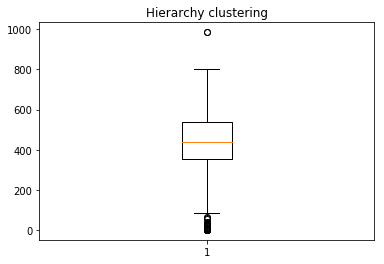

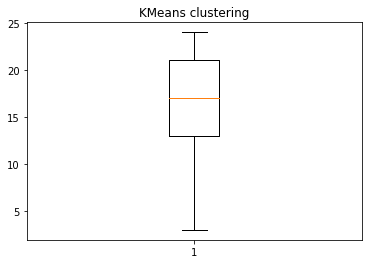

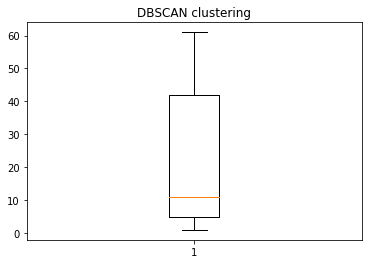

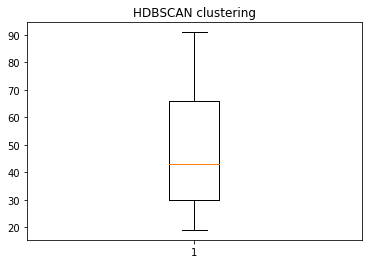

In [15]:
boxCLUSTER(unique_hier,'Hierarchy clustering')
boxCLUSTER(unique_kmeans,'KMeans clustering')
boxCLUSTER(unique_dbscan,'DBSCAN clustering')
boxCLUSTER(unique_hdbscan,'HDBSCAN clustering')

## Pre-process the data
* result_hier      9100 x 7
* result_kmeans    7128 x 7
* result_dbscan    796  x 7
* result_hdbscan   3528  x 7



## Plot each kind of clustering result separately

* Each line corresponds to one column
* Show the fluctuation of each method using different parameters



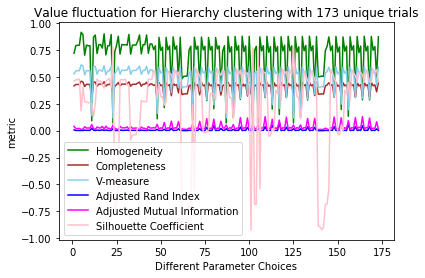

/home/penglab/anaconda3/lib/python3.7/site-packages/pandas/core/ops.py:1649: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



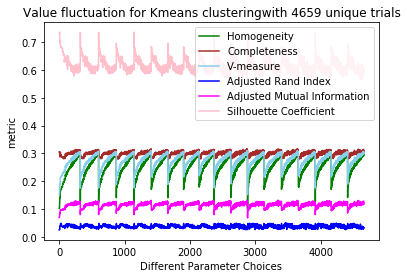

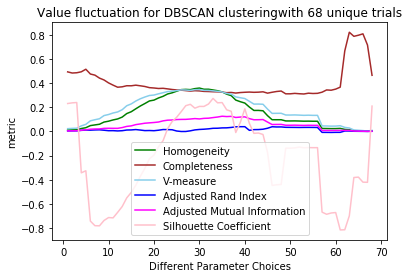

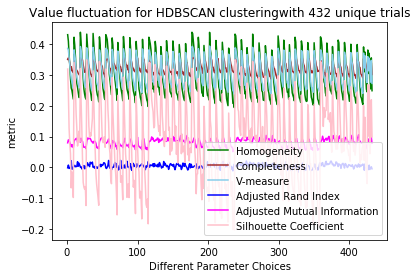

In [16]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
def plot_col(dflocal,cluster_name,dropF):
    #result_hier_self=result_hier.copy()
    if dropF:
        df = dflocal.iloc[:,:-1].drop_duplicates()
    else:
        df = dflocal.copy()
    df = df[df['Silhouette Coefficient']!='below'].copy()
    df = df[df['Silhouette Coefficient']!='above'].copy()
    col_Homogeneity = df['Homogeneity']
    col_Completeness = df['Completeness']
    col_Vmeasure= df['V-measure']
    col_ARI = df['Adjusted Rand Index']
    col_AMI = df['Adjusted Mutual Information']
    col_SC = df['Silhouette Coefficient']
    
    x_axix=range(1,df.shape[0]+1)

    plt.title('Value fluctuation for '+str(cluster_name)+'with '+str(df.shape[0])+' unique trials')
    plt.plot(x_axix, col_Homogeneity.tolist(), color='green', label='Homogeneity')
    plt.plot(x_axix, col_Completeness.tolist(), color='brown', label='Completeness')
    plt.plot(x_axix, col_Vmeasure.tolist(),  color='skyblue', label='V-measure')
    plt.plot(x_axix, col_ARI.tolist(), color='blue', label='Adjusted Rand Index')
    plt.plot(x_axix, col_AMI.tolist(), color='magenta', label='Adjusted Mutual Information')
    plt.plot(x_axix, col_SC.tolist(), color='pink', label='Silhouette Coefficient')
    plt.legend() # 显示图例
    #a=['','H', 'C', 'V', 'ARI', 'AMI', 'SC']
    #plt.xticks(arange(len(a)),a)
    plt.xlabel('Different Parameter Choices')
    plt.ylabel('metric')
    plt.show()
    

plot_col(result_hier.copy(),'Hierarchy clustering ',1)

plot_col(result_kmeans.copy(),'Kmeans clustering',1)

plot_col(result_dbscan.copy(),'DBSCAN clustering',1)

plot_col(result_hdbscan.copy(),'HDBSCAN clustering',1)

# To compare all the results for different metirc
### Detail
* metric can be 'Homogeneity','Completeness','V-measure','Adjusted Rand Index','Adjusted Mutual Information','Silhouette Coefficient'
* Delete clustering result leading to cluster less than 2 or # of cluster = # of swc files

### The unique_* below is a dataframe containing the unique rows of the original trails, it also record number of cluster under that parameter

#### add SNN

In [17]:
result_snn= pd.DataFrame(columns =['Homogeneity', 'Completeness', 'V-measure', 'Adjusted Rand Index',
       'Adjusted Mutual Information', 'Silhouette Coefficient', 'parameter',
       'Cluster Num'],index=['snn0'])
_ = ns. get_clusters(method='SNN_community',
                     karg_dict={'knn':5,
                                'metric':'minkowski',
                                'method':'FastGreedy'})
h = metrics.homogeneity_score(ns.metadata['CellType'],ns.metadata['Cluster'])
c = metrics.completeness_score(ns.metadata['CellType'],ns.metadata['Cluster'])
V = metrics.v_measure_score(ns.metadata['CellType'],ns.metadata['Cluster'])
ARI = metrics.adjusted_rand_score(ns.metadata['CellType'],ns.metadata['Cluster'])
AMI = metrics.adjusted_mutual_info_score(ns.metadata['CellType'],ns.metadata['Cluster'])
typeR, typeC = np.unique(ns.metadata['Cluster'], return_counts = True)
if len(typeR)<2:
    SS = 'below'
elif len(typeR)>=ns.UMAP.shape[0]:
    SS = 'above'
else:
    SS = metrics.silhouette_score(ns.UMAP, ns.metadata['Cluster'], metric='sqeuclidean')
result_snn.loc['snn0','Homogeneity']= h
result_snn.loc['snn0','Completeness']= c
result_snn.loc['snn0','V-measure']=V
result_snn.loc['snn0','Adjusted Rand Index']=ARI
result_snn.loc['snn0','Adjusted Mutual Information']=AMI
result_snn.loc['snn0','Silhouette Coefficient']=SS
result_snn.loc['snn0','parameter']=str({'knn':5,
                                'metric':'minkowski',
                                'method':'FastGreedy'})
result_snn.loc['snn0','Cluster Num']=len(typeR)
unique_snn = result_snn.copy()
unique_snn.to_excel('/home/penglab/FeaCal/dataSource/denMor/unique_snn.xlsx')
unique_snn = pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/unique_snn.xlsx', index_col=0)

Result of SNN_community
Homogeneity: 0.253
Completeness: 0.317
V-measure: 0.281
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.243


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



#  Look into the top ten rows which maximizing ARI
### function maxARI(uniqueDF,cluster_method,swcDF,metric,flipF,size_Z)
* **uniqueDF** is the dataframe with unrepeated parameters
* **cluster_method** can be 'Hierarchy','Kmeans', 'DBSCAN','HDBSCAN','' 
* **swcDF** is the dataframe containing the coordinate of the soma
* **metric** can be 'braycurtis', 'canberra', 'chebyshev', 'cityblock', 'correlation', 'cosine', 'dice', 'euclidean', 'hamming', 'jaccard', 'jensenshannon', 'kulsinski', 'mahalanobis', 'matching', 'minkowski', 'rogerstanimoto', 'russellrao', 'seuclidean', 'sokalmichener', 'sokalsneath', 'sqeuclidean', 'yule'

* **flipF**: 
    * if 1, will flip all the soma to the same hemishphere
* **size_Z** the size of z axis of the brain
* **clusterT** the minimum and maximum threshold for number of cluster
* **somaDF** is the dataframe containing the region of soma: ns.features['soma_features'].region
* **axonDF** is the dataframe containing the region of axon: ns.features['projection_features'].raw_data
* **normaF** is the indicator for whether normalize the result or not.
#* **row_value** is the number of rows to take into comparison.
* **Ffromto** is the indicator for whether return the from-to dataframe for chord diagram.

In [18]:
def normalize(df, log=True):
    scaled_data = np.array(df) / np.sum(df, axis=0).values.reshape(-1,1) * 100000
    if log:
        scaled_data = np.log(scaled_data+100)
    scaled_dataDF = pd.DataFrame(scaled_data, index=df.index, columns=df.columns)
    return scaled_dataDF

In [19]:
import ast
from scipy.spatial.distance import pdist, squareform
import numpy as np
import matplotlib as mpl
from sklearn.metrics import pairwise_distances
import matplotlib.pyplot as plt
def maxARIdic(uniqueDF,cluster_method,swcDF,flipF,size_Z,clusterT,somaDF,axonDF,normaF,Ffromto):
    #if the setting cluster is not satisfied, will print the final number of cluster
    printF=0
    [min_Clusternum,max_Clusternum]=clusterT
    somaregionDF = somaDF.copy()
    axonregionDF = axonDF.copy()            
    df_pre = uniqueDF.copy()
    df_pre = df_pre[df_pre['Silhouette Coefficient']!='below'].copy()
    df_pre = df_pre[df_pre['Silhouette Coefficient']!='above'].copy()
    df_pre = df_pre[df_pre['Completeness']!=1].copy()
    df_pre = df_pre[df_pre['Adjusted Rand Index']>0].copy()
    df_pre.sort_values('Adjusted Rand Index',inplace=True,ascending=False)
    df_pre = df_pre[df_pre['Cluster Num']<=max_Clusternum].copy()
    df_pre = df_pre[df_pre['Cluster Num']>=min_Clusternum].copy()
    
    #under each parameter
    if df_pre.shape[0]==0:
        printF = 1
        print('************')
        print('The input cluster number range is not suitable, just from the swc files which corresponds to the min 40 cluster number and selected the one maximizing ARI\n')
        df_pre = uniqueDF.copy()
        df_pre = df_pre[df_pre['Silhouette Coefficient']!='below'].copy()
        df_pre = df_pre[df_pre['Silhouette Coefficient']!='above'].copy()
        df_pre = df_pre[df_pre['Completeness']!=1].copy()
        df_pre.sort_values('Adjusted Rand Index',inplace=True,ascending=False)
        df_pre = df_pre[df_pre['Adjusted Rand Index']>0].copy()
        df_pre = df_pre[df_pre['Cluster Num']<=max_Clusternum+20].copy()
        df_pre = df_pre[df_pre['Cluster Num']>=min_Clusternum].copy()
        df_pre = df_pre.iloc[:min(20,df_pre.shape[0]),:].copy()
        df_pre.sort_values('Cluster Num',inplace=True,ascending=True)
    if cluster_method == 'SNN_community':
        df_pre = uniqueDF.copy()
    iter_idx = df_pre.index[0]
    _ = ns. get_clusters(method = cluster_method,karg_dict = ast.literal_eval(df_pre.loc[iter_idx]['parameter']))
    print('For '+str(cluster_method) +' method, the most suitable parameter is '+str(df_pre.loc[iter_idx]['parameter']))
    somaregionDF['cluster'] = ns.metadata['Cluster']
    axonregionDF['cluster'] = ns.metadata['Cluster']
    V = metrics.v_measure_score(ns.metadata['CellType'],ns.metadata['Cluster'])
    ARI = metrics.adjusted_rand_score(ns.metadata['CellType'],ns.metadata['Cluster'])
    print('For '+str(cluster_method) +' method, the ARI is '+str(ARI))
    AMI = metrics.adjusted_mutual_info_score(ns.metadata['CellType'],ns.metadata['Cluster'])
    typeR, typeC = np.unique(ns.metadata['Cluster'], return_counts = True)
    if printF:
        print('The setting cluster number\'s limit is not satisfied, the final number of cluster is '+str(len(typeR)))
    else:
        print('The setting cluster number\'s limit is satisfied, the final number of cluster is '+str(len(typeR)))
    if cluster_method == 'HDBSCAN':
        delist=np.array([])
        for itertype in typeR:
            if itertype[1]=='-':
                delist = np.append(delist,itertype)
            if itertype[1]=='0':
                delist=np.append(delist,itertype)
        detailDF = pd.DataFrame(index = np.setdiff1d(typeR,delist),columns = ['swc list','soma region',
                                                                              'max soma','total soma',
                                                                              'max axon'])
    else:
        detailDF = pd.DataFrame(index = typeR,columns = ['swc list','soma region','max soma','total soma',
                                                         'max axon'])
    #
    #detailDF.loc[:,'Cluster Type'] = detailDF.index
    if len(typeR)<2:
        SS = 'below'
    elif len(typeR)>=ns.UMAP.shape[0]:
        SS = 'above'
    else:
        SS = metrics.silhouette_score(ns.UMAP, ns.metadata['Cluster'], metric='sqeuclidean')
        #LABEL LIST CAN BE DETELETED LATER


    # for each cluster result UNDER EACH PARAMETER
    somaCLUSTERlist = []
    axonCLUSTERlist = []

    #axonCLUSTER = pd.DataFrame(index = axonregionDF.columns[:-1])
    for label_idx in detailDF.index:
        axonTEMPdf = pd.DataFrame(index = axonregionDF.columns[:-1])
        swcINlabel = somaregionDF[somaregionDF['cluster']==label_idx]
        detailDF.loc[label_idx,'swc list'] = (swcINlabel.index).tolist()
        #assert(len(inter_list)==somaDF[somaDF['cluster'] !=label_idx].shape[0])
        detailDF.loc[label_idx,'soma region'] = swcINlabel['Region'].tolist()
        del_soma_region=detailDF.loc[label_idx,'soma region']
        while 'unknown' in del_soma_region:
            del_soma_region.remove('unknown')
            del_soma_region.append('others')
        while 'fiber tracts' in del_soma_region:
            del_soma_region.remove('fiber tracts')
            del_soma_region.append('others')
        IDrange, IDcounts = np.unique(del_soma_region, return_counts = True)
        #sort the counting
        count_sort_ind = np.argsort(-IDcounts)
        dicitem = []
        for i in range(1,min(len(IDrange)+1,4)):
            dicitem.append(str(i)+'somaR')
        for i in range(1,min(len(IDrange)+1,4)):
            dicitem.append(str(i)+'somaC')
        #select the first three regions
        dicvalue = IDrange[count_sort_ind][0:min(3,len(IDrange))]
        dicvalue = np.append(dicvalue,IDcounts[count_sort_ind][0:min(3,len(IDrange))])
        detailDF.loc[label_idx,'max soma'] = str(dict(zip(dicitem, dicvalue)))
        somaCLUSTERlist.append(detailDF.loc[label_idx,'max soma'] )
        detailDF.loc[label_idx,'total soma'] = swcINlabel.shape[0]

        #axonLABEL stores all the rows under same cluster
        axonLABEL = axonregionDF[axonregionDF['cluster']==label_idx].copy()
        axonLABEL.drop('cluster', axis=1,inplace=True)
        axonTEMPdf[label_idx]=axonLABEL.sum()
        if 'contra_fiber tracts' in axonTEMPdf.index:
            axonTEMPdf.drop(index=['contra_fiber tracts'],inplace = True)
        if 'ipsi_fiber tracts' in axonTEMPdf.index:
            axonTEMPdf.drop(index=['ipsi_fiber tracts'],inplace = True)
        if normaF:
            #normalize the sum
            axonTEMPdf = normalize(axonTEMPdf , log=True)
        axonTEMPdf.sort_values(by=label_idx, ascending=False, inplace=True)
        dicitem = []
        for i in range(1,4):
            dicitem.append(str(i)+'axonR')
        for i in range(1,4):
            dicitem.append(str(i)+'axonC')
        dicvalue = axonTEMPdf.index[:3]
        dicvalue = np.append(dicvalue,axonTEMPdf.loc[:,label_idx][:3])
        detailDF.loc[label_idx,'max axon'] = str(dict(zip(dicitem, dicvalue)))
        axonCLUSTERlist.append(detailDF.loc[label_idx,'max axon'] )
    if not Ffromto:
        return detailDF
    else:
        clusterDF=detailDF.copy()
        dfname=[]
        for cluster_idx in clusterDF.index:
            dfname.append((str(cluster_idx) + 'DF'))

        #generate a dataframe for each cluster
        dicDF = {k:None for k in dfname}

        #iterate the correponding dataframe and cluster at the same time
        for key_iter,cluster_idx in zip(dicDF.keys(),clusterDF.index):
            dic_soma = ast.literal_eval(clusterDF.loc[cluster_idx,'max soma'])
            iterL = int(len(dic_soma.keys())/2)
            somaNAME = []
            somaCOUNT = []

            for i in range(1,int(iterL)+1):
                somaNAME.append(dic_soma[(str(i)+'somaR')])
            for i in range(1,iterL+1):
                somaCOUNT.append(dic_soma[str(i)+'somaC'])
            somaArr = np.array(somaCOUNT, dtype = float)
            somaArr = somaArr/sum(somaArr)
            dic_axon = ast.literal_eval(clusterDF.loc[cluster_idx,'max axon'])
            iterL = int(len(dic_axon.keys())/2)
            axonNAME = []
            axonCOUNT = []
            for i in range(1,iterL+1):
                axonNAME.append(dic_axon[(str(i)+'axonR')])
            for i in range(1,iterL+1):
                axonCOUNT.append(dic_axon[str(i)+'axonC']) 

            tempDF = pd.DataFrame()
            for row_soma in somaNAME:
                for col_axon,len_axon in zip(axonNAME,axonCOUNT):
                    tempDF.loc[row_soma, col_axon] = len_axon

            assert(tempDF.shape[0] == len(somaArr))  
            tempDF=tempDF.astype(float)
            for i in range(tempDF.shape[0]):
                tempDF.iloc[i,:] = tempDF.iloc[i,:]*somaArr[i].copy()

            newDF = pd.DataFrame(columns=['from','to','value'],index=range(tempDF.shape[0]*tempDF.shape[1]))
            newDF.loc[:,'from'] = (tempDF.index).tolist()*len(tempDF.columns)
            newDF.loc[:,'to'] = [ele for ele in (tempDF.columns).tolist() for _ in range(len(tempDF.index))]
            valuelist=[]
            for iter_col in tempDF.columns:
                for iter_row in tempDF.index:
                    valuelist.append(tempDF.loc[iter_row,iter_col])
            newDF.loc[:,'value']=valuelist
            dicDF[key_iter]= newDF.copy()
    return dicDF
     

### The following obtained the first 10 rows which maximizing ARI

#### Only count the nearst 400 inter-cluster soma

In [20]:
hier_as = maxARIdic(unique_hier,'Hierarchy',ns.features['soma_features'].raw_data.copy(),1,11400.0,[8,40],
                    ns.features['soma_features'].region,ns.features['projection_features'].raw_data,1,0)
hier_as.to_excel('/home/penglab/FeaCal/dataSource/denMor/hier_as.xlsx')
hier_as=pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/hier_as.xlsx', index_col=0)
dicHIER= maxARIdic(unique_hier,'Hierarchy',ns.features['soma_features'].raw_data.copy(),1,11400.0,[8,40],
                    ns.features['soma_features'].region,ns.features['projection_features'].raw_data,1,1)
for iter_key in dicHIER.keys():
    tempDF = dicHIER[iter_key]
    #print(tempDF)
    #(tempDF).to_csv('/home/penglab/FeaCal/dataSource/somaLoc/HIER/'+str(iter_key)+'.csv')

Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055
For Hierarchy method, the most suitable parameter is {'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
For Hierarchy method, the ARI is 0.05355799672049869
The setting cluster number's limit is satisfied, the final number of cluster is 8


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Hierarchy CLustering
Homogeneity: 0.197
Completeness: 0.330
V-measure: 0.247
Adjusted Rand Index: 0.054
Adjusted Mutual Information: 0.120
Silhouette Coefficient: 0.055
For Hierarchy method, the most suitable parameter is {'L_method': 'weighted', 'L_metric': 'mahalanobis', 'criterionH': 'distance', 'depth': 2, 'R': None, 't': 0.9, 'optimal_ordering': False}
For Hierarchy method, the ARI is 0.05355799672049869
The setting cluster number's limit is satisfied, the final number of cluster is 8


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



In [21]:
kmeans_as = maxARIdic(unique_kmeans,'Kmeans',ns.features['soma_features'].raw_data.copy(),1,11400.0,[8,40],
                    ns.features['soma_features'].region,ns.features['projection_features'].raw_data,1,0)
kmeans_as.to_excel('/home/penglab/FeaCal/dataSource/denMor/kmeans_as.xlsx')
kmeans_as=pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/kmeans_as.xlsx', index_col=0)
dicKMEANS= maxARIdic(unique_kmeans,'Kmeans',ns.features['soma_features'].raw_data.copy(),1,11400.0,[8,40],
                    ns.features['soma_features'].region,ns.features['projection_features'].raw_data,1,1)
for iter_key in dicKMEANS.keys():
    tempDF = dicKMEANS[iter_key]
    print(tempDF)
    #(tempDF).to_csv('/home/penglab/FeaCal/dataSource/somaLoc/KMEANS/'+str(iter_key)+'.csv')

/home/penglab/anaconda3/lib/python3.7/site-packages/pandas/core/ops.py:1649: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.225
Completeness: 0.291
V-measure: 0.254
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.107
Silhouette Coefficient: 0.616
For Kmeans method, the most suitable parameter is {'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
For Kmeans method, the ARI is 0.036079814213255956
The setting cluster number's limit is satisfied, the final number of cluster is 13


/home/penglab/anaconda3/lib/python3.7/site-packages/pandas/core/ops.py:1649: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of Kmeans
Homogeneity: 0.229
Completeness: 0.296
V-measure: 0.258
Adjusted Rand Index: 0.036
Adjusted Mutual Information: 0.112
Silhouette Coefficient: 0.614
For Kmeans method, the most suitable parameter is {'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0001, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': None, 'algorithm': 'auto'}
For Kmeans method, the ARI is 0.03637097812859566
The setting cluster number's limit is satisfied, the final number of cluster is 13
     from        to     value
0     MOs  ipsi_MRN  3.479355
1  others  ipsi_MRN  3.313671
2     PRE  ipsi_MRN  1.822519
3     MOs  ipsi_PAG  3.445509
4  others  ipsi_PAG  3.281437
5     PRE  ipsi_PAG  1.804791
6     MOs  ipsi_MOs  3.315698
7  others  ipsi_MOs  3.157808
8     PRE  ipsi_MOs  1.736794
     from         to     value
0     MOs  contra_CP  4.889140
1     PRE  contra_CP  2.328162
2  others  contra_CP  1.862529
3     MOs    ipsi_CP  4.81

In [22]:
dbscan_as = maxARIdic(unique_dbscan,'DBSCAN',ns.features['soma_features'].raw_data.copy(),1,11400.0,[8,40],
                    ns.features['soma_features'].region,ns.features['projection_features'].raw_data,1,0)
dbscan_as.to_excel('/home/penglab/FeaCal/dataSource/denMor/dbscan_as.xlsx')
dbscan_as=pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/dbscan_as.xlsx', index_col=0)
dicDBSCAN= maxARIdic(unique_dbscan,'DBSCAN',ns.features['soma_features'].raw_data.copy(),1,11400.0,[8,40],
                    ns.features['soma_features'].region,ns.features['projection_features'].raw_data,1,1)
for iter_key in dicDBSCAN.keys():
    tempDF = dicDBSCAN[iter_key]
    print(tempDF)
    #(tempDF).to_csv('/home/penglab/FeaCal/dataSource/somaLoc/DBSCAN/'+str(iter_key)+'.csv')

Result of DBSCAN
Homogeneity: 0.246
Completeness: 0.322
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.075
For DBSCAN method, the most suitable parameter is {'eps': 0.22, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': None}
For DBSCAN method, the ARI is 0.039530673163787826
The setting cluster number's limit is satisfied, the final number of cluster is 20


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of DBSCAN
Homogeneity: 0.246
Completeness: 0.322
V-measure: 0.279
Adjusted Rand Index: 0.040
Adjusted Mutual Information: 0.119
Silhouette Coefficient: 0.075
For DBSCAN method, the most suitable parameter is {'eps': 0.22, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': None}
For DBSCAN method, the ARI is 0.039530673163787826
The setting cluster number's limit is satisfied, the final number of cluster is 20


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



     from        to     value
0     MOs  ipsi_MOs  4.862363
1  others  ipsi_MOs  2.431181
2      DG  ipsi_MOs  2.431181
3     MOs  ipsi_CA3  4.354313
4  others  ipsi_CA3  2.177156
5      DG  ipsi_CA3  2.177156
6     MOs  ipsi_PAG  4.155038
7  others  ipsi_PAG  2.077519
8      DG  ipsi_PAG  2.077519
  from         to     value
0  MOs    ipsi_CP  5.964725
1  SUB    ipsi_CP  2.236772
2  MOp    ipsi_CP  1.491181
3  MOs   ipsi_MOs  5.670634
4  SUB   ipsi_MOs  2.126488
5  MOp   ipsi_MOs  1.417658
6  MOs  contra_CP  5.438172
7  SUB  contra_CP  2.039315
8  MOp  contra_CP  1.359543
     from         to     value
0     MOs    ipsi_CP  7.532985
1  others    ipsi_CP  1.171798
2     SUB    ipsi_CP  1.171798
3     MOs   ipsi_MOs  7.147626
4  others   ipsi_MOs  1.111853
5     SUB   ipsi_MOs  1.111853
6     MOs  contra_CP  7.013315
7  others  contra_CP  1.090960
8     SUB  contra_CP  1.090960
    from         to     value
0    MOs    ipsi_CP  7.840898
1     DG    ipsi_CP  1.120128
2  ORBvl    ipsi_CP 

In [23]:
hdbscan_as = maxARIdic(unique_hdbscan,'HDBSCAN',ns.features['soma_features'].raw_data.copy(),1,11400.0,[8,40],
                    ns.features['soma_features'].region,ns.features['projection_features'].raw_data,1,0)
hdbscan_as.to_excel('/home/penglab/FeaCal/dataSource/denMor/hdbscan_as.xlsx')
hdbscan_as=pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/dbscan_as.xlsx', index_col=0)
dicHDBSCAN= maxARIdic(unique_hdbscan,'HDBSCAN',ns.features['soma_features'].raw_data.copy(),1,11400.0,[8,40],
                      ns.features['soma_features'].region,ns.features['projection_features'].raw_data,1,1)
for iter_key in dicHDBSCAN.keys():
    tempDF = dicHDBSCAN[iter_key]
    print(tempDF)
    #(tempDF).to_csv('/home/penglab/FeaCal/dataSource/somaLoc/HDBSCAN/'+str(iter_key)+'.csv')

Result of HDBSCAN
Homogeneity: 0.223
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.179
For HDBSCAN method, the most suitable parameter is {'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}


/home/penglab/anaconda3/lib/python3.7/site-packages/pandas/core/ops.py:1649: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



For HDBSCAN method, the ARI is 0.020481889417205506
The setting cluster number's limit is satisfied, the final number of cluster is 21


/home/penglab/anaconda3/lib/python3.7/site-packages/pandas/core/ops.py:1649: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Result of HDBSCAN
Homogeneity: 0.223
Completeness: 0.298
V-measure: 0.255
Adjusted Rand Index: 0.020
Adjusted Mutual Information: 0.087
Silhouette Coefficient: 0.179
For HDBSCAN method, the most suitable parameter is {'min_cluster_size': 5, 'metric': 'manhattan', 'alpha': 0.9, 'min_samples': 9, 'p': 2, 'algorithm': 'generic', 'leaf_size': 40, 'approx_min_span_tree': True, 'gen_min_span_tree': False, 'core_dist_n_jobs': 4, 'cluster_selection_method': 'eom', 'allow_single_cluster': False, 'prediction_data': False, 'match_reference_implementation': False}
For HDBSCAN method, the ARI is 0.020481889417205506
The setting cluster number's limit is satisfied, the final number of cluster is 21
     from         to     value
0     MOs    ipsi_CP  7.790768
1     SUB    ipsi_CP  1.211897
2  others    ipsi_CP  0.865641
3     MOs   ipsi_MOs  7.383008
4     SUB   ipsi_MOs  1.148468
5  others   ipsi_MOs  0.820334
6     MOs  contra_CP  7.249818
7     SUB  contra_CP  1.127749
8  others  contra_CP  0.805

In [24]:
snn_as = maxARIdic(unique_snn,'SNN_community',ns.features['soma_features'].raw_data.copy(),1,11400.0,[8,80],
                    ns.features['soma_features'].region,ns.features['projection_features'].raw_data,1,0)
snn_as.to_excel('/home/penglab/FeaCal/dataSource/denMor/snn_as.xlsx')
snn_as=pd.read_excel('/home/penglab/FeaCal/dataSource/denMor/snn_as.xlsx', index_col=0)
dicSNN= maxARIdic(unique_snn,'SNN_community',ns.features['soma_features'].raw_data.copy(),1,11400.0,[8,40],
                      ns.features['soma_features'].region,ns.features['projection_features'].raw_data,1,1)
for iter_key in dicHDBSCAN.keys():
    tempDF = dicHDBSCAN[iter_key]
    print(tempDF)
    #(tempDF).to_csv('/home/penglab/FeaCal/dataSource/somaLoc/HDBSCAN/'+str(iter_key)+'.csv')v

Result of SNN_community


/home/penglab/anaconda3/lib/python3.7/site-packages/pandas/core/ops.py:1649: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



Homogeneity: 0.253
Completeness: 0.317
V-measure: 0.281
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.243
For SNN_community method, the most suitable parameter is {'knn': 5, 'metric': 'minkowski', 'method': 'FastGreedy'}
For SNN_community method, the ARI is 0.045224072138369056
The setting cluster number's limit is satisfied, the final number of cluster is 18


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/pandas/core/ops.py:1649: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



Result of SNN_community
Homogeneity: 0.253
Completeness: 0.317
V-measure: 0.281
Adjusted Rand Index: 0.045
Adjusted Mutual Information: 0.123
Silhouette Coefficient: 0.243
For SNN_community method, the most suitable parameter is {'knn': 5, 'metric': 'minkowski', 'method': 'FastGreedy'}
For SNN_community method, the ARI is 0.045224072138369056
The setting cluster number's limit is satisfied, the final number of cluster is 18


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/metrics/cluster/supervised.py:732: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



     from         to     value
0     MOs    ipsi_CP  7.790768
1     SUB    ipsi_CP  1.211897
2  others    ipsi_CP  0.865641
3     MOs   ipsi_MOs  7.383008
4     SUB   ipsi_MOs  1.148468
5  others   ipsi_MOs  0.820334
6     MOs  contra_CP  7.249818
7     SUB  contra_CP  1.127749
8  others  contra_CP  0.805535
     from          to     value
0  others  contra_MRN  4.302495
1     IRN  contra_MRN  2.151247
2     PVi  contra_MRN  2.151247
3  others    ipsi_PAG  4.294158
4     IRN    ipsi_PAG  2.147079
5     PVi    ipsi_PAG  2.147079
6  others    ipsi_LHA  4.187901
7     IRN    ipsi_LHA  2.093950
8     PVi    ipsi_LHA  2.093950
    from        to     value
0    AHN  ipsi_MRN  4.463018
1    LHA  ipsi_MRN  2.231509
2  MDRNd  ipsi_MRN  2.231509
3    AHN  ipsi_PAG  4.222706
4    LHA  ipsi_PAG  2.111353
5  MDRNd  ipsi_PAG  2.111353
6    AHN  ipsi_SCm  4.209333
7    LHA  ipsi_SCm  2.104666
8  MDRNd  ipsi_SCm  2.104666
  from         to     value
0  MOs    ipsi_CP  6.989606
1   AV    ipsi_CP  1.397